In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score, roc_auc_score, confusion_matrix, roc_curve
from sklearn.inspection import permutation_importance
from sklearn.utils.class_weight import compute_class_weight
import shap
from sklearn.linear_model import LassoCV
import seaborn as sns
import matplotlib.pyplot as plt
import joblib
from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout, Concatenate, BatchNormalization
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow.keras.backend as K
from tensorflow.keras.layers import Layer
import tensorflow as tf
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout, BatchNormalization, Concatenate, Attention
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping

2025-05-05 02:54:40.136610: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1746413680.419981      13 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1746413680.502810      13 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
import numpy as np

# Assuming `attention_weights` is a NumPy array
np.set_printoptions(threshold=np.inf, linewidth=np.inf)

# Các hàm

## 1. Load dữ liệu

In [3]:
# Đọc dữ liệu
def load_data(phase):
    # Đọc dữ liệu từ các file CSV
    phase_ = phase[:-1] + '_' + phase[-1]
    X_train = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_train.csv")
    X_test = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_test.csv")
    
    # In thông tin chung về dữ liệu
    print(X_train.info())

    count_map = X_train['school'].value_counts().to_dict()
    X_train['school'] = X_train['school'].map(count_map)
    X_test['school'] = X_test['school'].map(count_map)

    # Fill nan = 0
    X_train = X_train.fillna(0)
    X_test = X_test.fillna(0)
    
    # Loại bỏ các cột không cần thiết trong X
    columns_to_drop = ['course_id', 'user_id', 'total_score', 'type', 'label']
    X_train = X_train.drop(columns=columns_to_drop, axis=1)
    X_test = X_test.drop(columns=columns_to_drop, axis=1)
    
    # Lấy nhãn (target) từ cột 'label_encoded'
    y_train = X_train.pop("label_encoded")
    y_test = X_test.pop("label_encoded")
    
    return X_train, y_train, X_test, y_test

## 2. Đánh giá dữ liệu

In [4]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import (
    f1_score, precision_score, recall_score, accuracy_score,
    roc_auc_score, roc_curve, confusion_matrix, classification_report
)
import matplotlib.pyplot as plt
import seaborn as plt
import seaborn as sns
import numpy as np

def evaluate_model(model, X_train, y_train, X_test, y_test, class_names=["E", "D", "C", "B", "A"]):
    def predict_with_softmax(model, X):
        preds = model.predict(X)
        if preds.ndim == 1 or preds.shape[1] == 1:
            # Binary case
            y_pred = (preds > 0.5).astype(int).flatten()
            y_proba = np.hstack([1 - preds, preds])
        else:
            # Multi-class case
            y_pred = np.argmax(preds, axis=1)
            y_proba = preds
        return y_pred, y_proba

    def evaluate_split(X, y, split_name):
        y_pred, y_proba = predict_with_softmax(model, X)

        f1 = f1_score(y, y_pred, average=None)
        precision = precision_score(y, y_pred, average=None)
        recall = recall_score(y, y_pred, average=None)
        accuracy = accuracy_score(y, y_pred)

        y_bin = label_binarize(y, classes=np.arange(len(class_names)))
        roc_auc = roc_auc_score(y_bin, y_proba, multi_class="ovr")

        print(f"\n--- {split_name} Metrics ---")
        print("F1 Score (per class):", f1)
        print("Precision (per class):", precision)
        print("Recall (per class):", recall)
        print(f"Accuracy: {accuracy:.4f}")
        print(f"AUC (One-vs-Rest): {roc_auc:.4f}")

        print("\nClassification Report:")
        print(classification_report(y, y_pred, target_names=class_names))

        # Confusion Matrix
        plt.figure(figsize=(8, 6))
        sns.heatmap(confusion_matrix(y, y_pred), annot=True, fmt="d", cmap="Blues",
                    xticklabels=class_names, yticklabels=class_names)
        plt.title(f"Confusion Matrix - {split_name}")
        plt.xlabel("Predicted Label")
        plt.ylabel("True Label")
        plt.show()

        # ROC Curve
        plt.figure(figsize=(10, 8))
        for i in range(len(class_names)):
            fpr, tpr, _ = roc_curve(y_bin[:, i], y_proba[:, i])
            auc_score = roc_auc_score(y_bin[:, i], y_proba[:, i])
            plt.plot(fpr, tpr, label=f"{class_names[i]} (AUC = {auc_score:.2f})")
        plt.plot([0, 1], [0, 1], 'k--')
        plt.title(f"ROC Curve - {split_name}")
        plt.xlabel("False Positive Rate")
        plt.ylabel("True Positive Rate")
        plt.legend()
        plt.grid(True)
        plt.show()

        return {
            "f1": f1, "precision": precision, "recall": recall,
            "accuracy": accuracy, "roc_auc": roc_auc
        }

    train_metrics = evaluate_split(X_train, y_train, "Train")
    test_metrics = evaluate_split(X_test, y_test, "Test")

    return {"train": train_metrics, "test": test_metrics}

## 3. Scale dữ liệu

In [5]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler
import numpy as np
import pandas as pd

def scale_data(X_train, X_test, scaler_type="standard"):
    """
    Áp dụng các kỹ thuật scaling cho dữ liệu.
    
    Parameters:
        X_train (DataFrame): Dữ liệu huấn luyện
        X_test (DataFrame): Dữ liệu kiểm tra
        scaler_type (str): 'minmax', 'standard', 'robust', hoặc 'log'
    
    Returns:
        X_train_scaled, X_test_scaled: Dữ liệu đã được scale
    """
    if scaler_type == "log":
        # Đảm bảo tất cả các giá trị > 0 trước khi lấy log
        min_val = min(X_train.min().min(), X_test.min().min())
        if min_val <= 0:
            offset = 1 - min_val
            X_train = X_train + offset
            X_test = X_test + offset
        X_train_scaled = np.log(X_train)
        X_test_scaled = np.log(X_test)
        return X_train_scaled, X_test_scaled

    elif scaler_type == "minmax":
        scaler = MinMaxScaler()
    elif scaler_type == "standard":
        scaler = StandardScaler()
    elif scaler_type == "robust":
        scaler = RobustScaler()
    else:
        raise ValueError(f"Scaler type '{scaler_type}' không hợp lệ. Chọn: 'minmax', 'standard', 'robust', hoặc 'log'.")

    # Fit và transform dữ liệu
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    
    return X_train_scaled, X_test_scaled


## Permutation Importance

In [6]:
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt
import pandas as pd

def plot_permutation_importance(model, X_train, y_train):
    # Tính Permutation Importance
    perm_importance = permutation_importance(model, X_train, y_train, n_repeats=8, random_state=42)
    
    # Tạo DataFrame cho dữ liệu quan trọng
    importance_df = pd.DataFrame({
        'Feature': X_train.columns,
        'Importance': perm_importance.importances_mean
    }).sort_values(by='Importance', ascending=False)
    
    # Dựa trên số lượng feature, điều chỉnh kích thước của biểu đồ
    num_features = len(importance_df)
    figsize = (10, num_features * 0.3)  # Điều chỉnh chiều cao dựa trên số feature
    
    # Vẽ biểu đồ
    importance_df.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=figsize)
    plt.title("Permutation Importance")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.show()

    return importance_df

## Lasso

In [7]:
import pandas as pd
from sklearn.linear_model import LassoCV
import numpy as np
import matplotlib.pyplot as plt

def lasso_feature_selection(X_train, y_train):
    # Lasso Regression với Cross-Validation để tìm alpha tốt nhất
    lasso = LassoCV(cv=5, random_state=42)
    lasso.fit(X_train, y_train)
    
    # In ra trọng số của các feature
    feature_importance = pd.DataFrame({
        'Feature': X_train.columns,
        'Importance': np.abs(lasso.coef_)
    }).sort_values(by='Importance', ascending=False)
    
    # Tính chiều cao dựa trên số lượng feature
    num_features = len(feature_importance)
    height = max(4, num_features * 0.3)  # đảm bảo không quá nhỏ
    
    # Vẽ biểu đồ trọng số của feature
    feature_importance.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=(8, height))
    plt.title("Lasso Feature Importance")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()
    
    return feature_importance

## Boruta Trick

In [8]:
from sklearn.ensemble import RandomForestClassifier
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def boruta_trick(model, X_train, y_train):
    # Tạo một feature ngẫu nhiên (feature "ngẫu nhiên")
    random_feature = np.random.rand(X_train.shape[0], 1)
    X_train_random = np.hstack([X_train.values, random_feature])

    # Huấn luyện mô hình Random Forest
    model.fit(X_train_random, y_train)

    # Tính toán importance của từng feature
    feature_importance = pd.DataFrame({
        'Feature': list(X_train.columns) + ['Random Feature'],
        'Importance': model.feature_importances_
    }).sort_values(by='Importance', ascending=False)

    # In ra độ quan trọng của tất cả các feature (bao gồm feature ngẫu nhiên)
    print('Feature Importance (Including Random Feature):')
    print(feature_importance)

    # Lọc các feature quan trọng hơn feature ngẫu nhiên
    important_features = feature_importance[feature_importance['Importance'] > feature_importance['Importance'].iloc[-1]]
    print('Important features (Above Random Feature): ', important_features)

    # Dựa trên số lượng feature, điều chỉnh kích thước của biểu đồ
    num_features = len(feature_importance)
    figsize = (10, num_features * 0.3)  # Điều chỉnh chiều cao dựa trên số feature
    
    # Vẽ biểu đồ
    feature_importance.plot(kind='barh', x='Feature', y='Importance', legend=False, figsize=figsize)
    plt.title("Boruta Feature Importance (Trick)")
    plt.xlabel("Importance")
    plt.ylabel("Feature")
    plt.show()

    return important_features

In [9]:
# SHAP (SHapley Additive exPlanations)
def plot_shap_importance(model, X_train):
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X_train)
    # Vẽ SHAP summary plot
    shap.summary_plot(shap_values, X_train)
    return shap_values

## Build model

In [10]:
from tensorflow.keras.layers import Layer
import tensorflow.keras.backend as K

class AttentionLayer(Layer):
    def __init__(self, **kwargs):
        super(AttentionLayer, self).__init__(**kwargs)

    def build(self, input_shape):
        # Learnable attention weights and biases
        self.W = self.add_weight(name='att_weight', shape=(input_shape[-1], 1),
                                 initializer='random_normal', trainable=True)
        self.b = self.add_weight(name='att_bias', shape=(1,),
                                 initializer='zeros', trainable=True)
        super().build(input_shape)

    def call(self, inputs):
        # Compute attention scores using tanh activation
        score = K.tanh(K.dot(inputs, self.W) + self.b)
        
        # Compute attention weights using softmax (applied over time steps)
        attention_weights = K.softmax(score, axis=1)
        
        # Apply attention weights to input features (context vector)
        context_vector = attention_weights * inputs
        
        # Summing context vector over time steps to get the final context vector
        context_vector = K.sum(context_vector, axis=1)
        
        return context_vector, attention_weights


In [11]:
import tensorflow as tf
from tensorflow.keras.metrics import Metric
import numpy as np
from sklearn.metrics import f1_score

class F1Macro(Metric):
    def __init__(self, name='f1_macro', **kwargs):
        super(F1Macro, self).__init__(name=name, **kwargs)
        self.y_true_vals = []
        self.y_pred_vals = []

    def update_state(self, y_true, y_pred, sample_weight=None):
        y_true = tf.cast(y_true, tf.int32)
        y_pred = tf.argmax(y_pred, axis=-1)
        self.y_true_vals.append(y_true)
        self.y_pred_vals.append(y_pred)

    def result(self):
        y_true = tf.concat(self.y_true_vals, axis=0)
        y_pred = tf.concat(self.y_pred_vals, axis=0)

        # Compute macro F1 using numpy_function (to run sklearn in graph mode)
        def compute_f1(y_true_np, y_pred_np):
            return np.float32(f1_score(y_true_np, y_pred_np, average='macro'))

        return tf.numpy_function(compute_f1, [y_true, y_pred], tf.float32)

    def reset_states(self):
        self.y_true_vals = []
        self.y_pred_vals = []


In [12]:
def focal_loss(gamma=2., alpha=0.25):
    def loss_fn(y_true, y_pred):
        y_true = tf.cast(y_true, tf.int32)
        y_true = tf.one_hot(y_true, depth=tf.shape(y_pred)[-1])
        y_pred = tf.clip_by_value(y_pred, 1e-7, 1 - 1e-7)
        cross_entropy = -y_true * tf.math.log(y_pred)
        weight = alpha * tf.pow(1 - y_pred, gamma)
        return tf.reduce_mean(weight * cross_entropy)
    return loss_fn

In [13]:
from tensorflow.keras.layers import Input, Dense, Dropout, BatchNormalization, Bidirectional, LSTM, Concatenate, Softmax, Multiply, Lambda
from tensorflow.keras.models import Model
from tensorflow.keras.initializers import HeNormal, Zeros, Ones
import tensorflow as tf

def build_stable_attention_model(seq_input_shape, static_input_shape, num_classes):
    he_init = HeNormal()
    zero_init = Ones()

    # Sequential input
    seq_input = Input(shape=seq_input_shape, name="sequence_input")
    x_seq = Bidirectional(LSTM(64, return_sequences=True,
                               kernel_initializer=he_init,
                               bias_initializer=zero_init))(seq_input)
    x_seq = Dropout(0.3)(x_seq)
    x_seq = Bidirectional(LSTM(32, return_sequences=True,
                               kernel_initializer=he_init,
                               bias_initializer=zero_init))(x_seq)

    attention_dense = Dense(1, activation='tanh', name="attention_dense",
                            kernel_initializer=he_init,
                            bias_initializer=zero_init)(x_seq)
    attention_weights = Softmax(axis=1, name="attention_weights")(attention_dense)
    weighted_sequence = Multiply(name="attention_multiply")([x_seq, attention_weights])
    context_vector = Lambda(lambda x: tf.reduce_sum(x, axis=1), name="context_vector")(weighted_sequence)

    # Process context
    x1 = Dense(64, activation='relu',
               kernel_initializer=he_init,
               bias_initializer=zero_init)(context_vector)
    x1 = Dropout(0.4)(x1)

    # Static input branch
    static_input = Input(shape=(static_input_shape,), name="static_input")
    x2 = Dense(64, activation='relu',
               kernel_initializer=he_init,
               bias_initializer=zero_init)(static_input)
    x2 = BatchNormalization()(x2)
    x2 = Dropout(0.4)(x2)
    x2 = Dense(32, activation='relu',
               kernel_initializer=he_init,
               bias_initializer=zero_init)(x2)

    # Concatenate both branches
    x = Concatenate()([x1, x2])
    x = Dense(128, activation='relu',
              kernel_initializer=he_init,
              bias_initializer=zero_init)(x)
    x = BatchNormalization()(x)
    x = Dropout(0.4)(x)
    x = Dense(64, activation='relu',
              kernel_initializer=he_init,
              bias_initializer=zero_init)(x)

    # Output
    output = Dense(num_classes, activation='softmax',
                   kernel_initializer=he_init,
                   bias_initializer=zero_init)(x)

    model = Model(inputs=[seq_input, static_input], outputs=output)
    model.compile(optimizer='adam',
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    model.summary()
    return model


In [14]:
def plot_train_valid(history, metric='accuracy'):
    # Vẽ Loss
    plt.figure(figsize=(10,5))
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title("Loss over Epochs")
    plt.xlabel("Epochs")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)
    plt.show()
    
    plt.figure(figsize=(10,5))
    plt.plot(history.history[metric], label=f"Train {metric}")
    plt.plot(history.history[f"val_{metric}"], label=f"Validation {metric}")
    plt.title(f"{metric} over epochs")
    plt.xlabel("Epoch")
    plt.ylabel(metric.capitalize())
    plt.legend()
    plt.grid(True)
    plt.show()

In [15]:
import matplotlib.pyplot as plt

def plot_attention_weights(att_weights, y_true, num_samples=5, class_names=None):
    att_weights = np.squeeze(att_weights)  # Remove extra dimensions like (n, 1, 1)
    
    if att_weights.ndim == 1:
        att_weights = att_weights[:, np.newaxis]  # Make it (n, 1) if needed

    for i in range(min(num_samples, len(att_weights))):
        plt.figure(figsize=(6, 3))
        
        # Plot the attention as a bar chart
        plt.bar(range(att_weights.shape[1]), att_weights[i])
        plt.xlabel("Time Step")
        plt.ylabel("Attention Weight")
        
        # Handle one-hot labels
        if y_true.ndim > 1:
            label_idx = np.argmax(y_true[i])
        else:
            label_idx = y_true[i]
        
        label_str = class_names[label_idx] if class_names else label_idx
        plt.title(f"Sample {i} - True Label: {label_str}")
        plt.show()

In [16]:
from sklearn.metrics import f1_score
from tensorflow.keras.callbacks import Callback
import numpy as np

class F1MacroCallback(Callback):
    def __init__(self, validation_data):
        super().__init__()
        self.validation_data = validation_data

    def on_epoch_end(self, epoch, logs=None):
        val_data, val_labels = self.validation_data
        val_pred = self.model.predict(val_data)
        val_pred_labels = np.argmax(val_pred, axis=1)

        f1 = f1_score(val_labels, val_pred_labels, average='macro')
        print(f"\nEpoch {epoch+1}: val_f1_macro = {f1:.4f}")
        if logs is not None:
            logs['val_f1_macro'] = f1


# 1. Scale dữ liệu standard

In [17]:
static_features = ['school', 'field_encoded_1', 'field_encoded_2', 'start_year','start_month',
                    'end_year', 'end_month', 'user_year', 'user_month', 'video_count', 'exercise_count',
                    'chapter_count', 'user_past_course_count', 'user_time_since_last_course', 
                   'num_prerequisites', 'certificate', 'assignment', 'video', 'exam', 
                    'duration_days', 'remaining_time']

In [18]:
from tensorflow.keras.callbacks import ReduceLROnPlateau

lr_schedule = ReduceLROnPlateau(
    monitor='val_loss',     # what to monitor
    factor=0.5,             # reduce learning rate by this factor
    patience=8,             # wait for 4 epochs of no improvement
    verbose=1               # print when it changes the learning rate
)

def process_phase(phase, scale='standard', metric='accuracy'):
    # Read data
    X_train, y_train, X_test, y_test = load_data(phase)

    # Scale data
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
    
    # Ensure y_train and y_test are NumPy arrays before reshaping
    y_train = np.array(y_train).reshape(-1, 1)  # Reshaping to 2D array
    y_test = np.array(y_test).reshape(-1, 1)
    
    # Fit the encoder and transform y_train and y_test
    # encoder.fit(y_train)
    # y_train_encoded = encoder.transform(y_train)
    # y_test_encoded = encoder.transform(y_test)

    # Extract features for sequence (time steps)
    phase_num = int(phase[-1])  # Extract phase number (phase1 -> 1, phase2 -> 2, etc.)
    
    # Extract sequence features (excluding static features)
    seq_features = []
    for i in range(1, phase_num + 1):
        step_features = [col for col in X_train.columns if col not in static_features and col.endswith(f"{i}")]
        seq_features.append(step_features)
    
    # Flatten the list of sequence features
    seq_features = [feat for sublist in seq_features for feat in sublist]
    
    # Function to reshape sequence data [samples, time steps, features]
    def reshape_sequence(df):
        sequence_data = []
        for i in range(1, phase_num + 1):
            # Filter columns that end with the current time step index
            step_features = [col for col in df.columns if col.endswith(f"{i}") and col not in static_features]
            step_features = list(sorted(step_features))  # Optional: consistent order
            # print(f"Time step {i}: {len(step_features)} features\n{step_features}")
            sequence_data.append(df[step_features].astype(np.float32).to_numpy(copy=True))
        return np.stack(sequence_data, axis=1)
    
    # Reshape sequence data for training and testing
    X_train_seq = reshape_sequence(X_train_scaled)
    X_test_seq = reshape_sequence(X_test_scaled)
    
    # Extract static features for training and testing (static features stay the same across all time steps)
    X_static_train = X_train_scaled[static_features].values
    X_static_test = X_test_scaled[static_features].values

    # Define model
    num_classes = len(np.unique(y_train))
    model = build_stable_attention_model(
        seq_input_shape=X_train_seq.shape[1:], 
        static_input_shape=X_static_train.shape[1], 
        num_classes=num_classes
    )

    # Stratified split (đồng thời cho sequence và static)
    skf = StratifiedKFold(n_splits=8, shuffle=True, random_state=42)
    for train_idx, val_idx in skf.split(X_train_seq, y_train):
        X_tr_seq, X_val_seq = X_train_seq[train_idx], X_train_seq[val_idx]
        X_tr_static, X_val_static = X_static_train[train_idx], X_static_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        break  # Dùng fold đầu tiên

    # Class weights
    # class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
    # class_weight_dict = dict(enumerate(class_weights))
    # print(class_weight_dict)

    f1_callback = F1MacroCallback(validation_data=([X_val_seq, X_val_static], y_val))
    
    # Train model
    history = model.fit(
        [X_tr_seq, X_tr_static], y_tr,
        validation_data=([X_val_seq, X_val_static], y_val),
        epochs=200,
        batch_size=64,
        callbacks=[f1_callback, lr_schedule],
        # callbacks=[f1_callback, EarlyStopping(patience=5, restore_best_weights=True)],
        # class_weight=class_weight_dict,
        class_weight={0: 1.0, 1: 1.0, 2: 50.0, 3: 25, 4: 80},
        verbose=1
    )

    plot_train_valid(history, metric='accuracy')

    # Evaluate model
    evaluations = evaluate_model(model, [X_train_seq, X_static_train], y_train, [X_test_seq, X_static_test], y_test)

    # Save test predictions
    y_pred = np.argmax(model.predict([X_test_seq, X_static_test]), axis=1)
    results_df = X_test.copy()
    results_df["True_Label"] = y_test
    results_df["Predicted_Label"] = y_pred
    results_df.to_csv(f"lstm_results_{phase}_{scale}.csv", index=False)
    print(f"Results saved: lstm_results_{phase}_{scale}.csv")

    # Extract attention weights from trained model
    # attention_extractor = Model(
    #     inputs=model.input,
    #     outputs=model.get_layer("attention_2").output[1]  # Correct the layer name to "attention_2"
    # )
    # att_weights = attention_extractor.predict([X_train_seq, X_static_train])
    # print(att_weights)

    # model.get_layer("attention").output[1]
    
    attention_model = tf.keras.Model(
        inputs=model.input,
        outputs=model.get_layer("attention_weights").output[1]  # get attention weights
    )
    
    attention_weights = attention_model.predict([X_train_seq, X_static_train])

    print(attention_weights)

    plot_attention_weights(attention_weights, y_train, num_samples=5, class_names=["E", "D", "C", "B", "A"])
    
    return model

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

2025-05-05 02:54:57.252013: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional             │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout (Dropout)         │ (None, 1, 128)         │              0 │ bidirectional[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_1           │ (None, 1, 64)          │         41,216 │ dropout[0][0]          │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_1[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_1[0][0], │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization       │ (None, 64)             │            256 │ dense_1[0][0]          │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_2 (Dropout)       │ (None, 64)             │              0 │ batch_normalization[0… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_1 (Dropout)       │ (None, 64)             │              0 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_2 (Dense)           │ (None, 32)             │          2,080 │ dropout_2[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate (Concatenate) │ (None, 96)             │              0 │ dropout_1[0][0],       │
│                           │                        │                │ dense_2[0][0]          │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


138/145 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.1653 - loss: 8.0720

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


42/42 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step

Epoch 1: val_f1_macro = 0.2310
145/145 ━━━━━━━━━━━━━━━━━━━━ 20s 33ms/step - accuracy: 0.1705 - loss: 7.9745 - val_accuracy: 0.3956 - val_loss: 1.5398 - val_f1_macro: 0.2310 - learning_rate: 0.0010
Epoch 2/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.2217
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.3578 - loss: 4.4848 - val_accuracy: 0.4039 - val_loss: 1.4991 - val_f1_macro: 0.2217 - learning_rate: 0.0010
Epoch 3/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.3008
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.3720 - loss: 4.0378 - val_accuracy: 0.3782 - val_loss: 1.5126 - val_f1_macro: 0.3008 - learning_rate: 0.0010
Epoch 4/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.2399
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.4036 - loss: 3.9844 - val_accuracy: 0.3926 - val_loss: 1.4760 - val_f1_macro: 0.2399 - learning_rate: 0.0010
Epoch 5/200
42/42 ━━━

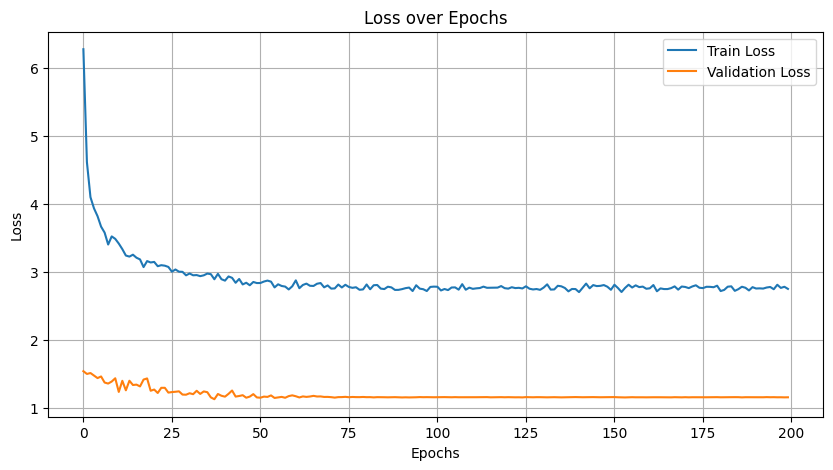

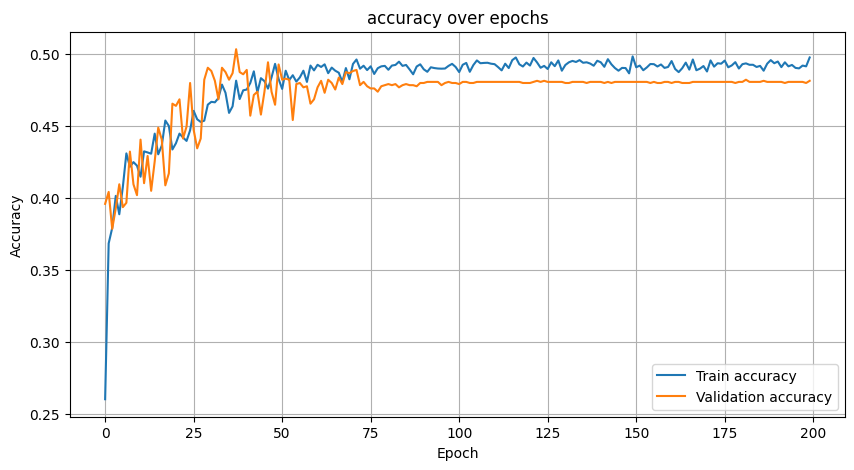

331/331 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.68482554 0.36906242 0.11652852 0.24516129 0.16326531]
Precision (per class): [0.8017341  0.77130977 0.06236952 0.20652174 0.09174312]
Recall (per class): [0.59767308 0.24256293 0.88518519 0.3015873  0.74074074]
Accuracy: 0.4956
AUC (One-vs-Rest): 0.8284

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.60      0.68      6962
           D       0.77      0.24      0.37      3059
           C       0.06      0.89      0.12       270
           B       0.21      0.30      0.25       252
           A       0.09      0.74      0.16        27

    accuracy                           0.50     10570
   macro avg       0.39      0.55      0.32     10570
weighted avg       0.76      0.50      0.57     10570



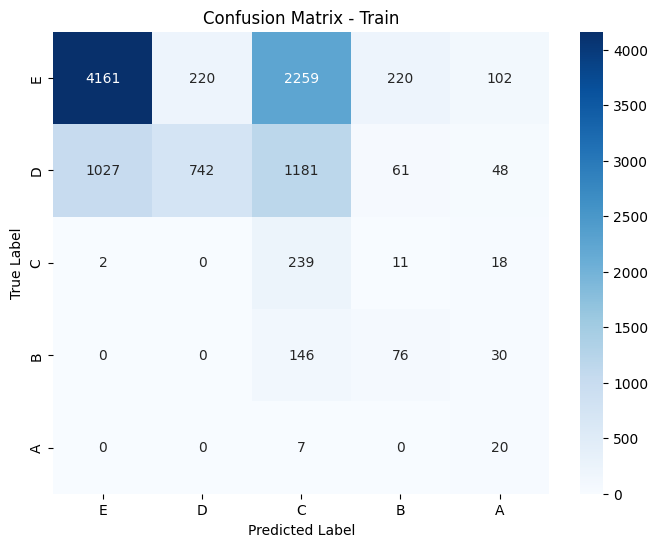

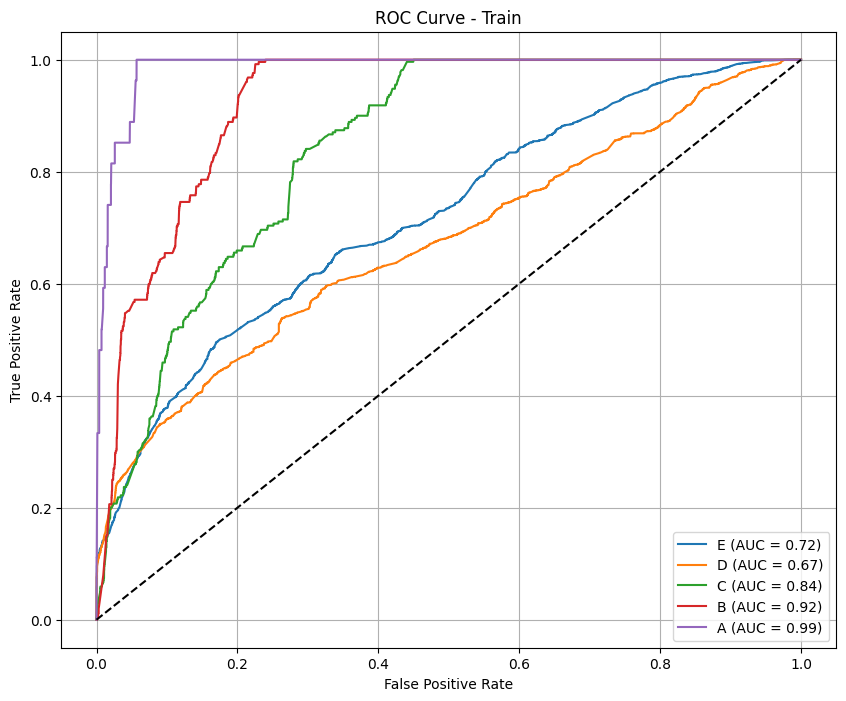

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.79560037 0.33846154 0.025      0.03278689 0.2       ]
Precision (per class): [0.91368421 0.26506024 0.01666667 0.02222222 0.2       ]
Recall (per class): [0.70454545 0.46808511 0.05       0.0625     0.2       ]
Accuracy: 0.6376
AUC (One-vs-Rest): 0.7213

Classification Report:
              precision    recall  f1-score   support

           E       0.91      0.70      0.80       616
           D       0.27      0.47      0.34        94
           C       0.02      0.05      0.03        20
           B       0.02      0.06      0.03        16
           A       0.20      0.20      0.20        10

    accuracy                           0.64       756
   macro avg       0.28      0.30      0.28       756
weighted avg       0.78      0.64      0.69       756



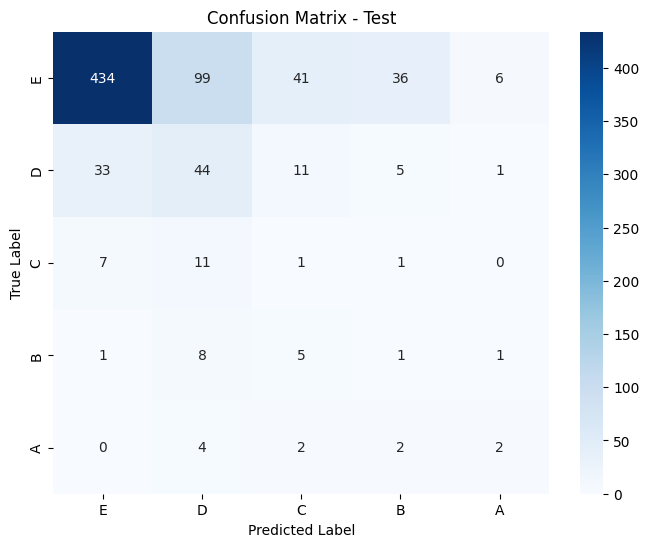

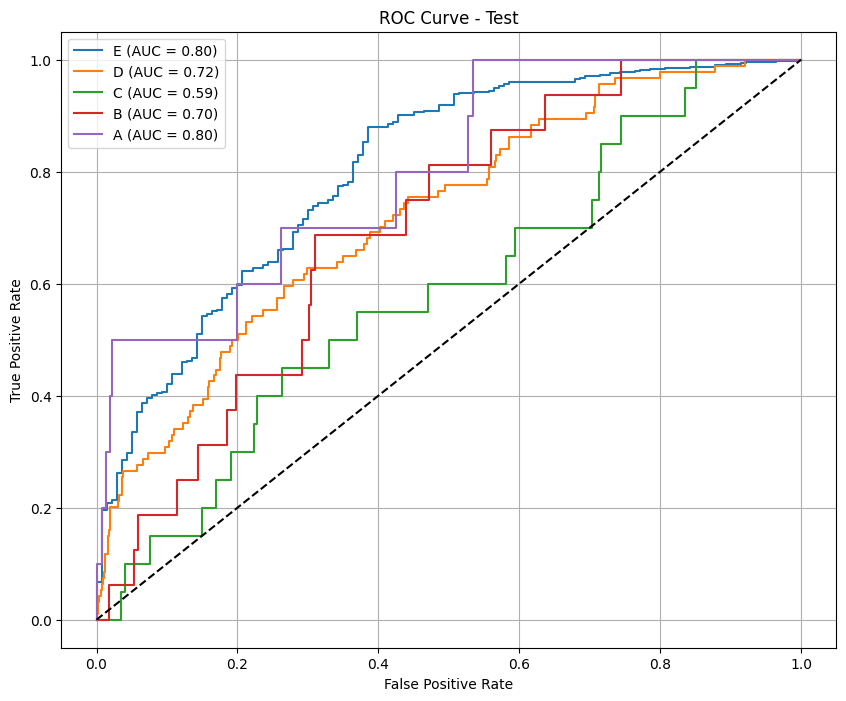

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_standard.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


315/331 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


331/331 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

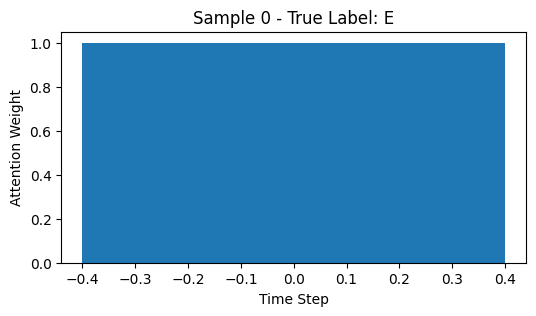

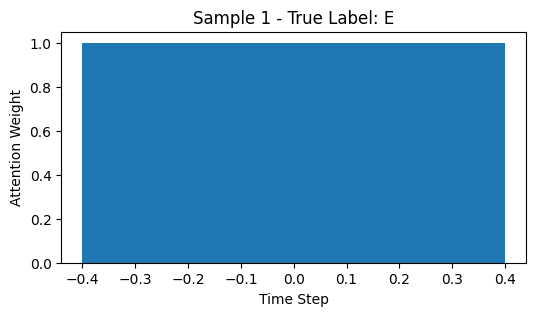

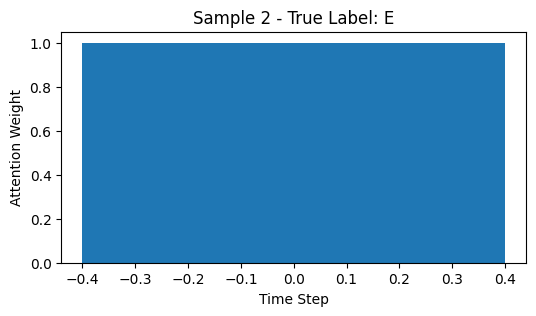

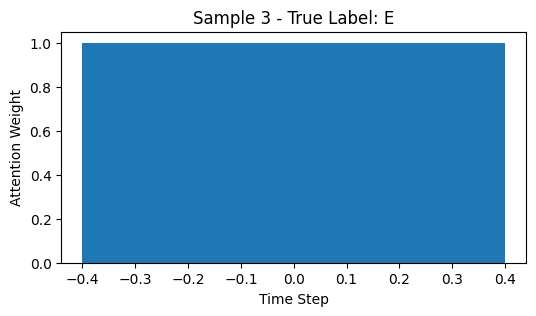

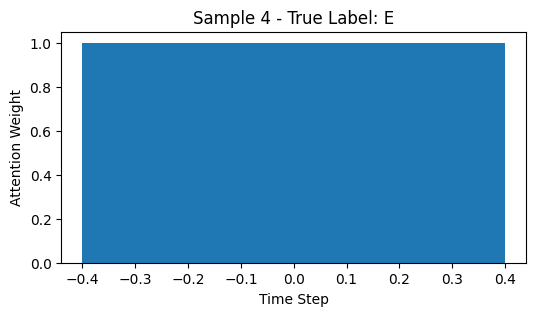

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_2           │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_4 (Dropout)       │ (None, 2, 128)         │              0 │ bidirectional_2[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_3           │ (None, 2, 64)          │         41,216 │ dropout_4[0][0]        │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_3[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_3[0][0], │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_7 (Dense)           │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_2     │ (None, 64)             │            256 │ dense_7[0][0]          │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_6 (Dense)           │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_6 (Dropout)       │ (None, 64)             │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_5 (Dropout)       │ (None, 64)             │              0 │ dense_6[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_8 (Dense)           │ (None, 32)             │          2,080 │ dropout_6[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_1             │ (None, 96)             │              0 │ dropout_5[0][0],       │
│ (Concatenate)             │                        │                │ dense_8[0][0]          │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 41ms/step

Epoch 1: val_f1_macro = 0.1714
117/117 ━━━━━━━━━━━━━━━━━━━━ 20s 49ms/step - accuracy: 0.2357 - loss: 7.5614 - val_accuracy: 0.3396 - val_loss: 1.5794 - val_f1_macro: 0.1714 - learning_rate: 0.0010
Epoch 2/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.1707
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.3349 - loss: 5.1209 - val_accuracy: 0.3966 - val_loss: 1.5943 - val_f1_macro: 0.1707 - learning_rate: 0.0010
Epoch 3/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.2201
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.3971 - loss: 4.2120 - val_accuracy: 0.3573 - val_loss: 1.6390 - val_f1_macro: 0.2201 - learning_rate: 0.0010
Epoch 4/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2372
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.3989 - loss: 4.0275 - val_accuracy: 0.3489 - val_loss: 1.7289 - val_f1_macro: 0.2372 - learning_rate: 0.0010
Epoch 

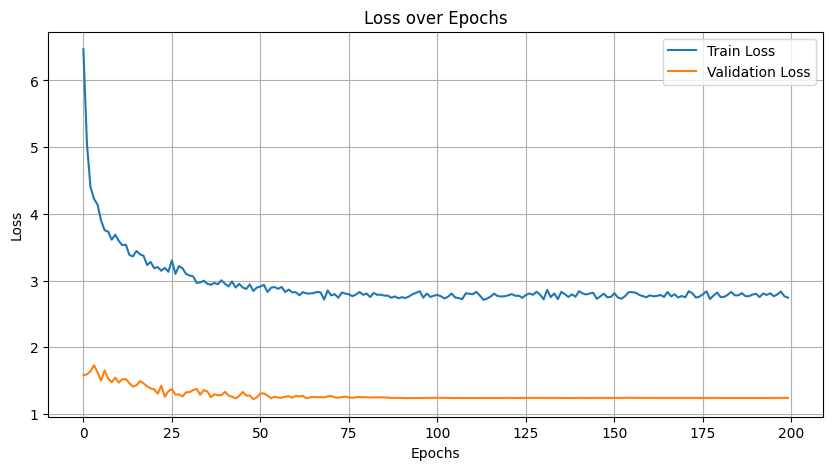

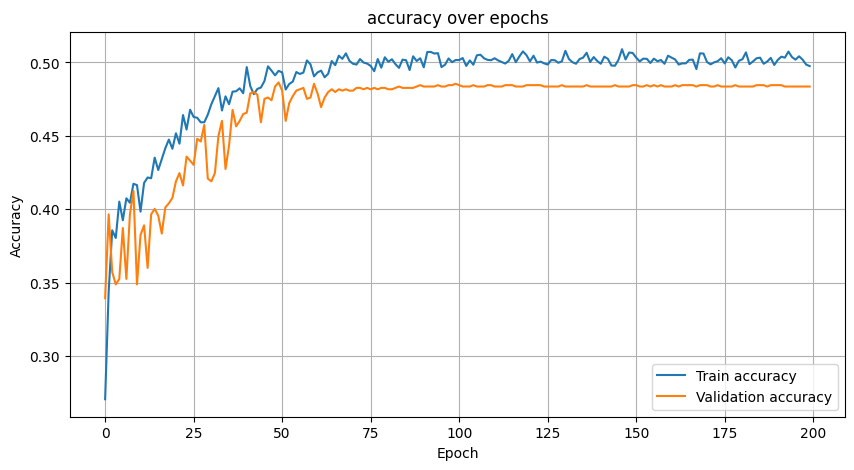

268/268 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.70977067 0.22728819 0.13510348 0.25697211 0.18691589]
Precision (per class): [0.77406473 0.6733871  0.07421707 0.16666667 0.10582011]
Recall (per class): [0.65533808 0.13671715 0.75217391 0.56086957 0.8       ]
Accuracy: 0.5076
AUC (One-vs-Rest): 0.8171

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.66      0.71      5620
           D       0.67      0.14      0.23      2443
           C       0.07      0.75      0.14       230
           B       0.17      0.56      0.26       230
           A       0.11      0.80      0.19        25

    accuracy                           0.51      8548
   macro avg       0.36      0.58      0.30      8548
weighted avg       0.71      0.51      0.54      8548



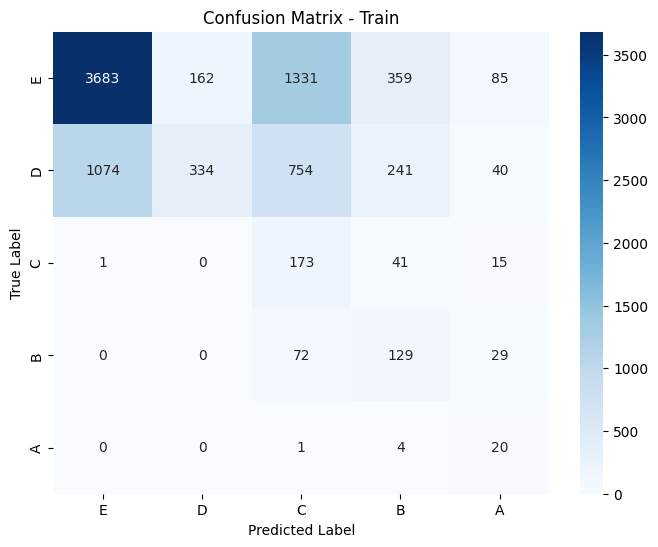

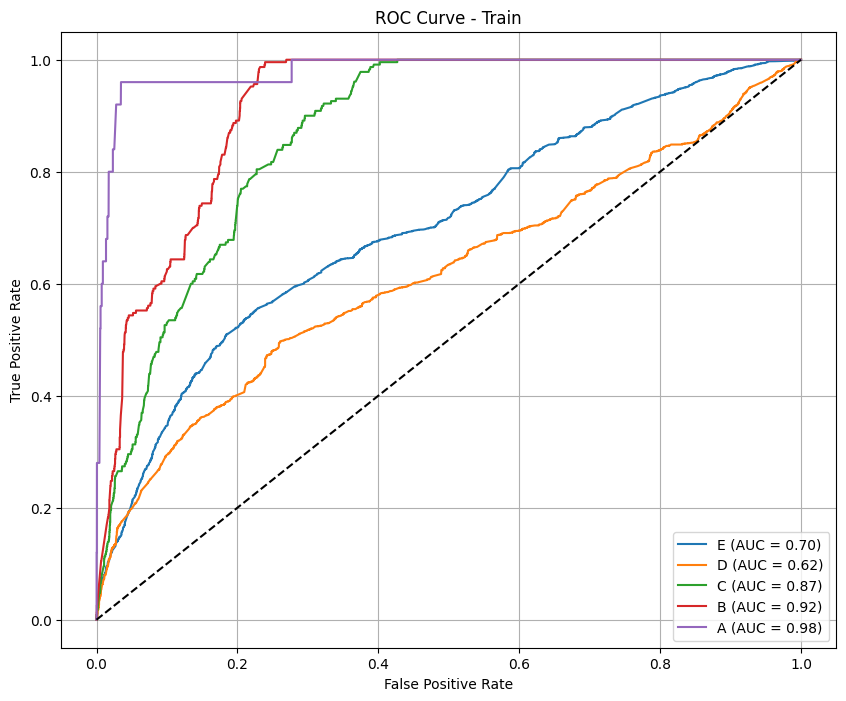

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.85621446 0.17894737 0.10810811 0.16666667 0.        ]
Precision (per class): [0.84726688 0.17346939 0.11764706 0.22222222 0.        ]
Recall (per class): [0.86535304 0.18478261 0.1        0.13333333 0.        ]
Accuracy: 0.7346
AUC (One-vs-Rest): 0.6542

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.87      0.86       609
           D       0.17      0.18      0.18        92
           C       0.12      0.10      0.11        20
           B       0.22      0.13      0.17        15
           A       0.00      0.00      0.00        10

    accuracy                           0.73       746
   macro avg       0.27      0.26      0.26       746
weighted avg       0.72      0.73      0.73       746



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


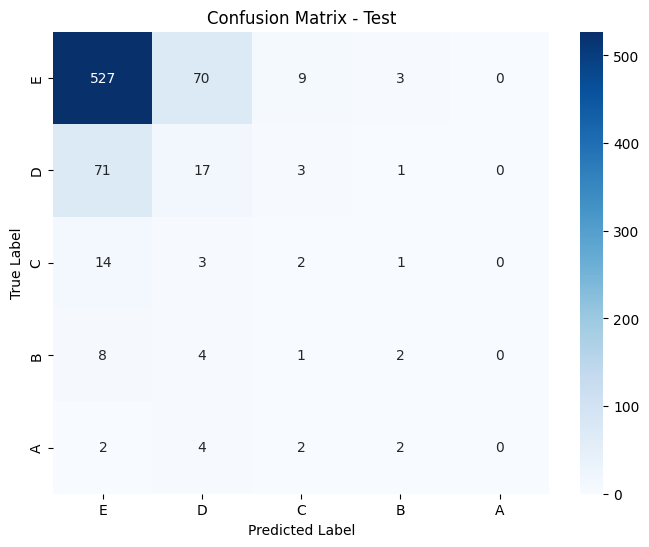

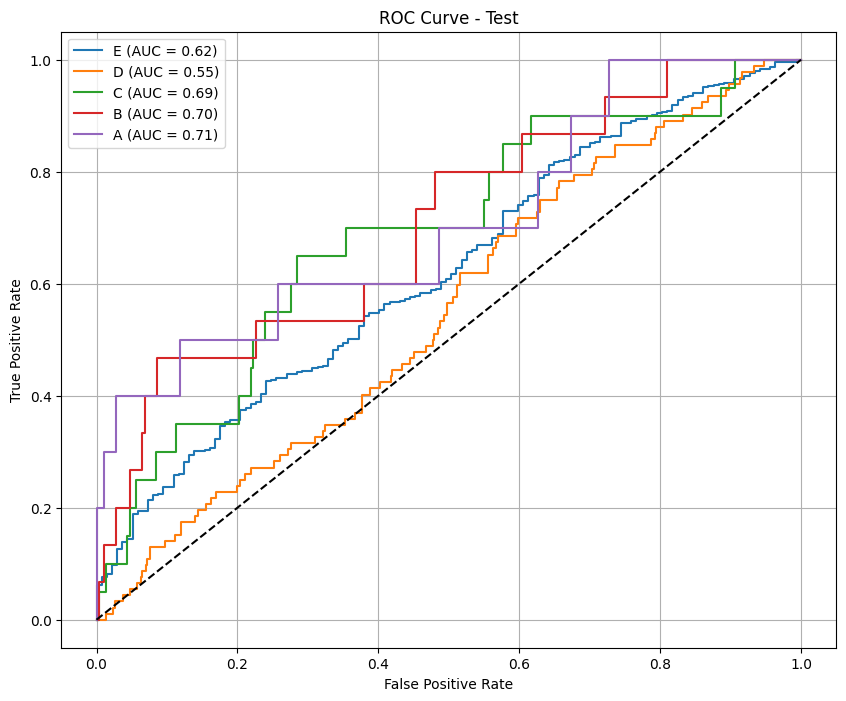

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_standard.csv
268/268 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.5272483 ]
 [0.47275162]
 [0.52617174]
 [0.47382832]
 [0.82967424]
 [0.1703258 ]
 [0.5272483 ]
 [0.47275162]
 [0.44051757]
 [0.55948246]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.58650863]
 [0.41349137]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5261671 ]
 [0.47383294]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.50032926]
 [0.49967077]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.36371413]
 [0.63628596]
 [0.28315148]
 [0.71684855]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.48803717]
 [0.5119629 ]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5272483 ]
 [0.47275162]
 [0.5109071 ]
 [0.4890928 ]
 [0.

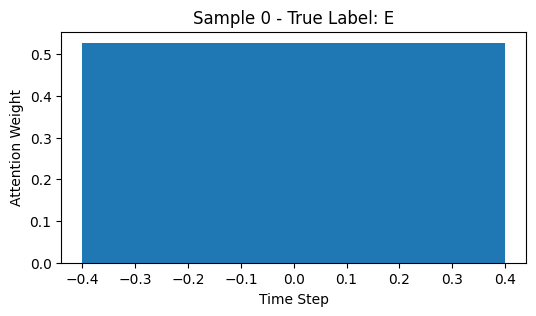

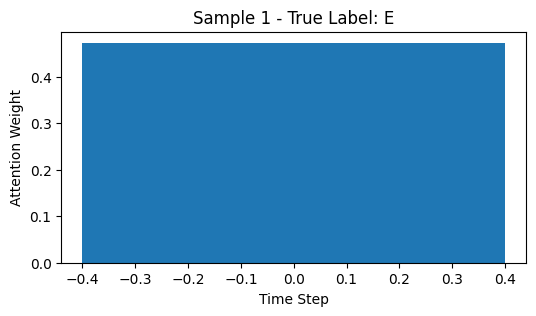

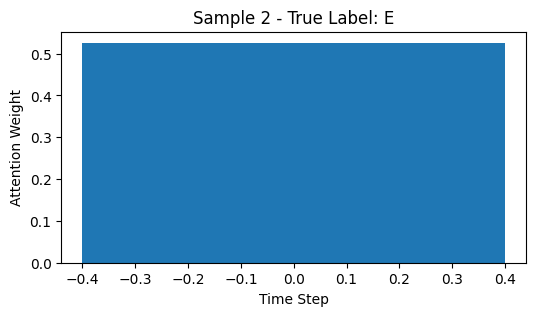

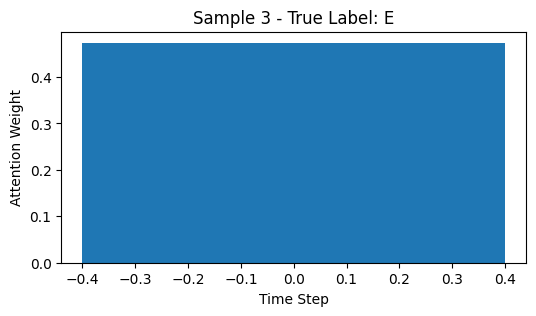

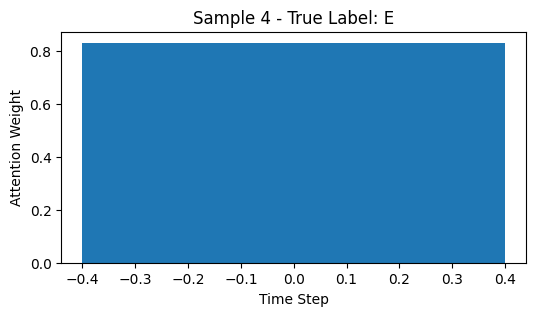

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_4           │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_8 (Dropout)       │ (None, 3, 128)         │              0 │ bidirectional_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_5           │ (None, 3, 64)          │         41,216 │ dropout_8[0][0]        │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_5[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_5[0][0], │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_13 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_4     │ (None, 64)             │            256 │ dense_13[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_12 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_10 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_9 (Dropout)       │ (None, 64)             │              0 │ dense_12[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_14 (Dense)          │ (None, 32)             │          2,080 │ dropout_10[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_2             │ (None, 96)             │              0 │ dropout_9[0][0],       │
│ (Concatenate)             │                        │                │ dense_14[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 40ms/step

Epoch 1: val_f1_macro = 0.2510
107/107 ━━━━━━━━━━━━━━━━━━━━ 20s 54ms/step - accuracy: 0.2401 - loss: 9.6944 - val_accuracy: 0.4887 - val_loss: 1.2977 - val_f1_macro: 0.2510 - learning_rate: 0.0010
Epoch 2/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2740
107/107 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.3333 - loss: 4.9791 - val_accuracy: 0.4170 - val_loss: 1.5907 - val_f1_macro: 0.2740 - learning_rate: 0.0010
Epoch 3/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2611
107/107 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.3724 - loss: 4.4698 - val_accuracy: 0.4160 - val_loss: 1.5515 - val_f1_macro: 0.2611 - learning_rate: 0.0010
Epoch 4/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2910
107/107 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.3686 - loss: 4.0850 - val_accuracy: 0.3945 - val_loss: 1.7218 - val_f1_macro: 0.2910 - learning_rate: 0.0010
Epoch 

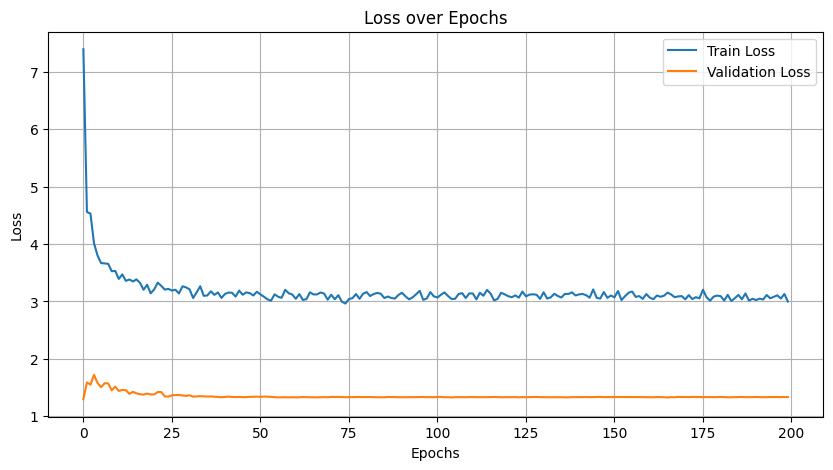

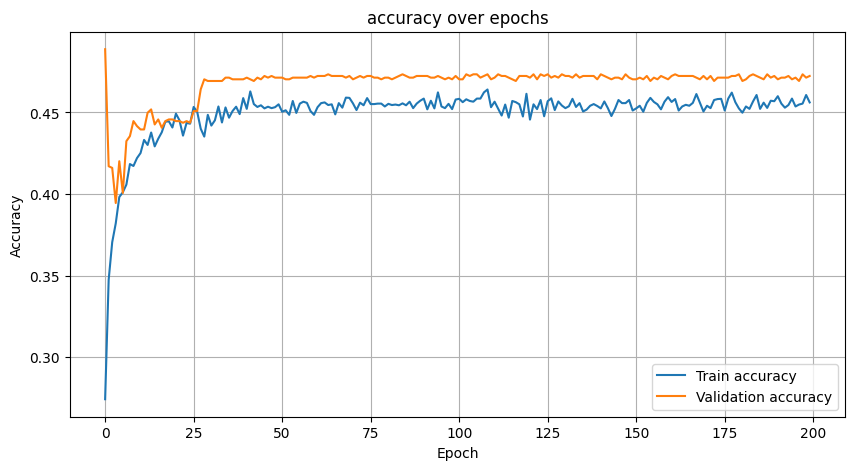

244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.64947997 0.22165326 0.09610829 0.36190476 0.12048193]
Precision (per class): [0.74987225 0.63924051 0.05141202 0.26950355 0.06521739]
Recall (per class): [0.57279469 0.1340708  0.7357513  0.55072464 0.78947368]
Accuracy: 0.4497
AUC (One-vs-Rest): 0.7897

Classification Report:
              precision    recall  f1-score   support

           E       0.75      0.57      0.65      5124
           D       0.64      0.13      0.22      2260
           C       0.05      0.74      0.10       193
           B       0.27      0.55      0.36       207
           A       0.07      0.79      0.12        19

    accuracy                           0.45      7803
   macro avg       0.36      0.56      0.29      7803
weighted avg       0.69      0.45      0.50      7803



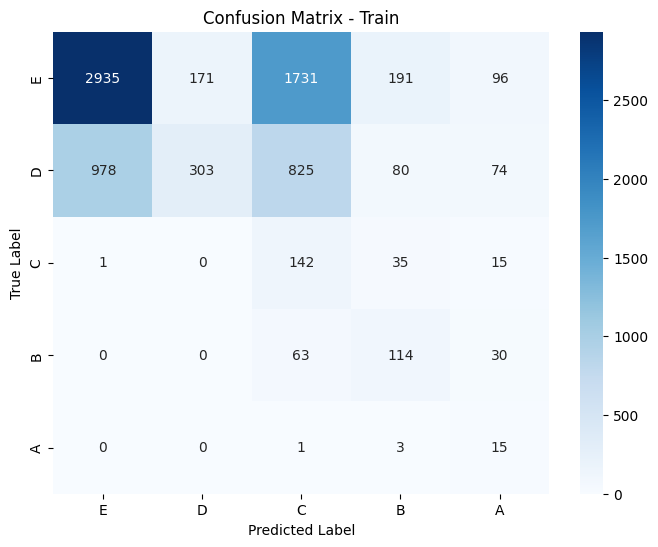

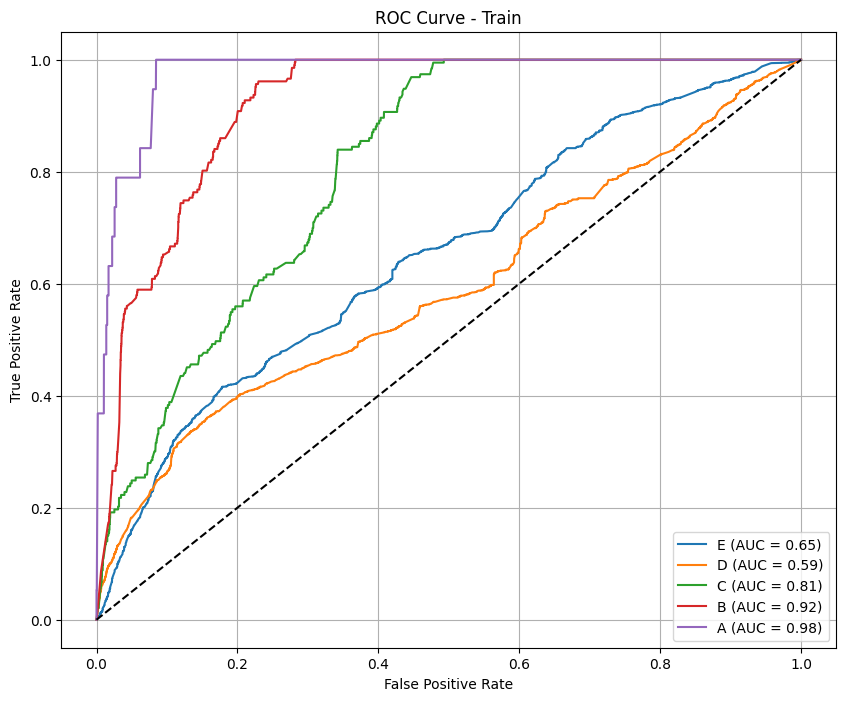

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.81282496 0.13333333 0.03539823 0.         0.        ]
Precision (per class): [0.82862191 0.1875     0.02150538 0.         0.        ]
Recall (per class): [0.79761905 0.10344828 0.1        0.         0.        ]
Accuracy: 0.6657
AUC (One-vs-Rest): 0.5631

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.80      0.81       588
           D       0.19      0.10      0.13        87
           C       0.02      0.10      0.04        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.67       721
   macro avg       0.21      0.20      0.20       721
weighted avg       0.70      0.67      0.68       721



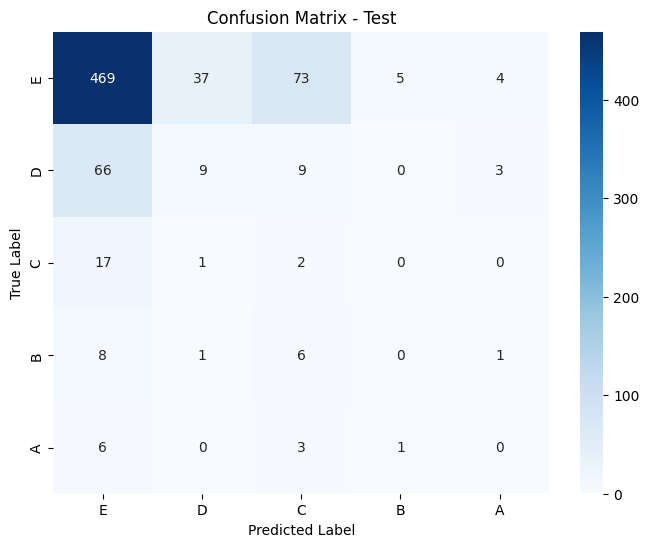

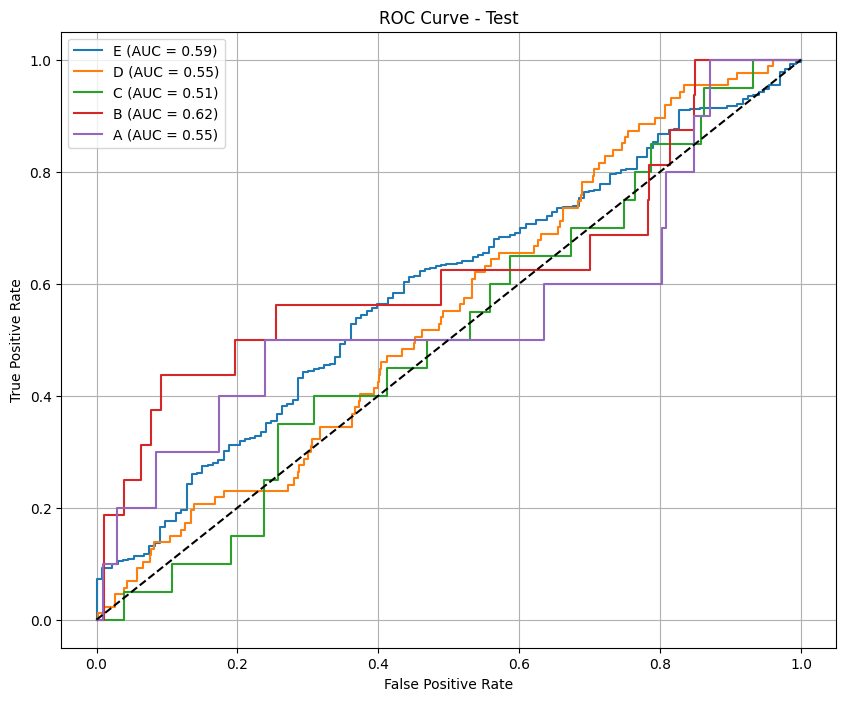

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_standard.csv
244/244 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33425415]
 [0.33668798]
 [0.32905793]
 [0.33073825]
 [0.33781382]
 [0.33144793]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33391875]
 [0.33320317]
 [0.33287808]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.3340845 ]
 [0.3332648 ]
 [0.33265066]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.33269185]
 [0.33403277]
 [0.33327535]
 [0.

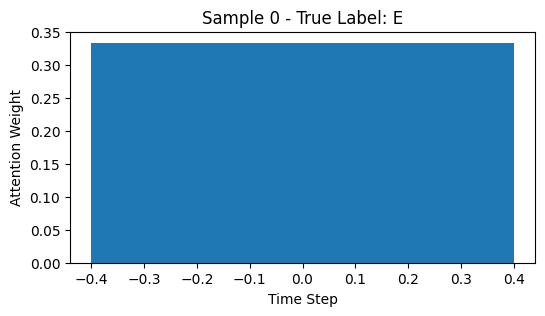

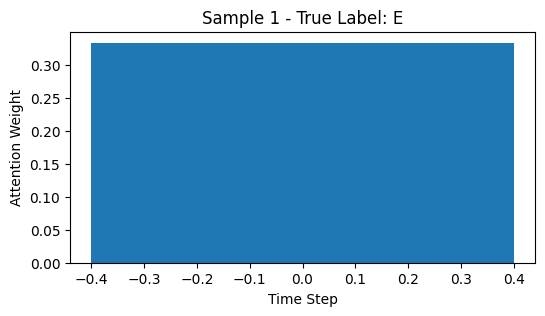

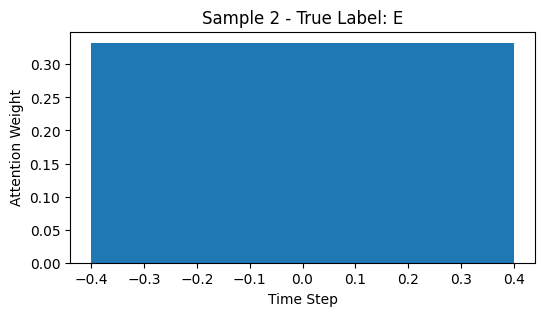

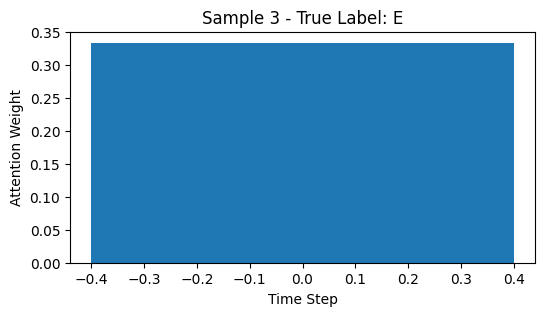

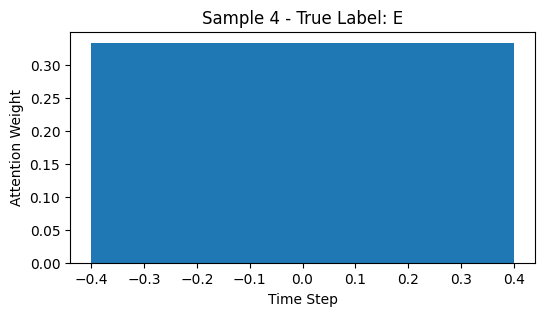

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_6           │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_12 (Dropout)      │ (None, 4, 128)         │              0 │ bidirectional_6[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_7           │ (None, 4, 64)          │         41,216 │ dropout_12[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_7[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_7[0][0], │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_19 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_6     │ (None, 64)             │            256 │ dense_19[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_18 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_14 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_6… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_13 (Dropout)      │ (None, 64)             │              0 │ dense_18[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_20 (Dense)          │ (None, 32)             │          2,080 │ dropout_14[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_3             │ (None, 96)             │              0 │ dropout_13[0][0],      │
│ (Concatenate)             │                        │                │ dense_20[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 61ms/step

Epoch 1: val_f1_macro = 0.1864
74/74 ━━━━━━━━━━━━━━━━━━━━ 21s 79ms/step - accuracy: 0.2713 - loss: 8.1292 - val_accuracy: 0.5320 - val_loss: 1.0691 - val_f1_macro: 0.1864 - learning_rate: 0.0010
Epoch 2/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1754
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.3346 - loss: 4.5652 - val_accuracy: 0.4173 - val_loss: 1.2723 - val_f1_macro: 0.1754 - learning_rate: 0.0010
Epoch 3/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step

Epoch 3: val_f1_macro = 0.2982
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.3766 - loss: 4.1755 - val_accuracy: 0.4918 - val_loss: 1.4169 - val_f1_macro: 0.2982 - learning_rate: 0.0010
Epoch 4/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2640
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4152 - loss: 4.0405 - val_accuracy: 0.4694 - val_loss: 1.3473 - val_f1_macro: 0.2640 - learning_rate: 0.0010
Epoch 5/200
21

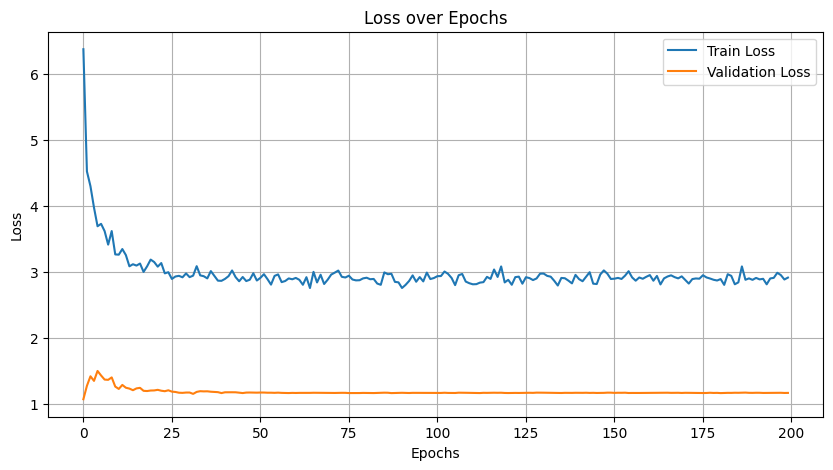

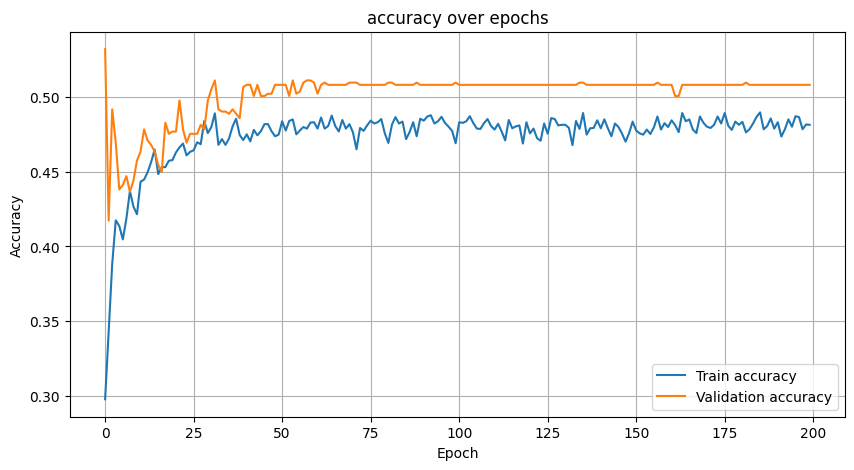

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.65818355 0.35557629 0.07883566 0.3559633  0.19607843]
Precision (per class): [0.7442446  0.67914439 0.04198966 0.25129534 0.11363636]
Recall (per class): [0.58996293 0.24083439 0.64356436 0.61006289 0.71428571]
Accuracy: 0.4889
AUC (One-vs-Rest): 0.8047

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.59      0.66      3507
           D       0.68      0.24      0.36      1582
           C       0.04      0.64      0.08       101
           B       0.25      0.61      0.36       159
           A       0.11      0.71      0.20        14

    accuracy                           0.49      5363
   macro avg       0.37      0.56      0.33      5363
weighted avg       0.70      0.49      0.55      5363



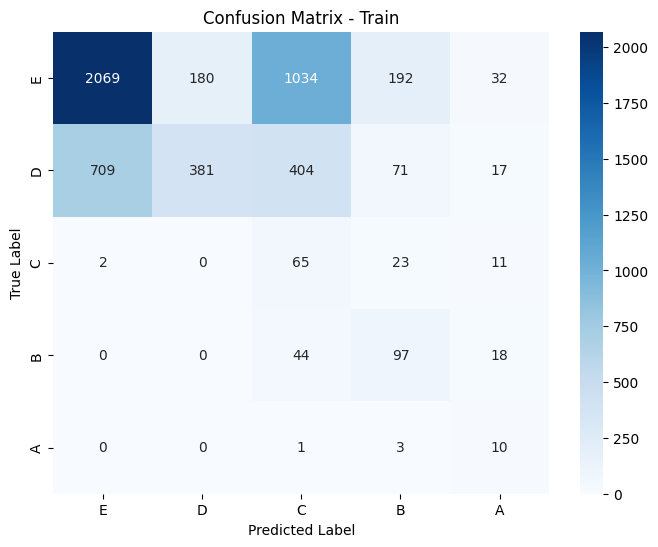

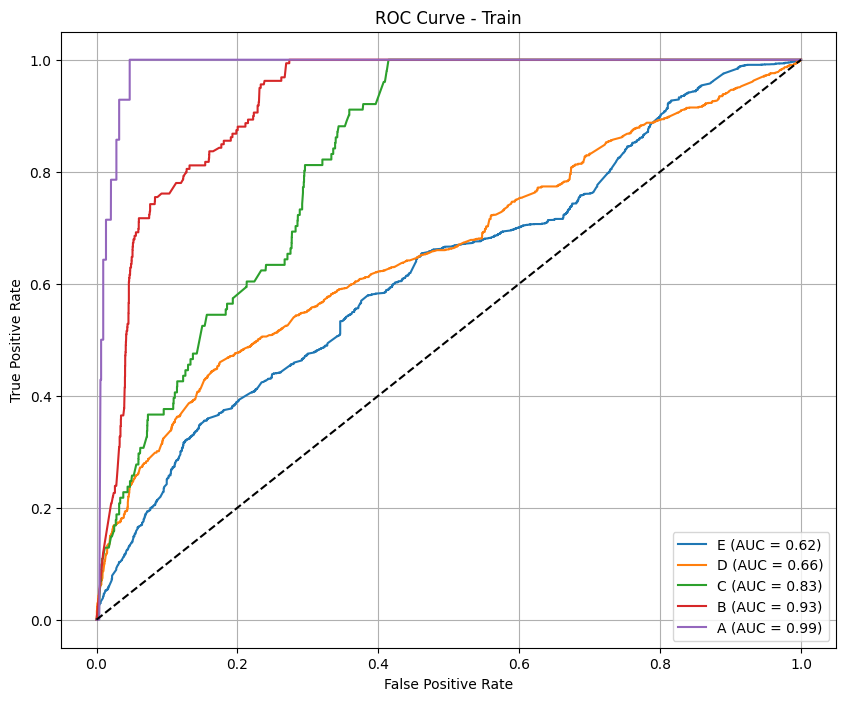

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.62287656 0.         0.03738318 0.04878049 0.        ]
Precision (per class): [0.83841463 0.         0.02040816 0.02739726 0.        ]
Recall (per class): [0.4954955  0.         0.22222222 0.22222222 0.        ]
Accuracy: 0.4119
AUC (One-vs-Rest): 0.5900

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.50      0.62       555
           D       0.00      0.00      0.00        85
           C       0.02      0.22      0.04        18
           B       0.03      0.22      0.05        18
           A       0.00      0.00      0.00        11

    accuracy                           0.41       687
   macro avg       0.18      0.19      0.14       687
weighted avg       0.68      0.41      0.51       687



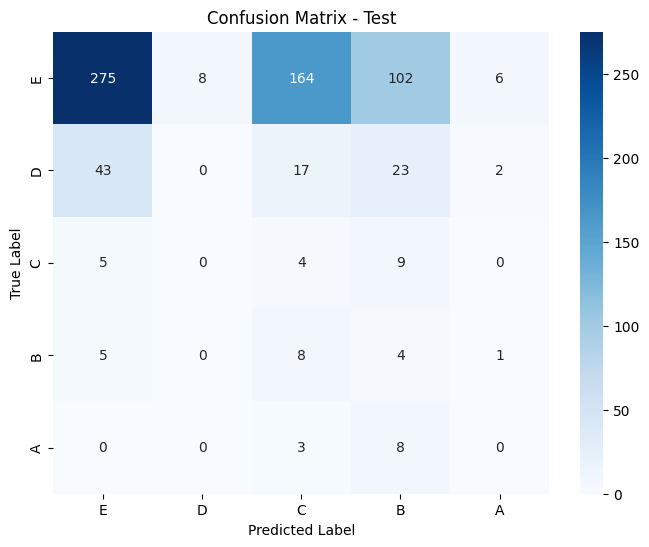

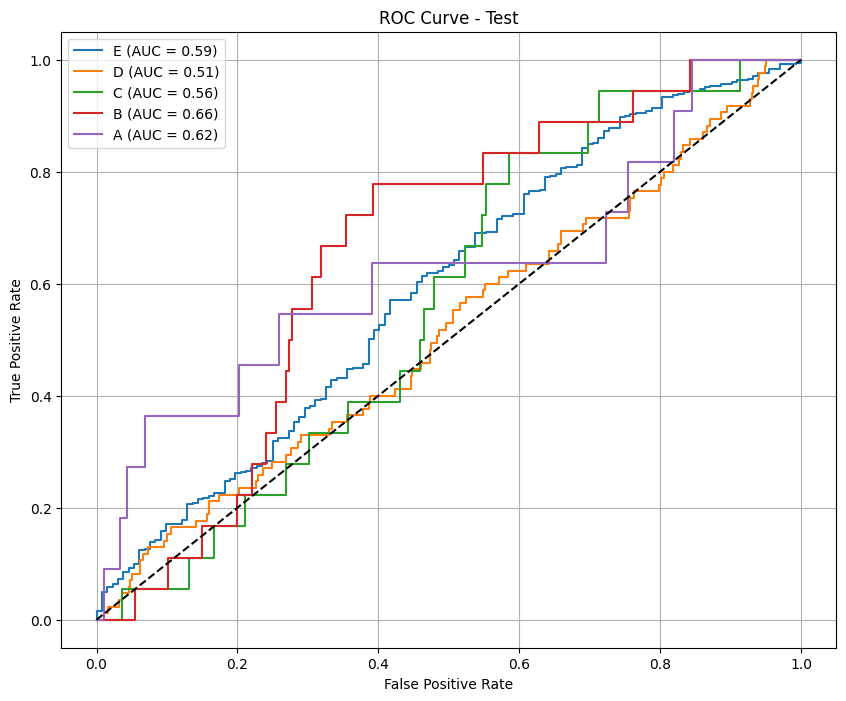

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Results saved: lstm_results_phase4_standard.csv
168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
[[0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.26626727]
 [0.26869705]
 [0.24273618]
 [0.22229949]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27239498]
 [0.25278425]
 [0.24419448]
 [0.23062626]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0.24386613]
 [0.22975343]
 [0.27241495]
 [0.2539655 ]
 [0

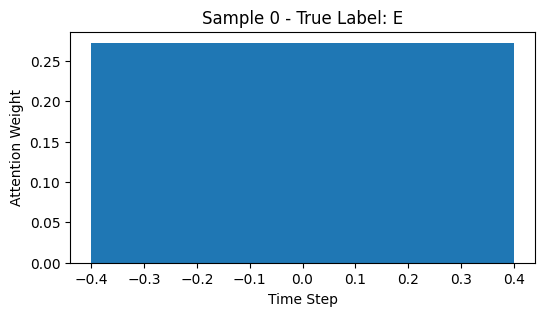

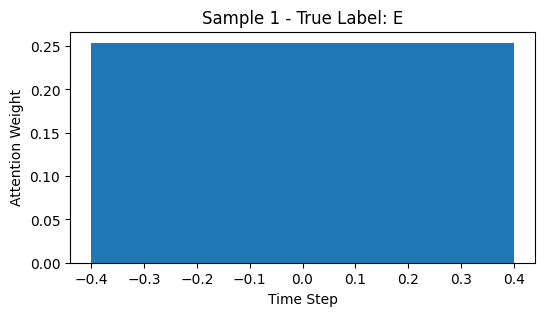

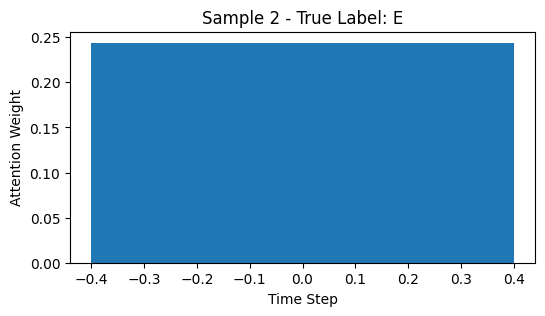

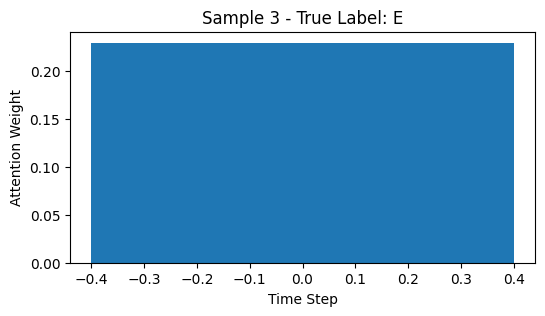

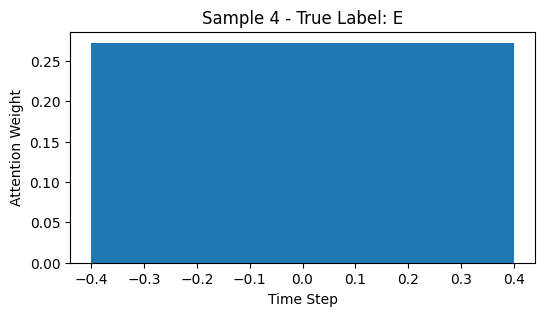

In [19]:
for phase in ["phase1", "phase2", "phase3", "phase4" ]:
    process_phase(phase, scale='standard', metric='f1_macro')

## Xử lý imbalance

### Phân phối các nhãn

In [20]:
# Đọc dữ liệu
def plot_label(phase):
    # Đọc dữ liệu từ các file CSV
    phase_ = phase[:-1] + '_' + phase[-1]
    X_train = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_train.csv")
    X_test = pd.read_csv(f"/kaggle/input/final-data/{phase}/user_train_{phase_}_test.csv")

    count_map = X_train['school'].value_counts().to_dict()
    X_train['school'] = X_train['school'].map(count_map)
    X_test['school'] = X_test['school'].map(count_map)

    # Fill nan = 0
    X_train = X_train.fillna(0)
    X_test = X_test.fillna(0)
    
    # Loại bỏ các cột không cần thiết trong X
    columns_to_drop = ['course_id', 'user_id', 'total_score', 'label']
    X_train = X_train.drop(columns=columns_to_drop, axis=1)
    X_test = X_test.drop(columns=columns_to_drop, axis=1)
    
    # Lấy nhãn (target) từ cột 'label_encoded'
    y_train = X_train.pop("label_encoded")
    y_test = X_test.pop("label_encoded")

    # Đếm số lượng mỗi class
    value_counts = y_train.value_counts()
    print(value_counts)
    
    # Vẽ biểu đồ
    value_counts.plot(kind='bar', figsize=(8, 6), color='skyblue', edgecolor='black')
    
    # Thêm tiêu đề và nhãn trục
    plt.title(f"Distribution of y_train labels in {phase}")
    plt.xlabel("Class")
    plt.ylabel("Count")
    
    # Hiển thị
    plt.show()
    
    return X_train, y_train, X_test, y_test

label_encoded
0    6962
1    3059
2     270
3     252
4      27
Name: count, dtype: int64


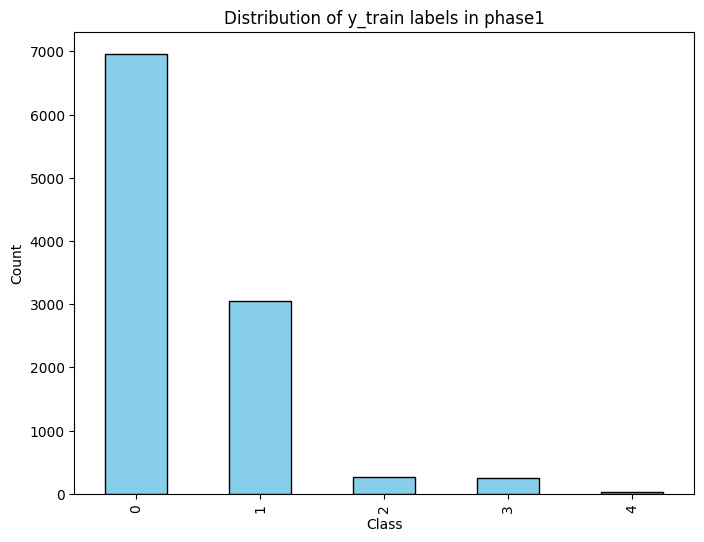

label_encoded
0    5620
1    2443
2     230
3     230
4      25
Name: count, dtype: int64


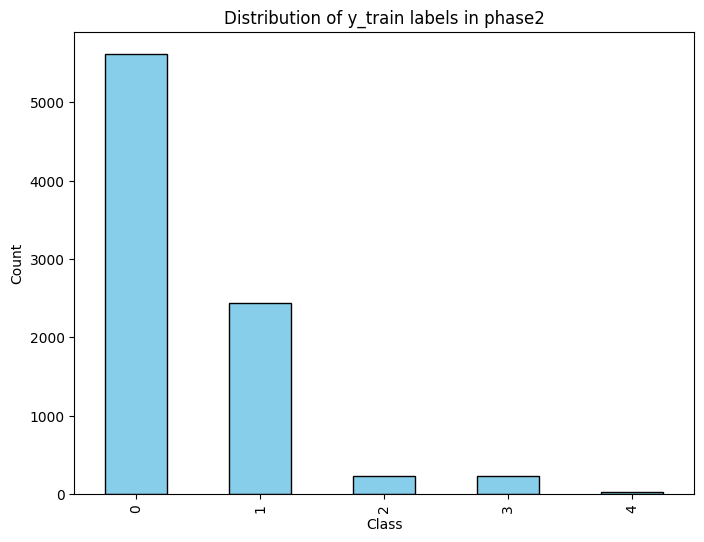

label_encoded
0    5124
1    2260
3     207
2     193
4      19
Name: count, dtype: int64


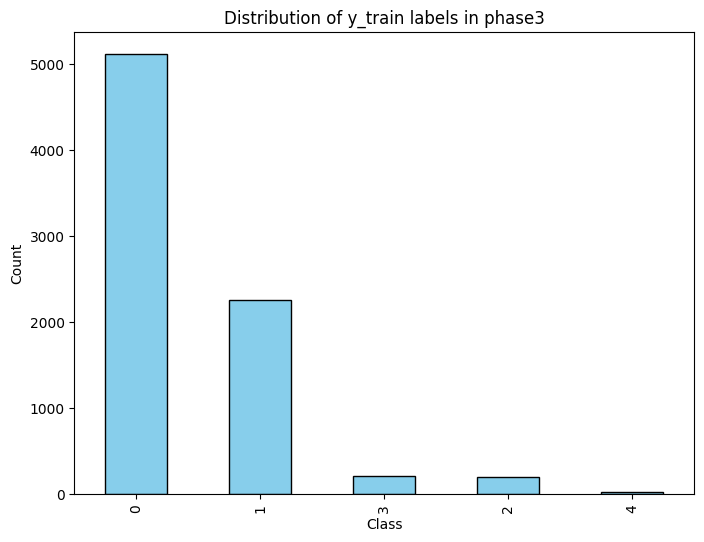

label_encoded
0    3507
1    1582
3     159
2     101
4      14
Name: count, dtype: int64


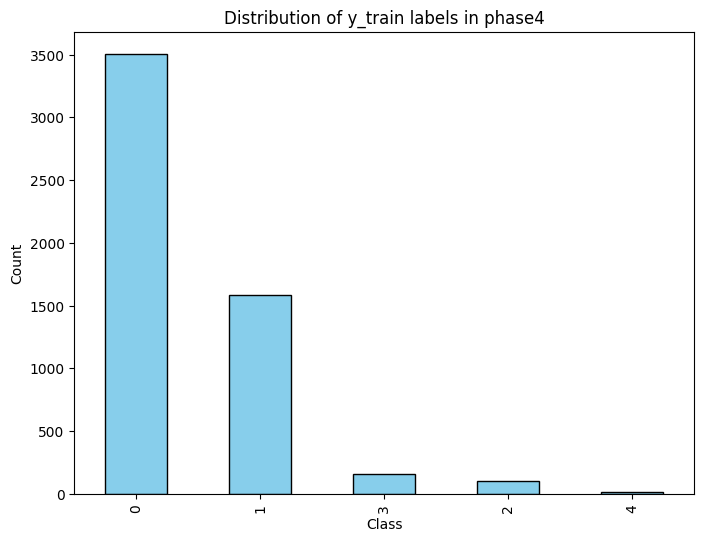

In [21]:
# Lặp qua các phase
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    plot_label(phase)

### Undersampling

In [22]:
import pandas as pd

def manual_custom_undersample_decrease(X, y, class_decrease_counts):
    """
    Undersample bằng cách giảm bớt một số lượng mẫu xác định cho từng class.

    Args:
        X (pd.DataFrame): Features.
        y (pd.Series): Labels.
        class_decrease_counts (dict): Dict {class_label: decrease_number}.

    Returns:
        (X_resampled, y_resampled): Dữ liệu sau undersample.
    """
    df = pd.concat([X, y], axis=1)
    resampled_parts = []

    for cls in y.unique():
        df_cls = df[df[y.name] == cls]
        if cls in class_decrease_counts:
            decrease_count = class_decrease_counts[cls]
            target_count = max(len(df_cls) - decrease_count, 1)  # Đảm bảo ít nhất còn 1 mẫu
            if len(df_cls) > target_count:
                df_cls = df_cls.sample(n=target_count, random_state=42)
        # Nếu class không cần giảm thì giữ nguyên
        resampled_parts.append(df_cls)

    df_resampled = pd.concat(resampled_parts).sample(frac=1, random_state=42)  # shuffle
    X_resampled = df_resampled.drop(columns=[y.name])
    y_resampled = df_resampled[y.name]

    return X_resampled, y_resampled


In [23]:
from tensorflow.keras.callbacks import ReduceLROnPlateau

lr_schedule = ReduceLROnPlateau(
    monitor='val_loss',     # what to monitor
    factor=0.5,             # reduce learning rate by this factor
    patience=8,             # wait for 4 epochs of no improvement
    verbose=1               # print when it changes the learning rate
)

# Đọc và xử lý dữ liệu cho từng phase
def process_undersample_phase(phase, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)
    # Undersampling
    cls_count = {
        0: 2000,
        1: 1000,
        2: 0,
        3: 0,
        4: 0
    }
    X_train, y_train = manual_custom_undersample_decrease(X_train, y_train, cls_count)
    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

    # Ensure y_train and y_test are NumPy arrays before reshaping
    y_train = np.array(y_train).reshape(-1, 1)  # Reshaping to 2D array
    y_test = np.array(y_test).reshape(-1, 1)
    
    # Fit the encoder and transform y_train and y_test
    # encoder.fit(y_train)
    # y_train_encoded = encoder.transform(y_train)
    # y_test_encoded = encoder.transform(y_test)

    # Extract features for sequence (time steps)
    # Extract features for sequence (time steps)
    phase_num = int(phase[-1])  # Extract phase number (phase1 -> 1, phase2 -> 2, etc.)
    
    # Extract sequence features (excluding static features)
    seq_features = []
    for i in range(1, phase_num + 1):
        step_features = [col for col in X_train.columns if col not in static_features and col.endswith(f"{i}")]
        seq_features.append(step_features)
    
    # Flatten the list of sequence features
    seq_features = [feat for sublist in seq_features for feat in sublist]
    
    # Function to reshape sequence data [samples, time steps, features]
    def reshape_sequence(df):
        sequence_data = []
        for i in range(1, phase_num + 1):
            # Filter columns that end with the current time step index
            step_features = [col for col in df.columns if col.endswith(f"{i}") and col not in static_features]
            step_features = list(sorted(step_features))  # Optional: consistent order
            # print(f"Time step {i}: {len(step_features)} features\n{step_features}")
            sequence_data.append(df[step_features].astype(np.float32).to_numpy(copy=True))
        return np.stack(sequence_data, axis=1)
    
    # Reshape sequence data for training and testing
    X_train_seq = reshape_sequence(X_train_scaled)
    X_test_seq = reshape_sequence(X_test_scaled)
    
    # Extract static features for training and testing (static features stay the same across all time steps)
    X_static_train = X_train_scaled[static_features].values
    X_static_test = X_test_scaled[static_features].values

    # Define model
    num_classes = len(np.unique(y_train))
    model = build_stable_attention_model(
        seq_input_shape=X_train_seq.shape[1:], 
        static_input_shape=X_static_train.shape[1], 
        num_classes=num_classes
    )

    # Stratified split (đồng thời cho sequence và static)
    skf = StratifiedKFold(n_splits=8, shuffle=True, random_state=42)
    for train_idx, val_idx in skf.split(X_train_seq, y_train):
        X_tr_seq, X_val_seq = X_train_seq[train_idx], X_train_seq[val_idx]
        X_tr_static, X_val_static = X_static_train[train_idx], X_static_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        break  # Dùng fold đầu tiên

    # Class weights
    # class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
    # class_weight_dict = dict(enumerate(class_weights))
    # print(class_weight_dict)

    f1_callback = F1MacroCallback(validation_data=([X_val_seq, X_val_static], y_val))
    
    # Train model
    history = model.fit(
        [X_tr_seq, X_tr_static], y_tr,
        validation_data=([X_val_seq, X_val_static], y_val),
        epochs=200,
        batch_size=64,
        callbacks=[f1_callback, lr_schedule],
        # callbacks=[f1_callback, EarlyStopping(patience=5, restore_best_weights=True)],
        # class_weight=class_weight_dict,
        class_weight={0: 1.0, 1: 1.0, 2: 50.0, 3: 25, 4: 80},
        verbose=1
    )

    plot_train_valid(history, metric='accuracy')

    # Evaluate model
    evaluations = evaluate_model(model, [X_train_seq, X_static_train], y_train, [X_test_seq, X_static_test], y_test)

    # Save test predictions
    y_pred = np.argmax(model.predict([X_test_seq, X_static_test]), axis=1)
    results_df = X_test.copy()
    results_df["True_Label"] = y_test
    results_df["Predicted_Label"] = y_pred
    results_df.to_csv(f"lstm_results_{phase}_{scale}.csv", index=False)
    print(f"Results saved: lstm_results_{phase}_{scale}.csv")

    # Extract attention weights from trained model
    # attention_extractor = Model(
    #     inputs=model.input,
    #     outputs=model.get_layer("attention_2").output[1]  # Correct the layer name to "attention_2"
    # )
    # att_weights = attention_extractor.predict([X_train_seq, X_static_train])
    # print(att_weights)

    # model.get_layer("attention").output[1]
    
    attention_model = tf.keras.Model(
        inputs=model.input,
        outputs=model.get_layer("attention_weights").output[1]  # get attention weights
    )
    
    attention_weights = attention_model.predict([X_train_seq, X_static_train])

    print(attention_weights)

    plot_attention_weights(attention_weights, y_train, num_samples=5, class_names=["E", "D", "C", "B", "A"])
    
    return model

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_8"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_8           │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_16 (Dropout)      │ (None, 1, 128)         │              0 │ bidirectional_8[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_9           │ (None, 1, 64)          │         41,216 │ dropout_16[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_9[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_9[0][0], │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_25 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_8     │ (None, 64)             │            256 │ dense_25[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_24 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_18 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_8… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_17 (Dropout)      │ (None, 64)             │              0 │ dense_24[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_26 (Dense)          │ (None, 32)             │          2,080 │ dropout_18[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_4             │ (None, 96)             │              0 │ dropout_17[0][0],      │
│ (Concatenate)             │                        │                │ dense_26[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


104/104 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.1688 - loss: 7.7894

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


30/30 ━━━━━━━━━━━━━━━━━━━━ 3s 76ms/step

Epoch 1: val_f1_macro = 0.2253
104/104 ━━━━━━━━━━━━━━━━━━━━ 21s 55ms/step - accuracy: 0.1692 - loss: 7.7827 - val_accuracy: 0.3569 - val_loss: 1.7280 - val_f1_macro: 0.2253 - learning_rate: 0.0010
Epoch 2/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.2437
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3107 - loss: 5.5648 - val_accuracy: 0.4213 - val_loss: 1.6397 - val_f1_macro: 0.2437 - learning_rate: 0.0010
Epoch 3/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.2822
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3840 - loss: 5.0507 - val_accuracy: 0.3770 - val_loss: 1.8551 - val_f1_macro: 0.2822 - learning_rate: 0.0010
Epoch 4/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.2502
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.3286 - loss: 5.1874 - val_accuracy: 0.4372 - val_loss: 1.4803 - val_f1_macro: 0.2502 - learning_rate: 0.0010
Epoch 5/200
30/30 ━

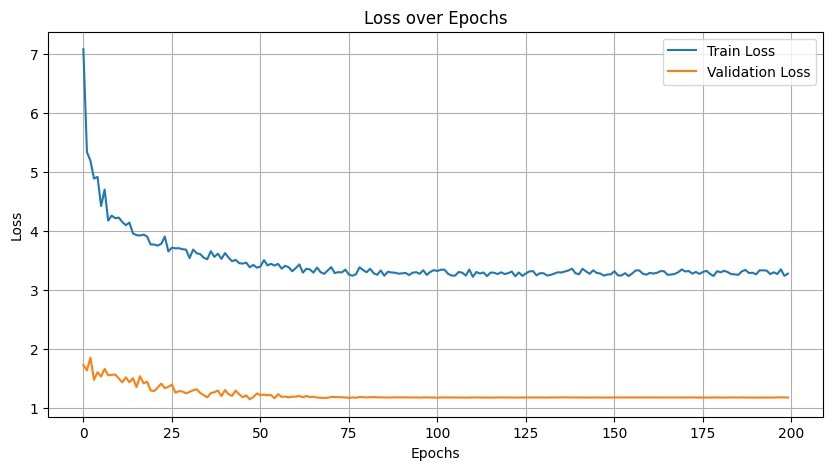

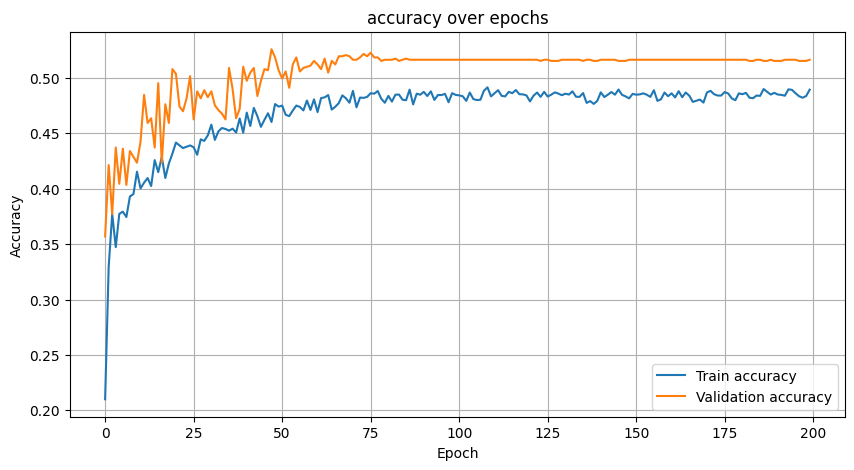

237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.68687334 0.34279228 0.14063556 0.4127907  0.20689655]
Precision (per class): [0.80215343 0.77568493 0.07738095 0.32568807 0.12244898]
Recall (per class): [0.60056429 0.22000971 0.77037037 0.56349206 0.66666667]
Accuracy: 0.5021
AUC (One-vs-Rest): 0.8275

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.60      0.69      4962
           D       0.78      0.22      0.34      2059
           C       0.08      0.77      0.14       270
           B       0.33      0.56      0.41       252
           A       0.12      0.67      0.21        27

    accuracy                           0.50      7570
   macro avg       0.42      0.56      0.36      7570
weighted avg       0.75      0.50      0.56      7570



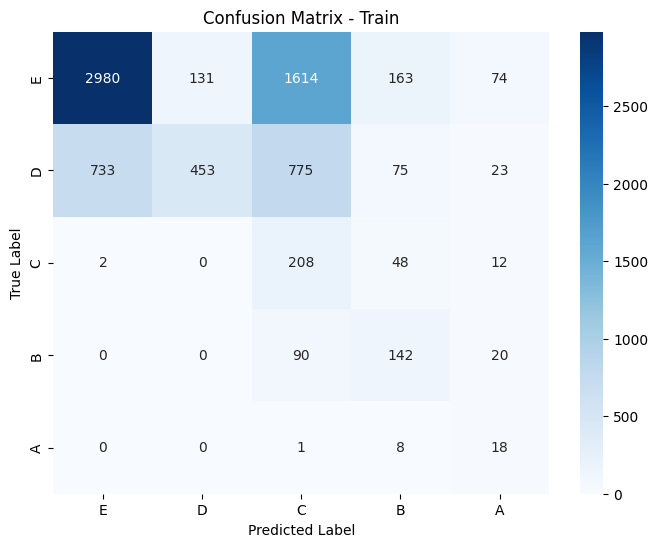

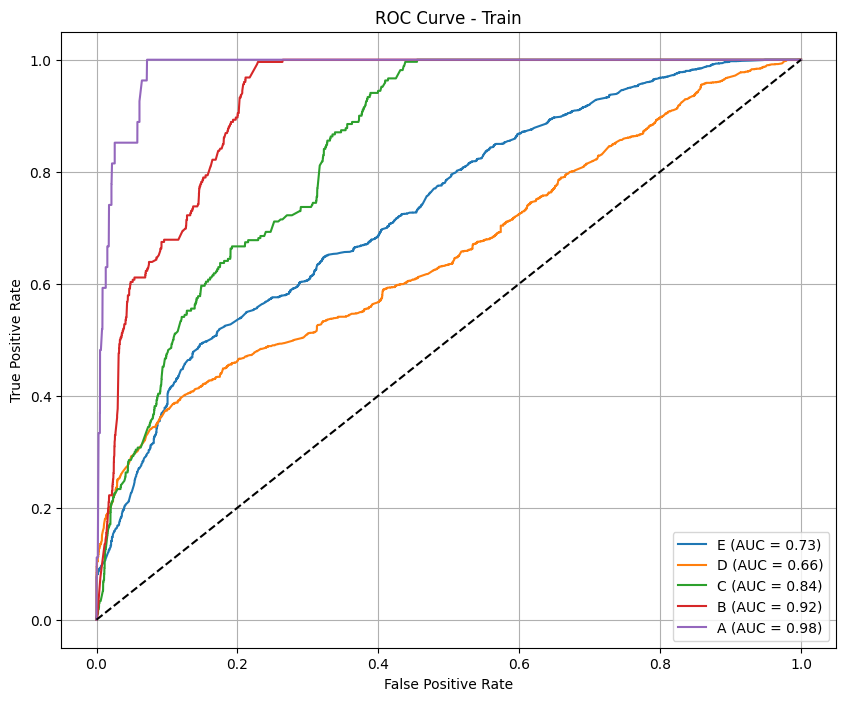

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.86963835 0.37344398 0.         0.         0.        ]
Precision (per class): [0.90226876 0.30612245 0.         0.         0.        ]
Recall (per class): [0.83928571 0.4787234  0.         0.         0.        ]
Accuracy: 0.7434
AUC (One-vs-Rest): 0.6728

Classification Report:
              precision    recall  f1-score   support

           E       0.90      0.84      0.87       616
           D       0.31      0.48      0.37        94
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.74       756
   macro avg       0.24      0.26      0.25       756
weighted avg       0.77      0.74      0.76       756



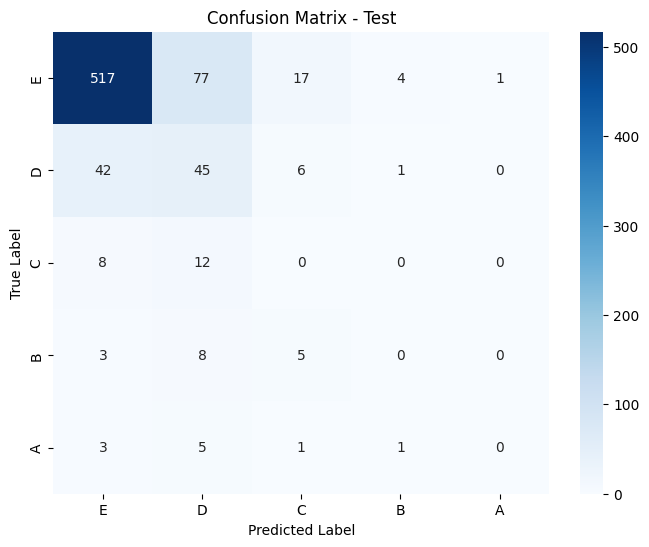

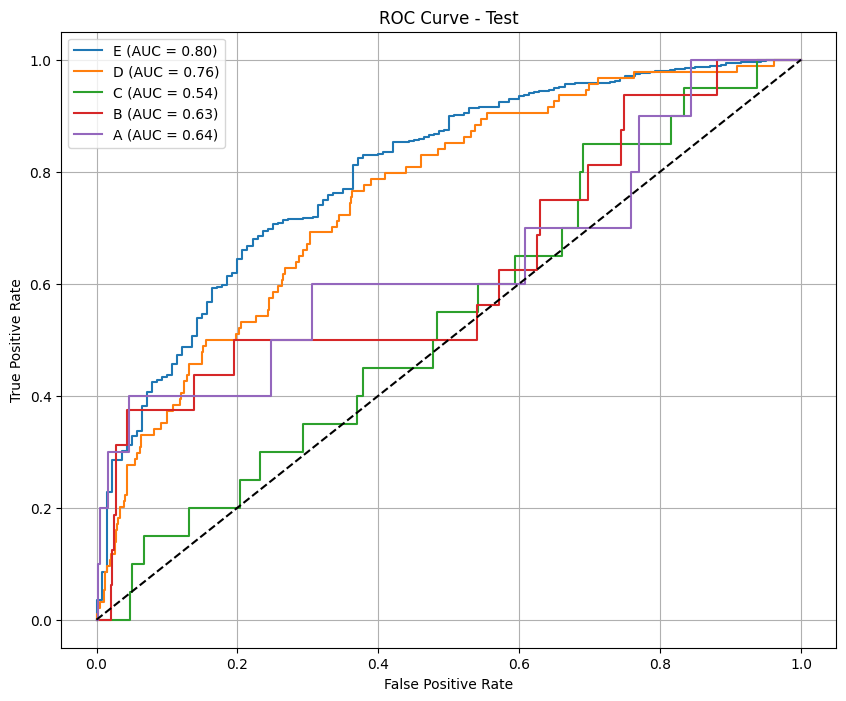

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_standard.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


222/237 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

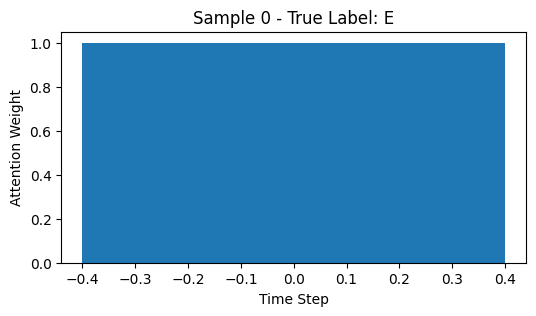

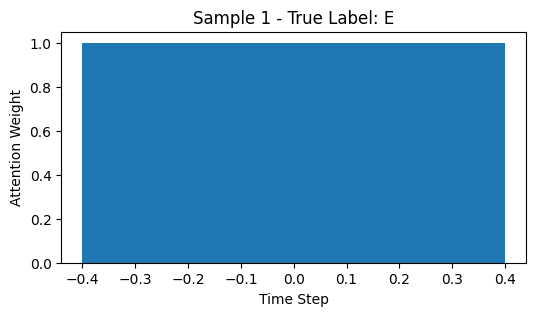

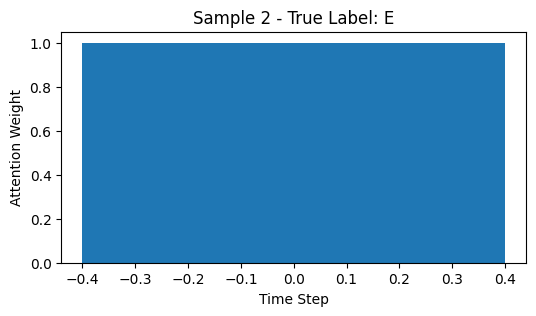

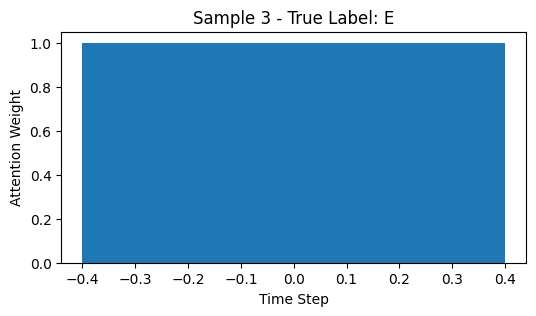

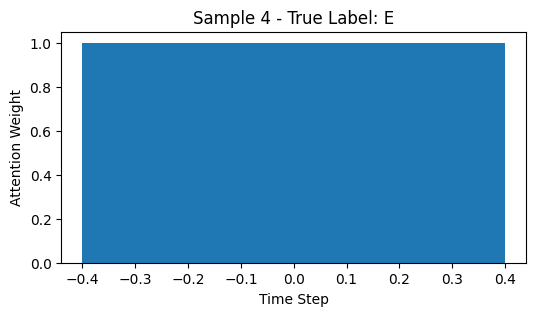

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_10          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_20 (Dropout)      │ (None, 2, 128)         │              0 │ bidirectional_10[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_11          │ (None, 2, 64)          │         41,216 │ dropout_20[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_11[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_11[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_31 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_10    │ (None, 64)             │            256 │ dense_31[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_30 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_22 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_21 (Dropout)      │ (None, 64)             │              0 │ dense_30[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_32 (Dense)          │ (None, 32)             │          2,080 │ dropout_22[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_5             │ (None, 96)             │              0 │ dropout_21[0][0],      │
│ (Concatenate)             │                        │                │ dense_32[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step

Epoch 1: val_f1_macro = 0.2657
76/76 ━━━━━━━━━━━━━━━━━━━━ 19s 61ms/step - accuracy: 0.2951 - loss: 10.2465 - val_accuracy: 0.3919 - val_loss: 1.8574 - val_f1_macro: 0.2657 - learning_rate: 0.0010
Epoch 2/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.2715
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.3169 - loss: 6.9710 - val_accuracy: 0.3617 - val_loss: 1.9976 - val_f1_macro: 0.2715 - learning_rate: 0.0010
Epoch 3/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step

Epoch 3: val_f1_macro = 0.3345
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.3080 - loss: 6.2589 - val_accuracy: 0.3631 - val_loss: 2.1396 - val_f1_macro: 0.3345 - learning_rate: 0.0010
Epoch 4/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.3145
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.3134 - loss: 6.4852 - val_accuracy: 0.3732 - val_loss: 1.6715 - val_f1_macro: 0.3145 - learning_rate: 0.0010
Epoch 5/200
2

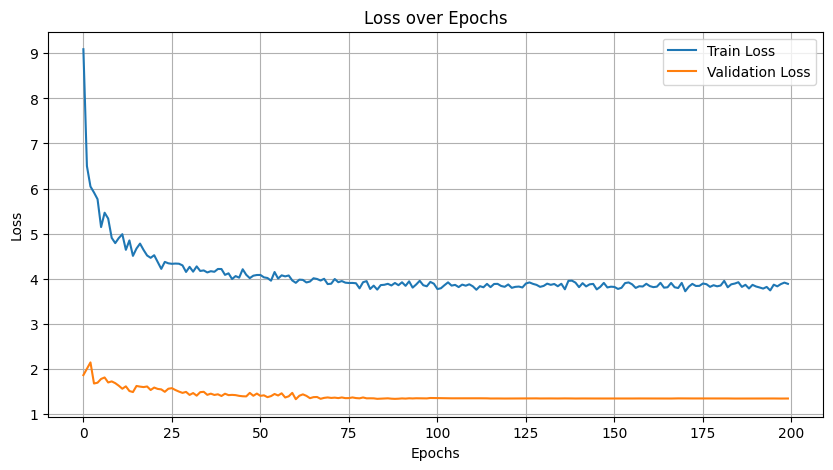

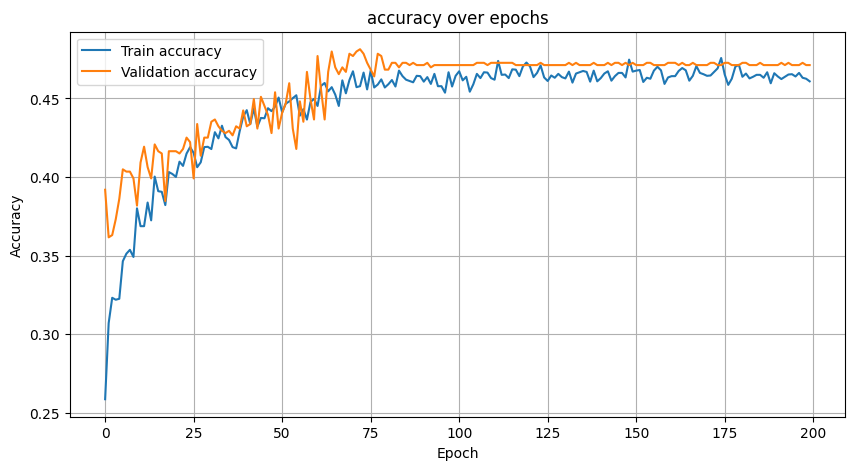

174/174 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.68042197 0.22556391 0.18452667 0.2853067  0.25899281]
Precision (per class): [0.77600849 0.68181818 0.10372771 0.21231423 0.15789474]
Recall (per class): [0.6058011  0.13513514 0.83478261 0.43478261 0.72      ]
Accuracy: 0.4863
AUC (One-vs-Rest): 0.8090

Classification Report:
              precision    recall  f1-score   support

           E       0.78      0.61      0.68      3620
           D       0.68      0.14      0.23      1443
           C       0.10      0.83      0.18       230
           B       0.21      0.43      0.29       230
           A       0.16      0.72      0.26        25

    accuracy                           0.49      5548
   macro avg       0.39      0.55      0.33      5548
weighted avg       0.70      0.49      0.52      5548



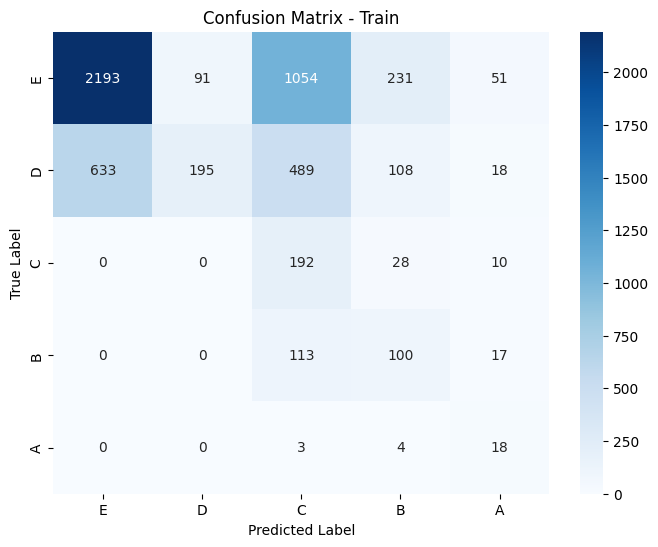

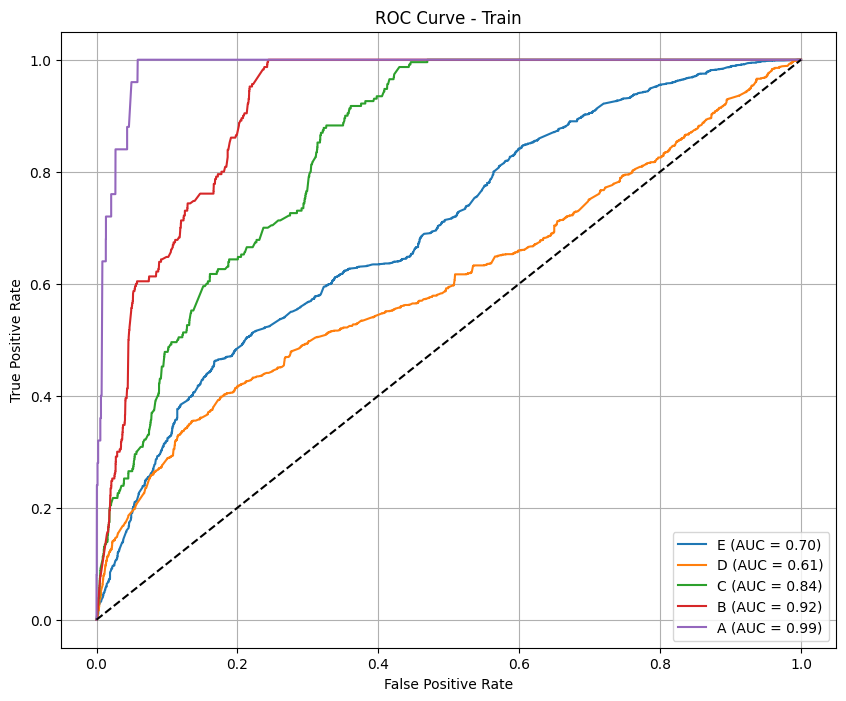

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.87993921 0.02040816 0.         0.         0.        ]
Precision (per class): [0.81895332 0.16666667 0.         0.         0.        ]
Recall (per class): [0.95073892 0.01086957 0.         0.         0.        ]
Accuracy: 0.7775
AUC (One-vs-Rest): 0.5704

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.95      0.88       609
           D       0.17      0.01      0.02        92
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        15
           A       0.00      0.00      0.00        10

    accuracy                           0.78       746
   macro avg       0.20      0.19      0.18       746
weighted avg       0.69      0.78      0.72       746



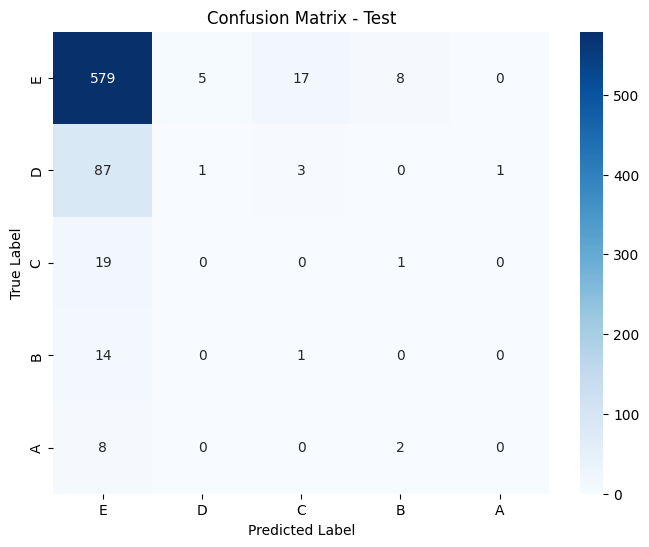

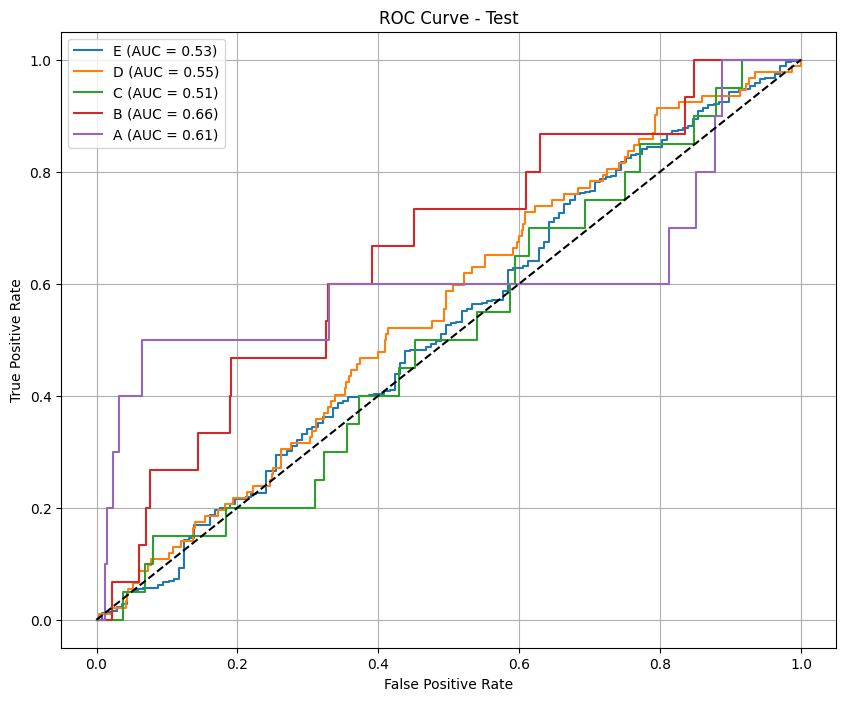

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase2_standard.csv
174/174 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
[[0.5794676 ]
 [0.42053244]
 [0.4570897 ]
 [0.5429102 ]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.5797313 ]
 [0.4202688 ]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.5740828 ]
 [0.4259172 ]
 [0.5794676 ]
 [0.42053244]
 [0.5758336 ]
 [0.42416644]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.61636335]
 [0.38363656]
 [0.40248138]
 [0.59751874]
 [0.5794676 ]
 [0.42053244]
 [0.5743362 ]
 [0.4256638 ]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.57736385]
 [0.4226362 ]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.63138074]
 [0.36861923]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.5806885 ]
 [0.41931152]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.5794676 ]
 [0.42053244]
 [0.3382806 ]
 [0.66171926]
 [0.

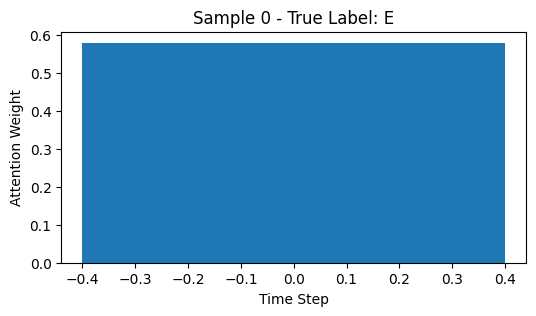

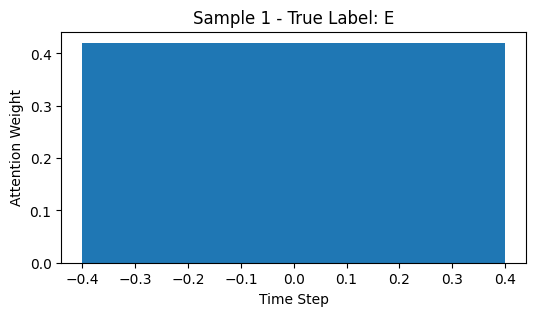

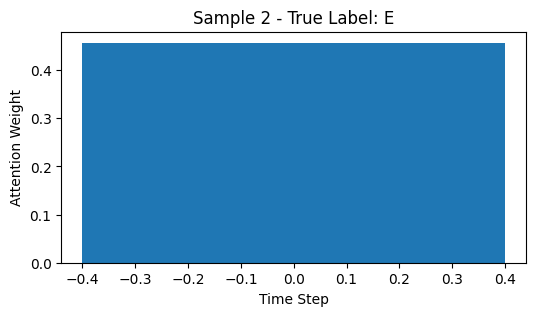

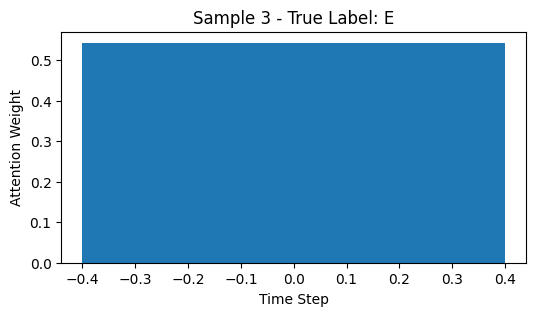

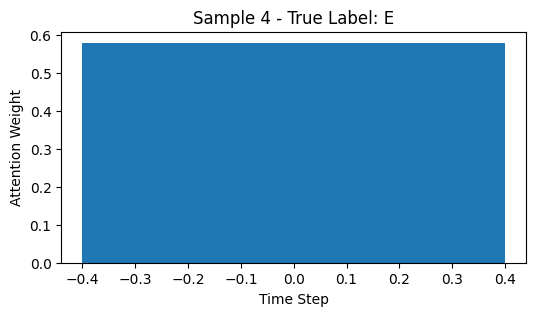

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_12          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_24 (Dropout)      │ (None, 3, 128)         │              0 │ bidirectional_12[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_13          │ (None, 3, 64)          │         41,216 │ dropout_24[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_13[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_13[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_37 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_12    │ (None, 64)             │            256 │ dense_37[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_36 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_26 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_25 (Dropout)      │ (None, 64)             │              0 │ dense_36[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_38 (Dense)          │ (None, 32)             │          2,080 │ dropout_26[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_6             │ (None, 96)             │              0 │ dropout_25[0][0],      │
│ (Concatenate)             │                        │                │ dense_38[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step

Epoch 1: val_f1_macro = 0.2121
66/66 ━━━━━━━━━━━━━━━━━━━━ 20s 84ms/step - accuracy: 0.1375 - loss: 9.7037 - val_accuracy: 0.4642 - val_loss: 1.3183 - val_f1_macro: 0.2121 - learning_rate: 0.0010
Epoch 2/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.3095
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2825 - loss: 6.8445 - val_accuracy: 0.4409 - val_loss: 1.4407 - val_f1_macro: 0.3095 - learning_rate: 0.0010
Epoch 3/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2207
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3361 - loss: 6.5497 - val_accuracy: 0.3877 - val_loss: 1.8748 - val_f1_macro: 0.2207 - learning_rate: 0.0010
Epoch 4/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.3734
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3509 - loss: 5.4832 - val_accuracy: 0.3860 - val_loss: 1.9384 - val_f1_macro: 0.3734 - learning_rate: 0.0010
Epoch 5/200
19

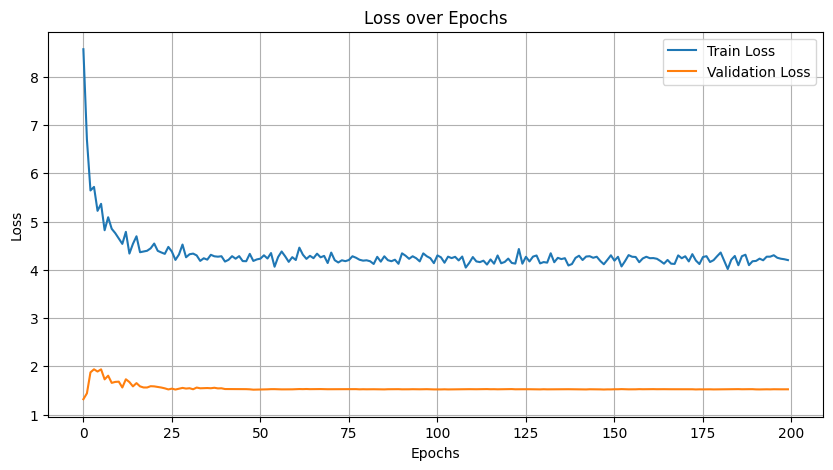

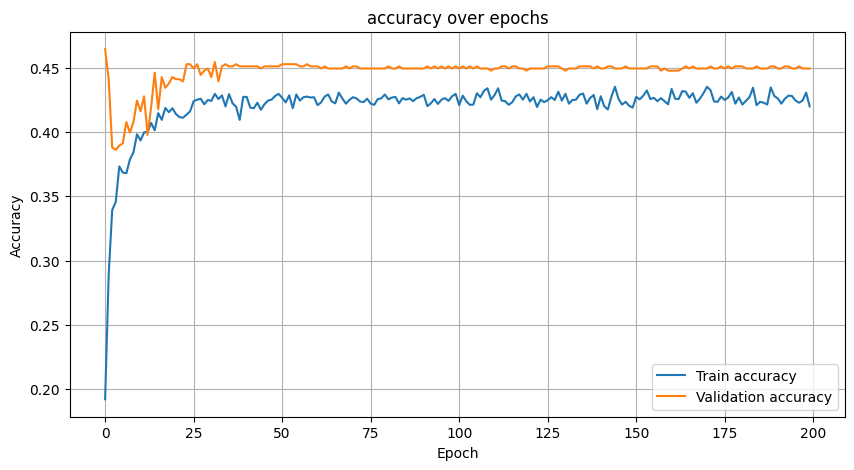

151/151 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.63955224 0.23043206 0.15832363 0.32299742 0.1656051 ]
Precision (per class): [0.76654741 0.54599407 0.08918033 0.22045855 0.0942029 ]
Recall (per class): [0.54865557 0.14603175 0.70466321 0.60386473 0.68421053]
Accuracy: 0.4522
AUC (One-vs-Rest): 0.7908

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.55      0.64      3124
           D       0.55      0.15      0.23      1260
           C       0.09      0.70      0.16       193
           B       0.22      0.60      0.32       207
           A       0.09      0.68      0.17        19

    accuracy                           0.45      4803
   macro avg       0.34      0.54      0.30      4803
weighted avg       0.66      0.45      0.50      4803



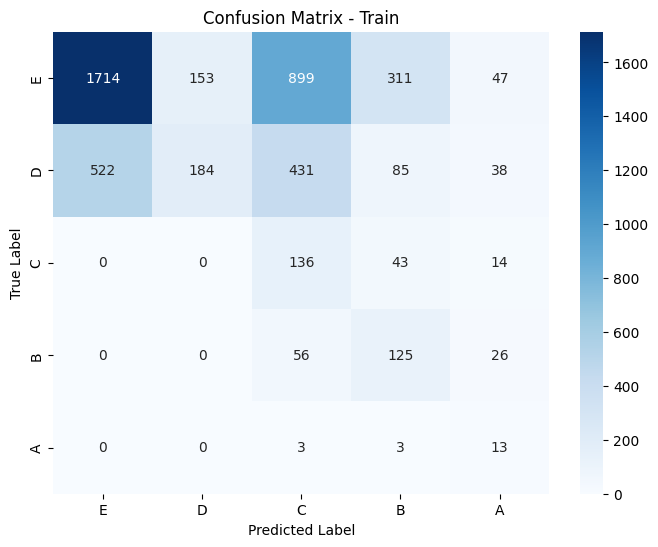

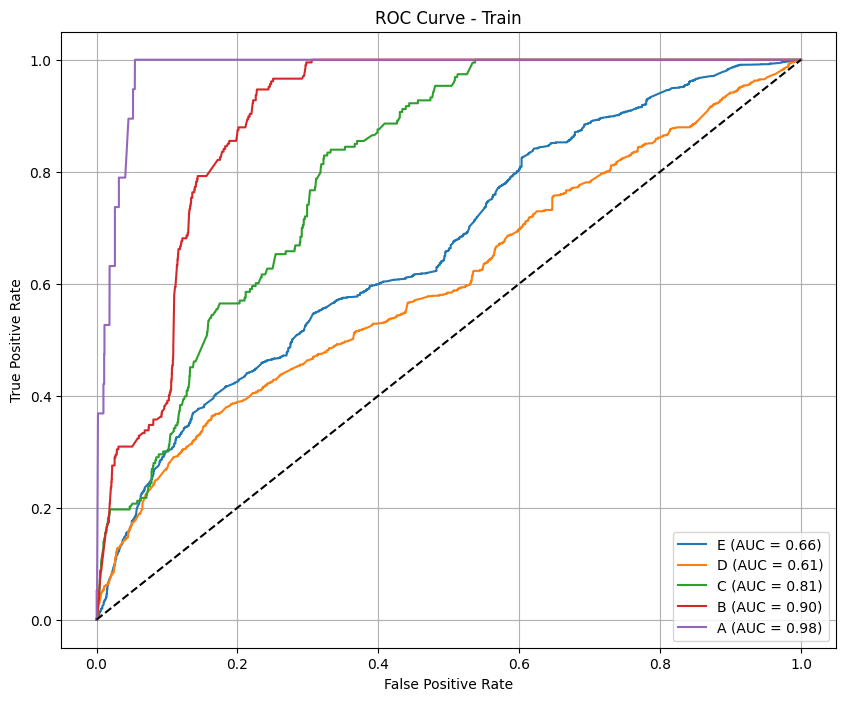

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.85527392 0.12403101 0.03636364 0.         0.        ]
Precision (per class): [0.82362205 0.19047619 0.02857143 0.         0.        ]
Recall (per class): [0.88945578 0.09195402 0.05       0.         0.        ]
Accuracy: 0.7379
AUC (One-vs-Rest): 0.5673

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.89      0.86       588
           D       0.19      0.09      0.12        87
           C       0.03      0.05      0.04        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.74       721
   macro avg       0.21      0.21      0.20       721
weighted avg       0.70      0.74      0.71       721



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


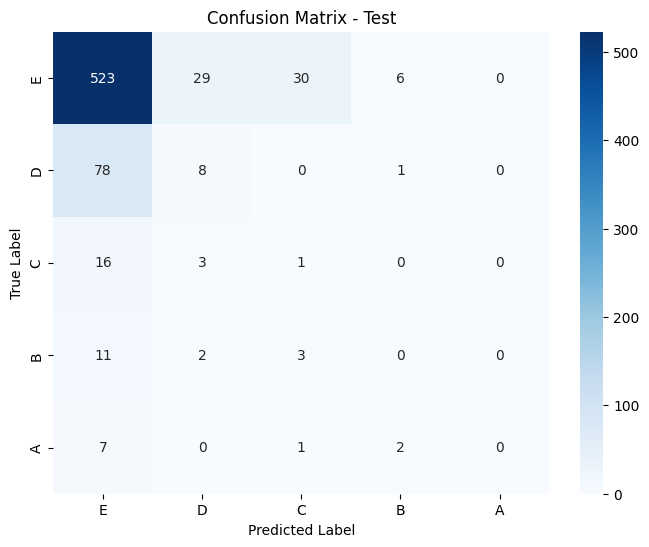

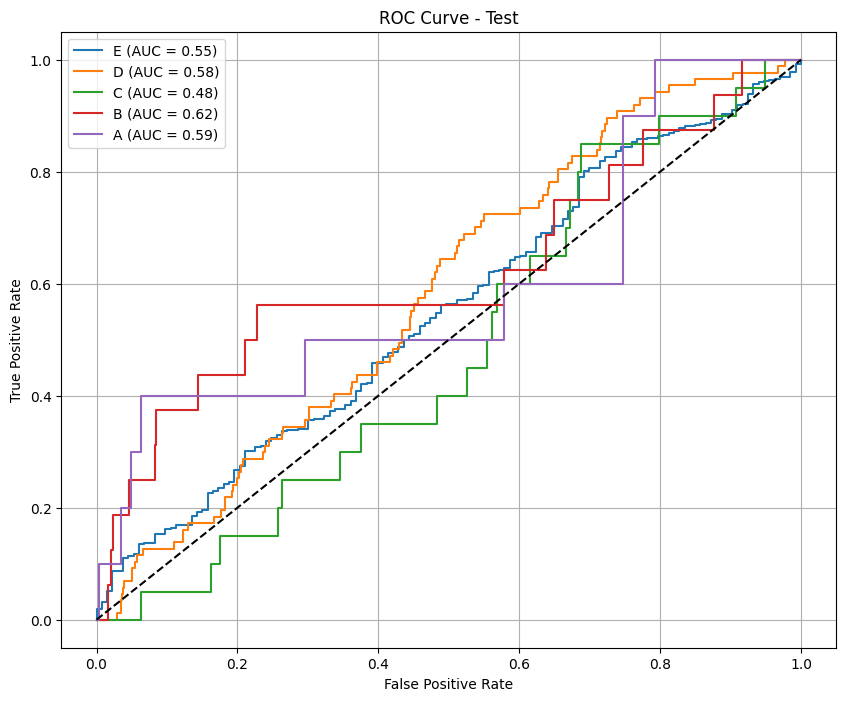

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_standard.csv
151/151 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
[[0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.34458512]
 [0.29550764]
 [0.3599073 ]
 [0.3432949 ]
 [0.29599032]
 [0.36071467]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.27885368]
 [0.3329748 ]
 [0.38817155]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.2821504 ]
 [0.30778778]
 [0.4100618 ]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.316568  ]
 [0.30502263]
 [0.37840945]
 [0.31827262]
 [0.3045549 ]
 [0.37717244]
 [0.25398058]
 [0.34267306]
 [0

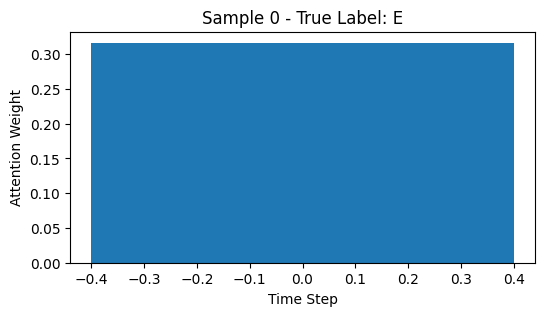

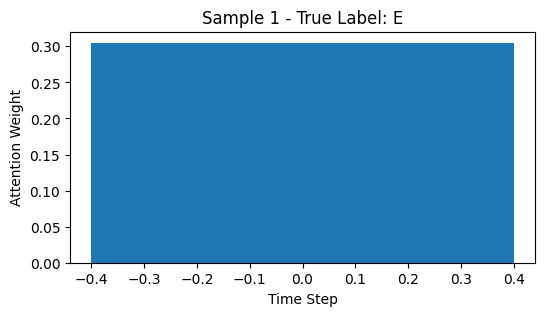

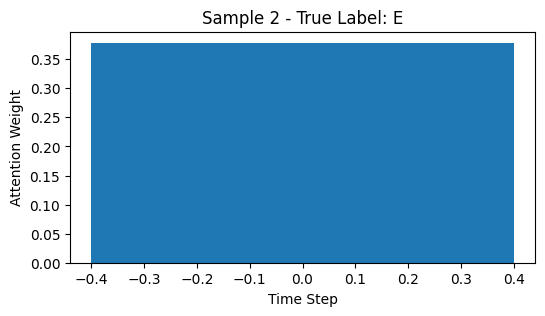

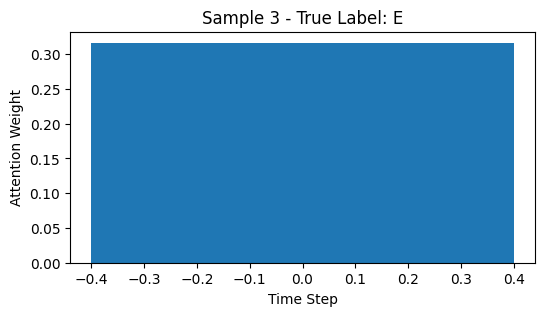

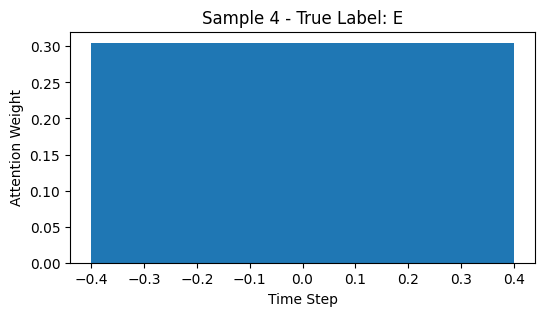

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_14"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_14          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_28 (Dropout)      │ (None, 4, 128)         │              0 │ bidirectional_14[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_15          │ (None, 4, 64)          │         41,216 │ dropout_28[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_15[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_15[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_43 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_14    │ (None, 64)             │            256 │ dense_43[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_42 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_30 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_29 (Dropout)      │ (None, 64)             │              0 │ dense_42[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_44 (Dense)          │ (None, 32)             │          2,080 │ dropout_30[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_7             │ (None, 96)             │              0 │ dropout_29[0][0],      │
│ (Concatenate)             │                        │                │ dense_44[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 2s 125ms/step

Epoch 1: val_f1_macro = 0.1822
33/33 ━━━━━━━━━━━━━━━━━━━━ 19s 133ms/step - accuracy: 0.1465 - loss: 13.3653 - val_accuracy: 0.4527 - val_loss: 2.4744 - val_f1_macro: 0.1822 - learning_rate: 0.0010
Epoch 2/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 2: val_f1_macro = 0.1948
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.2259 - loss: 8.9175 - val_accuracy: 0.4865 - val_loss: 2.0399 - val_f1_macro: 0.1948 - learning_rate: 0.0010
Epoch 3/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 3: val_f1_macro = 0.2026
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.2996 - loss: 9.0276 - val_accuracy: 0.4527 - val_loss: 1.8341 - val_f1_macro: 0.2026 - learning_rate: 0.0010
Epoch 4/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 4: val_f1_macro = 0.2412
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 18ms/step - accuracy: 0.3446 - loss: 8.0385 - val_accuracy: 0.4392 - val_loss: 1.7404 - val_f1_macro: 0.2412 - learning_rate: 0.0010
Epoch 5/

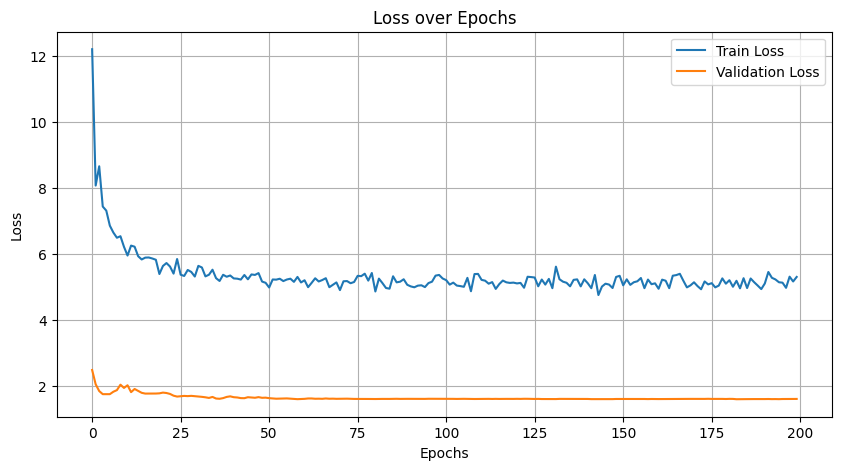

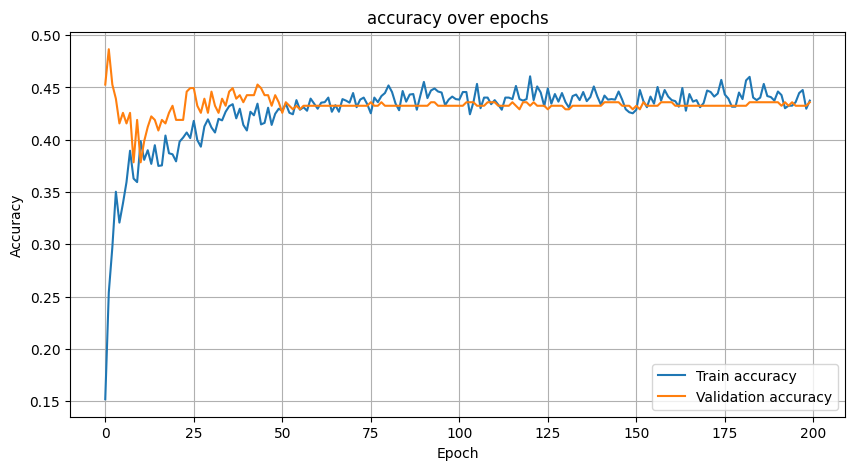

74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.61472868 0.26666667 0.14602347 0.43346008 0.24657534]
Precision (per class): [0.73904939 0.52525253 0.08408408 0.3106267  0.15254237]
Recall (per class): [0.52621102 0.17869416 0.55445545 0.71698113 0.64285714]
Accuracy: 0.4554
AUC (One-vs-Rest): 0.7925

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.53      0.61      1507
           D       0.53      0.18      0.27       582
           C       0.08      0.55      0.15       101
           B       0.31      0.72      0.43       159
           A       0.15      0.64      0.25        14

    accuracy                           0.46      2363
   macro avg       0.36      0.52      0.34      2363
weighted avg       0.63      0.46      0.49      2363



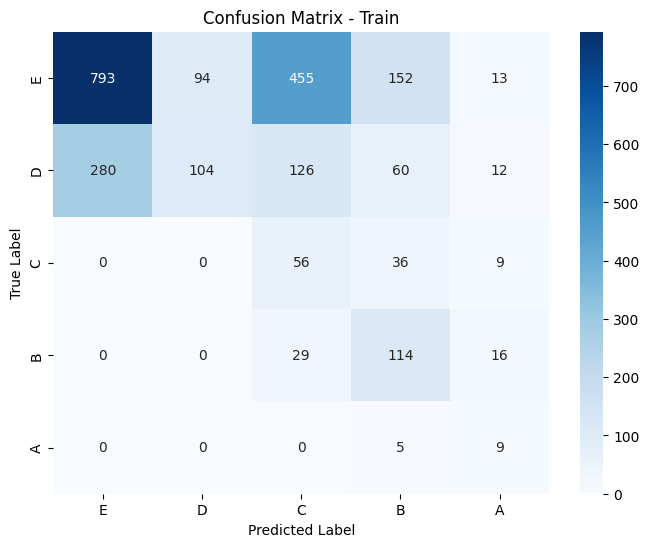

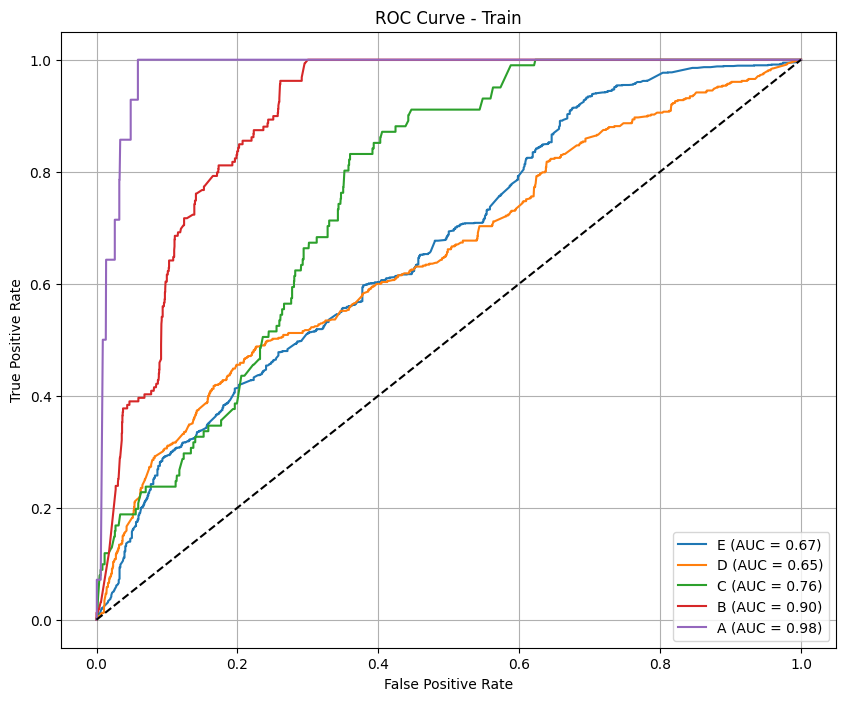

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.6557377  0.01801802 0.05673759 0.         0.125     ]
Precision (per class): [0.83333333 0.03846154 0.03030303 0.         0.2       ]
Recall (per class): [0.54054054 0.01176471 0.44444444 0.         0.09090909]
Accuracy: 0.4512
AUC (One-vs-Rest): 0.5811

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.54      0.66       555
           D       0.04      0.01      0.02        85
           C       0.03      0.44      0.06        18
           B       0.00      0.00      0.00        18
           A       0.20      0.09      0.13        11

    accuracy                           0.45       687
   macro avg       0.22      0.22      0.17       687
weighted avg       0.68      0.45      0.54       687



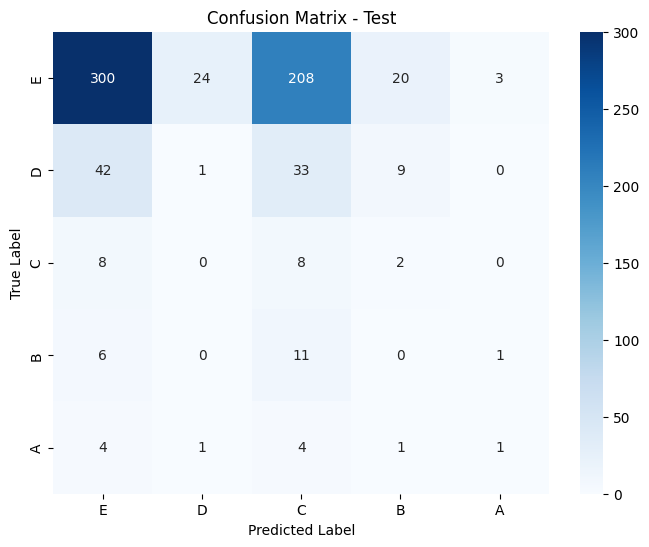

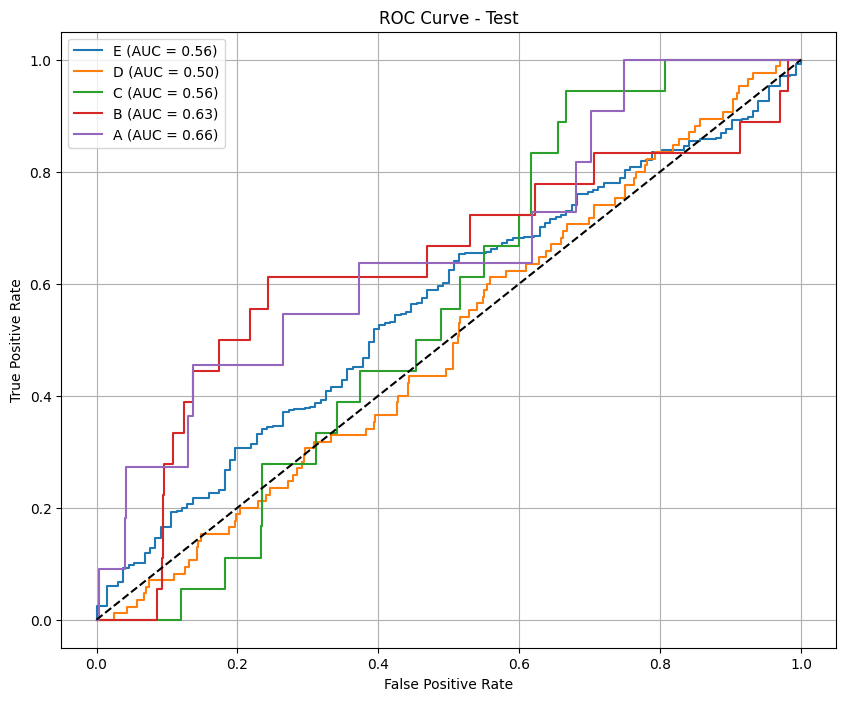

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_standard.csv
74/74 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step
[[0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25106615]
 [0.25134912]
 [0.25033855]
 [0.24724624]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25025994]
 [0.25107417]
 [0.25029004]
 [0.24837574]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.2503751 ]
 [0.2514336 ]
 [0.25073633]
 [0.24745503]
 [0.25004554]
 [0.25090423]
 [0.25053364]
 [0.24851665]
 [0.24984495]
 [0.25080967]
 [0.25031894]
 [0.24902642]
 [0.25010484]
 [0.25110614]
 [0.25066257]
 [0.24812643]
 [0.25010484]
 [0.25110614]
 [0.2

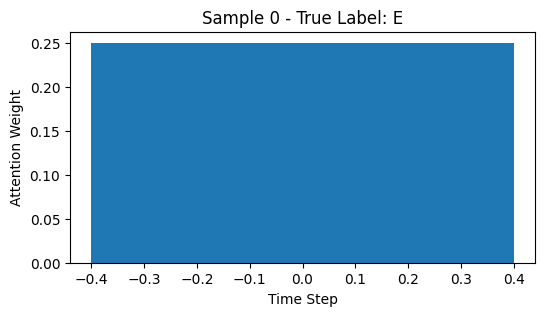

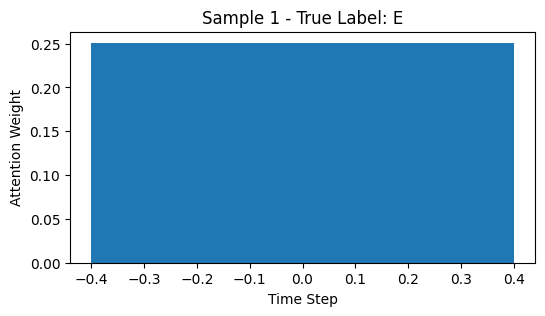

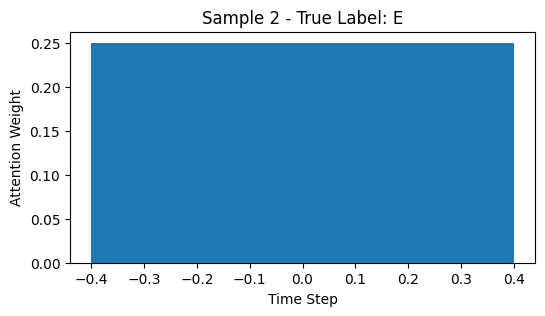

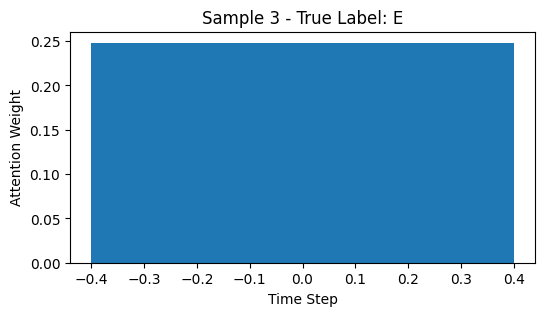

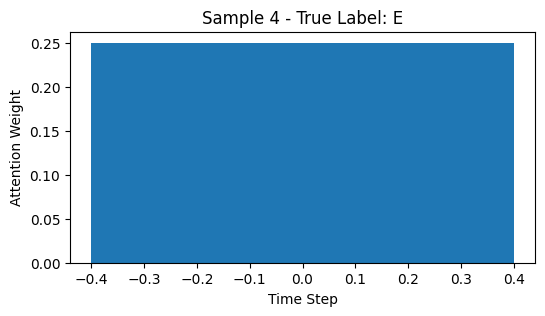

In [24]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, metric='f1_macro') 

### Oversammpling

In [25]:
def manual_custom_oversample(X, y, class_increase_counts):
    """
    Oversample bằng cách tăng thêm số lượng mẫu xác định cho từng class.

    Args:
        X (pd.DataFrame): Features.
        y (pd.Series): Labels.
        class_increase_counts (dict): Dict {class_label: increase_number}.

    Returns:
        (X_resampled, y_resampled): Dữ liệu sau oversample.
    """
    df = pd.concat([X, y], axis=1)
    resampled_parts = []

    for cls in y.unique():
        df_cls = df[df[y.name] == cls]
        resampled_parts.append(df_cls)  # Ban đầu: dữ liệu gốc

        if cls in class_increase_counts:
            increase_count = class_increase_counts[cls]
            n_repeat = increase_count // len(df_cls)  # số lần nhân bản toàn bộ
            n_extra = increase_count % len(df_cls)    # thêm bao nhiêu mẫu riêng lẻ

            # Nhân bản toàn bộ
            if n_repeat > 0:
                resampled_parts.append(pd.concat([df_cls] * n_repeat, ignore_index=True))

            # Lấy thêm một số mẫu ngẫu nhiên
            if n_extra > 0:
                resampled_parts.append(df_cls.sample(n=n_extra, replace=True, random_state=42))

    df_resampled = pd.concat(resampled_parts).sample(frac=1, random_state=42)  # shuffle
    X_resampled = df_resampled.drop(columns=[y.name])
    y_resampled = df_resampled[y.name]

    return X_resampled, y_resampled


In [26]:
# Đọc và xử lý dữ liệu cho từng phase
def process_oversample_phase(phase, scale='standard', metric='accuracy'):
    # Đọc dữ liệu
    X_train, y_train, X_test, y_test = load_data(phase)
    # Oversampling
    cls_count = {
        2: 1000,
        3: 500,
        4: 250
    }
    X_train, y_train = manual_custom_oversample(X_train, y_train, cls_count)
    # Scale dữ liệu
    X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
    X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)

    # Ensure y_train and y_test are NumPy arrays before reshaping
    y_train = np.array(y_train).reshape(-1, 1)  # Reshaping to 2D array
    y_test = np.array(y_test).reshape(-1, 1)
    
    # Fit the encoder and transform y_train and y_test
    # encoder.fit(y_train)
    # y_train_encoded = encoder.transform(y_train)
    # y_test_encoded = encoder.transform(y_test)

    # Extract features for sequence (time steps)
    phase_num = int(phase[-1])  # Extract phase number (phase1 -> 1, phase2 -> 2, etc.)
    
    # Extract sequence features (excluding static features)
    seq_features = []
    for i in range(1, phase_num + 1):
        step_features = [col for col in X_train.columns if col not in static_features and col.endswith(f"{i}")]
        seq_features.append(step_features)
    
    # Flatten the list of sequence features
    seq_features = [feat for sublist in seq_features for feat in sublist]
    
    # Function to reshape sequence data [samples, time steps, features]
    def reshape_sequence(df):
        sequence_data = []
        for i in range(1, phase_num + 1):
            # Filter columns that end with the current time step index
            step_features = [col for col in df.columns if col.endswith(f"{i}") and col not in static_features]
            step_features = list(sorted(step_features))  # Optional: consistent order
            # print(f"Time step {i}: {len(step_features)} features\n{step_features}")
            sequence_data.append(df[step_features].astype(np.float32).to_numpy(copy=True))
        return np.stack(sequence_data, axis=1)
    
    # Reshape sequence data for training and testing
    X_train_seq = reshape_sequence(X_train_scaled)
    X_test_seq = reshape_sequence(X_test_scaled)
    
    # Extract static features for training and testing (static features stay the same across all time steps)
    X_static_train = X_train_scaled[static_features].values
    X_static_test = X_test_scaled[static_features].values

    # Define model
    num_classes = len(np.unique(y_train))
    model = build_stable_attention_model(
        seq_input_shape=X_train_seq.shape[1:], 
        static_input_shape=X_static_train.shape[1], 
        num_classes=num_classes
    )

    # Stratified split (đồng thời cho sequence và static)
    skf = StratifiedKFold(n_splits=8, shuffle=True, random_state=42)
    for train_idx, val_idx in skf.split(X_train_seq, y_train):
        X_tr_seq, X_val_seq = X_train_seq[train_idx], X_train_seq[val_idx]
        X_tr_static, X_val_static = X_static_train[train_idx], X_static_train[val_idx]
        y_tr, y_val = y_train[train_idx], y_train[val_idx]
        break  # Dùng fold đầu tiên

    # Class weights
    # class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
    # class_weight_dict = dict(enumerate(class_weights))
    # print(class_weight_dict)

    f1_callback = F1MacroCallback(validation_data=([X_val_seq, X_val_static], y_val))
    
    # Train model
    history = model.fit(
        [X_tr_seq, X_tr_static], y_tr,
        validation_data=([X_val_seq, X_val_static], y_val),
        epochs=200,
        batch_size=64,
        callbacks=[f1_callback, lr_schedule],
        # callbacks=[f1_callback, EarlyStopping(patience=5, restore_best_weights=True)],
        # class_weight=class_weight_dict,
        class_weight={0: 1.0, 1: 1.0, 2: 50.0, 3: 25, 4: 80},
        verbose=1
    )

    plot_train_valid(history, metric='accuracy')

    # Evaluate model
    evaluations = evaluate_model(model, [X_train_seq, X_static_train], y_train, [X_test_seq, X_static_test], y_test)

    # Save test predictions
    y_pred = np.argmax(model.predict([X_test_seq, X_static_test]), axis=1)
    results_df = X_test.copy()
    results_df["True_Label"] = y_test
    results_df["Predicted_Label"] = y_pred
    results_df.to_csv(f"lstm_results_{phase}_{scale}.csv", index=False)
    print(f"Results saved: lstm_results_{phase}_{scale}.csv")

    # Extract attention weights from trained model
    # attention_extractor = Model(
    #     inputs=model.input,
    #     outputs=model.get_layer("attention_2").output[1]  # Correct the layer name to "attention_2"
    # )
    # att_weights = attention_extractor.predict([X_train_seq, X_static_train])
    # print(att_weights)

    # model.get_layer("attention").output[1]
    
    attention_model = tf.keras.Model(
        inputs=model.input,
        outputs=model.get_layer("attention_weights").output[1]  # get attention weights
    )
    
    attention_weights = attention_model.predict([X_train_seq, X_static_train])

    print(attention_weights)

    plot_attention_weights(attention_weights, y_train, num_samples=5, class_names=["E", "D", "C", "B", "A"])
    
    return model

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_16          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_32 (Dropout)      │ (None, 1, 128)         │              0 │ bidirectional_16[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_17          │ (None, 1, 64)          │         41,216 │ dropout_32[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_17[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_17[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_49 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_16    │ (None, 64)             │            256 │ dense_49[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_48 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_34 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_33 (Dropout)      │ (None, 64)             │              0 │ dense_48[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_50 (Dense)          │ (None, 32)             │          2,080 │ dropout_34[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_8             │ (None, 96)             │              0 │ dropout_33[0][0],      │
│ (Concatenate)             │                        │                │ dense_50[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2136 - loss: 18.1228

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step

Epoch 1: val_f1_macro = 0.3282
169/169 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - accuracy: 0.2136 - loss: 18.1005 - val_accuracy: 0.3136 - val_loss: 2.0170 - val_f1_macro: 0.3282 - learning_rate: 0.0010
Epoch 2/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.3476
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.2440 - loss: 10.3424 - val_accuracy: 0.3916 - val_loss: 2.0724 - val_f1_macro: 0.3476 - learning_rate: 0.0010
Epoch 3/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.3852
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.2915 - loss: 8.7436 - val_accuracy: 0.4227 - val_loss: 1.9260 - val_f1_macro: 0.3852 - learning_rate: 0.0010
Epoch 4/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.3666
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.3101 - loss: 8.7332 - val_accuracy: 0.4045 - val_loss: 2.0439 - val_f1_macro: 0.3666 - learning_rate: 0.0010
Epoch 5/200
49/49 ━

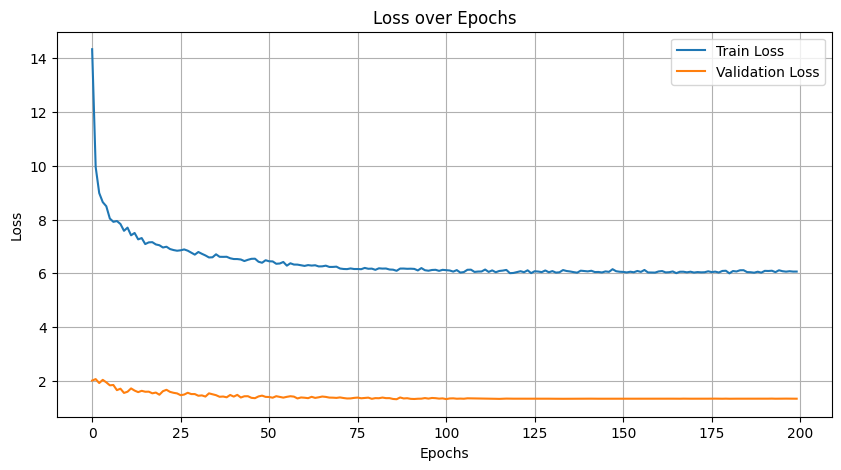

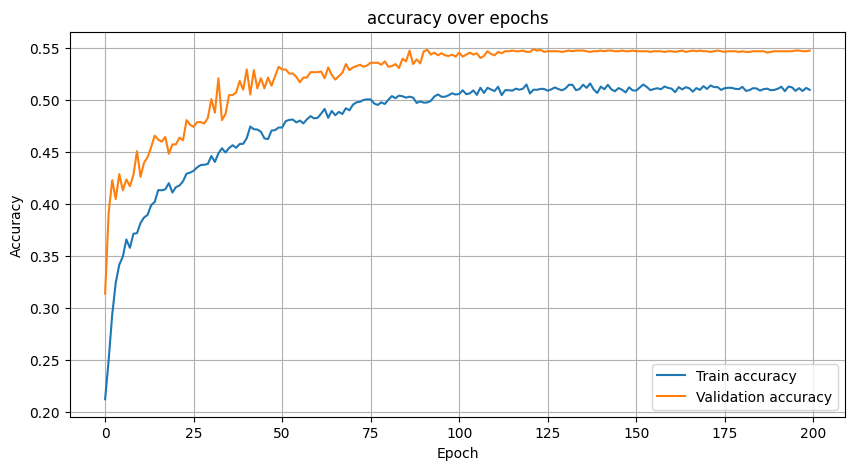

385/385 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.68793047 0.38604197 0.36973149 0.34250765 0.52407615]
Precision (per class): [0.80149026 0.76130895 0.23302564 0.4028777  0.37987013]
Recall (per class): [0.60255674 0.25858124 0.89448819 0.29787234 0.84476534]
Accuracy: 0.5341
AUC (One-vs-Rest): 0.8477

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.60      0.69      6962
           D       0.76      0.26      0.39      3059
           C       0.23      0.89      0.37      1270
           B       0.40      0.30      0.34       752
           A       0.38      0.84      0.52       277

    accuracy                           0.53     12320
   macro avg       0.52      0.58      0.46     12320
weighted avg       0.70      0.53      0.56     12320



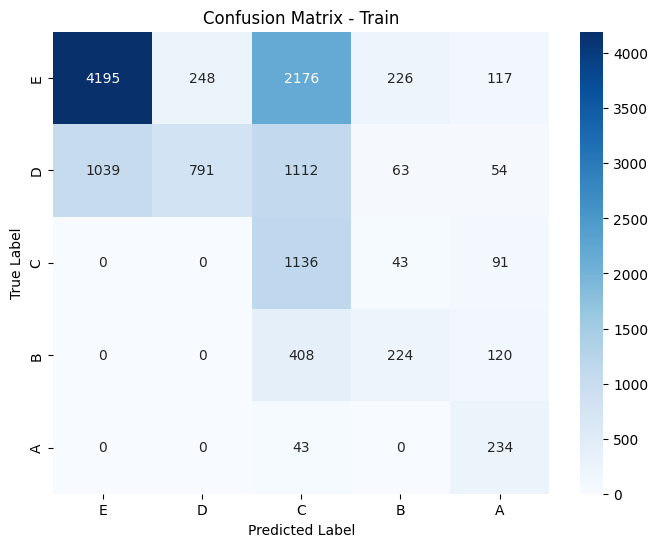

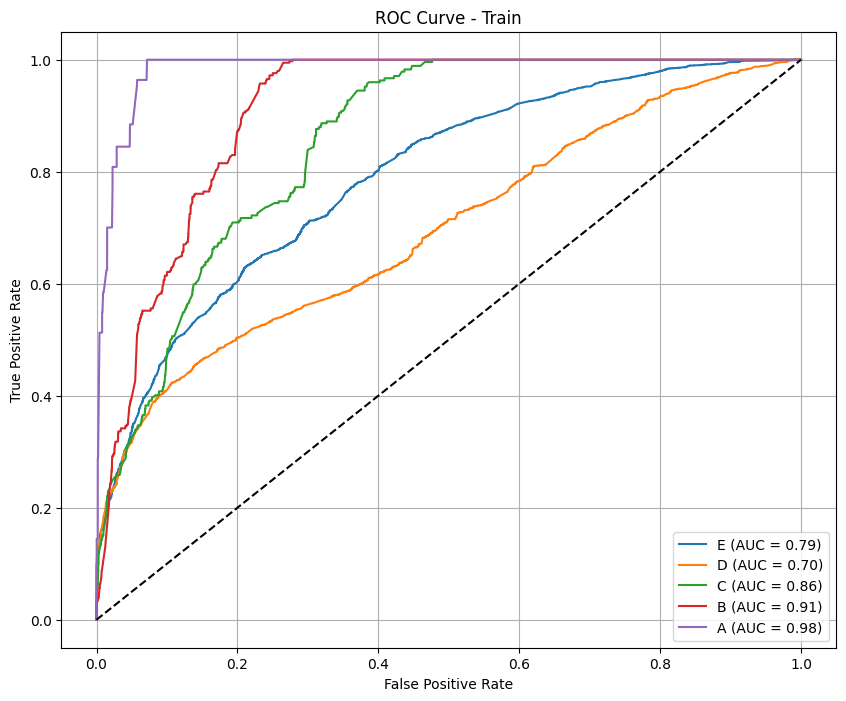

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.86644407 0.37606838 0.06060606 0.12121212 0.14285714]
Precision (per class): [0.89175258 0.31428571 0.07692308 0.11764706 0.25      ]
Recall (per class): [0.84253247 0.46808511 0.05       0.125      0.1       ]
Accuracy: 0.7500
AUC (One-vs-Rest): 0.6949

Classification Report:
              precision    recall  f1-score   support

           E       0.89      0.84      0.87       616
           D       0.31      0.47      0.38        94
           C       0.08      0.05      0.06        20
           B       0.12      0.12      0.12        16
           A       0.25      0.10      0.14        10

    accuracy                           0.75       756
   macro avg       0.33      0.32      0.31       756
weighted avg       0.77      0.75      0.76       756



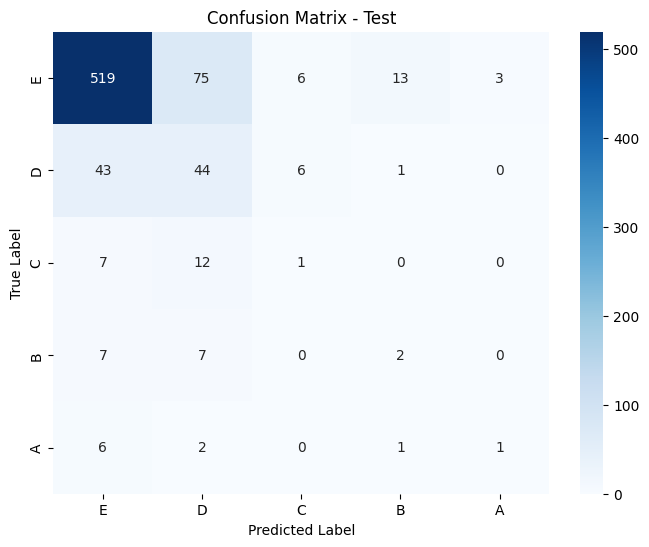

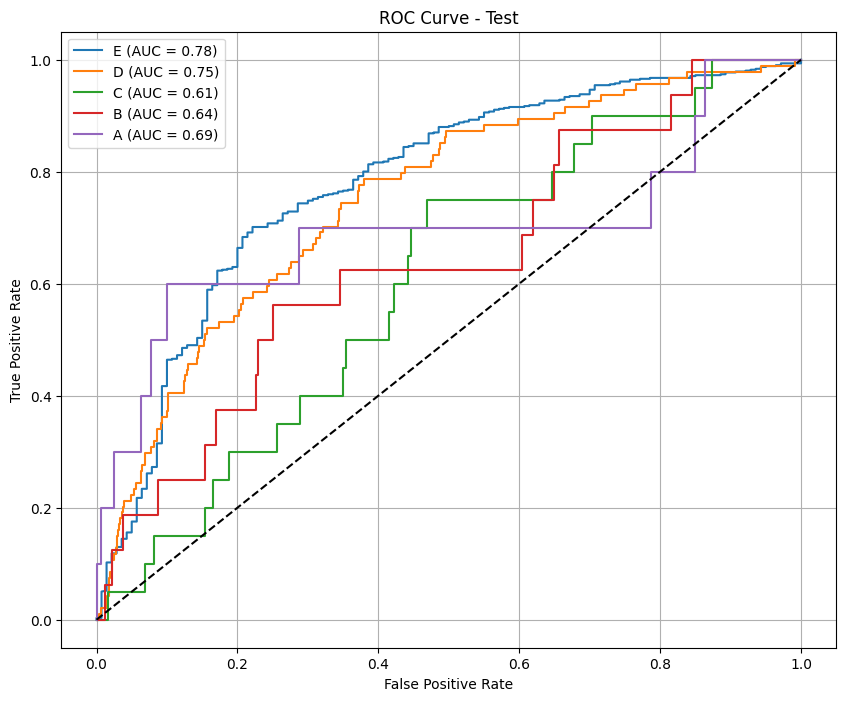

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_standard.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


385/385 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

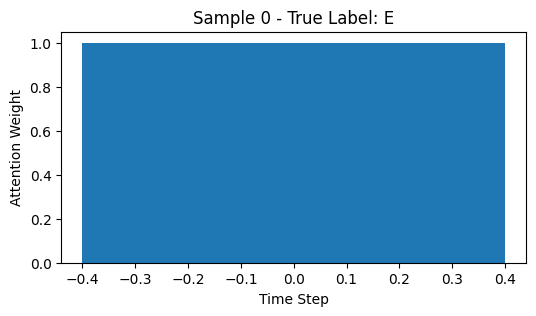

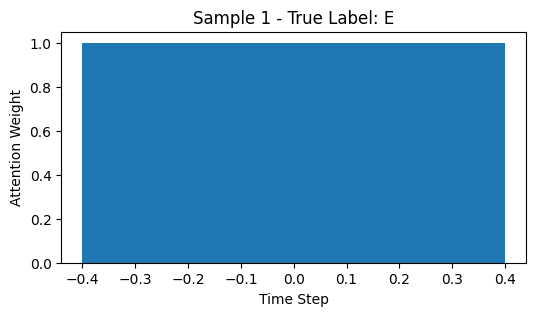

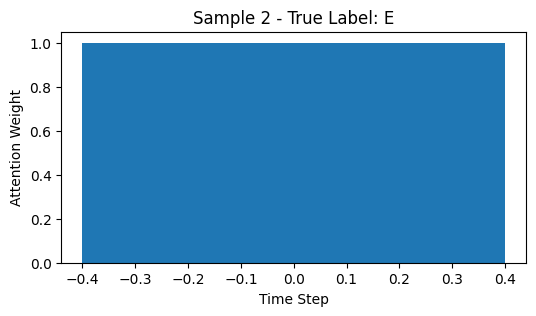

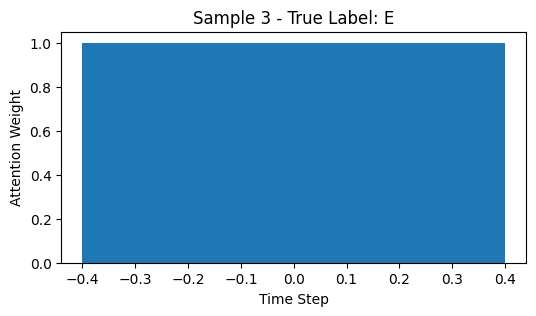

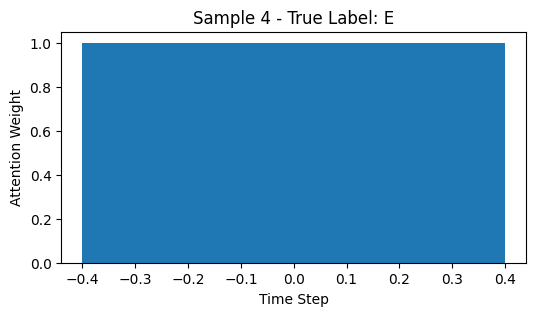

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_18          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_36 (Dropout)      │ (None, 2, 128)         │              0 │ bidirectional_18[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_19          │ (None, 2, 64)          │         41,216 │ dropout_36[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_19[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_19[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_55 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_18    │ (None, 64)             │            256 │ dense_55[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_54 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_38 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_1… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_37 (Dropout)      │ (None, 64)             │              0 │ dense_54[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_56 (Dense)          │ (None, 32)             │          2,080 │ dropout_38[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_9             │ (None, 96)             │              0 │ dropout_37[0][0],      │
│ (Concatenate)             │                        │                │ dense_56[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 4s 32ms/step

Epoch 1: val_f1_macro = 0.2343
141/141 ━━━━━━━━━━━━━━━━━━━━ 20s 48ms/step - accuracy: 0.2587 - loss: 20.7121 - val_accuracy: 0.3766 - val_loss: 2.1524 - val_f1_macro: 0.2343 - learning_rate: 0.0010
Epoch 2/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2878
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.2759 - loss: 11.2944 - val_accuracy: 0.3377 - val_loss: 2.1648 - val_f1_macro: 0.2878 - learning_rate: 0.0010
Epoch 3/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.3787
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.2665 - loss: 10.3178 - val_accuracy: 0.3797 - val_loss: 2.1422 - val_f1_macro: 0.3787 - learning_rate: 0.0010
Epoch 4/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.3496
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 11ms/step - accuracy: 0.3076 - loss: 9.9548 - val_accuracy: 0.3944 - val_loss: 2.1257 - val_f1_macro: 0.3496 - learning_rate: 0.0010
Epo

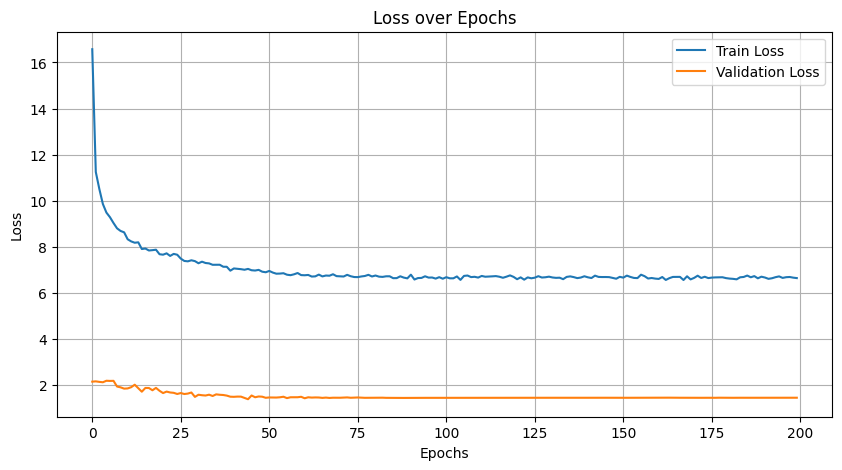

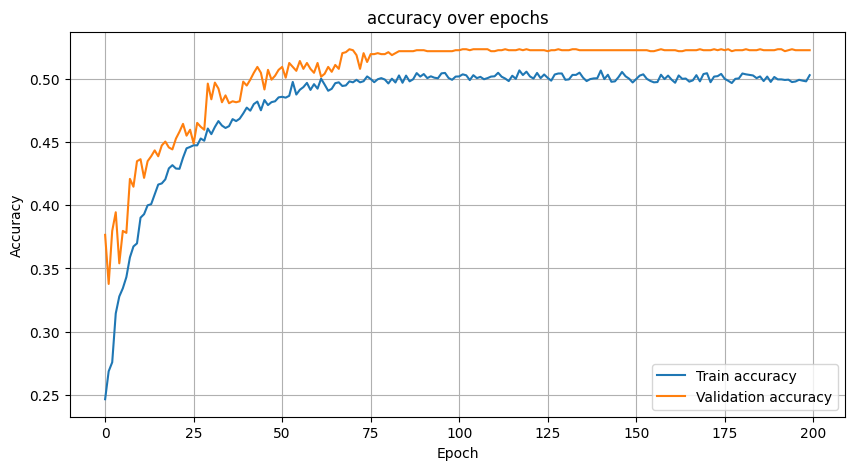

322/322 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.69558406 0.22818336 0.41983594 0.36519037 0.55908513]
Precision (per class): [0.77335075 0.66932271 0.27237542 0.42190305 0.4296875 ]
Recall (per class): [0.63202847 0.13753582 0.91544715 0.32191781 0.8       ]
Accuracy: 0.5311
AUC (One-vs-Rest): 0.8352

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.63      0.70      5620
           D       0.67      0.14      0.23      2443
           C       0.27      0.92      0.42      1230
           B       0.42      0.32      0.37       730
           A       0.43      0.80      0.56       275

    accuracy                           0.53     10298
   macro avg       0.51      0.56      0.45     10298
weighted avg       0.65      0.53      0.52     10298



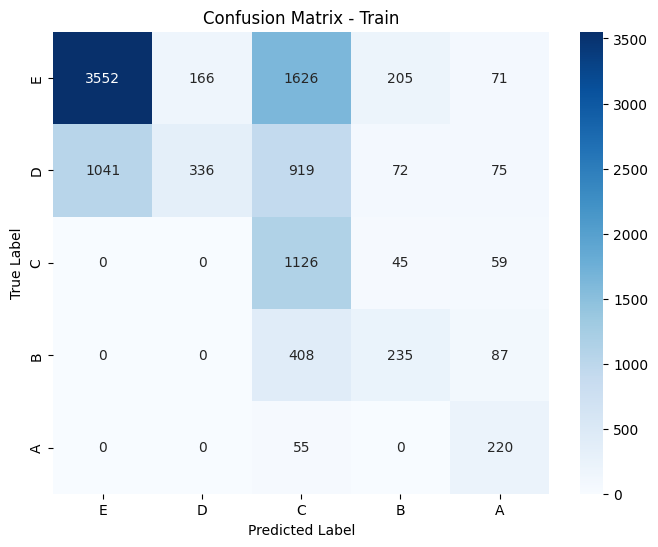

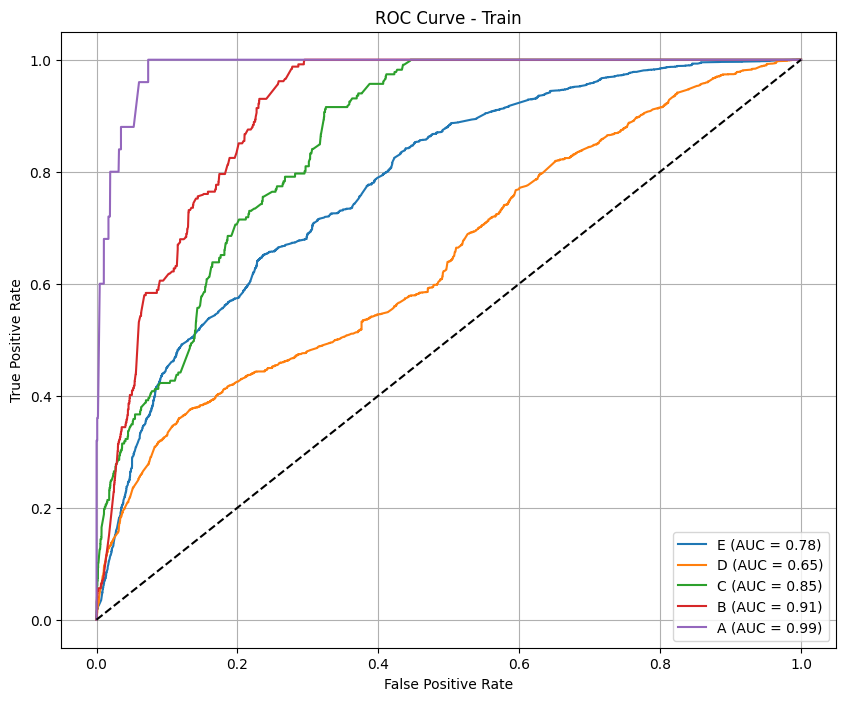

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.87278335 0.         0.         0.10169492 0.125     ]
Precision (per class): [0.82267442 0.         0.         0.06818182 0.16666667]
Recall (per class): [0.92939245 0.         0.         0.2        0.1       ]
Accuracy: 0.7641
AUC (One-vs-Rest): 0.6451

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.93      0.87       609
           D       0.00      0.00      0.00        92
           C       0.00      0.00      0.00        20
           B       0.07      0.20      0.10        15
           A       0.17      0.10      0.12        10

    accuracy                           0.76       746
   macro avg       0.21      0.25      0.22       746
weighted avg       0.68      0.76      0.72       746



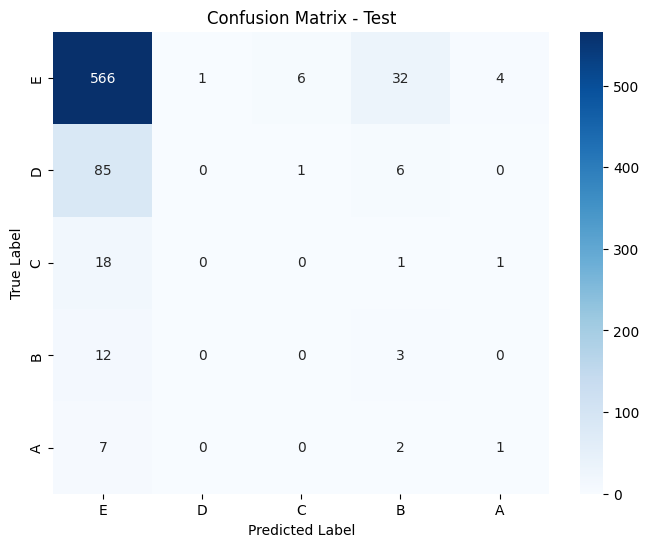

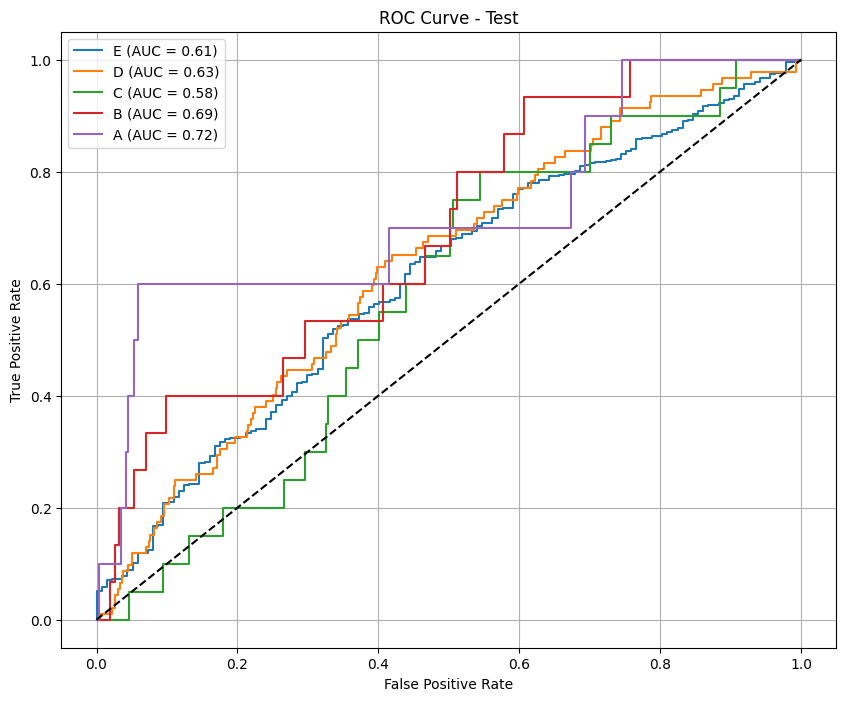

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_standard.csv
322/322 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
[[0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.37790006]
 [0.6220999 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.70617354]
 [0.2938264 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.59724355]
 [0.40275648]
 [0.5899751 ]
 [0.41002494]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.5899751 ]
 [0.41002494]
 [0.57003874]
 [0.4299613 ]
 [0.57003874]
 [0.4299613 ]
 [0.

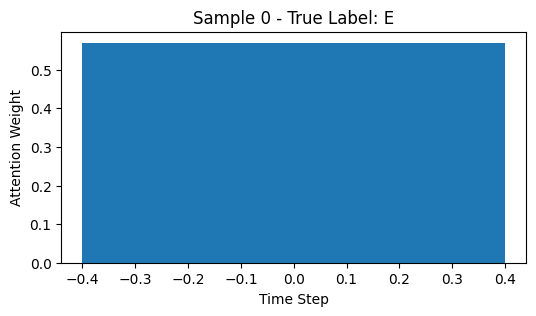

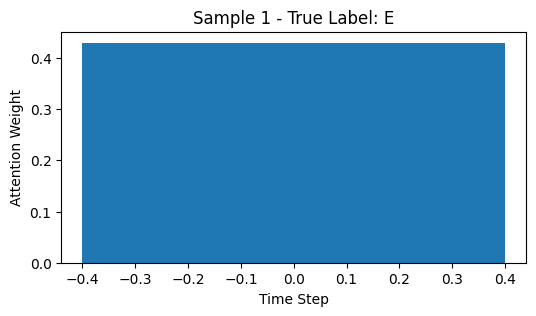

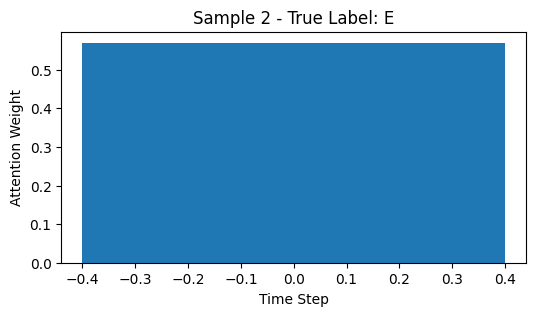

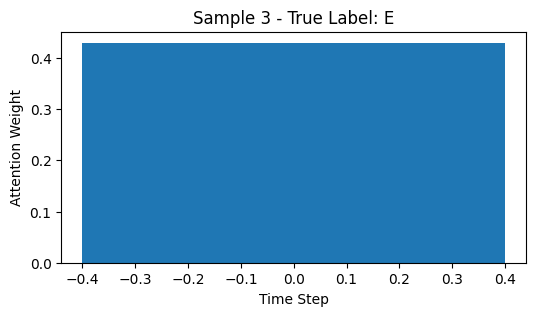

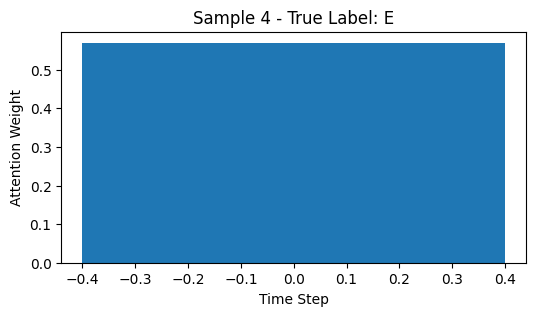

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_20"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_20          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_40 (Dropout)      │ (None, 3, 128)         │              0 │ bidirectional_20[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_21          │ (None, 3, 64)          │         41,216 │ dropout_40[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_21[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_21[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_61 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_20    │ (None, 64)             │            256 │ dense_61[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_60 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_42 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_41 (Dropout)      │ (None, 64)             │              0 │ dense_60[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_62 (Dense)          │ (None, 32)             │          2,080 │ dropout_42[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_10            │ (None, 96)             │              0 │ dropout_41[0][0],      │
│ (Concatenate)             │                        │                │ dense_62[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step

Epoch 1: val_f1_macro = 0.2227
131/131 ━━━━━━━━━━━━━━━━━━━━ 21s 39ms/step - accuracy: 0.1721 - loss: 28.4711 - val_accuracy: 0.2753 - val_loss: 2.2084 - val_f1_macro: 0.2227 - learning_rate: 0.0010
Epoch 2/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2217
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.2476 - loss: 12.5971 - val_accuracy: 0.2946 - val_loss: 2.2435 - val_f1_macro: 0.2217 - learning_rate: 0.0010
Epoch 3/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.3357
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.2641 - loss: 11.6479 - val_accuracy: 0.3690 - val_loss: 2.1609 - val_f1_macro: 0.3357 - learning_rate: 0.0010
Epoch 4/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.3256
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.3021 - loss: 10.4675 - val_accuracy: 0.4000 - val_loss: 1.9393 - val_f1_macro: 0.3256 - learning_rate: 0.0010
Ep

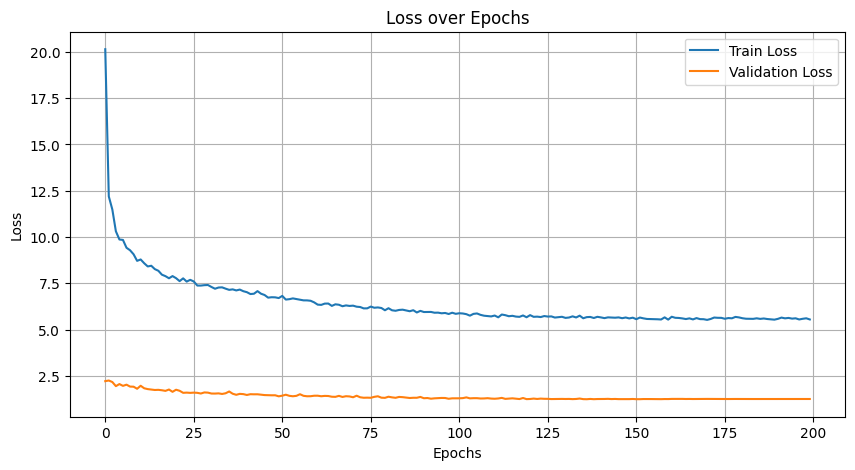

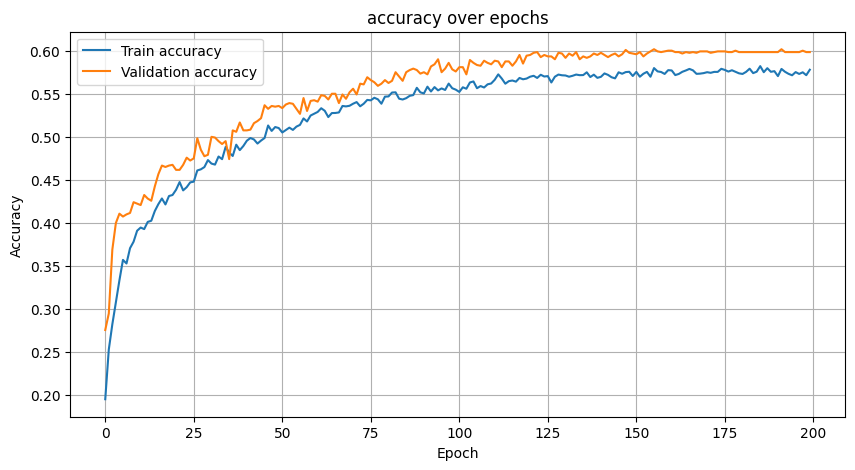

299/299 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.74505829 0.28353326 0.50056883 0.47671994 0.68902439]
Precision (per class): [0.77515292 0.79429735 0.34353529 0.46857923 0.58397933]
Recall (per class): [0.71721311 0.17256637 0.92204526 0.48514851 0.8401487 ]
Accuracy: 0.6002
AUC (One-vs-Rest): 0.8662

Classification Report:
              precision    recall  f1-score   support

           E       0.78      0.72      0.75      5124
           D       0.79      0.17      0.28      2260
           C       0.34      0.92      0.50      1193
           B       0.47      0.49      0.48       707
           A       0.58      0.84      0.69       269

    accuracy                           0.60      9553
   macro avg       0.59      0.63      0.54      9553
weighted avg       0.70      0.60      0.58      9553



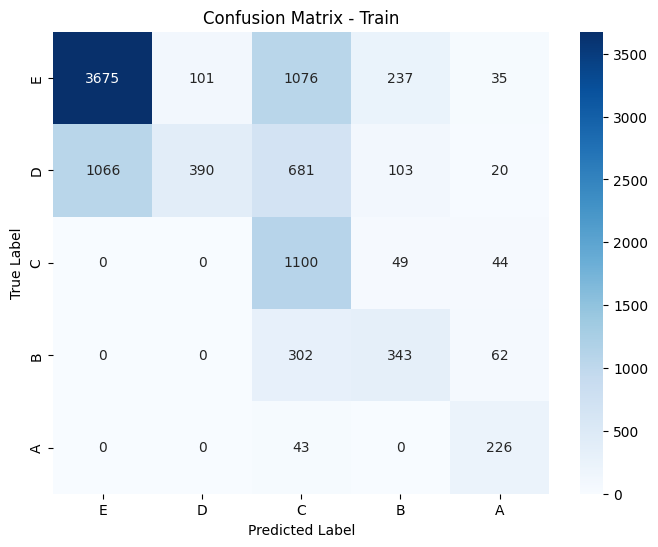

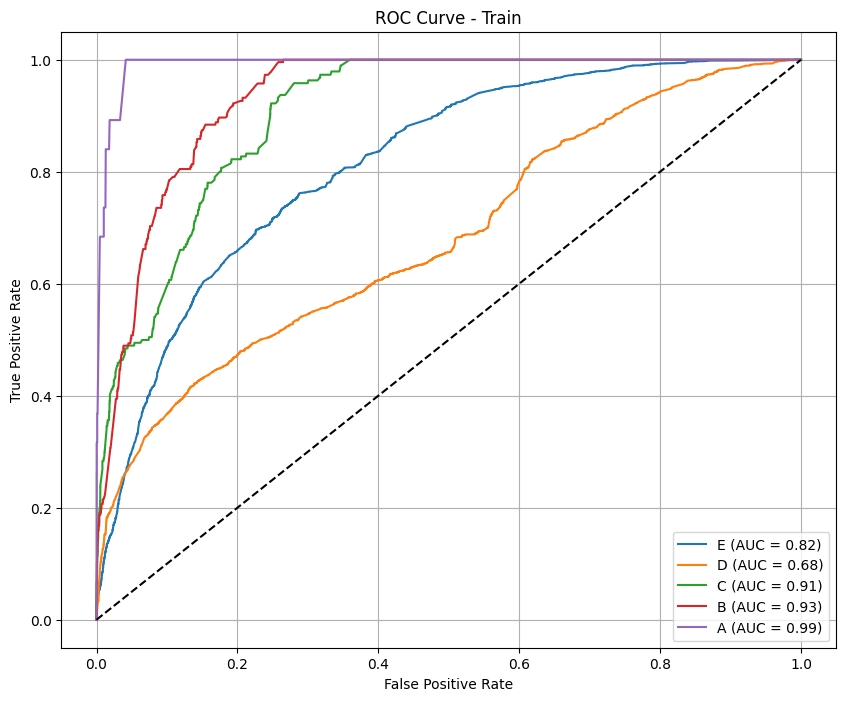

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.87981147 0.         0.         0.14814815 0.        ]
Precision (per class): [0.81751825 0.         0.         0.18181818 0.        ]
Recall (per class): [0.95238095 0.         0.         0.125      0.        ]
Accuracy: 0.7795
AUC (One-vs-Rest): 0.6476

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.95      0.88       588
           D       0.00      0.00      0.00        87
           C       0.00      0.00      0.00        20
           B       0.18      0.12      0.15        16
           A       0.00      0.00      0.00        10

    accuracy                           0.78       721
   macro avg       0.20      0.22      0.21       721
weighted avg       0.67      0.78      0.72       721



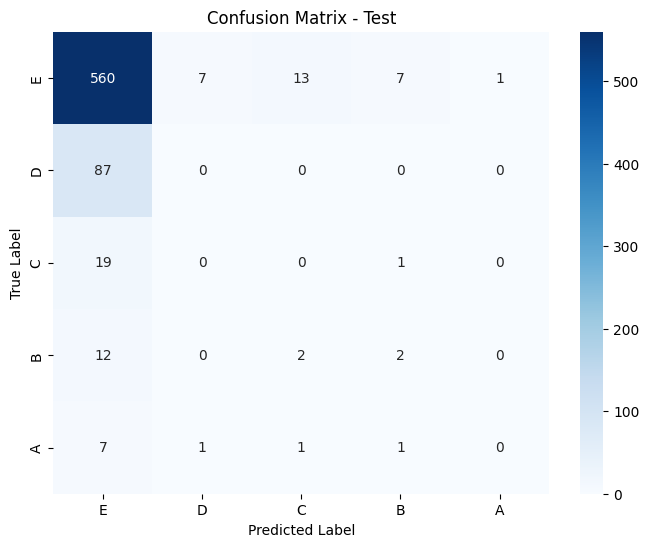

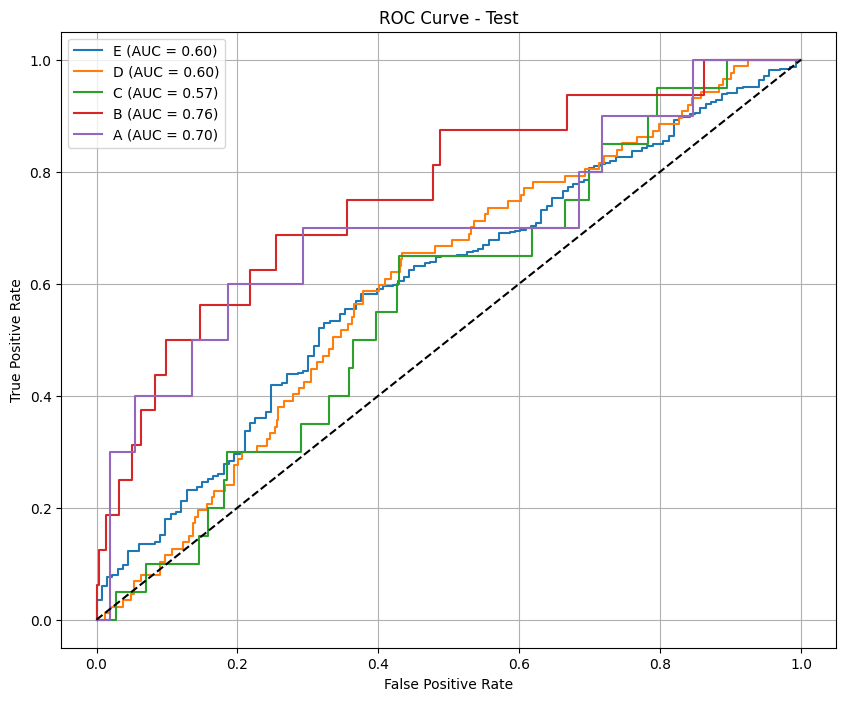

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_standard.csv
299/299 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.7205916 ]
 [0.14023864]
 [0.13916975]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.38128233]
 [0.2272849 ]
 [0.39143282]
 [0.12979701]
 [0.17706522]
 [0.6931378 ]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.43763348]
 [0.2807053 ]
 [0.28166112]
 [0.2700988 ]
 [0.30197468]
 [0.42792648]
 [0.2700988 ]
 [0.30197468]
 [0.

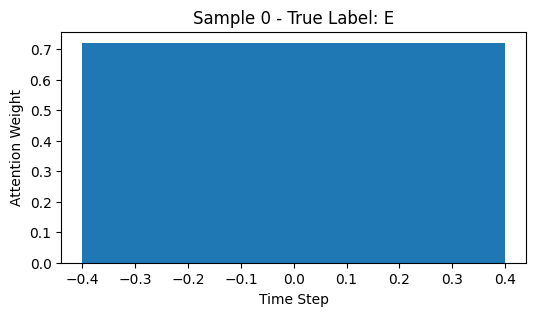

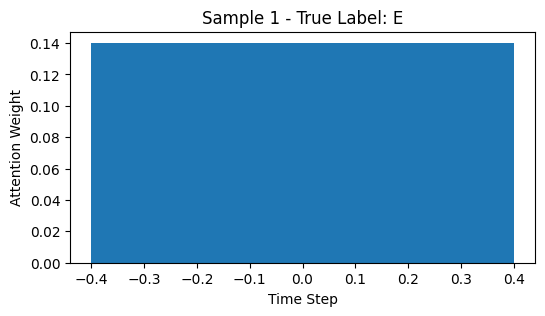

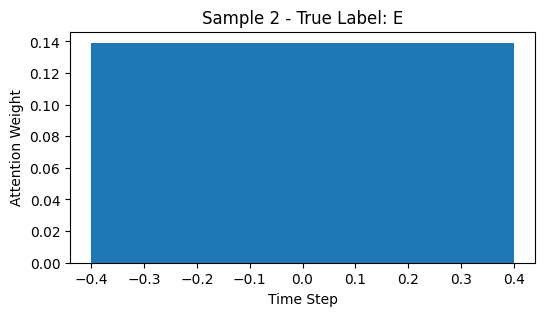

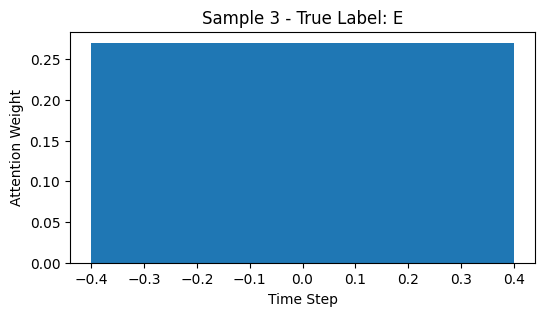

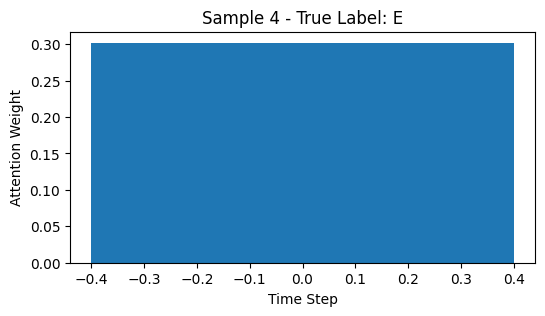

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_22          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_44 (Dropout)      │ (None, 4, 128)         │              0 │ bidirectional_22[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_23          │ (None, 4, 64)          │         41,216 │ dropout_44[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_23[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_23[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_67 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_22    │ (None, 64)             │            256 │ dense_67[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_66 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_46 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_45 (Dropout)      │ (None, 64)             │              0 │ dense_66[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_68 (Dense)          │ (None, 32)             │          2,080 │ dropout_46[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_11            │ (None, 96)             │              0 │ dropout_45[0][0],      │
│ (Concatenate)             │                        │                │ dense_68[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step

Epoch 1: val_f1_macro = 0.3210
98/98 ━━━━━━━━━━━━━━━━━━━━ 21s 51ms/step - accuracy: 0.1982 - loss: 34.3016 - val_accuracy: 0.2865 - val_loss: 2.2666 - val_f1_macro: 0.3210 - learning_rate: 0.0010
Epoch 2/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.3344
98/98 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.2676 - loss: 15.1170 - val_accuracy: 0.3303 - val_loss: 2.0214 - val_f1_macro: 0.3344 - learning_rate: 0.0010
Epoch 3/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.3697
98/98 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step - accuracy: 0.2751 - loss: 13.2828 - val_accuracy: 0.3146 - val_loss: 2.0257 - val_f1_macro: 0.3697 - learning_rate: 0.0010
Epoch 4/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.4212
98/98 ━━━━━━━━━━━━━━━━━━━━ 2s 17ms/step - accuracy: 0.2748 - loss: 13.2050 - val_accuracy: 0.4011 - val_loss: 1.9807 - val_f1_macro: 0.4212 - learning_rate: 0.0010
Epoch 5/20

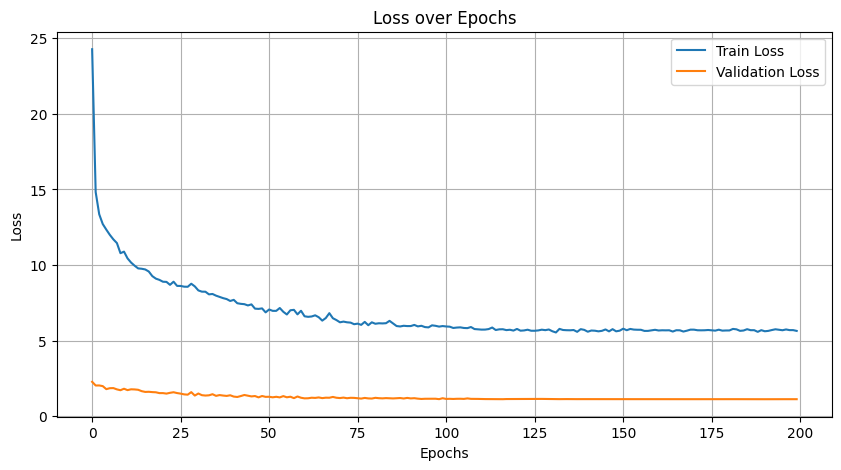

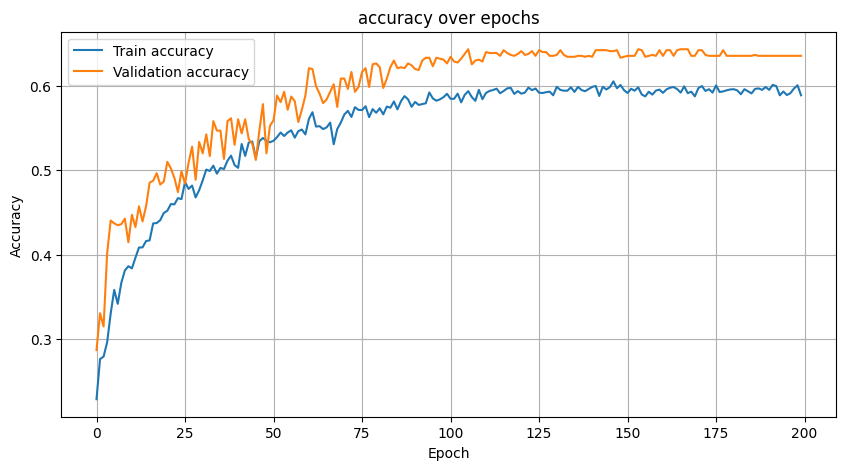

223/223 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.71269962 0.40122378 0.60725859 0.58060373 0.73333333]
Precision (per class): [0.7636897  0.65014164 0.4720403  0.50334076 0.57894737]
Recall (per class): [0.66809239 0.29013906 0.8510445  0.68588771 1.        ]
Accuracy: 0.6263
AUC (One-vs-Rest): 0.8896

Classification Report:
              precision    recall  f1-score   support

           E       0.76      0.67      0.71      3507
           D       0.65      0.29      0.40      1582
           C       0.47      0.85      0.61      1101
           B       0.50      0.69      0.58       659
           A       0.58      1.00      0.73       264

    accuracy                           0.63      7113
   macro avg       0.59      0.70      0.61      7113
weighted avg       0.66      0.63      0.62      7113



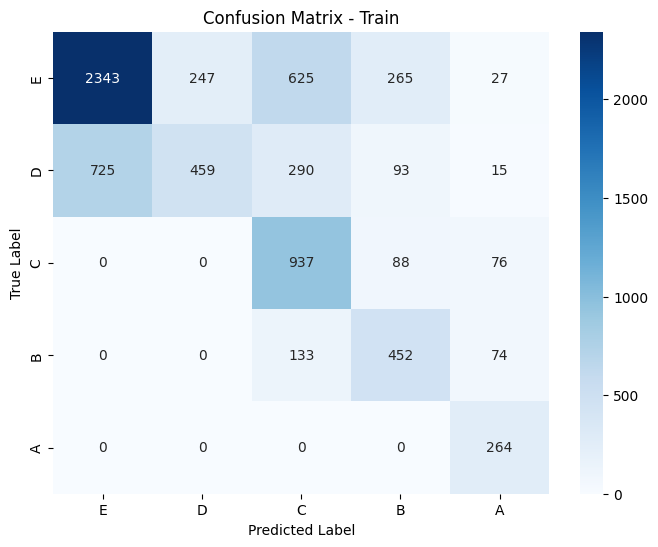

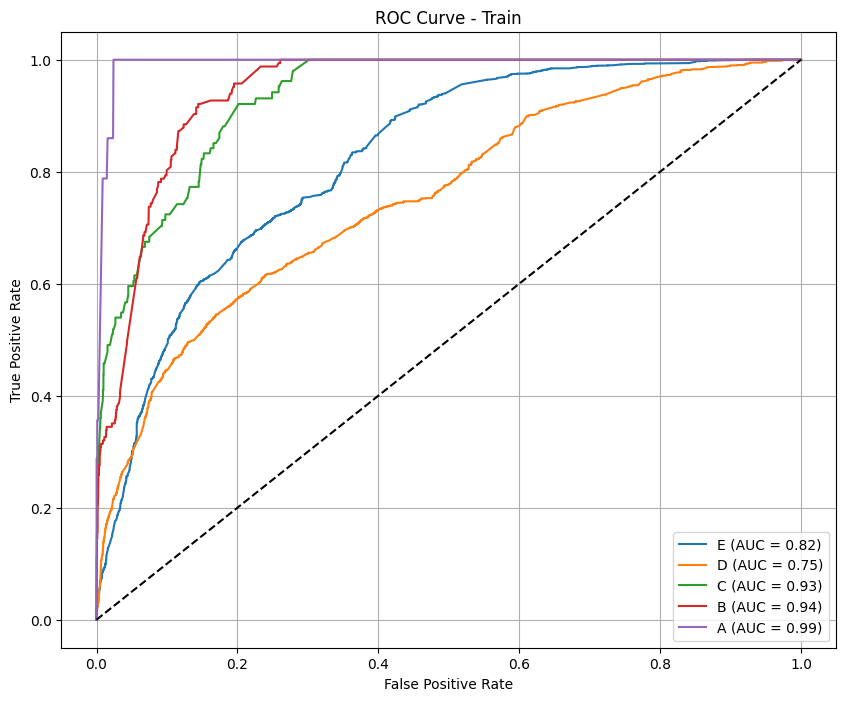

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.6900103  0.14096916 0.02469136 0.0952381  0.        ]
Precision (per class): [0.80528846 0.11267606 0.01587302 0.06060606 0.        ]
Recall (per class): [0.6036036  0.18823529 0.05555556 0.22222222 0.        ]
Accuracy: 0.5182
AUC (One-vs-Rest): 0.5708

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.60      0.69       555
           D       0.11      0.19      0.14        85
           C       0.02      0.06      0.02        18
           B       0.06      0.22      0.10        18
           A       0.00      0.00      0.00        11

    accuracy                           0.52       687
   macro avg       0.20      0.21      0.19       687
weighted avg       0.67      0.52      0.58       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


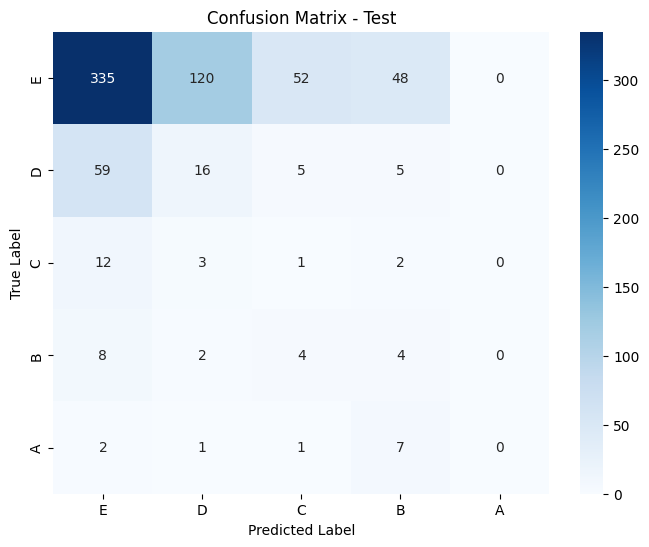

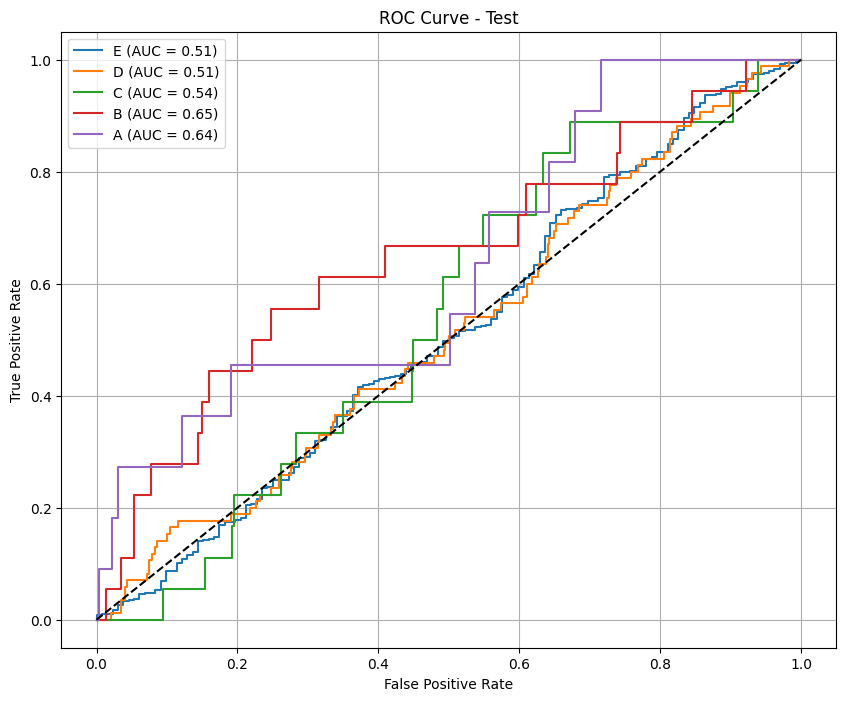

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_standard.csv
223/223 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
[[0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.2356716 ]
 [0.24704121]
 [0.23862764]
 [0.27865958]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.44433036]
 [0.21962874]
 [0.2050686 ]
 [0.13097227]
 [0.2518438 ]
 [0.24737461]
 [0.24777918]
 [0.25300255]
 [0.35649714]
 [0.2292909 ]
 [0.21362512]
 [0.20058697]
 [0.24496014]
 [0.26543853]
 [0.26116043]
 [0.2284408 ]
 [0.6193428 ]
 [0.15466103]
 [0.11533803]
 [0.11065817]
 [0.35649714]
 [0.2292909 ]
 [0.

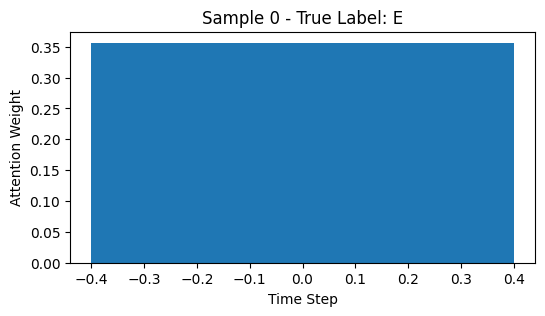

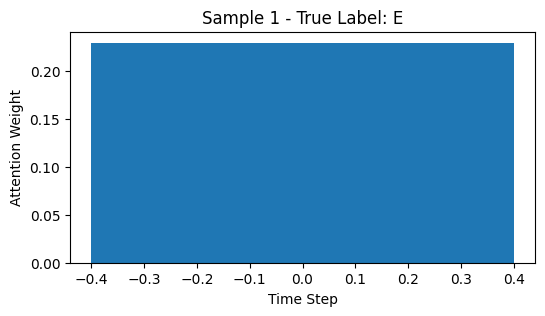

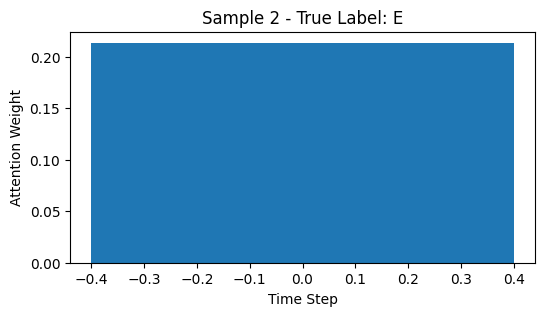

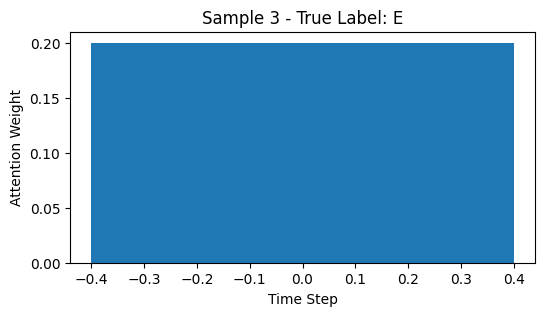

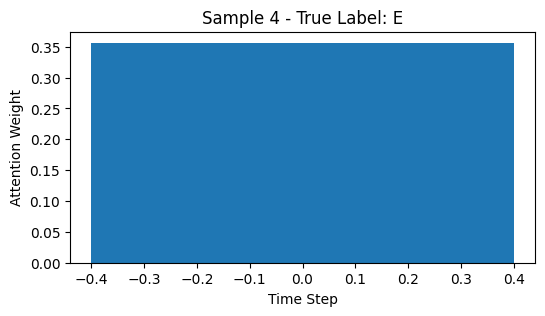

In [27]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, metric='f1_macro') 

### Tạo mẫu ảo 

In [28]:
# !pip install -U imbalanced-learn

In [29]:
# khoi dong lai kernal
# import os
# os.kill(os.getpid(), 9)

In [30]:
# from imblearn.over_sampling import SMOTE

# def apply_smote(X, y):
#     smote = SMOTE(sampling_strategy=0.4, random_state=42) 
#     X_resampled, y_resampled = smote.fit_resample(X, y)
#     return X_resampled, y_resampled

In [31]:
# # Đọc và xử lý dữ liệu cho từng phase
# def process_smote_phase(phase, scale='standard', metric='accuracy'):
#     # Đọc dữ liệu
#     X_train, y_train, X_test, y_test = load_data(phase)
#     X_train, y_train = apply_smote(X_train, y_train)
#     # Scale dữ liệu
#     X_train_scaled, X_test_scaled = scale_data(X_train, X_test, scaler_type=scale)
#     X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
#     X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
#     # Thiết lập StratifiedKFold
#     skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)
    
#     # Định nghĩa mô hình XGBoost
#     model = XGBClassifier(random_state=42)
    
#     # Định nghĩa các tham số cần tìm kiếm (cho GridSearchCV hoặc RandomizedSearchCV)
#     param_grid = {
#         'max_depth': [7, 9],
#         'learning_rate': [0.02, 0.1],
#         'n_estimators': [200],
#         'subsample': [0.7, 0.8],
#         'colsample_bytree': [0.7, 0.8, 0.9]
#     }
    
#     # Sử dụng GridSearchCV hoặc RandomizedSearchCV
#     # GridSearchCV: Thử tất cả các kết hợp tham số
#     # grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=skf, scoring='accuracy', n_jobs=-1)
    
#     # RandomizedSearchCV: Thử ngẫu nhiên một số lượng tham số
#     randomized_search = RandomizedSearchCV(
#         estimator=model,
#         param_distributions=param_grid,
#         n_iter=35,
#         cv=skf,
#         scoring=metric,
#         random_state=42,
#         n_jobs=-1,
#         verbose=2 
#     )
    
#     # Huấn luyện mô hình với RandomizedSearchCV
#     randomized_search.fit(X_train_scaled, y_train)
    
#     # In ra tham số tốt nhất
#     print(f"Best Parameters for phase {phase}: {randomized_search.best_params_}")
#     best_params = randomized_search.best_params_

#     # Dự đoán trên tập test
#     y_pred = randomized_search.best_estimator_.predict(X_test_scaled)
    
#     # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
#     results_df = X_test.copy()
#     results_df['True_Label'] = y_test
#     results_df['Predicted_Label'] = y_pred
    
#     # Lưu kết quả dự đoán
#     results_filename = f"test_results_smote_{scale}_{metric}_{phase}.csv"
#     results_df.to_csv(results_filename, index=False)
#     print(f"Results saved as {results_filename}")
    
#     # Đánh giá mô hình
#     print(f"Results for phase: {phase}")
#     evaluate_model(randomized_search.best_estimator_, X_train_scaled, y_train, X_test_scaled, y_test)

#     # Tính toán calibrate model
#     calibrate_train_model = calibrate_model(randomized_search.best_estimator_, X_train_scaled, y_train)
#     # Dự đoán trên tập test
#     y_calibrate_pred = calibrate_train_model.predict(X_test_scaled)
#     # Tạo DataFrame chứa dữ liệu test và nhãn dự đoán
#     results_df = X_test.copy()
#     results_df['True_Label'] = y_test
#     results_df['Predicted_Label'] = y_calibrate_pred
    
#     # Lưu kết quả dự đoán
#     results_filename = f"test_results_calibrate_smote_{scale}_{metric}_{phase}.csv"
#     results_df.to_csv(results_filename, index=False)
#     print(f"Results saved as {results_filename}")
    
#     # Đánh giá mô hình
#     print(f"Results for phase: {phase}")
#     evaluate_model(calibrate_train_model, X_train_scaled, y_train, X_test_scaled, y_test)
    
#     print("\nBoruta Trick:")
#     important_features = boruta_trick(randomized_search.best_estimator_, X_train_scaled, y_train)

In [32]:
# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_smote_phase(phase, scale='standard', metric='f1_macro')

# 2. Scale dữ liệu theo Robust 

### robust

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_24"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_24          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_48 (Dropout)      │ (None, 1, 128)         │              0 │ bidirectional_24[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_25          │ (None, 1, 64)          │         41,216 │ dropout_48[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_25[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_25[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_73 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_24    │ (None, 64)             │            256 │ dense_73[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_72 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_50 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_49 (Dropout)      │ (None, 64)             │              0 │ dense_72[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_74 (Dense)          │ (None, 32)             │          2,080 │ dropout_50[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_12            │ (None, 96)             │              0 │ dropout_49[0][0],      │
│ (Concatenate)             │                        │                │ dense_74[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


140/145 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2291 - loss: 6.5530

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


42/42 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step

Epoch 1: val_f1_macro = 0.0881
145/145 ━━━━━━━━━━━━━━━━━━━━ 21s 36ms/step - accuracy: 0.2295 - loss: 6.5260 - val_accuracy: 0.1634 - val_loss: 2.0141 - val_f1_macro: 0.0881 - learning_rate: 0.0010
Epoch 2/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.1633
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.2599 - loss: 4.9545 - val_accuracy: 0.3714 - val_loss: 1.6074 - val_f1_macro: 0.1633 - learning_rate: 0.0010
Epoch 3/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.1679
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3173 - loss: 4.3361 - val_accuracy: 0.3487 - val_loss: 1.6045 - val_f1_macro: 0.1679 - learning_rate: 0.0010
Epoch 4/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.1752
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3409 - loss: 4.1440 - val_accuracy: 0.3896 - val_loss: 1.4832 - val_f1_macro: 0.1752 - learning_rate: 0.0010
Epoch 5/200
42/42 

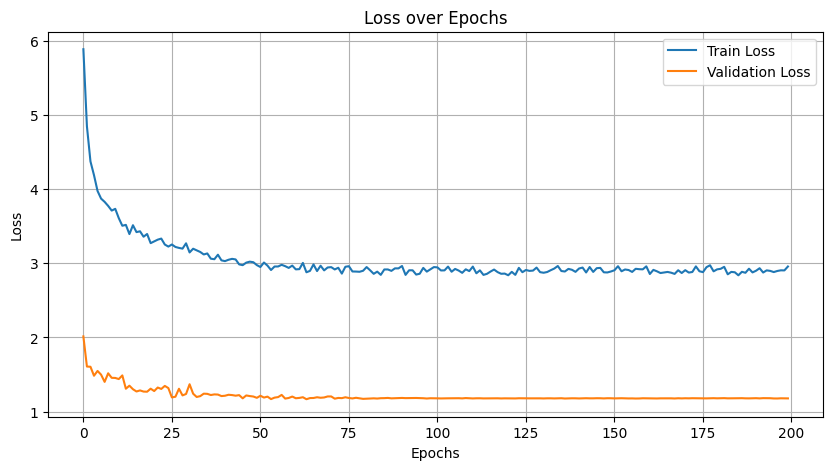

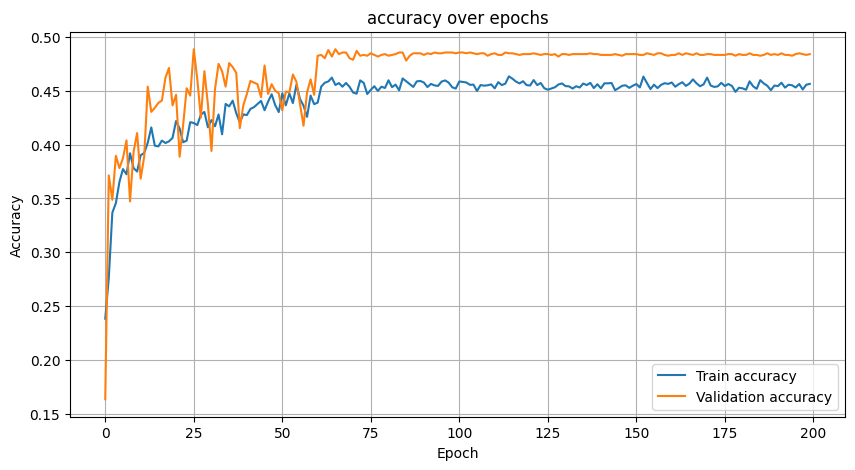

331/331 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.67552244 0.31907977 0.11575239 0.25125628 0.17857143]
Precision (per class): [0.77451709 0.6787234  0.06209503 0.2173913  0.10152284]
Recall (per class): [0.59896581 0.20856489 0.85185185 0.29761905 0.74074074]
Accuracy: 0.4856
AUC (One-vs-Rest): 0.8084

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.60      0.68      6962
           D       0.68      0.21      0.32      3059
           C       0.06      0.85      0.12       270
           B       0.22      0.30      0.25       252
           A       0.10      0.74      0.18        27

    accuracy                           0.49     10570
   macro avg       0.37      0.54      0.31     10570
weighted avg       0.71      0.49      0.55     10570



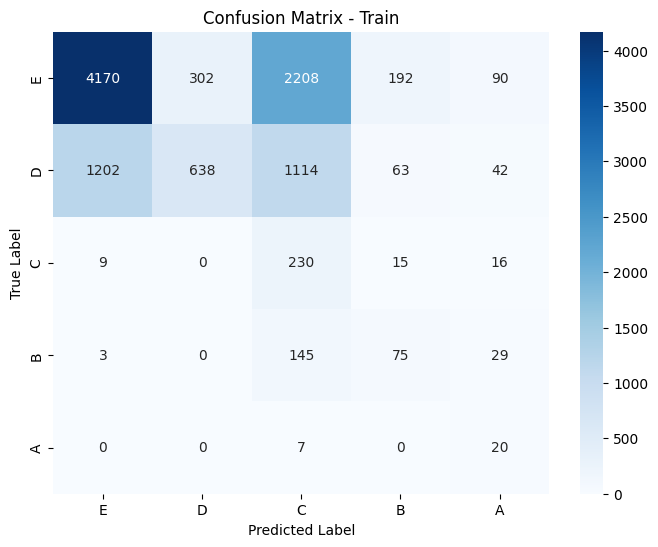

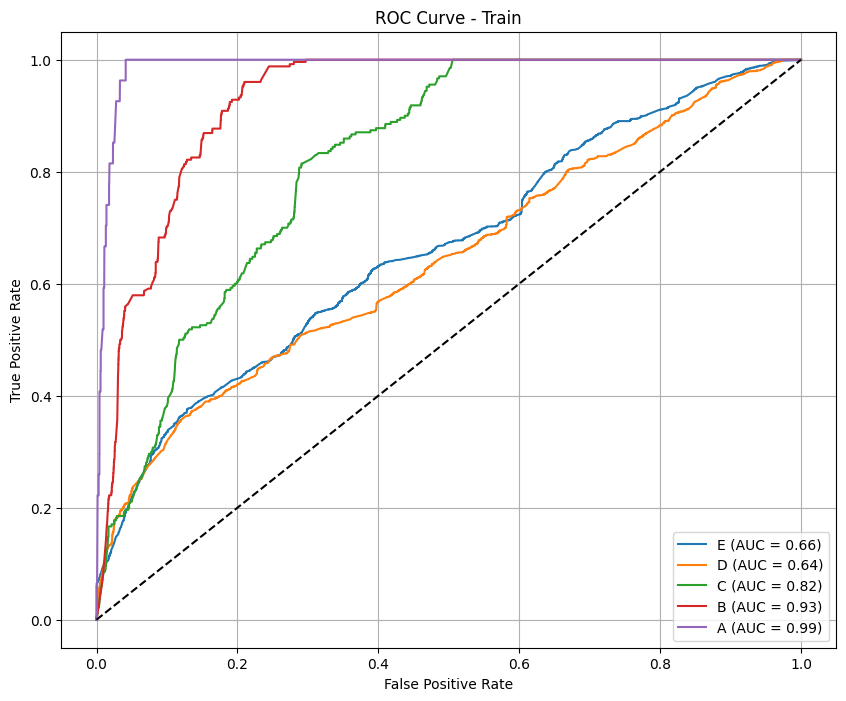

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.87777778 0.07920792 0.01923077 0.10810811 0.        ]
Precision (per class): [0.85869565 0.57142857 0.01190476 0.0952381  0.        ]
Recall (per class): [0.89772727 0.04255319 0.05       0.125      0.        ]
Accuracy: 0.7407
AUC (One-vs-Rest): 0.7320

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.90      0.88       616
           D       0.57      0.04      0.08        94
           C       0.01      0.05      0.02        20
           B       0.10      0.12      0.11        16
           A       0.00      0.00      0.00        10

    accuracy                           0.74       756
   macro avg       0.31      0.22      0.22       756
weighted avg       0.77      0.74      0.73       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


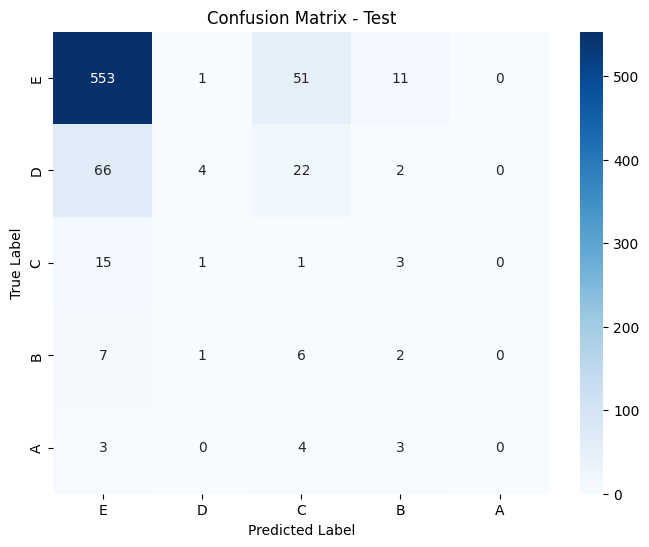

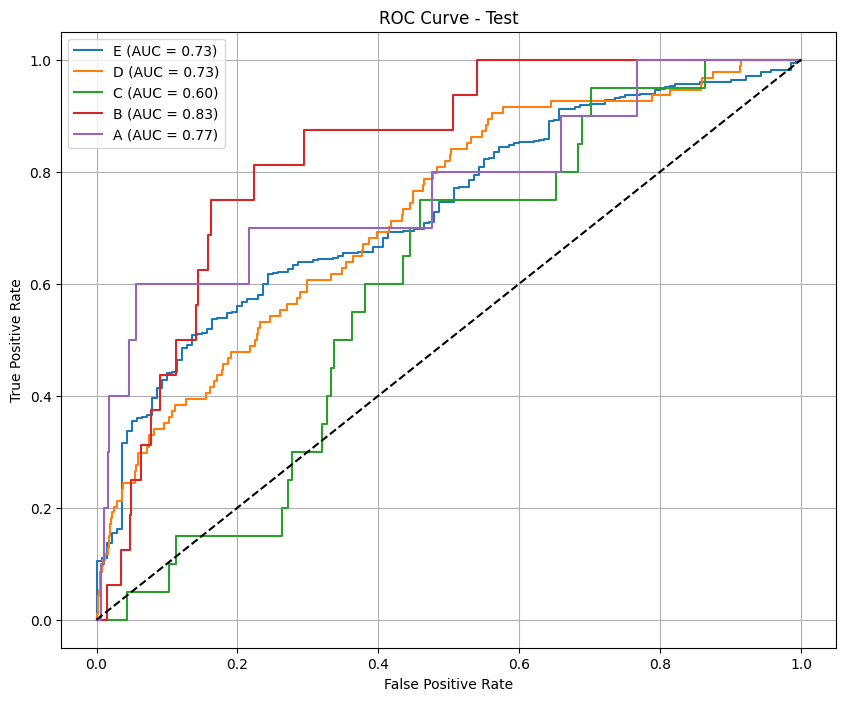

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_robust.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


330/331 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


331/331 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

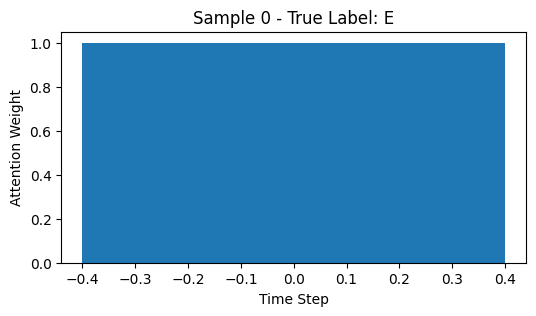

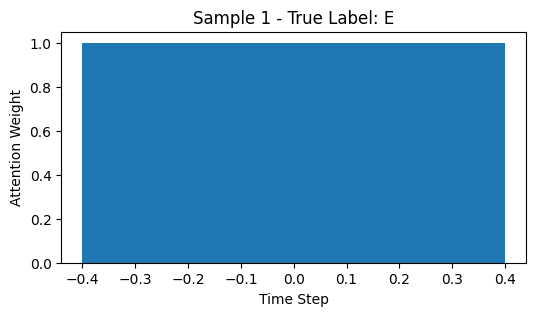

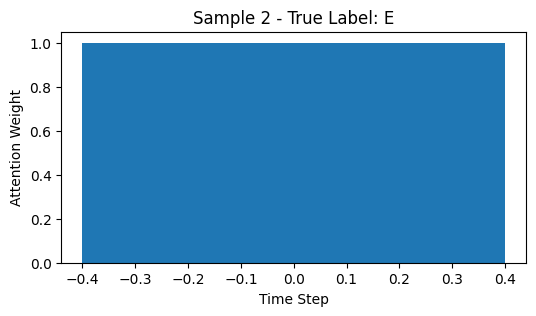

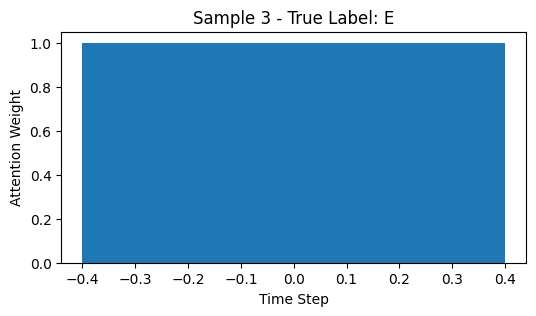

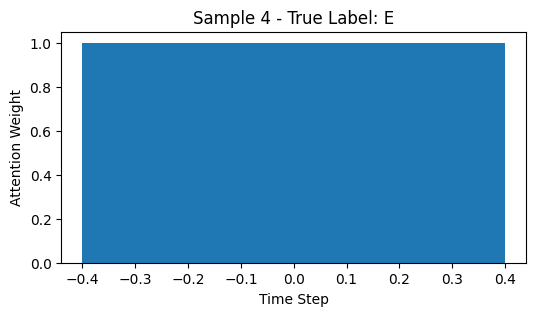

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_26"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_26          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_52 (Dropout)      │ (None, 2, 128)         │              0 │ bidirectional_26[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_27          │ (None, 2, 64)          │         41,216 │ dropout_52[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_27[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_27[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_79 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_26    │ (None, 64)             │            256 │ dense_79[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_78 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_54 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_53 (Dropout)      │ (None, 64)             │              0 │ dense_78[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_80 (Dense)          │ (None, 32)             │          2,080 │ dropout_54[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_13            │ (None, 96)             │              0 │ dropout_53[0][0],      │
│ (Concatenate)             │                        │                │ dense_80[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 3s 42ms/step

Epoch 1: val_f1_macro = 0.1540
117/117 ━━━━━━━━━━━━━━━━━━━━ 22s 51ms/step - accuracy: 0.1841 - loss: 6.1695 - val_accuracy: 0.3358 - val_loss: 1.6490 - val_f1_macro: 0.1540 - learning_rate: 0.0010
Epoch 2/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1742
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.2550 - loss: 5.7193 - val_accuracy: 0.4013 - val_loss: 1.6677 - val_f1_macro: 0.1742 - learning_rate: 0.0010
Epoch 3/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.1853
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.3140 - loss: 4.5876 - val_accuracy: 0.3779 - val_loss: 1.6174 - val_f1_macro: 0.1853 - learning_rate: 0.0010
Epoch 4/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2434
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.3410 - loss: 4.3669 - val_accuracy: 0.3714 - val_loss: 1.5963 - val_f1_macro: 0.2434 - learning_rate: 0.0010
Epoch 

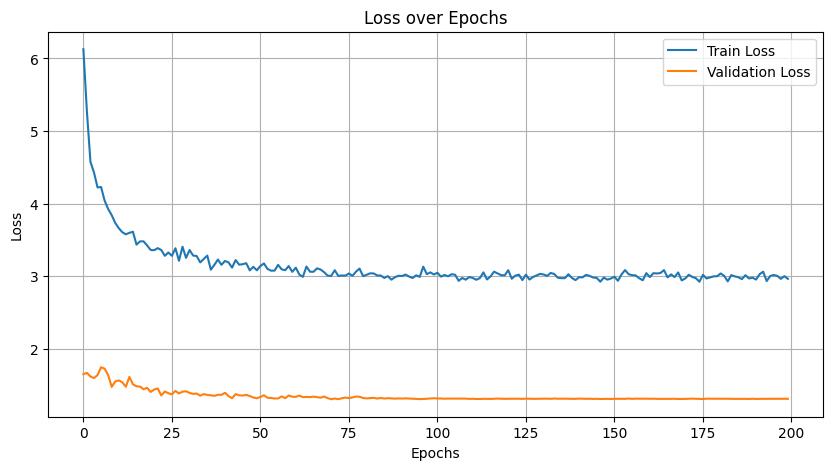

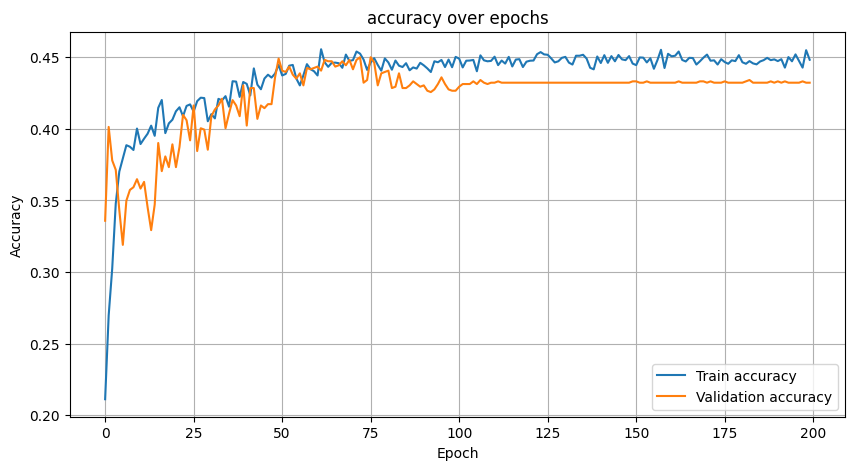

268/268 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.65652775 0.2083045  0.10998093 0.32196453 0.19900498]
Precision (per class): [0.73768309 0.67337808 0.05932785 0.23459245 0.11363636]
Recall (per class): [0.59145907 0.12320917 0.75217391 0.51304348 0.8       ]
Accuracy: 0.4605
AUC (One-vs-Rest): 0.7948

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.59      0.66      5620
           D       0.67      0.12      0.21      2443
           C       0.06      0.75      0.11       230
           B       0.23      0.51      0.32       230
           A       0.11      0.80      0.20        25

    accuracy                           0.46      8548
   macro avg       0.36      0.56      0.30      8548
weighted avg       0.69      0.46      0.50      8548



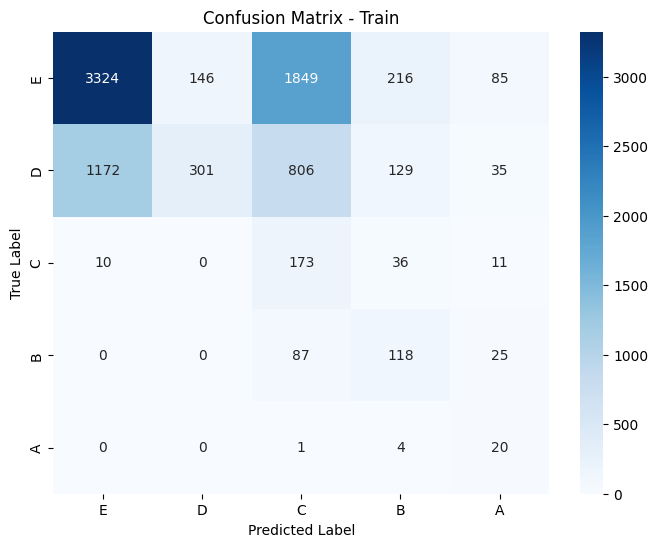

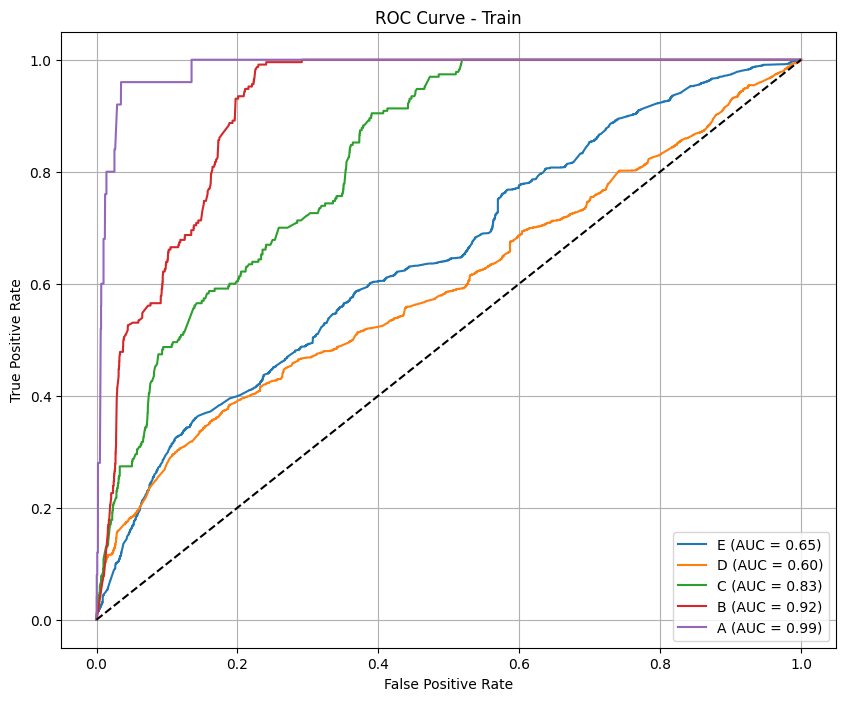

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.72196901 0.04       0.0372093  0.06451613 0.        ]
Precision (per class): [0.81147541 0.25       0.02051282 0.04255319 0.        ]
Recall (per class): [0.65024631 0.02173913 0.2        0.13333333 0.        ]
Accuracy: 0.5416
AUC (One-vs-Rest): 0.5749

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.65      0.72       609
           D       0.25      0.02      0.04        92
           C       0.02      0.20      0.04        20
           B       0.04      0.13      0.06        15
           A       0.00      0.00      0.00        10

    accuracy                           0.54       746
   macro avg       0.22      0.20      0.17       746
weighted avg       0.69      0.54      0.60       746



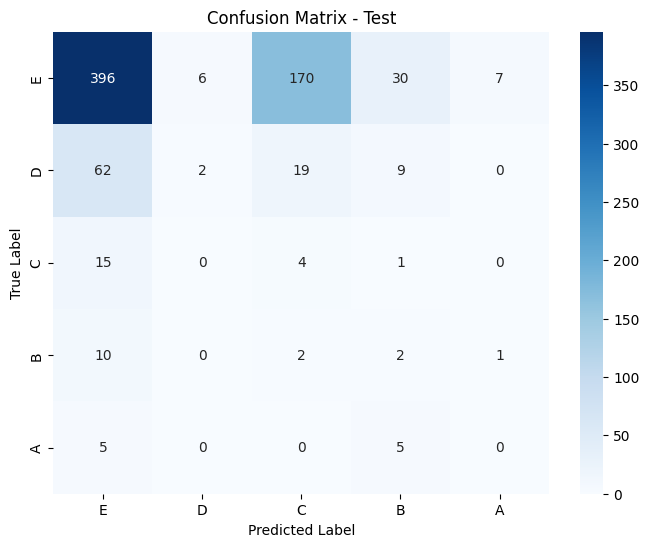

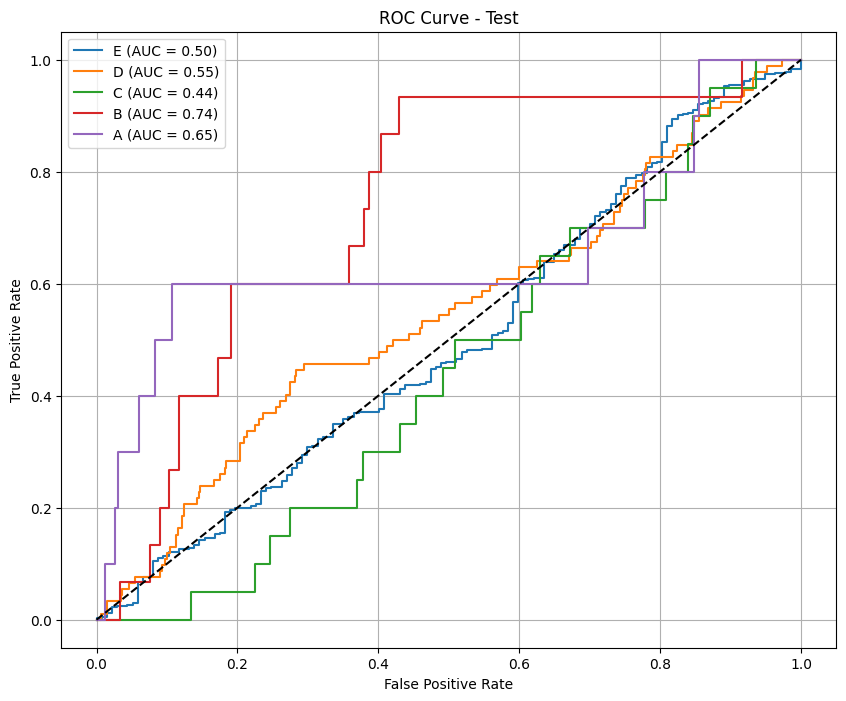

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_robust.csv
268/268 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.4416962 ]
 [0.5583038 ]
 [0.4491439 ]
 [0.5508561 ]
 [0.33795536]
 [0.6620447 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.40810034]
 [0.59189975]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.46311778]
 [0.5368823 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.44325665]
 [0.5567434 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.376321  ]
 [0.6236789 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.2809181 ]
 [0.7190819 ]
 [0.41676396]
 [0.5832361 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.45395863]
 [0.5460413 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4416962 ]
 [0.5583038 ]
 [0.4313163 ]
 [0.5686837 ]
 [0.46

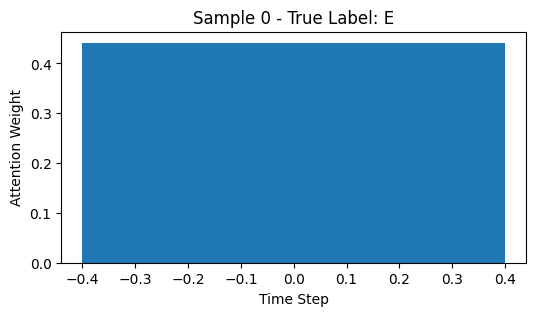

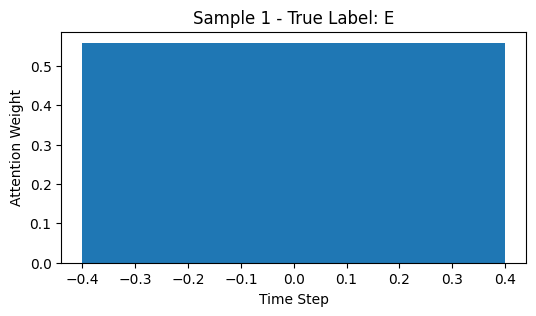

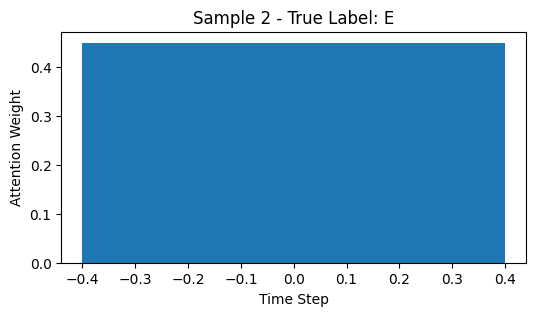

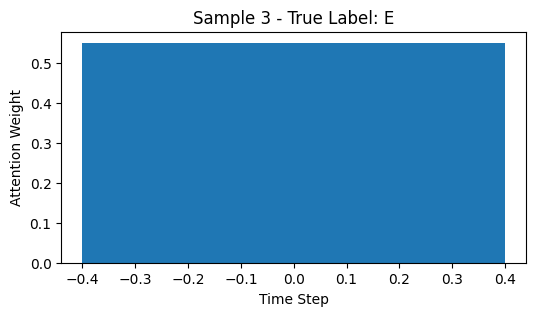

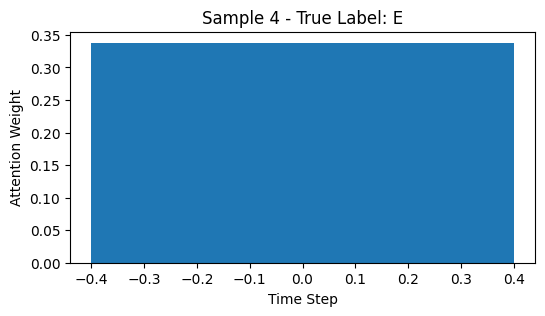

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_28"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_28          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_56 (Dropout)      │ (None, 3, 128)         │              0 │ bidirectional_28[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_29          │ (None, 3, 64)          │         41,216 │ dropout_56[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_29[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_29[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_85 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_28    │ (None, 64)             │            256 │ dense_85[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_84 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_58 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_2… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_57 (Dropout)      │ (None, 64)             │              0 │ dense_84[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_86 (Dense)          │ (None, 32)             │          2,080 │ dropout_58[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_14            │ (None, 96)             │              0 │ dropout_57[0][0],      │
│ (Concatenate)             │                        │                │ dense_86[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 5s 52ms/step

Epoch 1: val_f1_macro = 0.1676
107/107 ━━━━━━━━━━━━━━━━━━━━ 22s 77ms/step - accuracy: 0.2088 - loss: 10.6359 - val_accuracy: 0.3637 - val_loss: 2.0792 - val_f1_macro: 0.1676 - learning_rate: 0.0010
Epoch 2/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1967
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.2782 - loss: 5.5174 - val_accuracy: 0.4600 - val_loss: 1.5459 - val_f1_macro: 0.1967 - learning_rate: 0.0010
Epoch 3/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.1817
107/107 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3538 - loss: 4.9917 - val_accuracy: 0.3709 - val_loss: 1.8222 - val_f1_macro: 0.1817 - learning_rate: 0.0010
Epoch 4/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2274
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.3279 - loss: 4.5094 - val_accuracy: 0.3576 - val_loss: 1.7648 - val_f1_macro: 0.2274 - learning_rate: 0.0010
Epoch

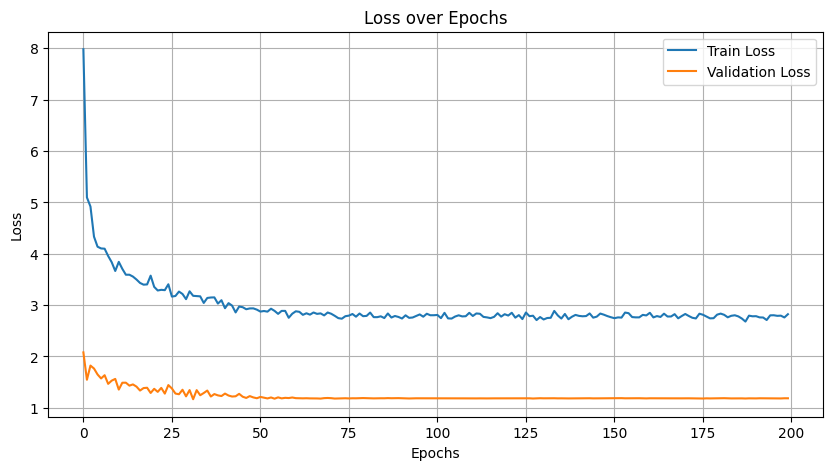

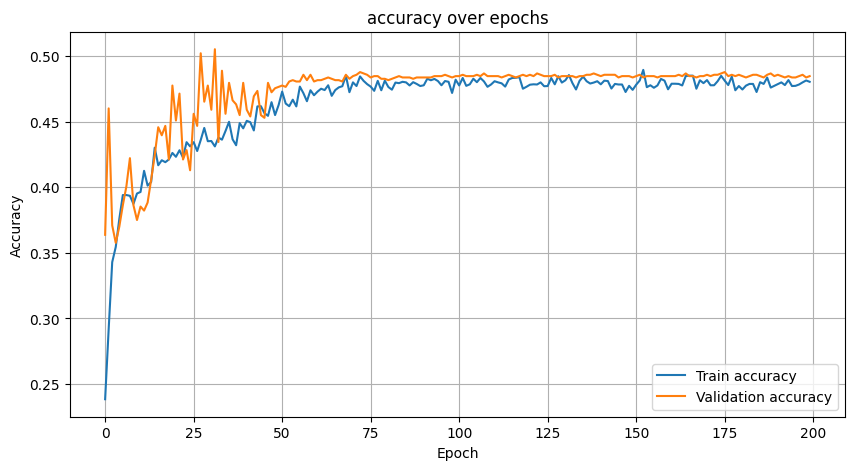

244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.67625899 0.19642177 0.1195347  0.2912844  0.18518519]
Precision (per class): [0.73844732 0.70299728 0.06478261 0.19097744 0.1048951 ]
Recall (per class): [0.62373146 0.11415929 0.77202073 0.61352657 0.78947368]
Accuracy: 0.4799
AUC (One-vs-Rest): 0.8068

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.62      0.68      5124
           D       0.70      0.11      0.20      2260
           C       0.06      0.77      0.12       193
           B       0.19      0.61      0.29       207
           A       0.10      0.79      0.19        19

    accuracy                           0.48      7803
   macro avg       0.36      0.58      0.29      7803
weighted avg       0.70      0.48      0.51      7803



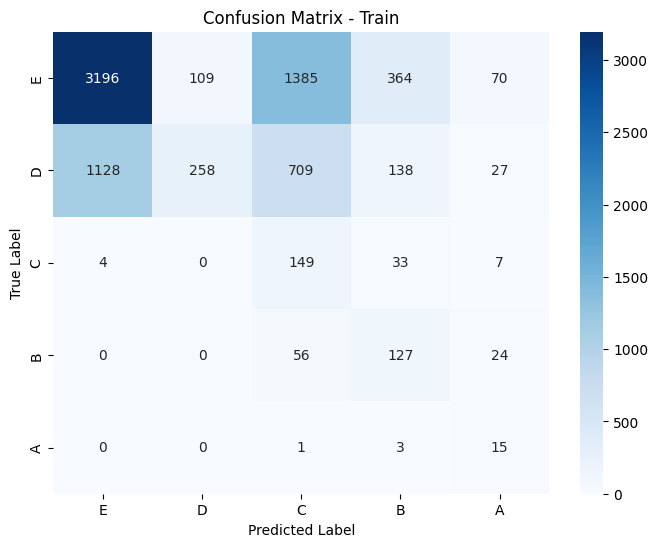

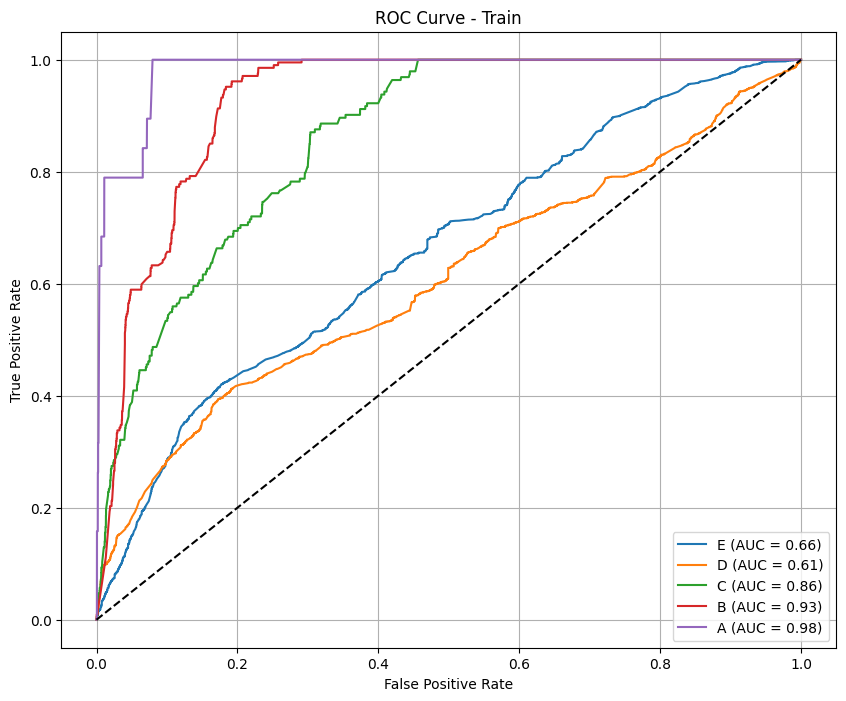

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.60770031 0.12080537 0.03802281 0.05714286 0.        ]
Precision (per class): [0.78284182 0.14516129 0.02057613 0.05263158 0.        ]
Recall (per class): [0.49659864 0.10344828 0.25       0.0625     0.        ]
Accuracy: 0.4258
AUC (One-vs-Rest): 0.5527

Classification Report:
              precision    recall  f1-score   support

           E       0.78      0.50      0.61       588
           D       0.15      0.10      0.12        87
           C       0.02      0.25      0.04        20
           B       0.05      0.06      0.06        16
           A       0.00      0.00      0.00        10

    accuracy                           0.43       721
   macro avg       0.20      0.18      0.16       721
weighted avg       0.66      0.43      0.51       721



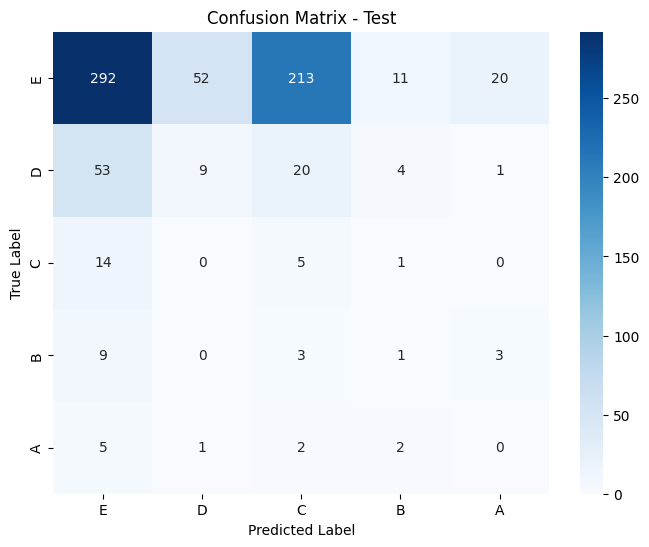

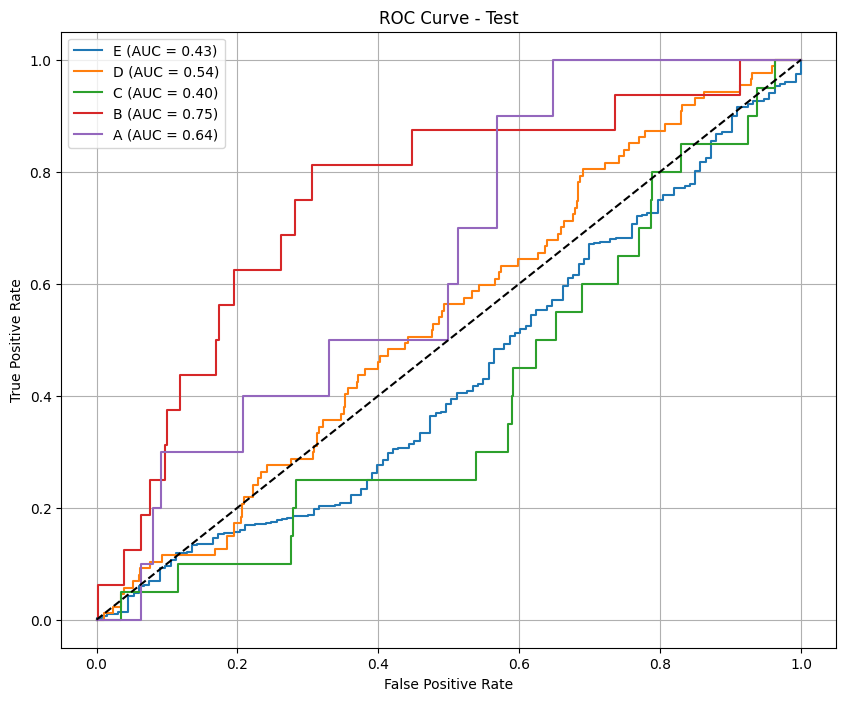

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_robust.csv
244/244 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
[[0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32035863]
 [0.42092273]
 [0.2587186 ]
 [0.07723948]
 [0.45408493]
 [0.46867552]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.15317672]
 [0.16142699]
 [0.6853962 ]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.11263673]
 [0.12004992]
 [0.76731336]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34703442]
 [0.32704282]
 [0.3259227 ]
 [0.34

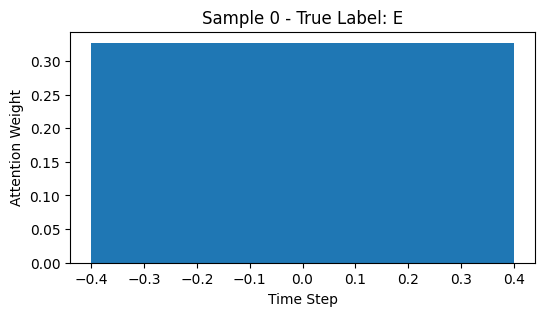

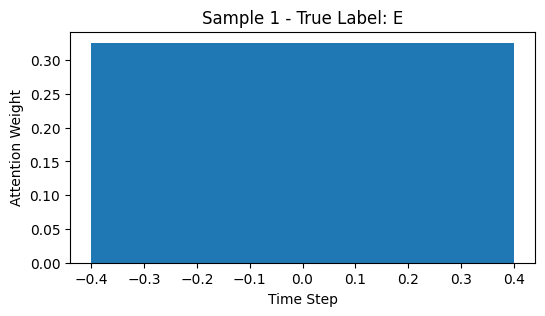

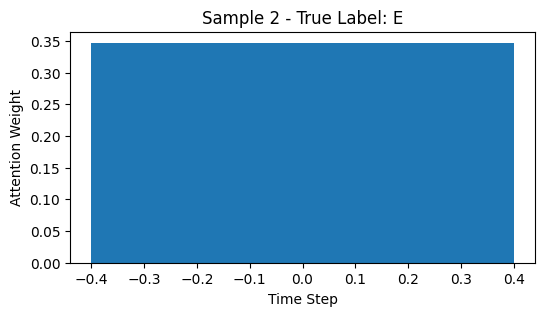

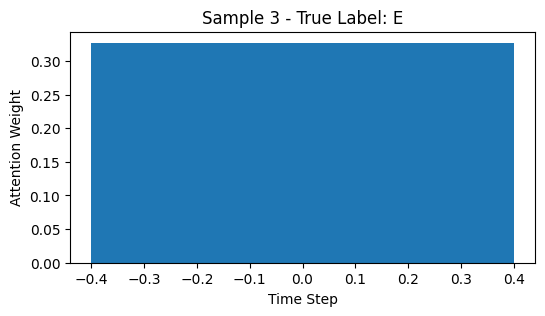

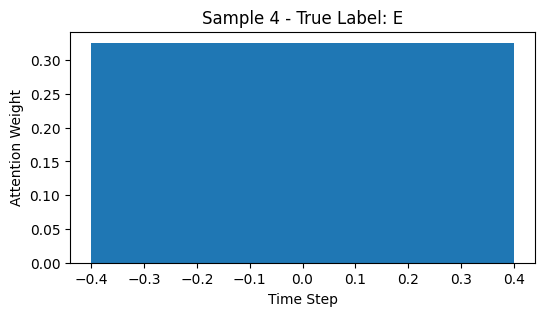

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_30          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_60 (Dropout)      │ (None, 4, 128)         │              0 │ bidirectional_30[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_31          │ (None, 4, 64)          │         41,216 │ dropout_60[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_31[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_31[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_91 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_30    │ (None, 64)             │            256 │ dense_91[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_90 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_62 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_61 (Dropout)      │ (None, 64)             │              0 │ dense_90[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_92 (Dense)          │ (None, 32)             │          2,080 │ dropout_62[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_15            │ (None, 96)             │              0 │ dropout_61[0][0],      │
│ (Concatenate)             │                        │                │ dense_92[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 60ms/step

Epoch 1: val_f1_macro = 0.1536
74/74 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.1087 - loss: 8.5375 - val_accuracy: 0.4754 - val_loss: 1.4615 - val_f1_macro: 0.1536 - learning_rate: 0.0010
Epoch 2/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2045
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.2855 - loss: 5.3804 - val_accuracy: 0.5529 - val_loss: 1.1383 - val_f1_macro: 0.2045 - learning_rate: 0.0010
Epoch 3/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2325
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.3118 - loss: 4.3859 - val_accuracy: 0.4396 - val_loss: 1.4456 - val_f1_macro: 0.2325 - learning_rate: 0.0010
Epoch 4/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2357
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.3488 - loss: 4.8261 - val_accuracy: 0.4173 - val_loss: 1.5815 - val_f1_macro: 0.2357 - learning_rate: 0.0010
Epoch 5/200
21

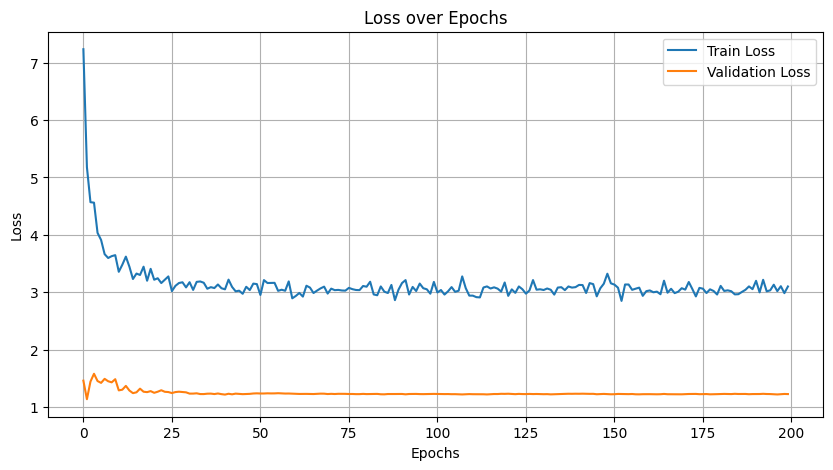

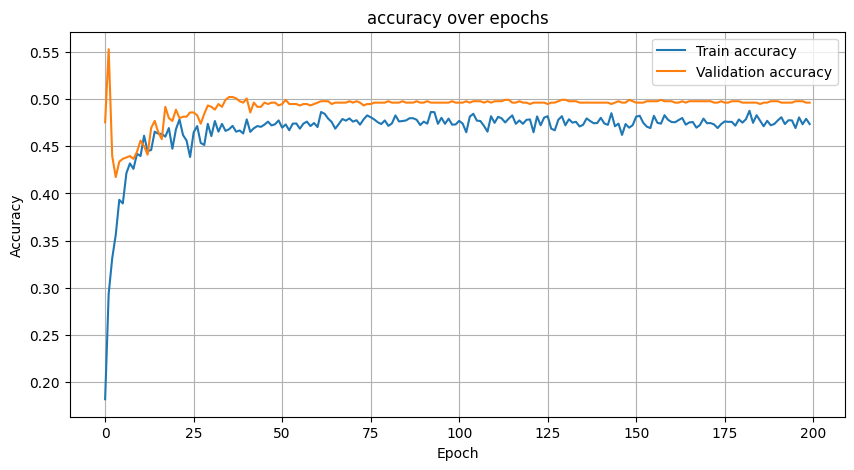

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.66646239 0.31341035 0.08634921 0.39790576 0.23333333]
Precision (per class): [0.72019868 0.76283619 0.04613297 0.27536232 0.15217391]
Recall (per class): [0.6201882  0.19721871 0.67326733 0.71698113 0.5       ]
Accuracy: 0.4990
AUC (One-vs-Rest): 0.8019

Classification Report:
              precision    recall  f1-score   support

           E       0.72      0.62      0.67      3507
           D       0.76      0.20      0.31      1582
           C       0.05      0.67      0.09       101
           B       0.28      0.72      0.40       159
           A       0.15      0.50      0.23        14

    accuracy                           0.50      5363
   macro avg       0.39      0.54      0.34      5363
weighted avg       0.71      0.50      0.54      5363



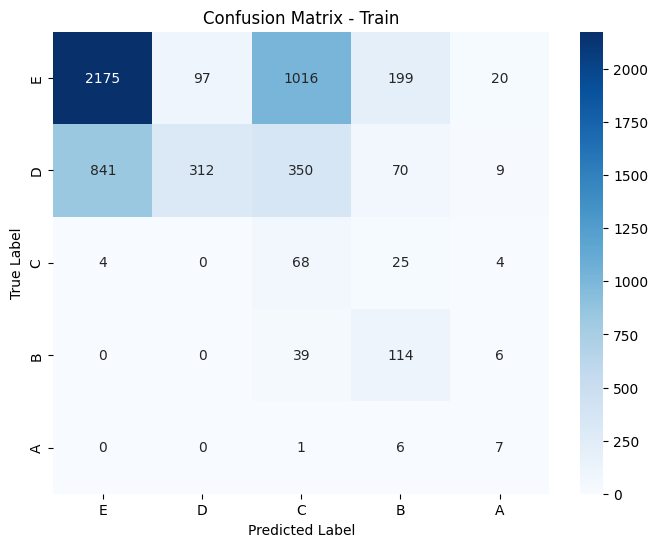

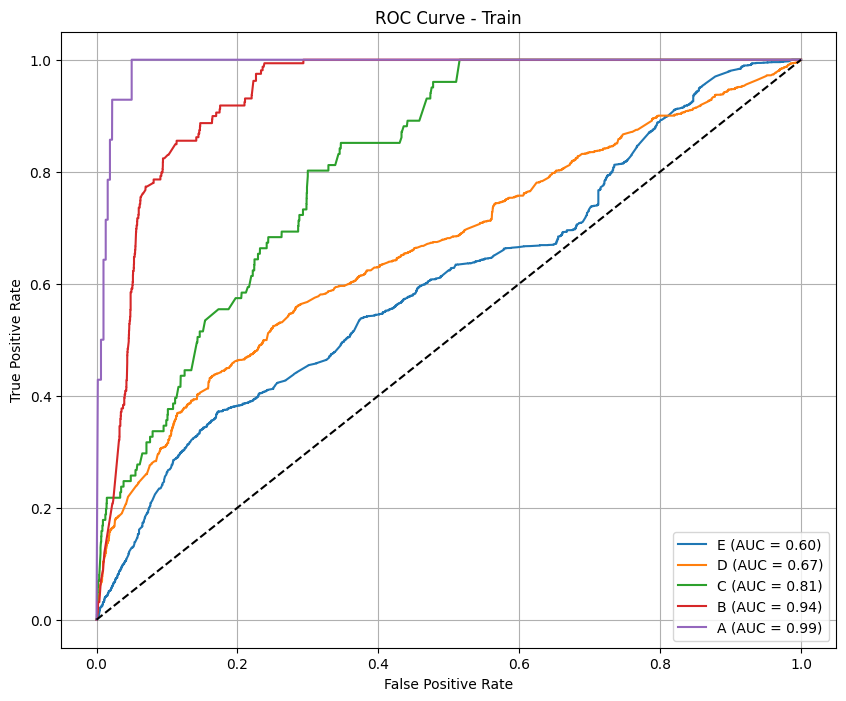

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.52784504 0.09090909 0.04444444 0.04705882 0.        ]
Precision (per class): [0.80442804 0.12765957 0.02356902 0.02985075 0.        ]
Recall (per class): [0.39279279 0.07058824 0.38888889 0.11111111 0.        ]
Accuracy: 0.3392
AUC (One-vs-Rest): 0.5696

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.39      0.53       555
           D       0.13      0.07      0.09        85
           C       0.02      0.39      0.04        18
           B       0.03      0.11      0.05        18
           A       0.00      0.00      0.00        11

    accuracy                           0.34       687
   macro avg       0.20      0.19      0.14       687
weighted avg       0.67      0.34      0.44       687



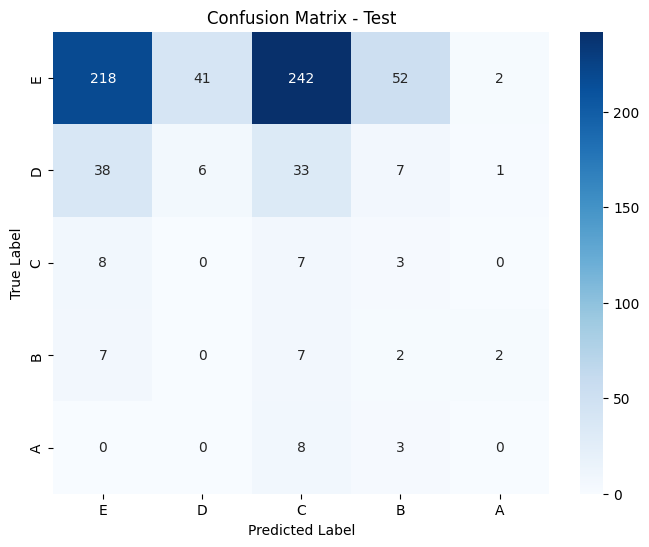

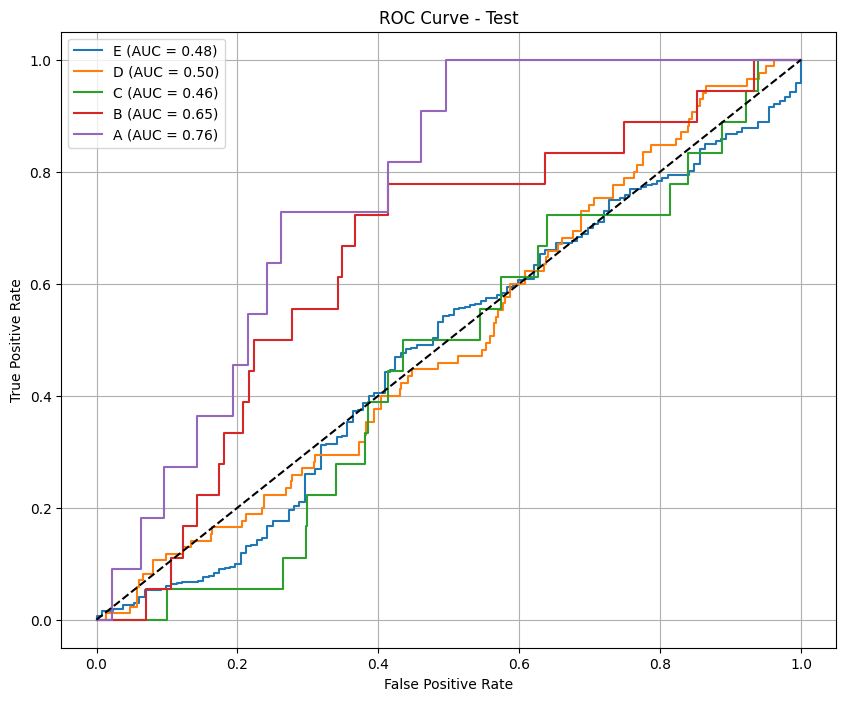

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_robust.csv
168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
[[0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.23571828]
 [0.26540494]
 [0.24185729]
 [0.25701955]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24898273]
 [0.2543706 ]
 [0.24354208]
 [0.25310457]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.24567671]
 [0.2581659 ]
 [0.24635153]
 [0.24980573]
 [0.2

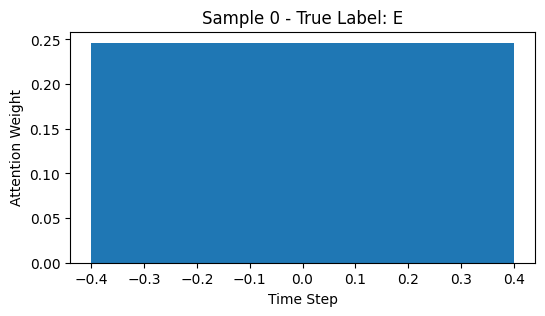

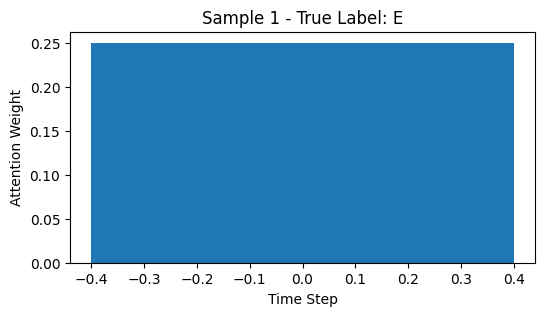

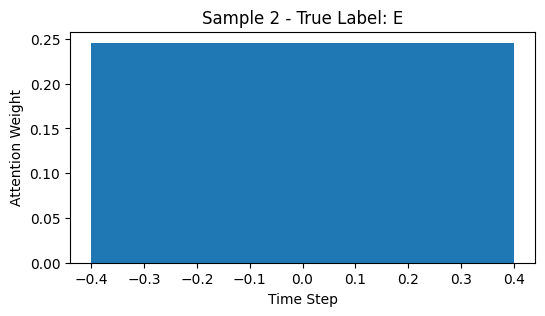

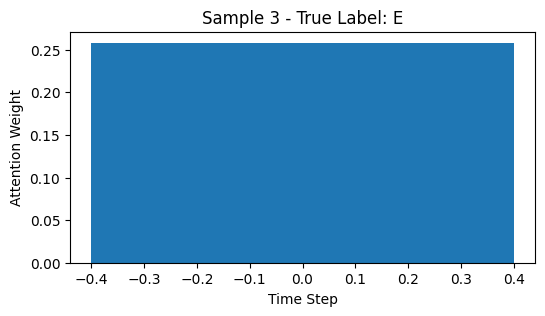

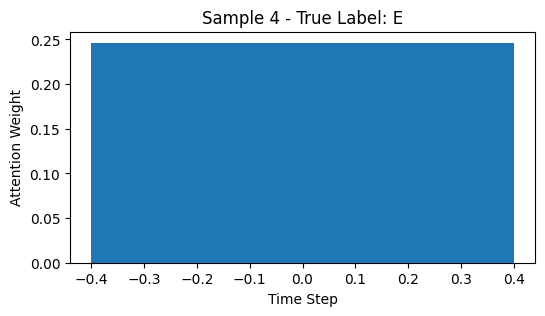

In [33]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro', scale='robust') 

### undersample

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_32"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_32          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_64 (Dropout)      │ (None, 1, 128)         │              0 │ bidirectional_32[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_33          │ (None, 1, 64)          │         41,216 │ dropout_64[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_33[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_33[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_97 (Dense)          │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_32    │ (None, 64)             │            256 │ dense_97[0][0]         │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_96 (Dense)          │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_66 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_65 (Dropout)      │ (None, 64)             │              0 │ dense_96[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_98 (Dense)          │ (None, 32)             │          2,080 │ dropout_66[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_16            │ (None, 96)             │              0 │ dropout_65[0][0],      │
│ (Concatenate)             │                        │                │ dense_98[0][0]         │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


104/104 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.1337 - loss: 8.9849

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 39ms/step

Epoch 1: val_f1_macro = 0.0751
104/104 ━━━━━━━━━━━━━━━━━━━━ 18s 42ms/step - accuracy: 0.1340 - loss: 8.9755 - val_accuracy: 0.1415 - val_loss: 2.3433 - val_f1_macro: 0.0751 - learning_rate: 0.0010
Epoch 2/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.1532
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.2092 - loss: 7.0062 - val_accuracy: 0.3178 - val_loss: 2.0205 - val_f1_macro: 0.1532 - learning_rate: 0.0010
Epoch 3/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.1575
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.2238 - loss: 5.6524 - val_accuracy: 0.3622 - val_loss: 1.6607 - val_f1_macro: 0.1575 - learning_rate: 0.0010
Epoch 4/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.1693
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.2613 - loss: 4.9183 - val_accuracy: 0.3981 - val_loss: 1.4951 - val_f1_macro: 0.1693 - learning_rate: 0.0010
Epoch 5/200
30/30 ━

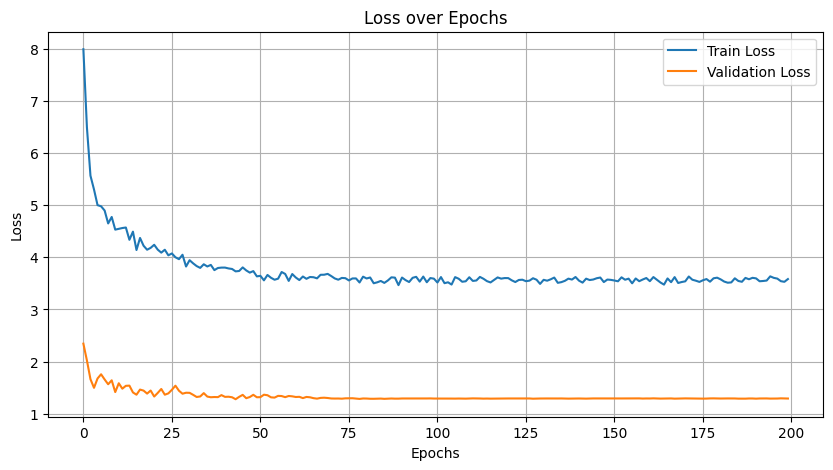

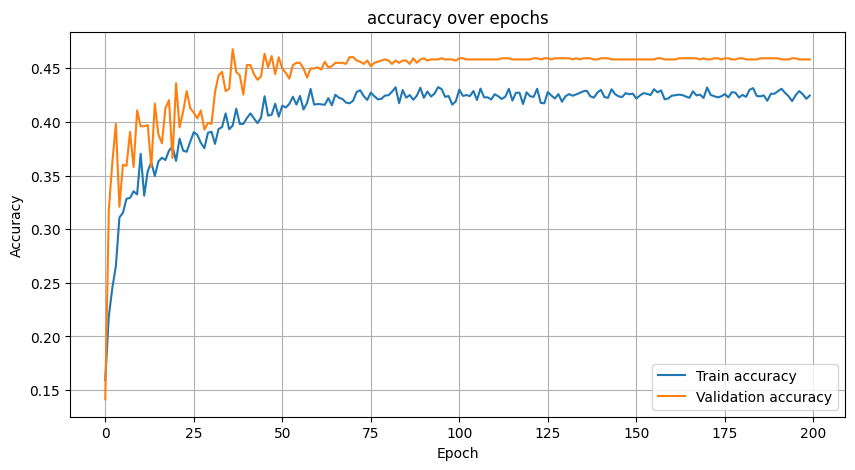

237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.63498459 0.29309036 0.13333333 0.28900524 0.19704433]
Precision (per class): [0.77071346 0.67130435 0.07348485 0.19630156 0.11363636]
Recall (per class): [0.53990326 0.18746965 0.71851852 0.54761905 0.74074074]
Accuracy: 0.4514
AUC (One-vs-Rest): 0.7998

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.54      0.63      4962
           D       0.67      0.19      0.29      2059
           C       0.07      0.72      0.13       270
           B       0.20      0.55      0.29       252
           A       0.11      0.74      0.20        27

    accuracy                           0.45      7570
   macro avg       0.37      0.55      0.31      7570
weighted avg       0.70      0.45      0.51      7570



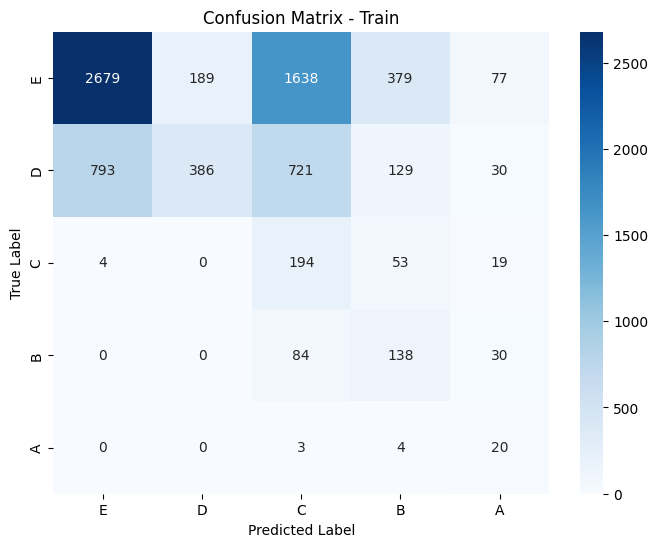

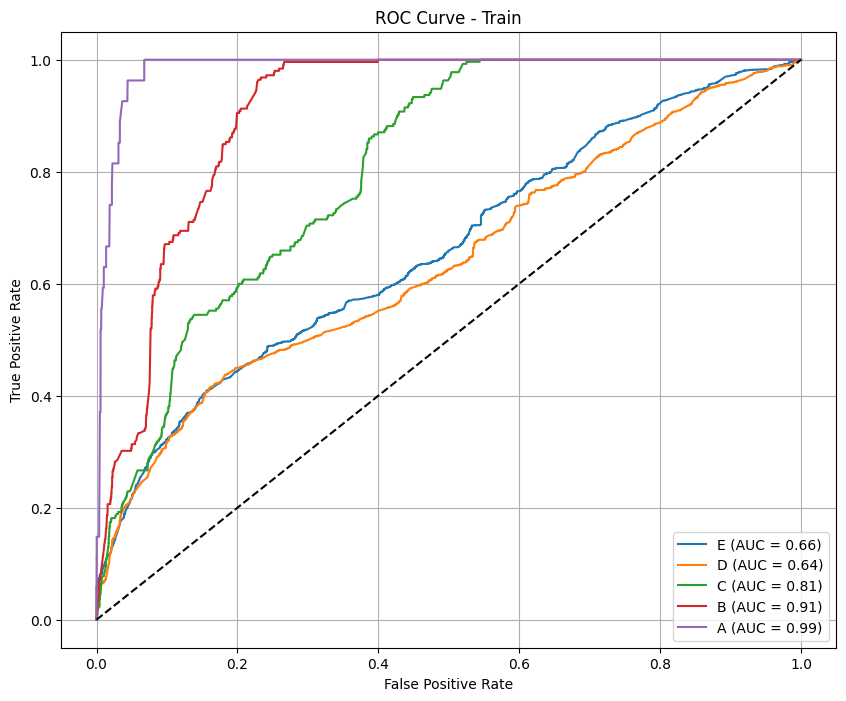

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.71931494 0.03883495 0.03921569 0.05405405 0.        ]
Precision (per class): [0.86896552 0.22222222 0.02097902 0.04761905 0.        ]
Recall (per class): [0.61363636 0.0212766  0.3        0.0625     0.        ]
Accuracy: 0.5119
AUC (One-vs-Rest): 0.6810

Classification Report:
              precision    recall  f1-score   support

           E       0.87      0.61      0.72       616
           D       0.22      0.02      0.04        94
           C       0.02      0.30      0.04        20
           B       0.05      0.06      0.05        16
           A       0.00      0.00      0.00        10

    accuracy                           0.51       756
   macro avg       0.23      0.20      0.17       756
weighted avg       0.74      0.51      0.59       756



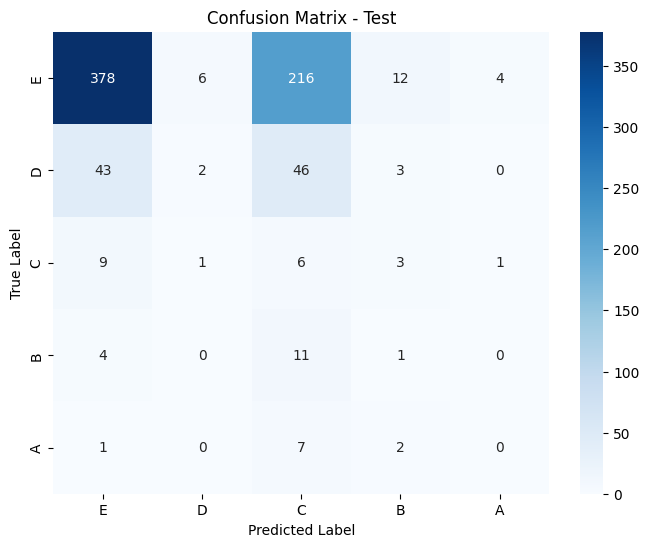

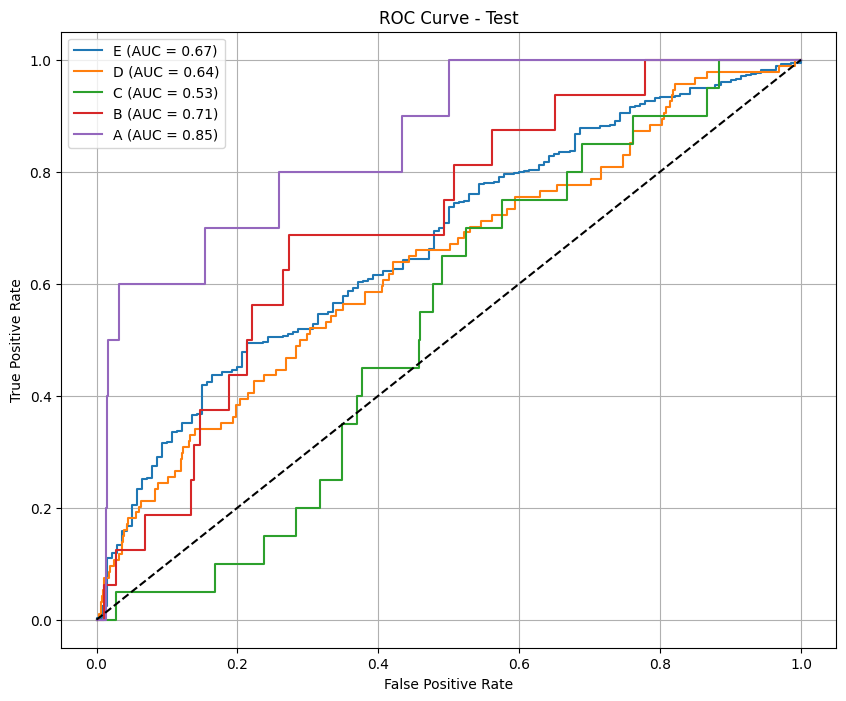

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_robust.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


227/237 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

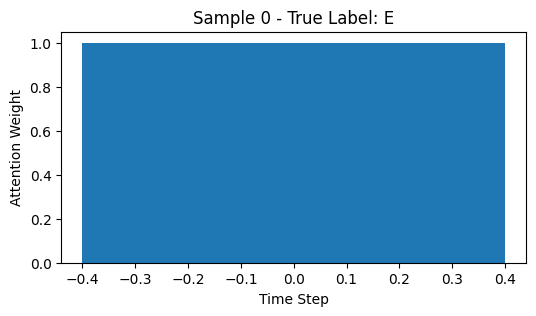

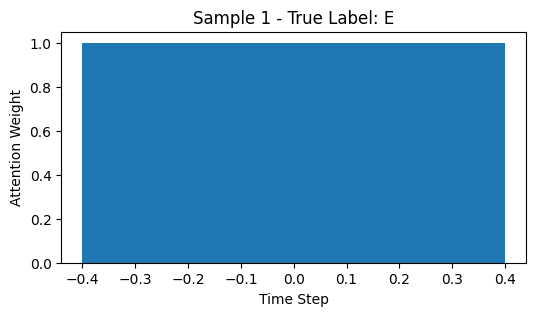

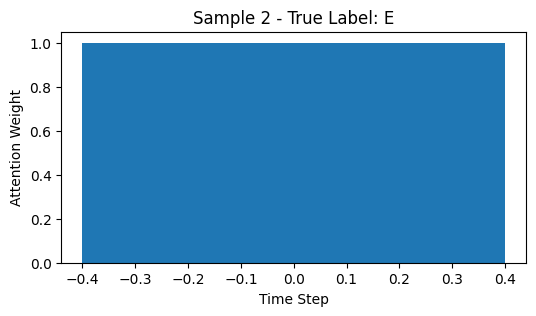

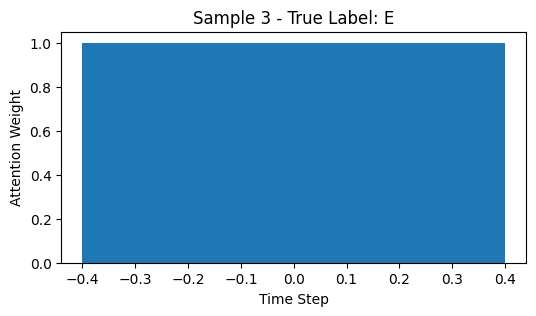

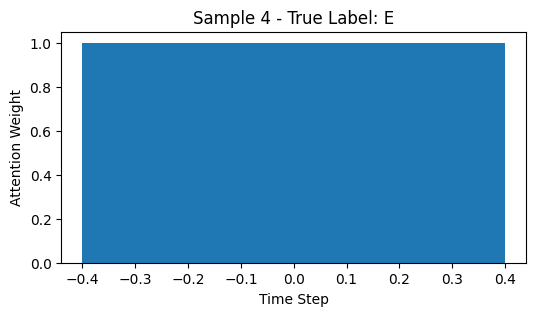

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_34"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_34          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_68 (Dropout)      │ (None, 2, 128)         │              0 │ bidirectional_34[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_35          │ (None, 2, 64)          │         41,216 │ dropout_68[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_35[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_35[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_103 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_34    │ (None, 64)             │            256 │ dense_103[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_102 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_70 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_69 (Dropout)      │ (None, 64)             │              0 │ dense_102[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_104 (Dense)         │ (None, 32)             │          2,080 │ dropout_70[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_17            │ (None, 96)             │              0 │ dropout_69[0][0],      │
│ (Concatenate)             │                        │                │ dense_104[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 57ms/step

Epoch 1: val_f1_macro = 0.1061
76/76 ━━━━━━━━━━━━━━━━━━━━ 21s 62ms/step - accuracy: 0.1748 - loss: 13.7751 - val_accuracy: 0.1542 - val_loss: 2.6071 - val_f1_macro: 0.1061 - learning_rate: 0.0010
Epoch 2/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1110
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.1825 - loss: 7.3233 - val_accuracy: 0.1369 - val_loss: 2.3005 - val_f1_macro: 0.1110 - learning_rate: 0.0010
Epoch 3/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.0354
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2192 - loss: 6.7724 - val_accuracy: 0.0735 - val_loss: 2.3911 - val_f1_macro: 0.0354 - learning_rate: 0.0010
Epoch 4/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2593
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2046 - loss: 6.6026 - val_accuracy: 0.3184 - val_loss: 1.9188 - val_f1_macro: 0.2593 - learning_rate: 0.0010
Epoch 5/200
2

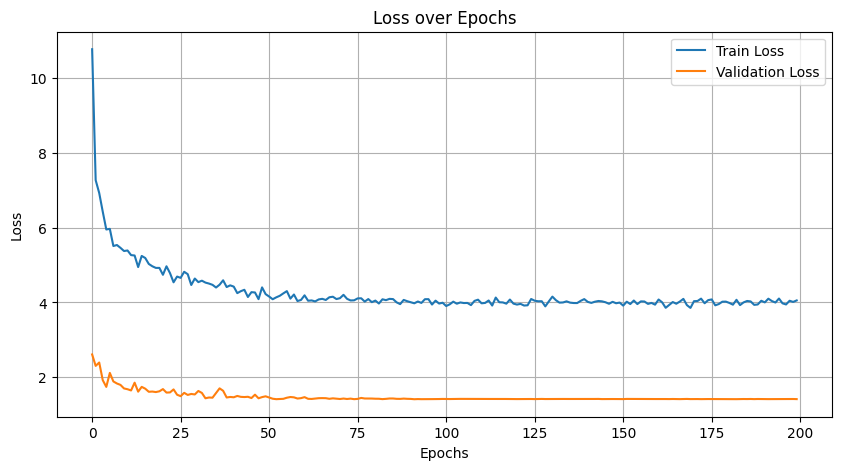

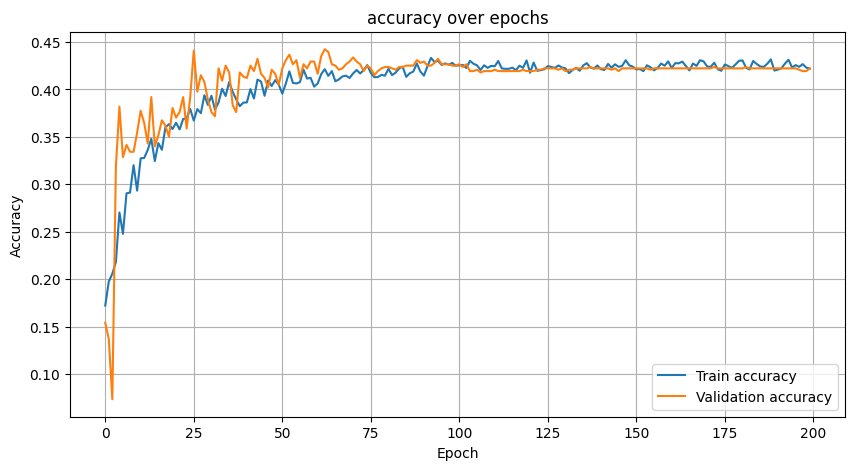

174/174 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.62074581 0.19008264 0.15071126 0.30738523 0.25157233]
Precision (per class): [0.75604919 0.64143426 0.08266554 0.28413284 0.14925373]
Recall (per class): [0.52651934 0.11157311 0.85217391 0.33478261 0.8       ]
Accuracy: 0.4254
AUC (One-vs-Rest): 0.7938

Classification Report:
              precision    recall  f1-score   support

           E       0.76      0.53      0.62      3620
           D       0.64      0.11      0.19      1443
           C       0.08      0.85      0.15       230
           B       0.28      0.33      0.31       230
           A       0.15      0.80      0.25        25

    accuracy                           0.43      5548
   macro avg       0.38      0.53      0.30      5548
weighted avg       0.68      0.43      0.47      5548



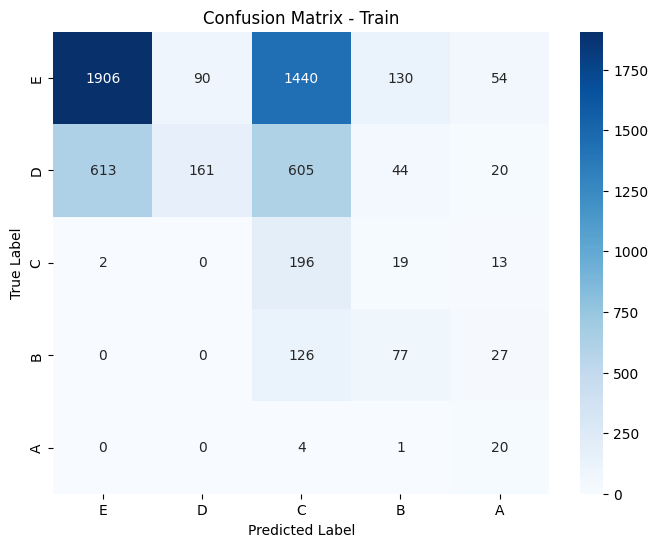

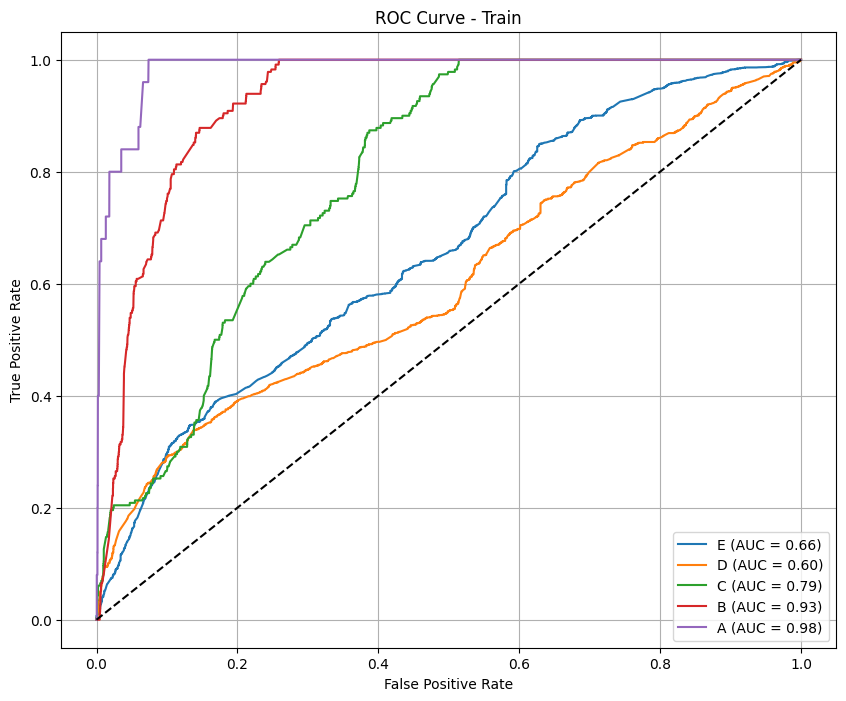

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.57655755 0.02061856 0.04627249 0.05128205 0.        ]
Precision (per class): [0.80769231 0.2        0.02439024 0.04166667 0.        ]
Recall (per class): [0.44827586 0.01086957 0.45       0.06666667 0.        ]
Accuracy: 0.3807
AUC (One-vs-Rest): 0.5859

Classification Report:
              precision    recall  f1-score   support

           E       0.81      0.45      0.58       609
           D       0.20      0.01      0.02        92
           C       0.02      0.45      0.05        20
           B       0.04      0.07      0.05        15
           A       0.00      0.00      0.00        10

    accuracy                           0.38       746
   macro avg       0.21      0.20      0.14       746
weighted avg       0.69      0.38      0.48       746



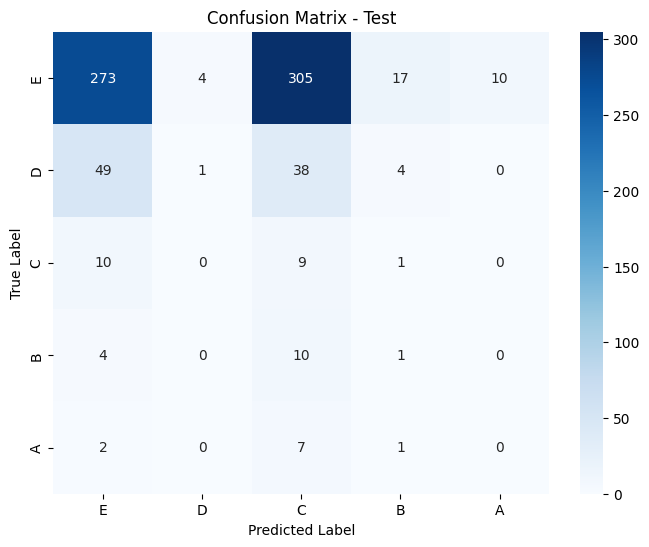

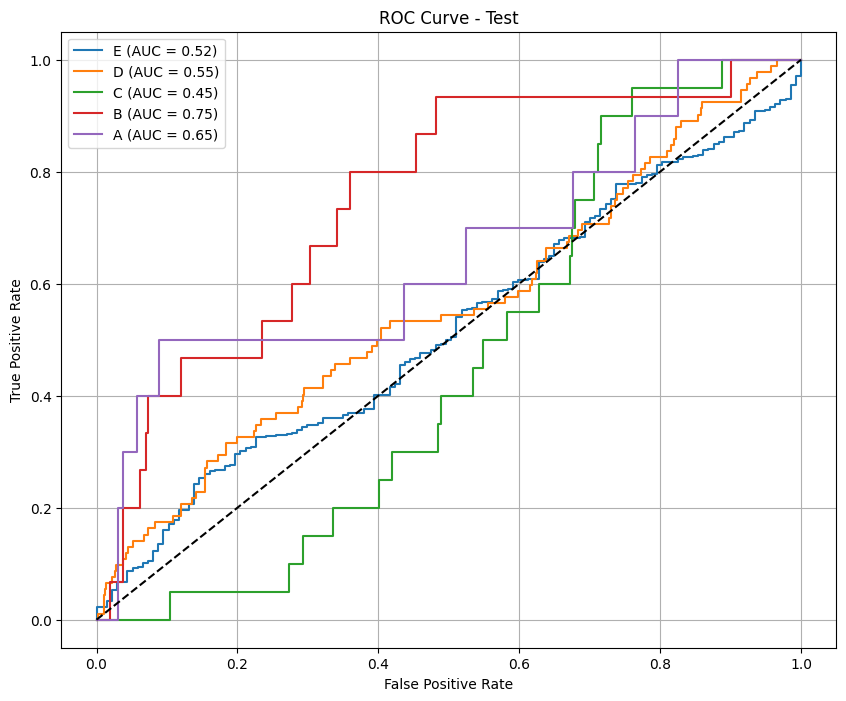

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_robust.csv
174/174 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
[[0.54719406]
 [0.452806  ]
 [0.47500736]
 [0.52499264]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.556252  ]
 [0.44374806]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.5443116 ]
 [0.45568836]
 [0.54719406]
 [0.452806  ]
 [0.5814273 ]
 [0.41857272]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.46605465]
 [0.5339453 ]
 [0.4087465 ]
 [0.5912535 ]
 [0.54719406]
 [0.452806  ]
 [0.59723973]
 [0.40276027]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.50686324]
 [0.49313673]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.56173193]
 [0.438268  ]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.58895564]
 [0.41104442]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.54719406]
 [0.452806  ]
 [0.4837088 ]
 [0.5162912 ]
 [0.40

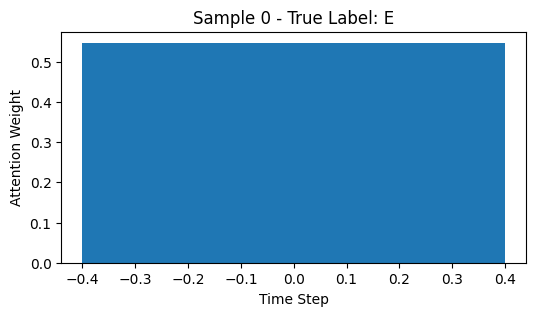

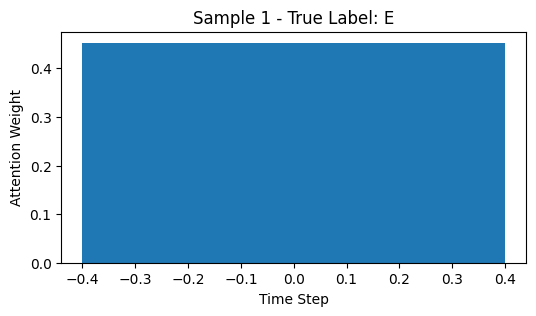

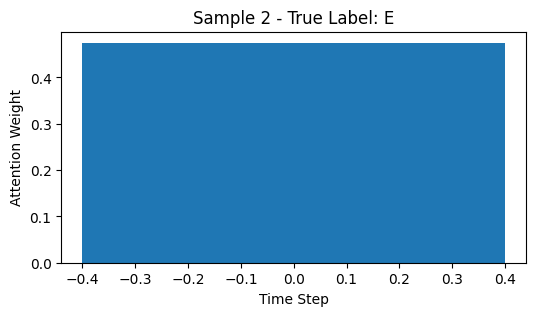

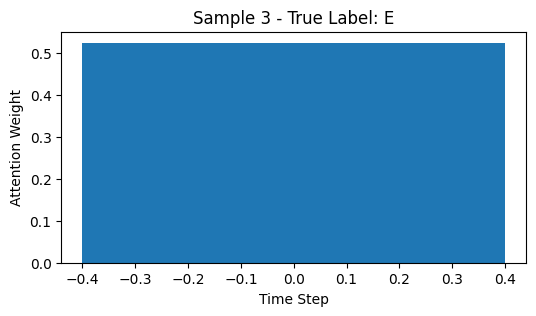

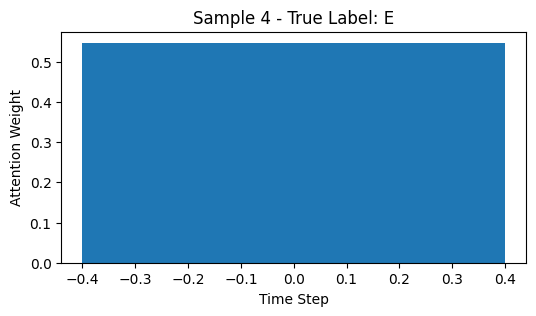

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_36"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_36          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_72 (Dropout)      │ (None, 3, 128)         │              0 │ bidirectional_36[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_37          │ (None, 3, 64)          │         41,216 │ dropout_72[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_37[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_37[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_109 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_36    │ (None, 64)             │            256 │ dense_109[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_108 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_74 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_73 (Dropout)      │ (None, 64)             │              0 │ dense_108[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_110 (Dense)         │ (None, 32)             │          2,080 │ dropout_74[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_18            │ (None, 96)             │              0 │ dropout_73[0][0],      │
│ (Concatenate)             │                        │                │ dense_110[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 68ms/step

Epoch 1: val_f1_macro = 0.1566
66/66 ━━━━━━━━━━━━━━━━━━━━ 21s 73ms/step - accuracy: 0.1337 - loss: 10.4076 - val_accuracy: 0.3993 - val_loss: 1.4867 - val_f1_macro: 0.1566 - learning_rate: 0.0010
Epoch 2/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1049
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.1225 - loss: 8.1037 - val_accuracy: 0.1747 - val_loss: 1.8012 - val_f1_macro: 0.1049 - learning_rate: 0.0010
Epoch 3/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.0974
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.1733 - loss: 6.4447 - val_accuracy: 0.1381 - val_loss: 1.8169 - val_f1_macro: 0.0974 - learning_rate: 0.0010
Epoch 4/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.1441
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.1437 - loss: 6.8956 - val_accuracy: 0.2479 - val_loss: 1.7908 - val_f1_macro: 0.1441 - learning_rate: 0.0010
Epoch 5/200
1

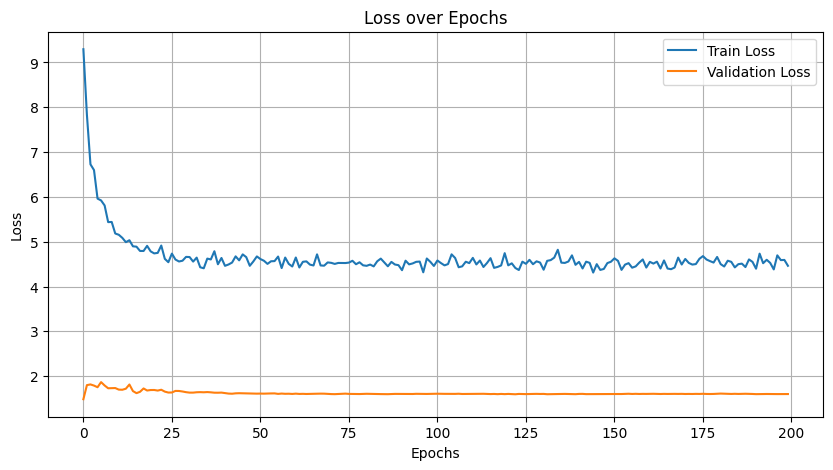

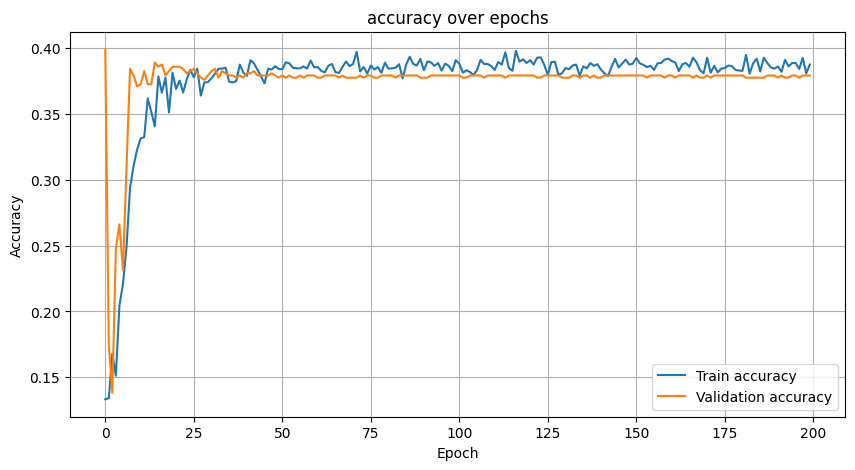

151/151 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.59208524 0.         0.14545455 0.19978746 0.21052632]
Precision (per class): [0.72983114 0.         0.08034745 0.1280654  0.12631579]
Recall (per class): [0.49807939 0.         0.76683938 0.45410628 0.63157895]
Accuracy: 0.3768
AUC (One-vs-Rest): 0.7704

Classification Report:
              precision    recall  f1-score   support

           E       0.73      0.50      0.59      3124
           D       0.00      0.00      0.00      1260
           C       0.08      0.77      0.15       193
           B       0.13      0.45      0.20       207
           A       0.13      0.63      0.21        19

    accuracy                           0.38      4803
   macro avg       0.21      0.47      0.23      4803
weighted avg       0.48      0.38      0.40      4803



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


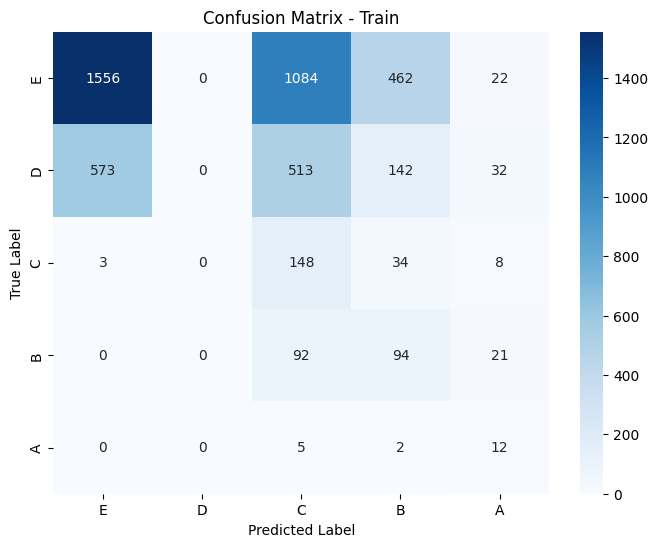

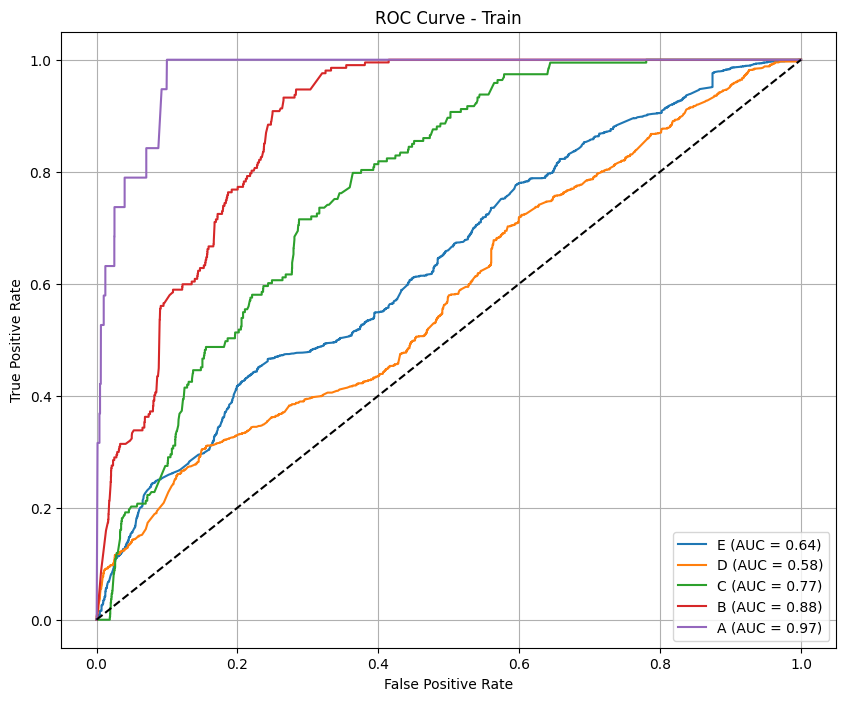

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.34920635 0.08917197 0.03108808 0.06060606 0.09090909]
Precision (per class): [0.78571429 0.1        0.01639344 0.03614458 0.05882353]
Recall (per class): [0.2244898  0.08045977 0.3        0.1875     0.2       ]
Accuracy: 0.2080
AUC (One-vs-Rest): 0.5429

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.22      0.35       588
           D       0.10      0.08      0.09        87
           C       0.02      0.30      0.03        20
           B       0.04      0.19      0.06        16
           A       0.06      0.20      0.09        10

    accuracy                           0.21       721
   macro avg       0.20      0.20      0.12       721
weighted avg       0.65      0.21      0.30       721



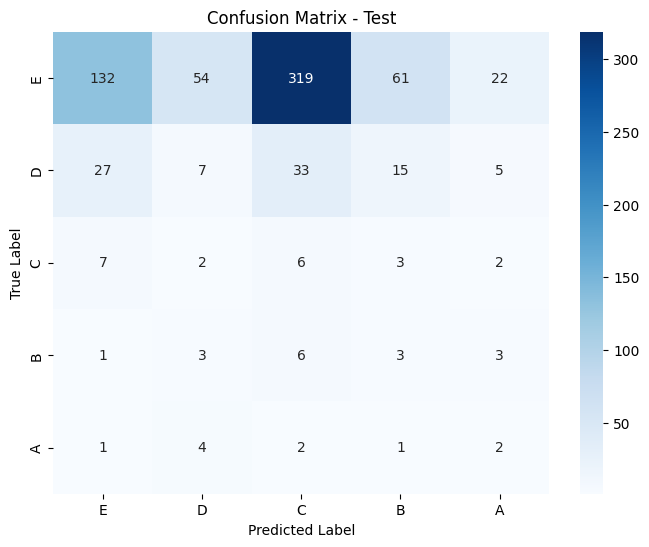

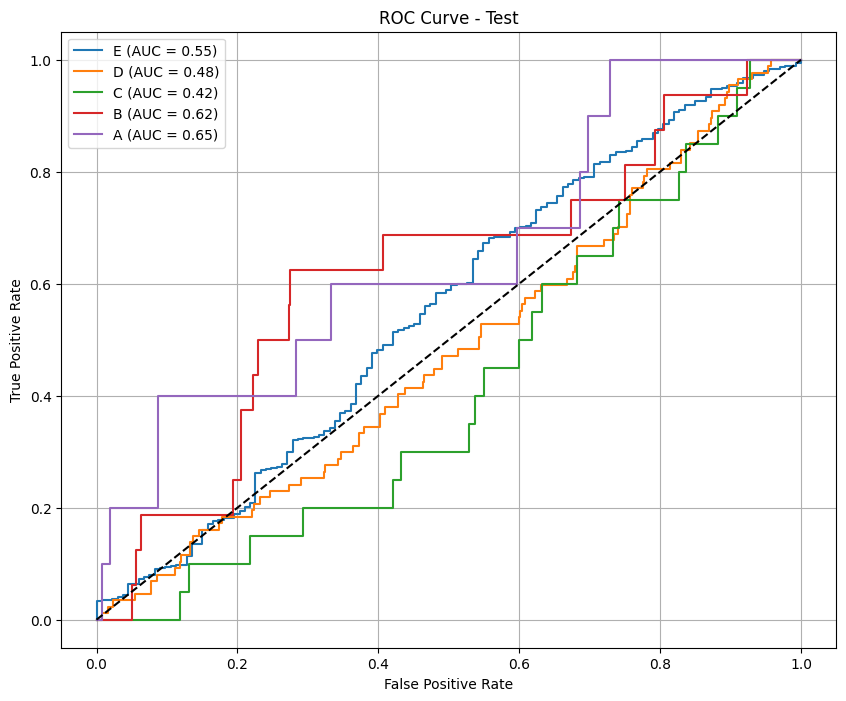

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_robust.csv
151/151 ━━━━━━━━━━━━━━━━━━━━ 3s 13ms/step
[[0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.35193798]
 [0.28874895]
 [0.359313  ]
 [0.349275  ]
 [0.2877852 ]
 [0.36293983]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.3465911 ]
 [0.35038173]
 [0.3030272 ]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.28531873]
 [0.3208686 ]
 [0.39381263]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.307355  ]
 [0.31789953]
 [0.37474555]
 [0.35191387]
 [0.29235387]
 [0.35573232]
 [0.33539173]
 [0.34529638]
 [0.3

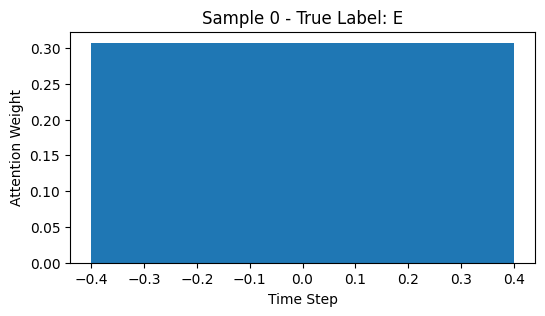

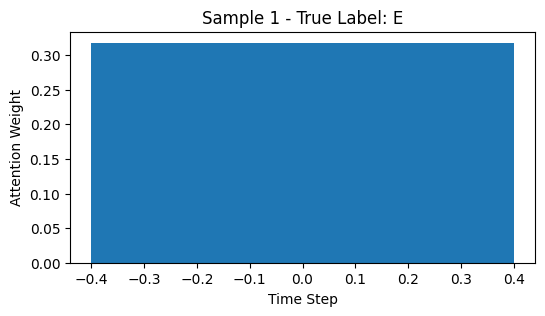

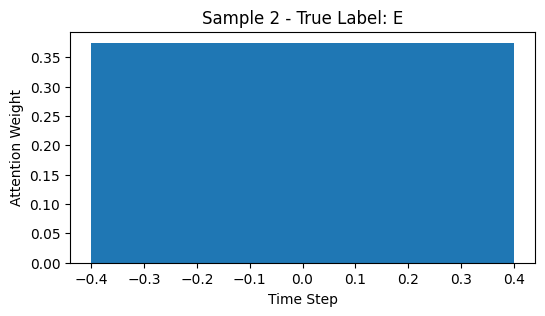

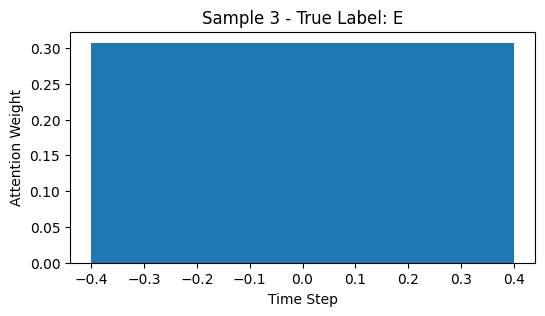

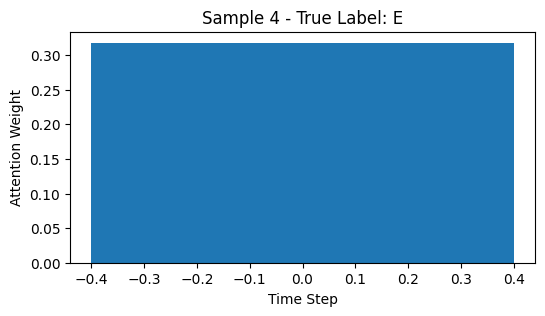

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_38"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_38          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_76 (Dropout)      │ (None, 4, 128)         │              0 │ bidirectional_38[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_39          │ (None, 4, 64)          │         41,216 │ dropout_76[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_39[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_39[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_115 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_38    │ (None, 64)             │            256 │ dense_115[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_114 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_78 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_3… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_77 (Dropout)      │ (None, 64)             │              0 │ dense_114[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_116 (Dense)         │ (None, 32)             │          2,080 │ dropout_78[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_19            │ (None, 96)             │              0 │ dropout_77[0][0],      │
│ (Concatenate)             │                        │                │ dense_116[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 2s 127ms/step

Epoch 1: val_f1_macro = 0.0158
33/33 ━━━━━━━━━━━━━━━━━━━━ 20s 211ms/step - accuracy: 0.1003 - loss: 12.9423 - val_accuracy: 0.0405 - val_loss: 2.4406 - val_f1_macro: 0.0158 - learning_rate: 0.0010
Epoch 2/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 2: val_f1_macro = 0.0764
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.1567 - loss: 9.2344 - val_accuracy: 0.0709 - val_loss: 2.3816 - val_f1_macro: 0.0764 - learning_rate: 0.0010
Epoch 3/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 3: val_f1_macro = 0.1730
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.1763 - loss: 9.6019 - val_accuracy: 0.3007 - val_loss: 1.9622 - val_f1_macro: 0.1730 - learning_rate: 0.0010
Epoch 4/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 4: val_f1_macro = 0.1629
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 17ms/step - accuracy: 0.1716 - loss: 8.7472 - val_accuracy: 0.3209 - val_loss: 1.8222 - val_f1_macro: 0.1629 - learning_rate: 0.0010
Epoch 5/

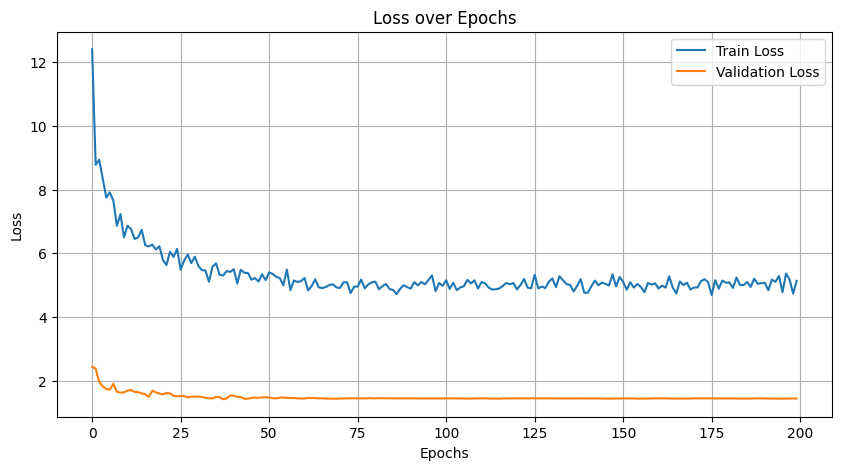

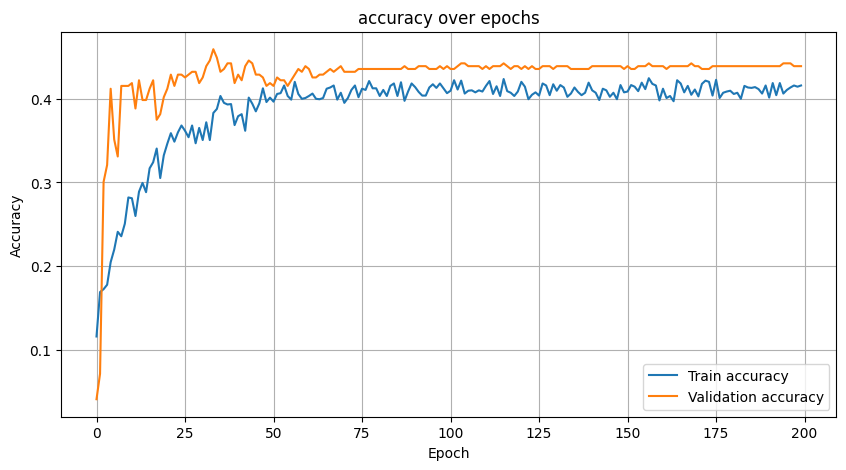

74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.60501567 0.17960426 0.13596491 0.43715847 0.28571429]
Precision (per class): [0.73875598 0.78666667 0.07644883 0.30769231 0.19047619]
Recall (per class): [0.51227605 0.10137457 0.61386139 0.75471698 0.57142857]
Accuracy: 0.4321
AUC (One-vs-Rest): 0.7955

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.51      0.61      1507
           D       0.79      0.10      0.18       582
           C       0.08      0.61      0.14       101
           B       0.31      0.75      0.44       159
           A       0.19      0.57      0.29        14

    accuracy                           0.43      2363
   macro avg       0.42      0.51      0.33      2363
weighted avg       0.69      0.43      0.47      2363



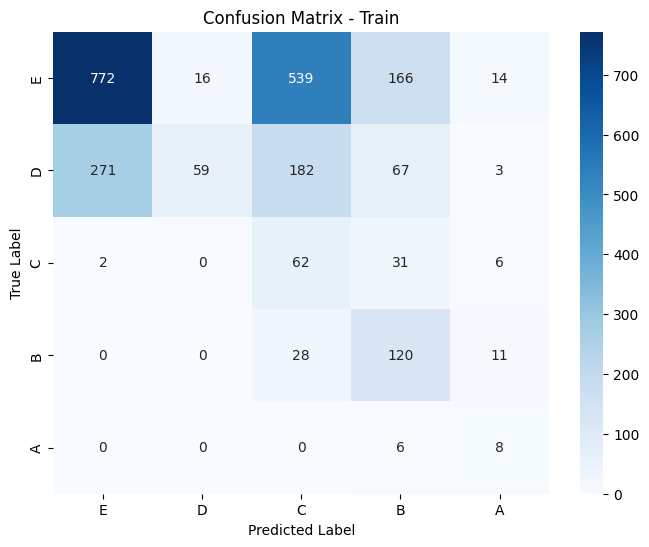

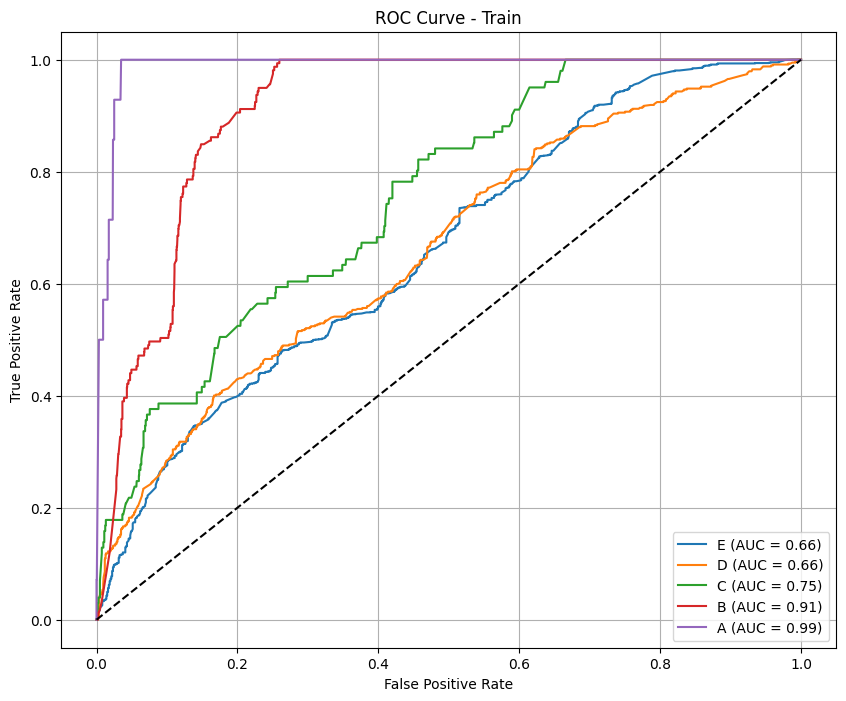

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.38821954 0.         0.03406326 0.0952381  0.        ]
Precision (per class): [0.75520833 0.         0.0178117  0.05747126 0.        ]
Recall (per class): [0.26126126 0.         0.38888889 0.27777778 0.        ]
Accuracy: 0.2285
AUC (One-vs-Rest): 0.5127

Classification Report:
              precision    recall  f1-score   support

           E       0.76      0.26      0.39       555
           D       0.00      0.00      0.00        85
           C       0.02      0.39      0.03        18
           B       0.06      0.28      0.10        18
           A       0.00      0.00      0.00        11

    accuracy                           0.23       687
   macro avg       0.17      0.19      0.10       687
weighted avg       0.61      0.23      0.32       687



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


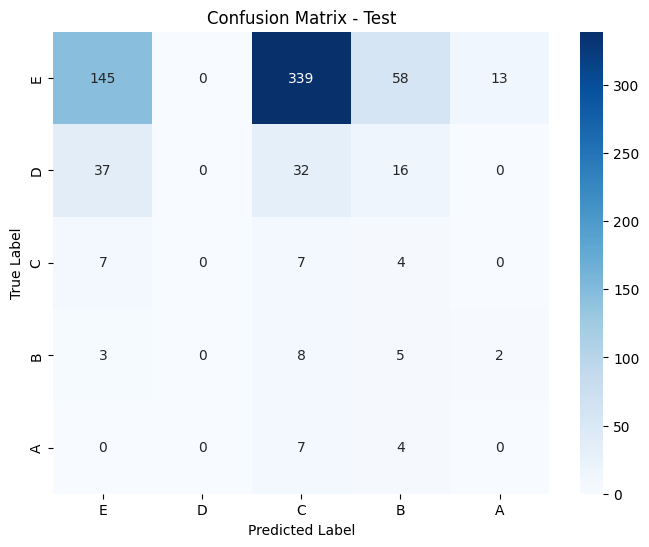

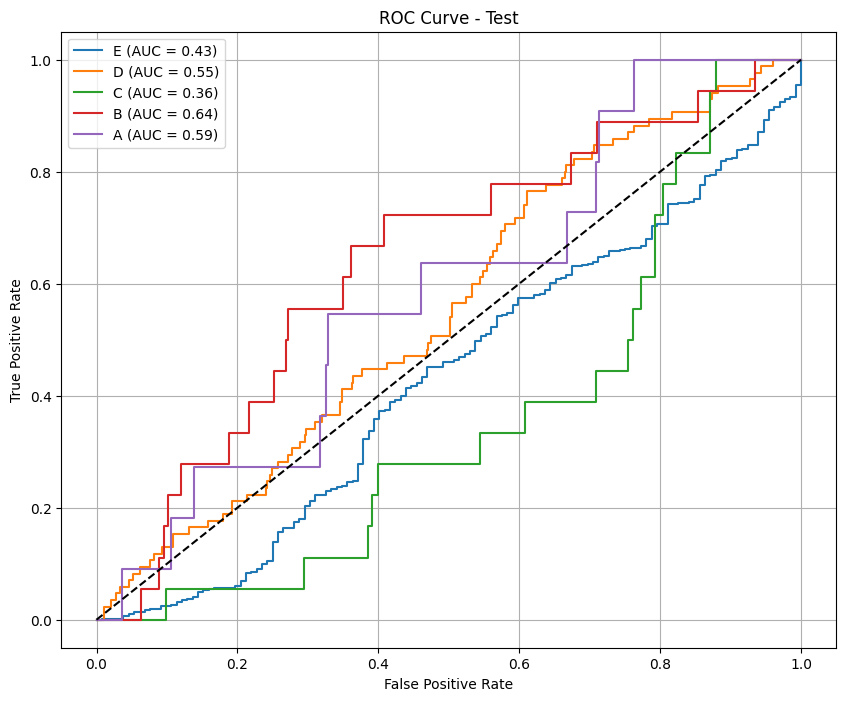

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_robust.csv
74/74 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step
[[0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.1817615 ]
 [0.17725872]
 [0.25959525]
 [0.3813844 ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.20708796]
 [0.20222722]
 [0.24384288]
 [0.346842  ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.17740455]
 [0.18982431]
 [0.24864276]
 [0.3841284 ]
 [0.16177154]
 [0.17144917]
 [0.37017992]
 [0.29659927]
 [0.16585961]
 [0.17043525]
 [0.20475002]
 [0.45895514]
 [0.23257689]
 [0.23813252]
 [0.24044369]
 [0.2888469 ]
 [0.23257689]
 [0.23813252]
 [0.240

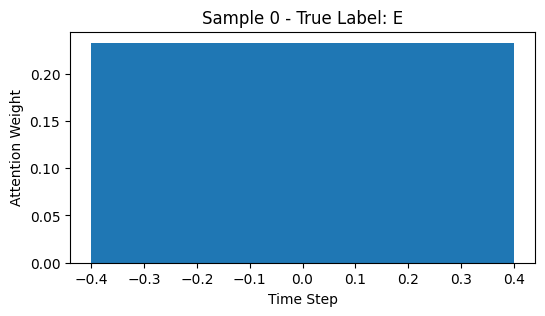

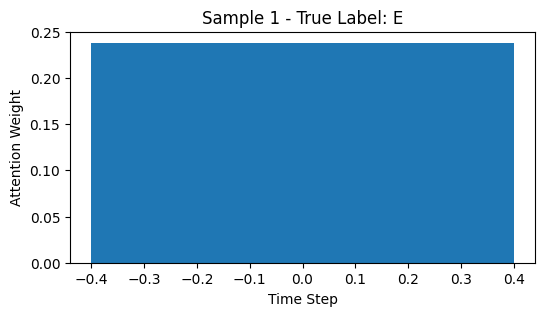

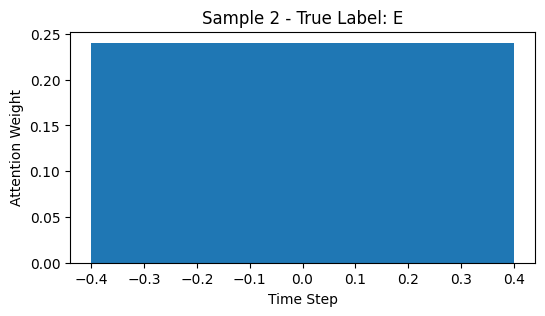

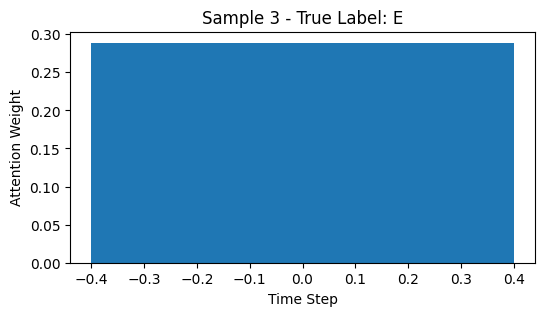

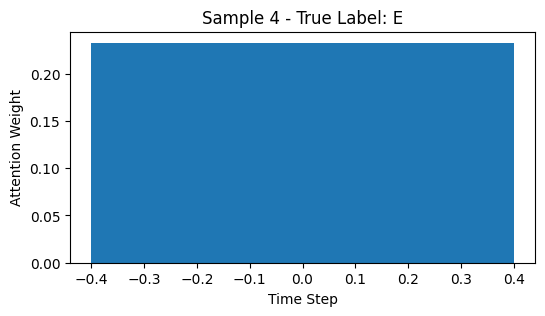

In [34]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, metric='f1_macro', scale='robust') 

### oversample

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_40"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_40          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_80 (Dropout)      │ (None, 1, 128)         │              0 │ bidirectional_40[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_41          │ (None, 1, 64)          │         41,216 │ dropout_80[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_41[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_41[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_121 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_40    │ (None, 64)             │            256 │ dense_121[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_120 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_82 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_81 (Dropout)      │ (None, 64)             │              0 │ dense_120[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_122 (Dense)         │ (None, 32)             │          2,080 │ dropout_82[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_20            │ (None, 96)             │              0 │ dropout_81[0][0],      │
│ (Concatenate)             │                        │                │ dense_122[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


165/169 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2048 - loss: 31.4087

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 29ms/step

Epoch 1: val_f1_macro = 0.1322
169/169 ━━━━━━━━━━━━━━━━━━━━ 19s 31ms/step - accuracy: 0.2038 - loss: 31.0900 - val_accuracy: 0.1890 - val_loss: 2.5327 - val_f1_macro: 0.1322 - learning_rate: 0.0010
Epoch 2/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.2739
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.1669 - loss: 11.5178 - val_accuracy: 0.2312 - val_loss: 2.2802 - val_f1_macro: 0.2739 - learning_rate: 0.0010
Epoch 3/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.2263
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.1982 - loss: 10.4742 - val_accuracy: 0.2416 - val_loss: 2.2893 - val_f1_macro: 0.2263 - learning_rate: 0.0010
Epoch 4/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.2729
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.2061 - loss: 10.1067 - val_accuracy: 0.2922 - val_loss: 2.1316 - val_f1_macro: 0.2729 - learning_rate: 0.0010
Epoch 5/200
49/49

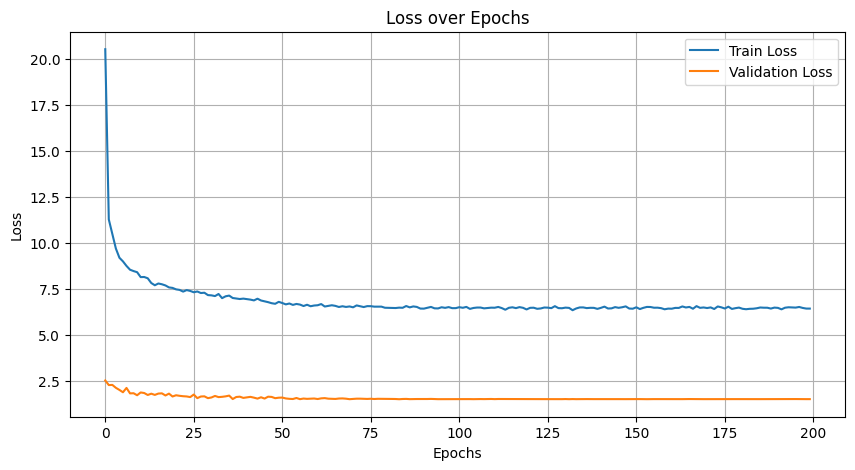

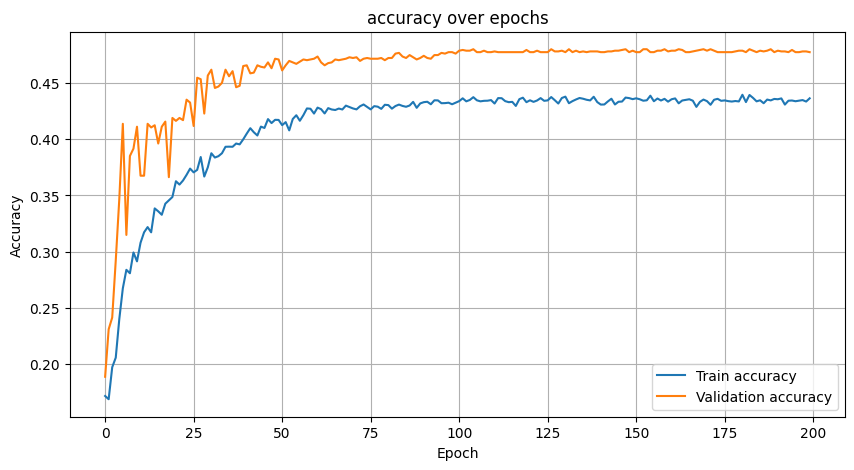

385/385 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.59869581 0.30714286 0.31912538 0.30188679 0.545676  ]
Precision (per class): [0.7745098  0.69918699 0.1935863  0.34904014 0.41176471]
Recall (per class): [0.4879345  0.19679634 0.90787402 0.26595745 0.80866426]
Accuracy: 0.4526
AUC (One-vs-Rest): 0.8189

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.49      0.60      6962
           D       0.70      0.20      0.31      3059
           C       0.19      0.91      0.32      1270
           B       0.35      0.27      0.30       752
           A       0.41      0.81      0.55       277

    accuracy                           0.45     12320
   macro avg       0.49      0.53      0.41     12320
weighted avg       0.66      0.45      0.48     12320



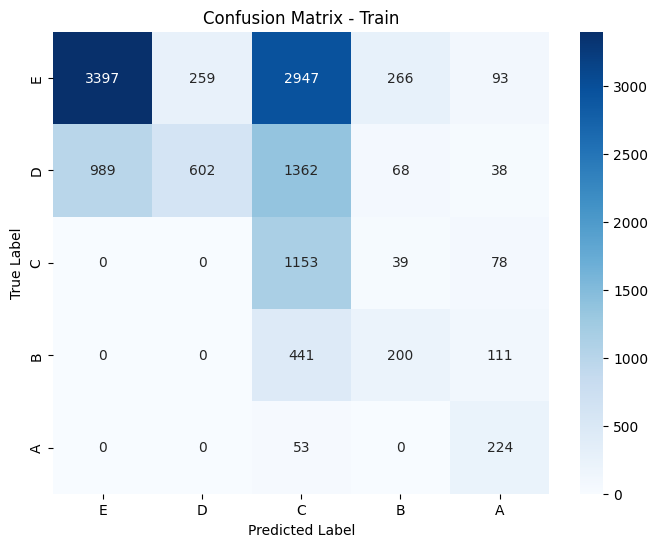

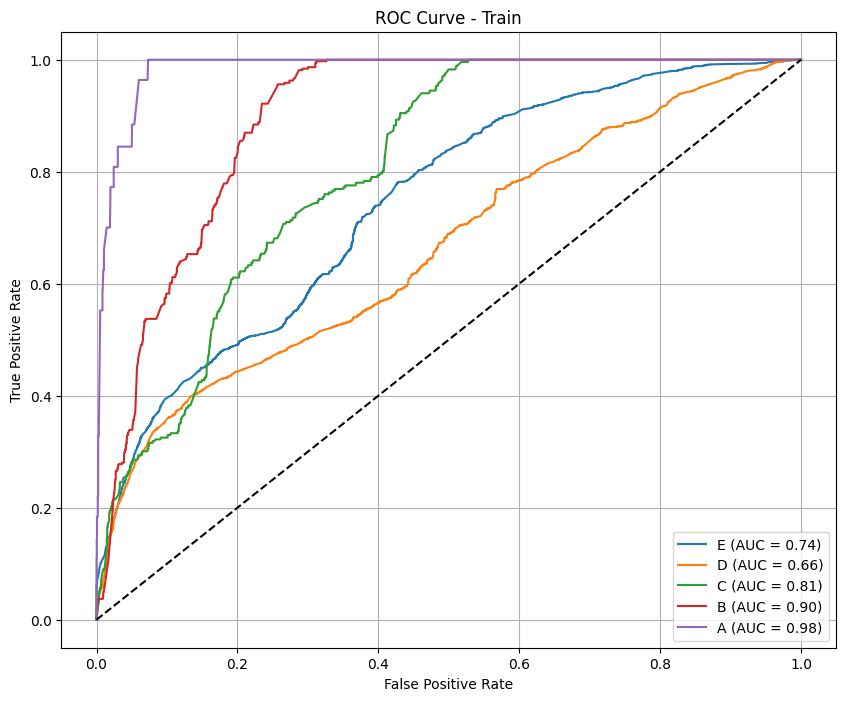

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.75804968 0.21666667 0.04854369 0.         0.        ]
Precision (per class): [0.87473461 0.5        0.02688172 0.         0.        ]
Recall (per class): [0.66883117 0.13829787 0.25       0.         0.        ]
Accuracy: 0.5688
AUC (One-vs-Rest): 0.6565

Classification Report:
              precision    recall  f1-score   support

           E       0.87      0.67      0.76       616
           D       0.50      0.14      0.22        94
           C       0.03      0.25      0.05        20
           B       0.00      0.00      0.00        16
           A       0.00      0.00      0.00        10

    accuracy                           0.57       756
   macro avg       0.28      0.21      0.20       756
weighted avg       0.78      0.57      0.65       756



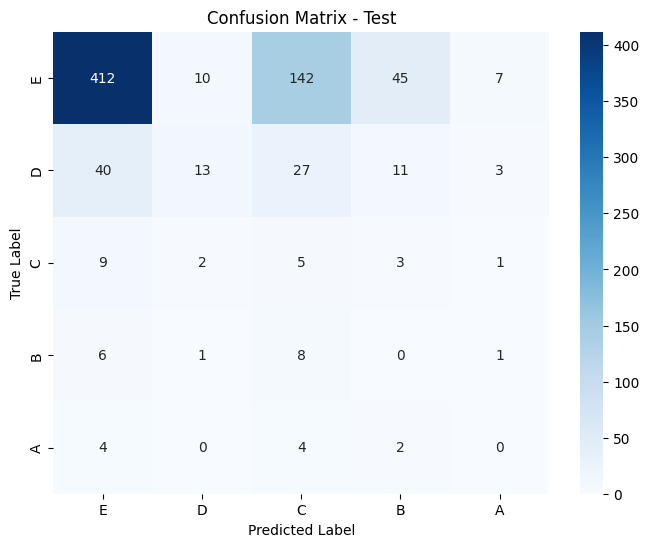

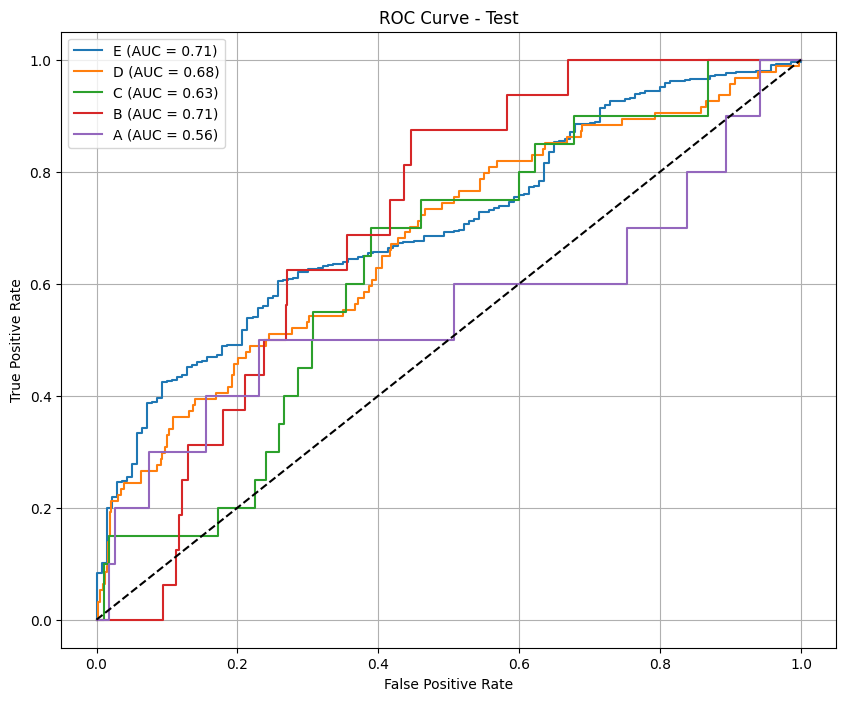

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase1_robust.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


385/385 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

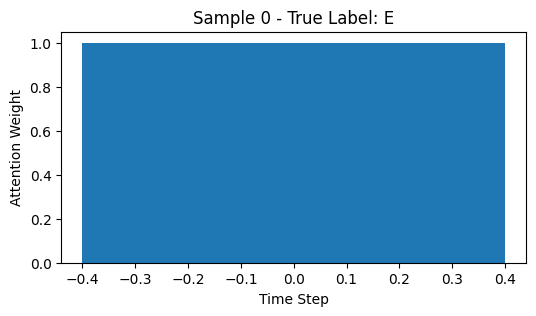

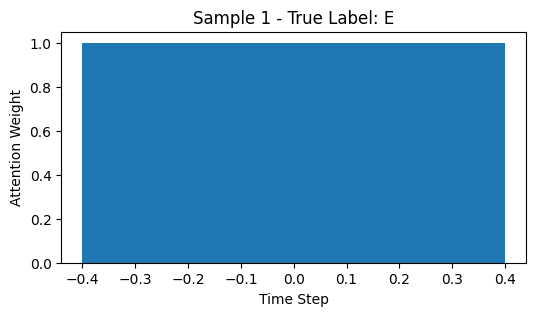

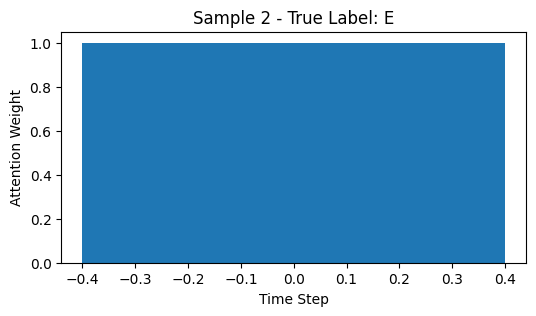

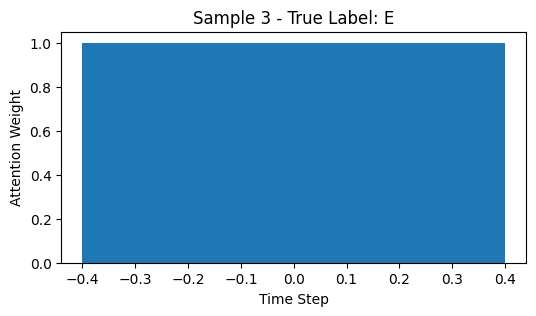

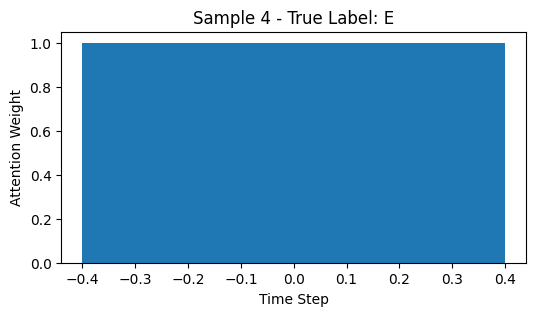

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_42"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_42          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_84 (Dropout)      │ (None, 2, 128)         │              0 │ bidirectional_42[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_43          │ (None, 2, 64)          │         41,216 │ dropout_84[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_43[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_43[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_127 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_42    │ (None, 64)             │            256 │ dense_127[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_126 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_86 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_85 (Dropout)      │ (None, 64)             │              0 │ dense_126[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_128 (Dense)         │ (None, 32)             │          2,080 │ dropout_86[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_21            │ (None, 96)             │              0 │ dropout_85[0][0],      │
│ (Concatenate)             │                        │                │ dense_128[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 33ms/step

Epoch 1: val_f1_macro = 0.2795
141/141 ━━━━━━━━━━━━━━━━━━━━ 22s 38ms/step - accuracy: 0.1666 - loss: 23.2347 - val_accuracy: 0.2849 - val_loss: 2.2022 - val_f1_macro: 0.2795 - learning_rate: 0.0010
Epoch 2/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.2005
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.1549 - loss: 13.2854 - val_accuracy: 0.1840 - val_loss: 2.7206 - val_f1_macro: 0.2005 - learning_rate: 0.0010
Epoch 3/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.2697
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.2162 - loss: 11.1647 - val_accuracy: 0.3129 - val_loss: 2.3456 - val_f1_macro: 0.2697 - learning_rate: 0.0010
Epoch 4/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.2787
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.2337 - loss: 10.2078 - val_accuracy: 0.3276 - val_loss: 2.2959 - val_f1_macro: 0.2787 - learning_rate: 0.0010
Ep

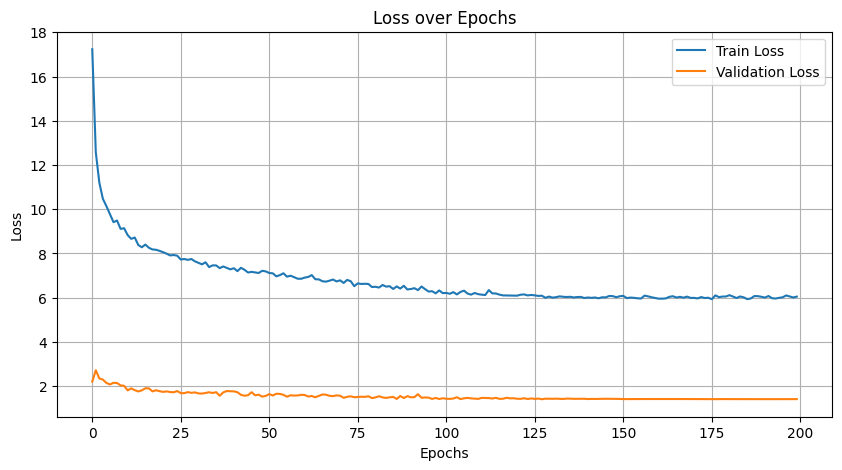

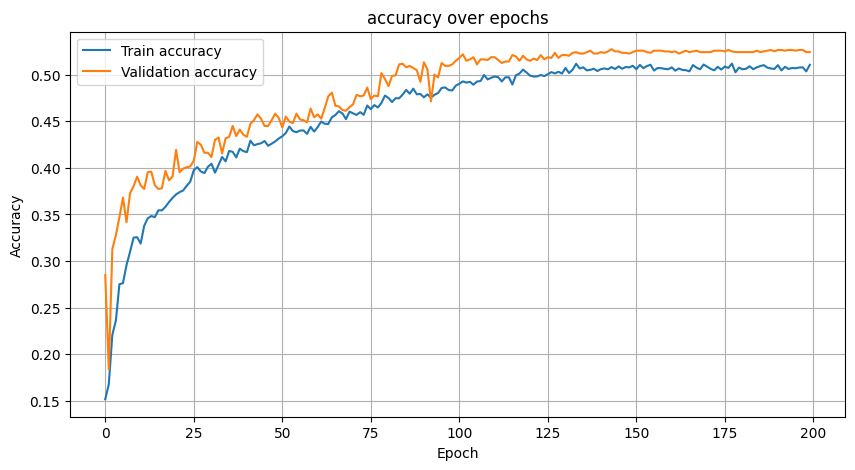

322/322 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.68763515 0.22589532 0.41967213 0.41288433 0.66465257]
Precision (per class): [0.76811594 0.71149675 0.27042254 0.44339623 0.56847545]
Recall (per class): [0.62241993 0.13426115 0.93658537 0.38630137 0.8       ]
Accuracy: 0.5321
AUC (One-vs-Rest): 0.8424

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.62      0.69      5620
           D       0.71      0.13      0.23      2443
           C       0.27      0.94      0.42      1230
           B       0.44      0.39      0.41       730
           A       0.57      0.80      0.66       275

    accuracy                           0.53     10298
   macro avg       0.55      0.58      0.48     10298
weighted avg       0.67      0.53      0.53     10298



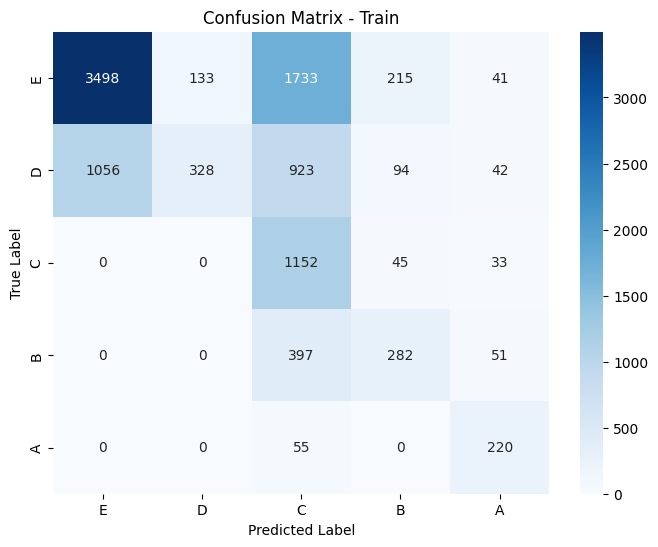

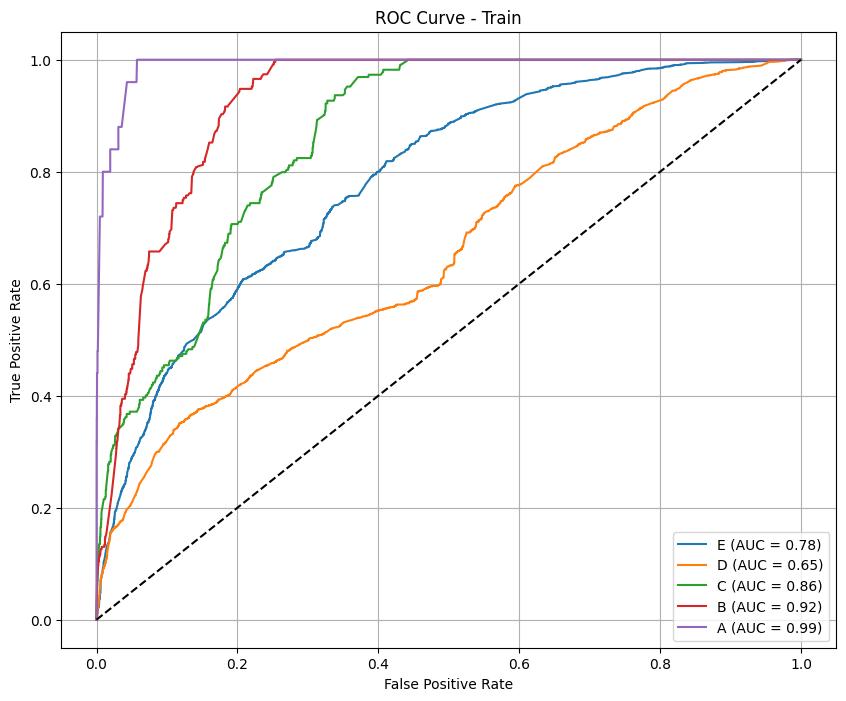

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.83184403 0.01869159 0.07407407 0.07407407 0.10526316]
Precision (per class): [0.82315113 0.06666667 0.04545455 0.08333333 0.11111111]
Recall (per class): [0.8407225  0.01086957 0.2        0.06666667 0.1       ]
Accuracy: 0.6957
AUC (One-vs-Rest): 0.6510

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.84      0.83       609
           D       0.07      0.01      0.02        92
           C       0.05      0.20      0.07        20
           B       0.08      0.07      0.07        15
           A       0.11      0.10      0.11        10

    accuracy                           0.70       746
   macro avg       0.23      0.24      0.22       746
weighted avg       0.68      0.70      0.69       746



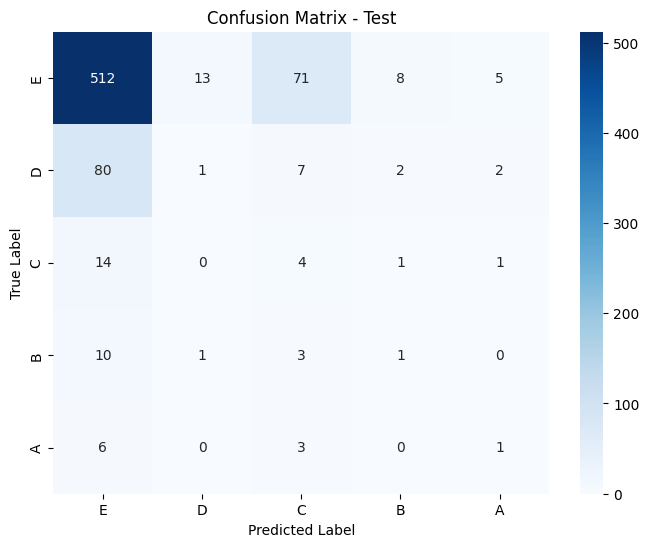

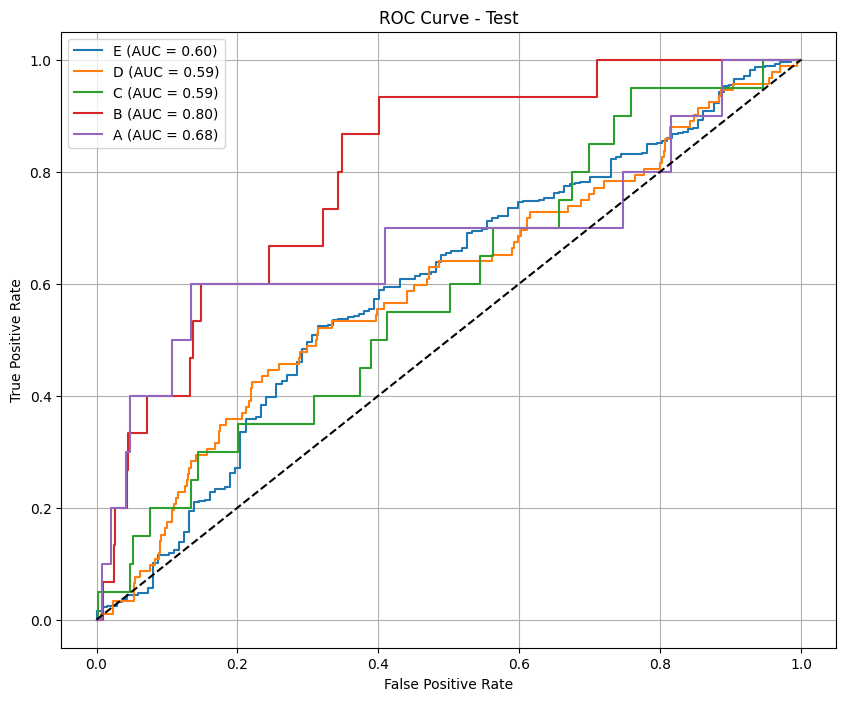

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_robust.csv
322/322 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
[[0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.4998214 ]
 [0.5001785 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.49937484]
 [0.5006251 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.49765784]
 [0.5023421 ]
 [0.48642576]
 [0.5135742 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.48642576]
 [0.5135742 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.5412737 ]
 [0.4587263 ]
 [0.54

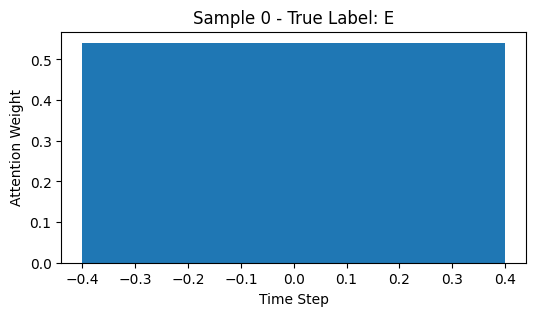

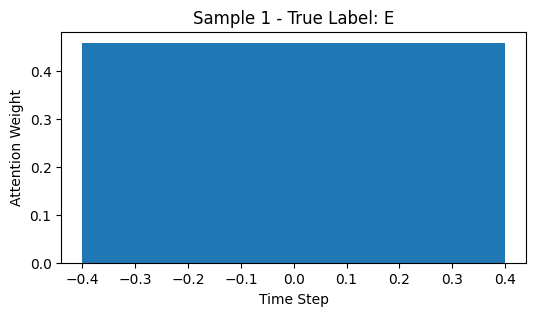

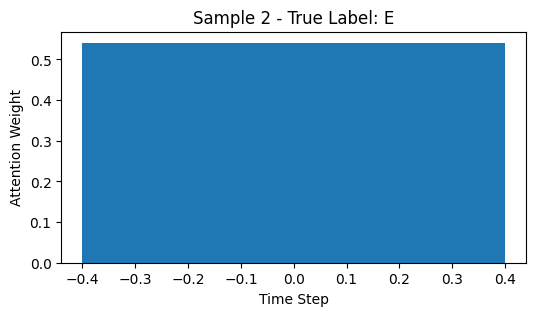

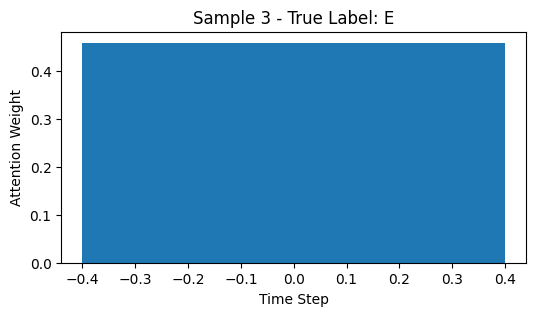

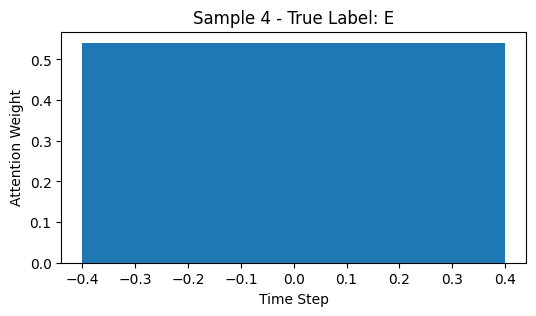

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_44"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_44          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_88 (Dropout)      │ (None, 3, 128)         │              0 │ bidirectional_44[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_45          │ (None, 3, 64)          │         41,216 │ dropout_88[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_45[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_45[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_133 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_44    │ (None, 64)             │            256 │ dense_133[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_132 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_90 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_89 (Dropout)      │ (None, 64)             │              0 │ dense_132[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_134 (Dense)         │ (None, 32)             │          2,080 │ dropout_90[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_22            │ (None, 96)             │              0 │ dropout_89[0][0],      │
│ (Concatenate)             │                        │                │ dense_134[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step

Epoch 1: val_f1_macro = 0.2185
131/131 ━━━━━━━━━━━━━━━━━━━━ 22s 66ms/step - accuracy: 0.1577 - loss: 27.2759 - val_accuracy: 0.1950 - val_loss: 2.8958 - val_f1_macro: 0.2185 - learning_rate: 0.0010
Epoch 2/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2476
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.1546 - loss: 13.7327 - val_accuracy: 0.2795 - val_loss: 2.2473 - val_f1_macro: 0.2476 - learning_rate: 0.0010
Epoch 3/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2999
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.1846 - loss: 12.1889 - val_accuracy: 0.3372 - val_loss: 2.0881 - val_f1_macro: 0.2999 - learning_rate: 0.0010
Epoch 4/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.3078
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.2266 - loss: 11.2739 - val_accuracy: 0.3372 - val_loss: 2.2151 - val_f1_macro: 0.3078 - learning_rate: 0.0010
Ep

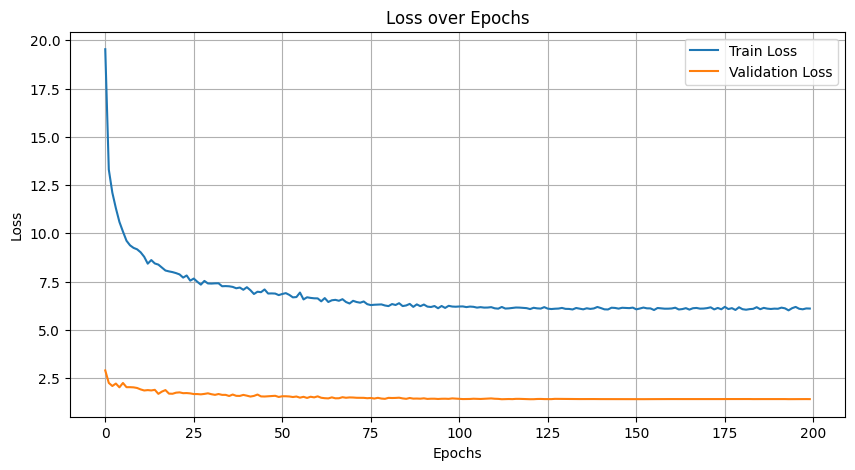

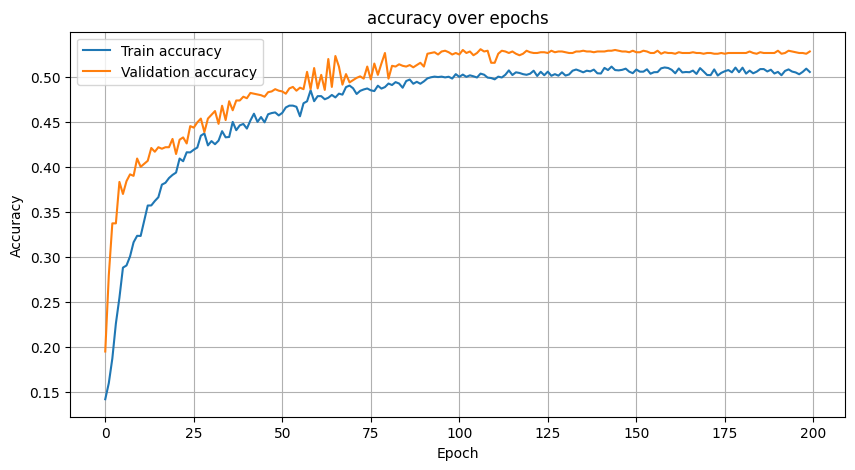

299/299 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.68118897 0.18882466 0.43603029 0.4649185  0.59239843]
Precision (per class): [0.75661502 0.73134328 0.28601307 0.46590909 0.45748988]
Recall (per class): [0.61943794 0.10840708 0.91701593 0.46393211 0.8401487 ]
Accuracy: 0.5304
AUC (One-vs-Rest): 0.8459

Classification Report:
              precision    recall  f1-score   support

           E       0.76      0.62      0.68      5124
           D       0.73      0.11      0.19      2260
           C       0.29      0.92      0.44      1193
           B       0.47      0.46      0.46       707
           A       0.46      0.84      0.59       269

    accuracy                           0.53      9553
   macro avg       0.54      0.59      0.47      9553
weighted avg       0.66      0.53      0.52      9553



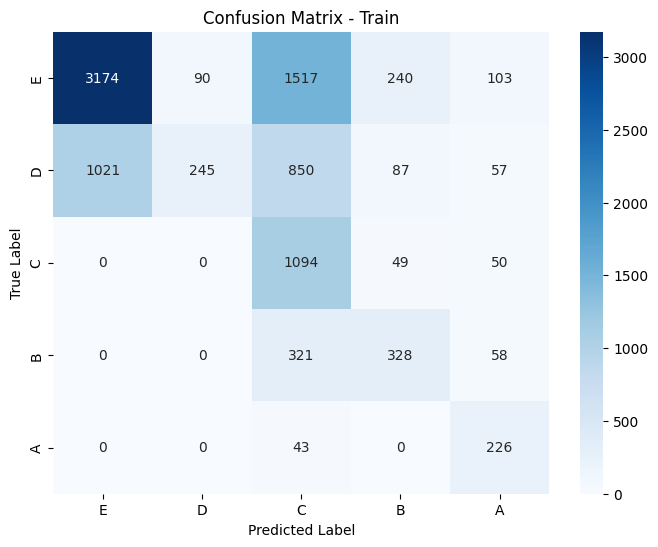

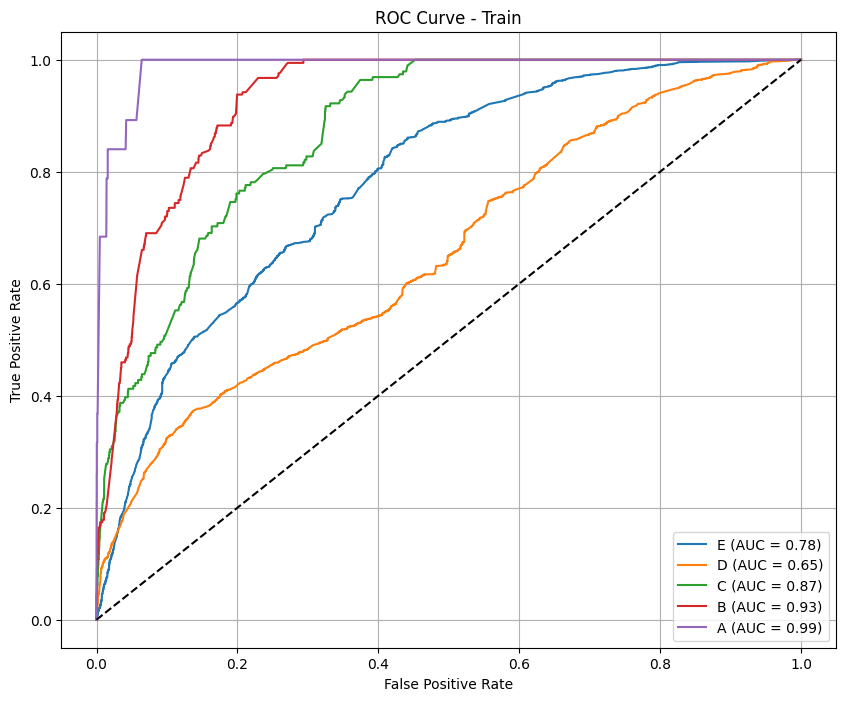

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.6828322  0.05309735 0.02631579 0.15384615 0.        ]
Precision (per class): [0.79458239 0.11538462 0.01442308 0.11111111 0.        ]
Recall (per class): [0.59863946 0.03448276 0.15       0.25       0.        ]
Accuracy: 0.5021
AUC (One-vs-Rest): 0.5462

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.60      0.68       588
           D       0.12      0.03      0.05        87
           C       0.01      0.15      0.03        20
           B       0.11      0.25      0.15        16
           A       0.00      0.00      0.00        10

    accuracy                           0.50       721
   macro avg       0.21      0.21      0.18       721
weighted avg       0.66      0.50      0.57       721



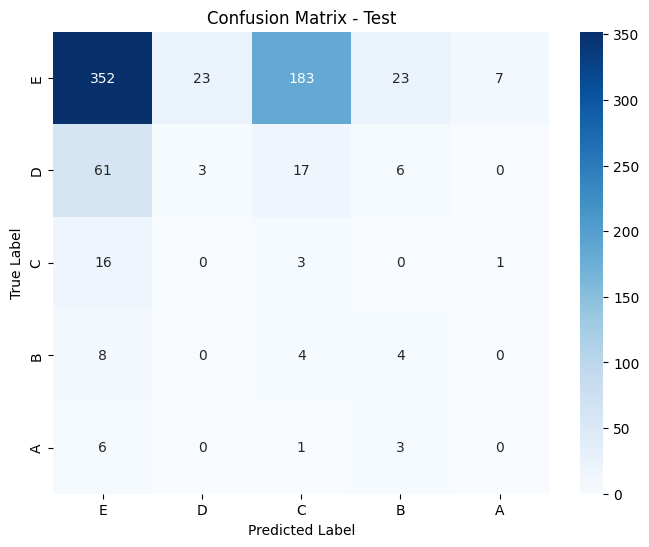

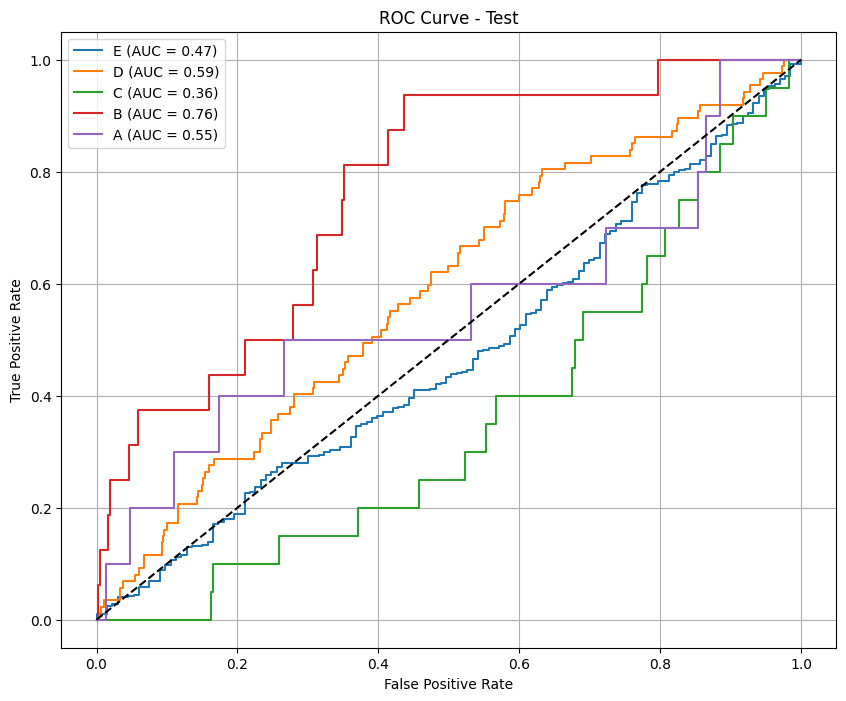

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_robust.csv
299/299 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.33820271]
 [0.3535031 ]
 [0.30829415]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.34585682]
 [0.3783923 ]
 [0.27575096]
 [0.26288006]
 [0.2967391 ]
 [0.44038078]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.48325276]
 [0.32737848]
 [0.18936867]
 [0.25352907]
 [0.3052956 ]
 [0.44117522]
 [0.25352907]
 [0.3052956 ]
 [0.44

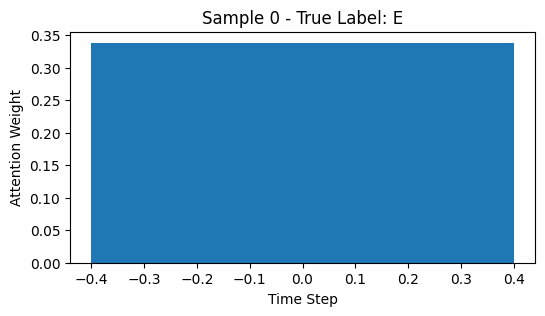

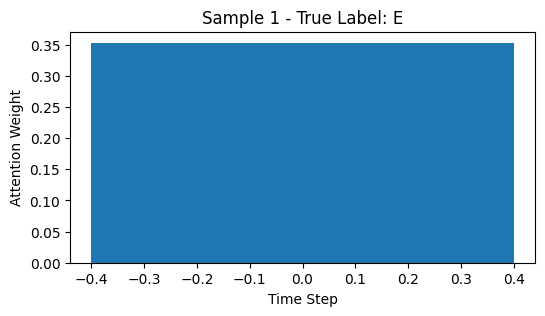

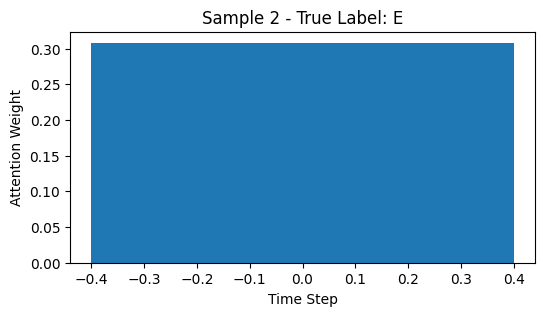

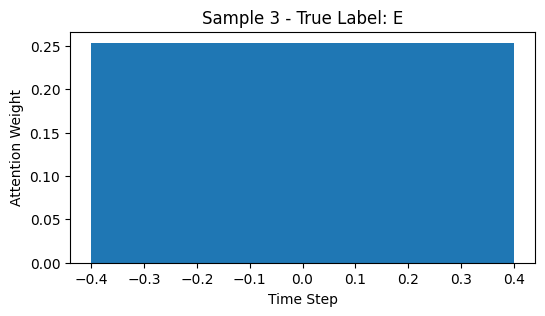

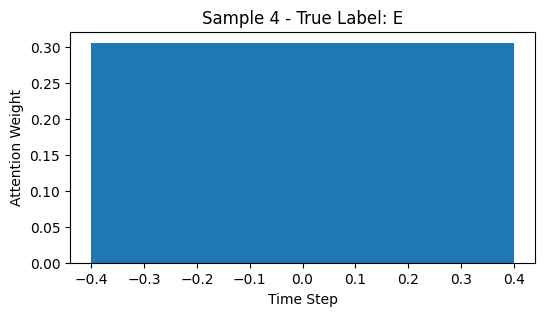

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_46"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_46          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_92 (Dropout)      │ (None, 4, 128)         │              0 │ bidirectional_46[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_47          │ (None, 4, 64)          │         41,216 │ dropout_92[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_47[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_47[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_139 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_46    │ (None, 64)             │            256 │ dense_139[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_138 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_94 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_93 (Dropout)      │ (None, 64)             │              0 │ dense_138[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_140 (Dense)         │ (None, 32)             │          2,080 │ dropout_94[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_23            │ (None, 96)             │              0 │ dropout_93[0][0],      │
│ (Concatenate)             │                        │                │ dense_140[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 44ms/step

Epoch 1: val_f1_macro = 0.2088
98/98 ━━━━━━━━━━━━━━━━━━━━ 18s 50ms/step - accuracy: 0.1384 - loss: 28.5200 - val_accuracy: 0.2337 - val_loss: 1.8302 - val_f1_macro: 0.2088 - learning_rate: 0.0010
Epoch 2/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2074
98/98 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.1744 - loss: 15.5493 - val_accuracy: 0.1910 - val_loss: 2.0781 - val_f1_macro: 0.2074 - learning_rate: 0.0010
Epoch 3/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2527
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.1910 - loss: 14.7185 - val_accuracy: 0.2101 - val_loss: 2.2621 - val_f1_macro: 0.2527 - learning_rate: 0.0010
Epoch 4/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2628
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2139 - loss: 13.5142 - val_accuracy: 0.2798 - val_loss: 1.9864 - val_f1_macro: 0.2628 - learning_rate: 0.0010
Epoch 5/20

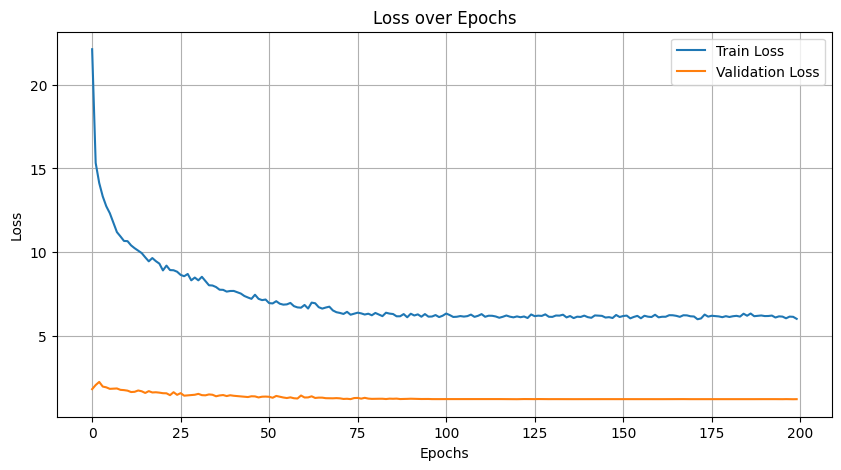

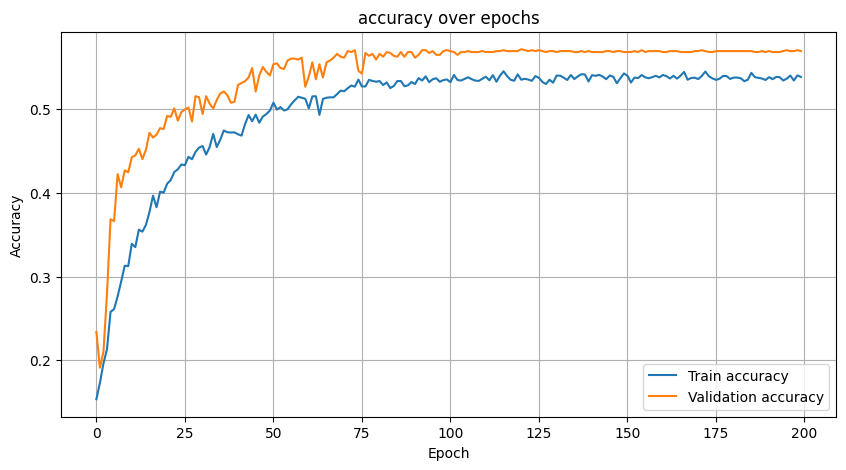

223/223 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.65569188 0.25819885 0.52258784 0.55760662 0.74471086]
Precision (per class): [0.71998636 0.73156342 0.37706237 0.48026316 0.59325843]
Recall (per class): [0.60193898 0.15676359 0.8510445  0.6646434  1.        ]
Accuracy: 0.5621
AUC (One-vs-Rest): 0.8747

Classification Report:
              precision    recall  f1-score   support

           E       0.72      0.60      0.66      3507
           D       0.73      0.16      0.26      1582
           C       0.38      0.85      0.52      1101
           B       0.48      0.66      0.56       659
           A       0.59      1.00      0.74       264

    accuracy                           0.56      7113
   macro avg       0.58      0.65      0.55      7113
weighted avg       0.64      0.56      0.54      7113



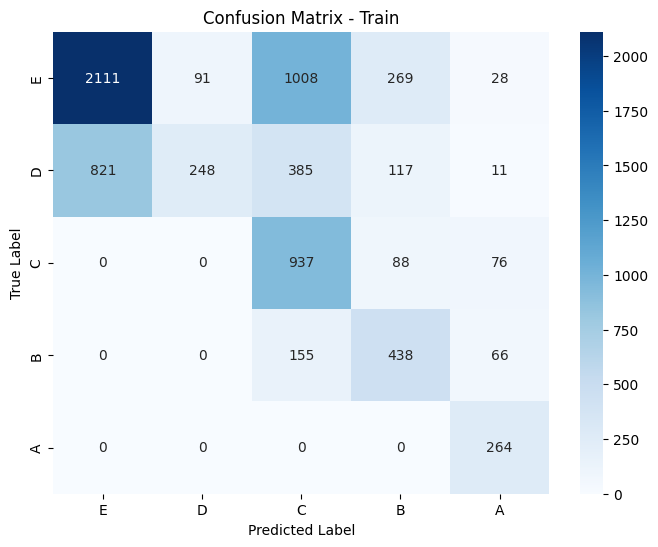

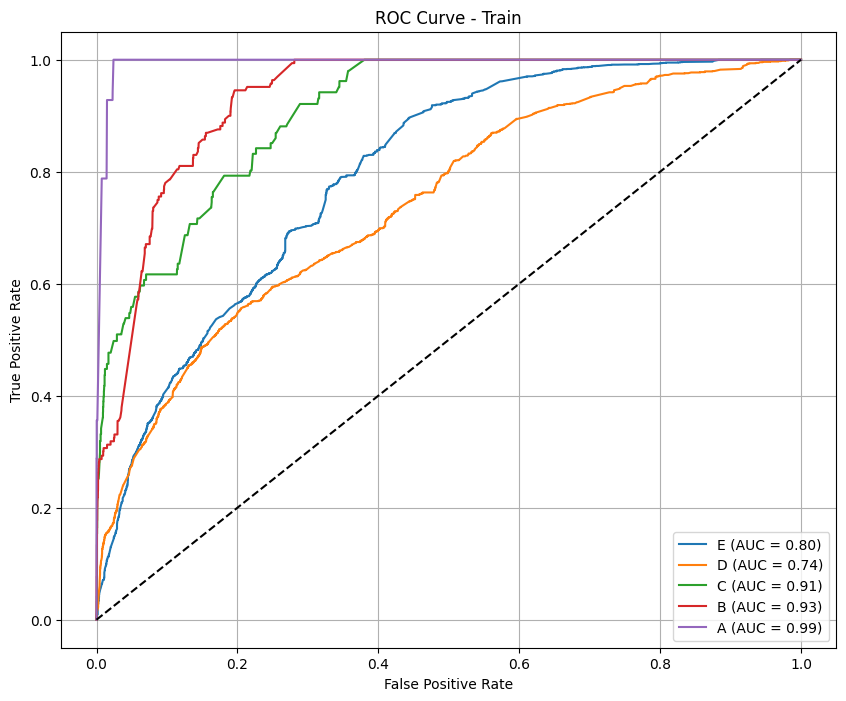

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.49821216 0.07954545 0.02083333 0.08       0.0952381 ]
Precision (per class): [0.73591549 0.07692308 0.01111111 0.0625     0.1       ]
Recall (per class): [0.37657658 0.08235294 0.16666667 0.11111111 0.09090909]
Accuracy: 0.3231
AUC (One-vs-Rest): 0.4723

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.38      0.50       555
           D       0.08      0.08      0.08        85
           C       0.01      0.17      0.02        18
           B       0.06      0.11      0.08        18
           A       0.10      0.09      0.10        11

    accuracy                           0.32       687
   macro avg       0.20      0.17      0.15       687
weighted avg       0.61      0.32      0.42       687



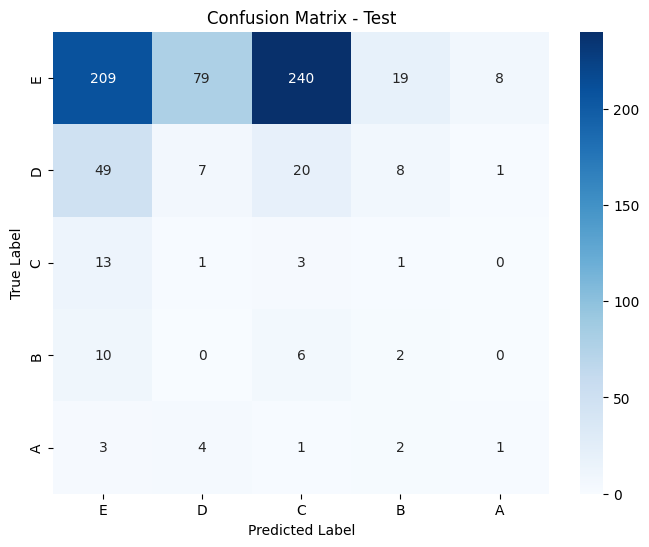

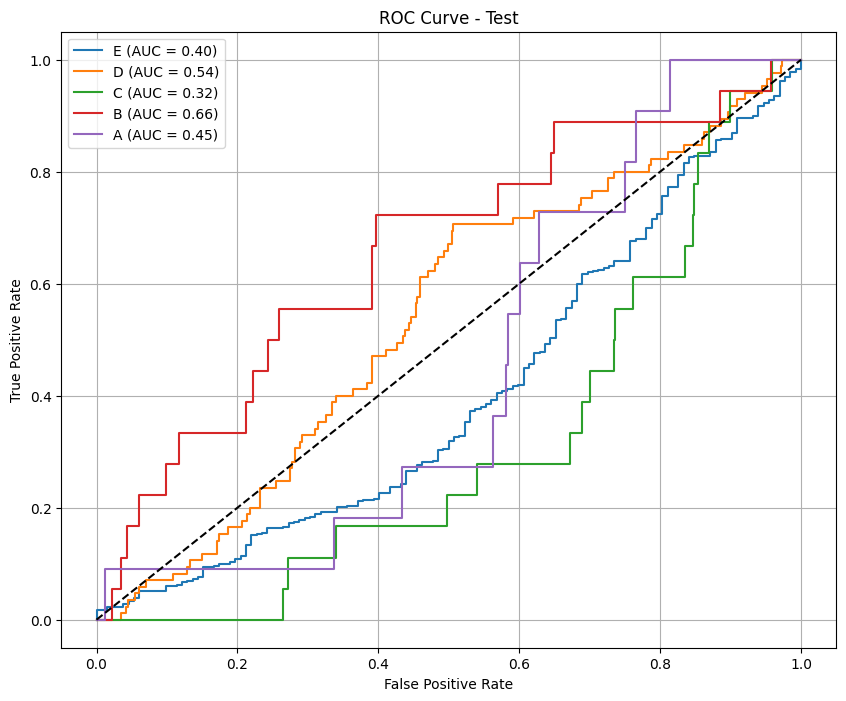

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_robust.csv
223/223 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
[[0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.10611966]
 [0.11704755]
 [0.17493153]
 [0.60190123]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.45554093]
 [0.2092673 ]
 [0.11768872]
 [0.217503  ]
 [0.13783674]
 [0.2132527 ]
 [0.27634114]
 [0.37256935]
 [0.26939702]
 [0.2466661 ]
 [0.23757802]
 [0.24635883]
 [0.11338861]
 [0.20923528]
 [0.335629  ]
 [0.34174716]
 [0.15826035]
 [0.16058126]
 [0.24862623]
 [0.43253213]
 [0.26939702]
 [0.2466661 ]
 [0.23

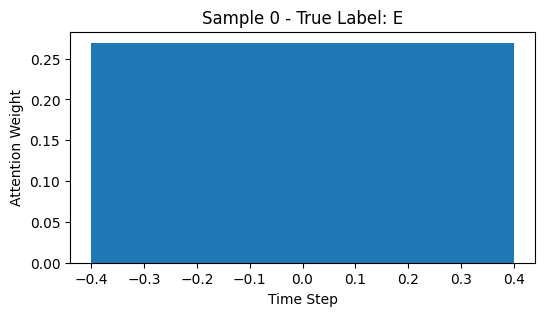

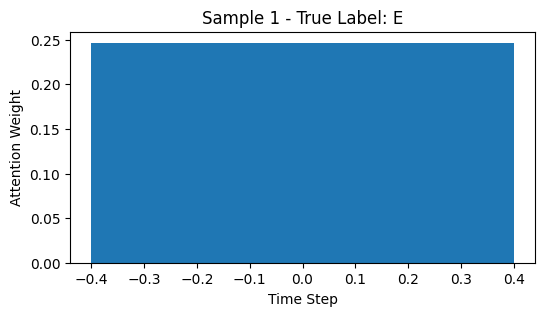

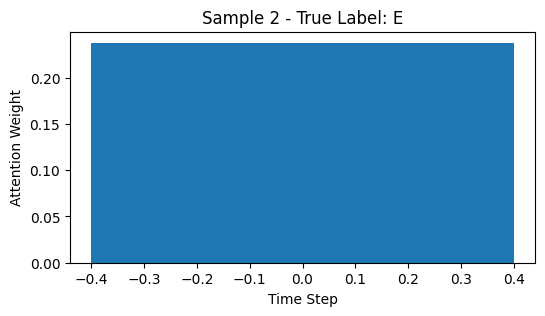

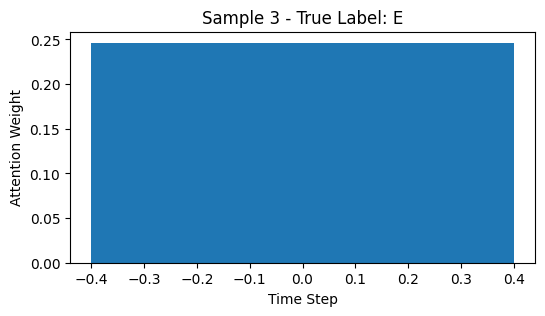

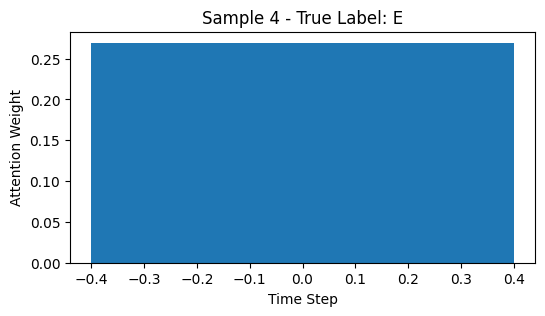

In [35]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, metric='f1_macro', scale='robust') 

### smote

In [36]:
# for phase in ["phase1", "phase2", "phase3", "phase4"]:
#     process_smote_phase(phase, scale='robust', metric='f1_macro')

# 3. Scale dữ liệu theo Log

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_48"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_48          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_96 (Dropout)      │ (None, 1, 128)         │              0 │ bidirectional_48[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_49          │ (None, 1, 64)          │         41,216 │ dropout_96[0][0]       │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_49[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_49[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_145 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_48    │ (None, 64)             │            256 │ dense_145[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_144 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_98 (Dropout)      │ (None, 64)             │              0 │ batch_normalization_4… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_97 (Dropout)      │ (None, 64)             │              0 │ dense_144[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_146 (Dense)         │ (None, 32)             │          2,080 │ dropout_98[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_24            │ (None, 96)             │              0 │ dropout_97[0][0],      │
│ (Concatenate)             │                        │                │ dense_146[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


143/145 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2622 - loss: 7.6451

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


42/42 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step

Epoch 1: val_f1_macro = 0.1588
145/145 ━━━━━━━━━━━━━━━━━━━━ 22s 33ms/step - accuracy: 0.2613 - loss: 7.6147 - val_accuracy: 0.6581 - val_loss: 0.9869 - val_f1_macro: 0.1588 - learning_rate: 0.0010
Epoch 2/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.1903
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.2396 - loss: 4.6134 - val_accuracy: 0.4213 - val_loss: 1.2691 - val_f1_macro: 0.1903 - learning_rate: 0.0010
Epoch 3/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.2416
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.2865 - loss: 4.3046 - val_accuracy: 0.6210 - val_loss: 1.0255 - val_f1_macro: 0.2416 - learning_rate: 0.0010
Epoch 4/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.1935
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.2828 - loss: 4.2923 - val_accuracy: 0.6339 - val_loss: 0.9297 - val_f1_macro: 0.1935 - learning_rate: 0.0010
Epoch 5/200
42/42 ━━━

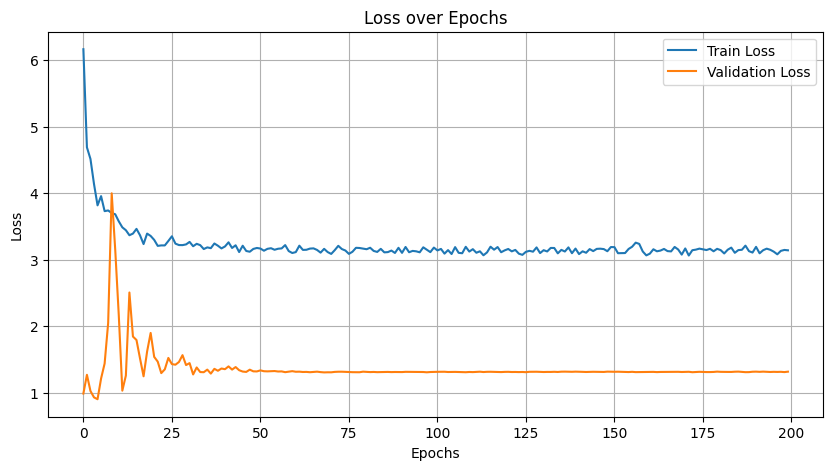

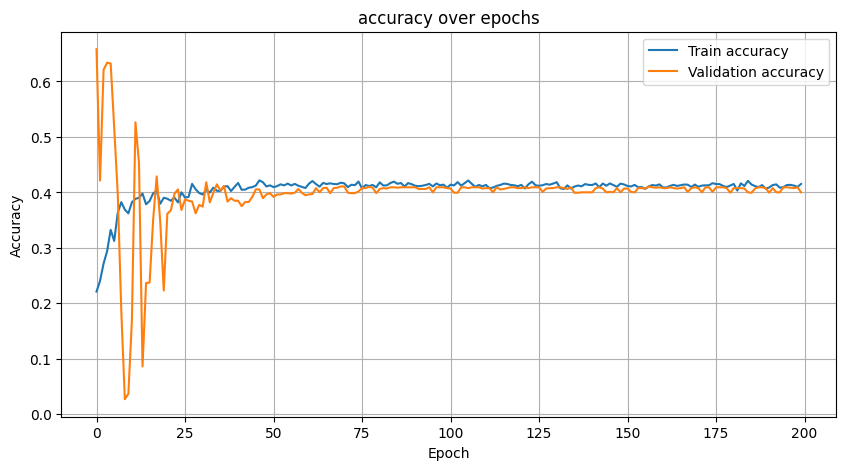

331/331 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.59499871 0.23167719 0.09027308 0.2190396  0.16528926]
Precision (per class): [0.74053476 0.72260274 0.04806537 0.13903743 0.09302326]
Recall (per class): [0.4972709  0.13795358 0.74074074 0.51587302 0.74074074]
Accuracy: 0.4006
AUC (One-vs-Rest): 0.7830

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.50      0.59      6962
           D       0.72      0.14      0.23      3059
           C       0.05      0.74      0.09       270
           B       0.14      0.52      0.22       252
           A       0.09      0.74      0.17        27

    accuracy                           0.40     10570
   macro avg       0.35      0.53      0.26     10570
weighted avg       0.70      0.40      0.47     10570



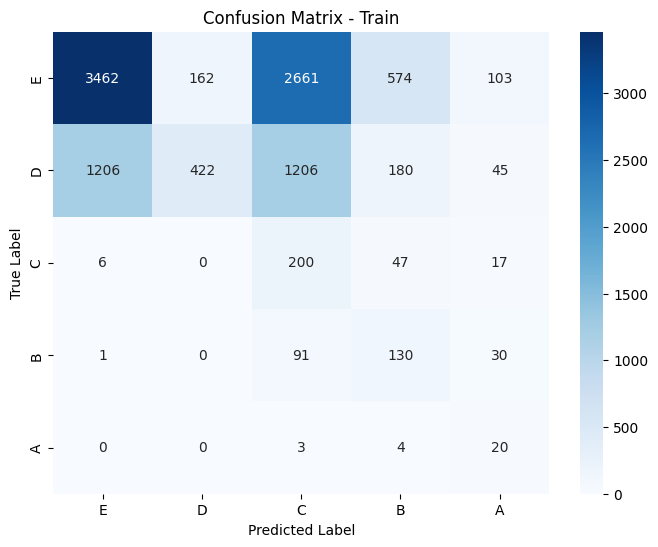

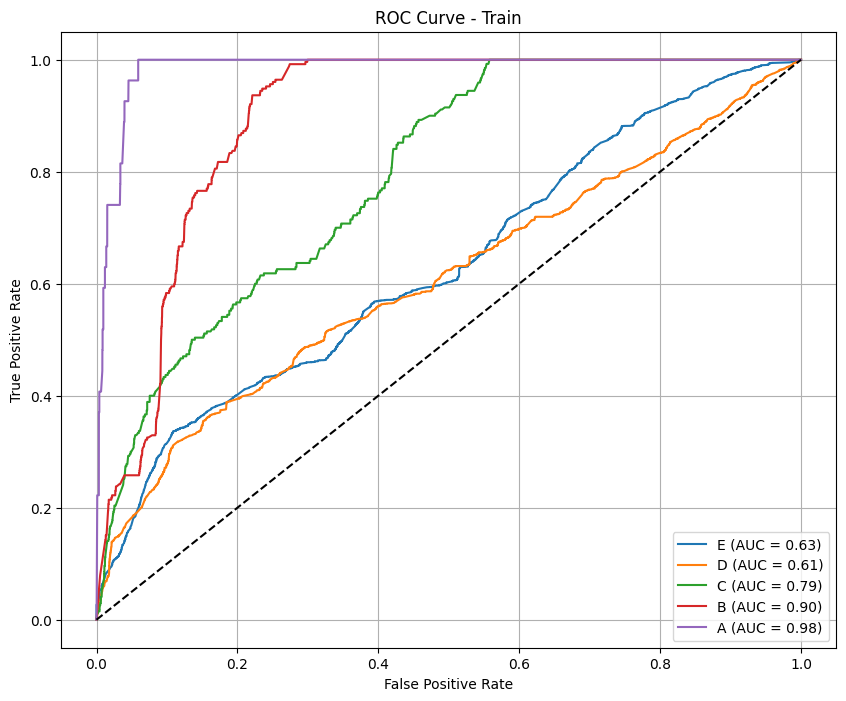

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.59538784 0.         0.07449857 0.02325581 0.24      ]
Precision (per class): [0.84023669 0.         0.03951368 0.01428571 0.2       ]
Recall (per class): [0.46103896 0.         0.65       0.0625     0.3       ]
Accuracy: 0.3981
AUC (One-vs-Rest): 0.6386

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.46      0.60       616
           D       0.00      0.00      0.00        94
           C       0.04      0.65      0.07        20
           B       0.01      0.06      0.02        16
           A       0.20      0.30      0.24        10

    accuracy                           0.40       756
   macro avg       0.22      0.29      0.19       756
weighted avg       0.69      0.40      0.49       756



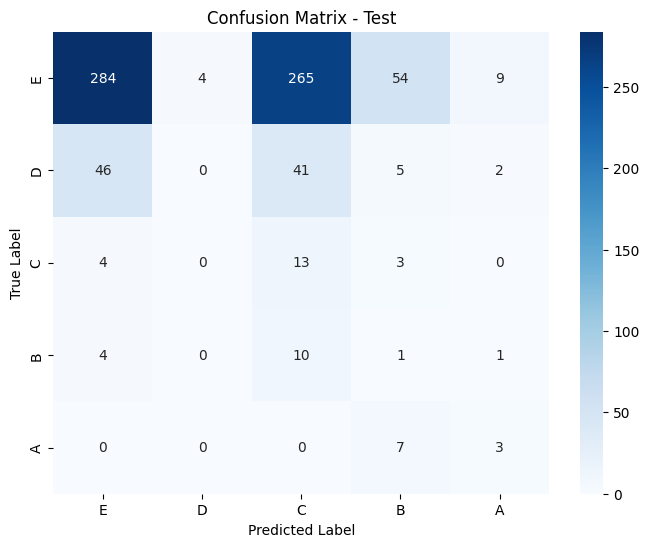

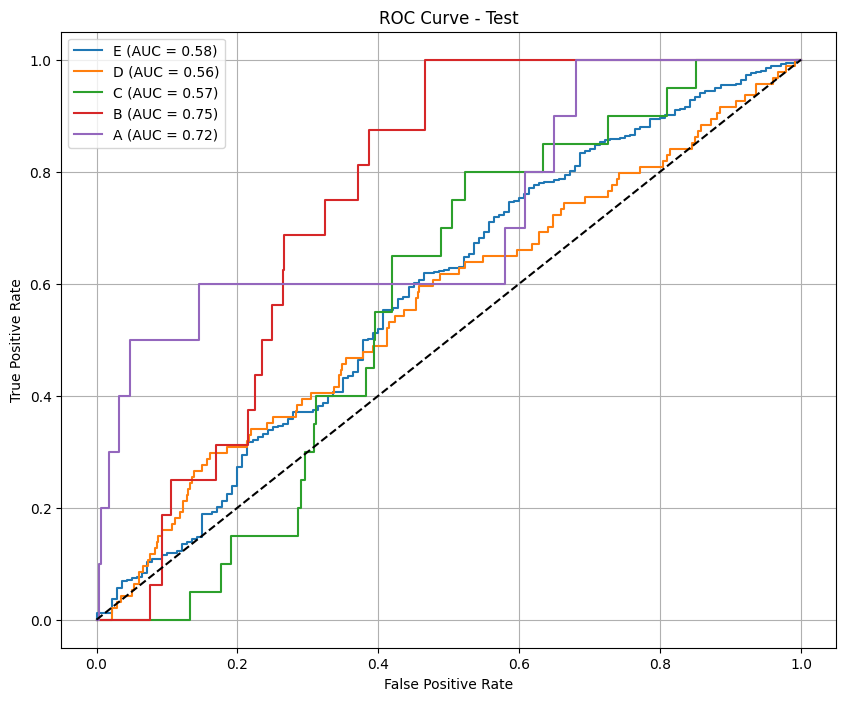

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_log.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


323/331 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


331/331 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

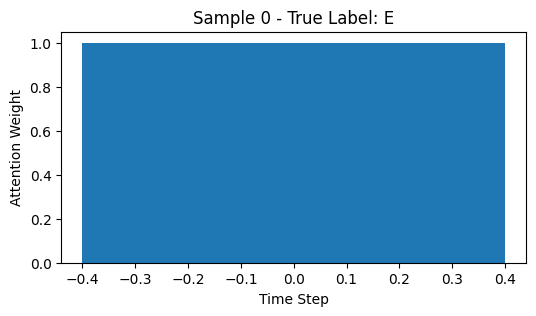

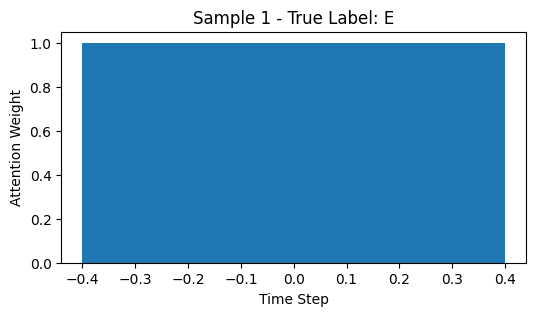

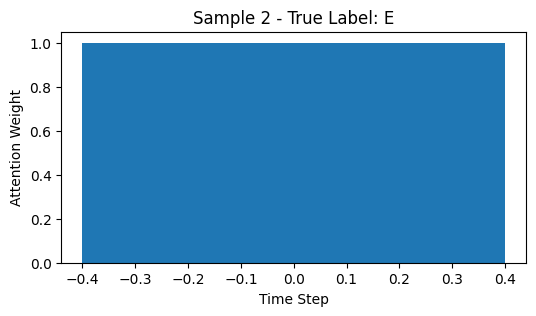

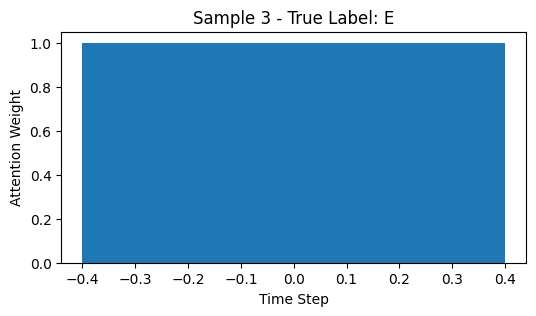

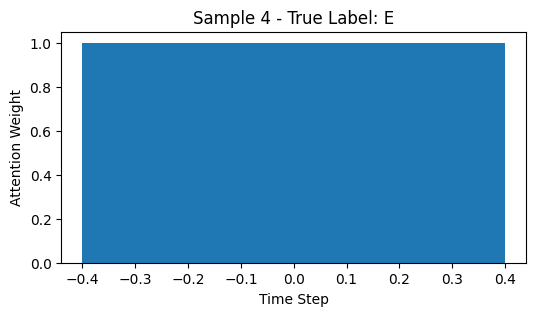

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_50"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_50          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_100 (Dropout)     │ (None, 2, 128)         │              0 │ bidirectional_50[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_51          │ (None, 2, 64)          │         41,216 │ dropout_100[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_51[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_51[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_151 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_50    │ (None, 64)             │            256 │ dense_151[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_150 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_102 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_5… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_101 (Dropout)     │ (None, 64)             │              0 │ dense_150[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_152 (Dense)         │ (None, 32)             │          2,080 │ dropout_102[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_25            │ (None, 96)             │              0 │ dropout_101[0][0],     │
│ (Concatenate)             │                        │                │ dense_152[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 2s 37ms/step

Epoch 1: val_f1_macro = 0.0890
117/117 ━━━━━━━━━━━━━━━━━━━━ 18s 43ms/step - accuracy: 0.2665 - loss: 8.5248 - val_accuracy: 0.2862 - val_loss: 1.7175 - val_f1_macro: 0.0890 - learning_rate: 0.0010
Epoch 2/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.1569
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.2322 - loss: 5.2144 - val_accuracy: 0.6427 - val_loss: 1.0323 - val_f1_macro: 0.1569 - learning_rate: 0.0010
Epoch 3/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.1735
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3015 - loss: 4.7892 - val_accuracy: 0.6464 - val_loss: 1.0129 - val_f1_macro: 0.1735 - learning_rate: 0.0010
Epoch 4/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.1405
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.3279 - loss: 4.4078 - val_accuracy: 0.3695 - val_loss: 1.5158 - val_f1_macro: 0.1405 - learning_rate: 0.0010
Epoch 

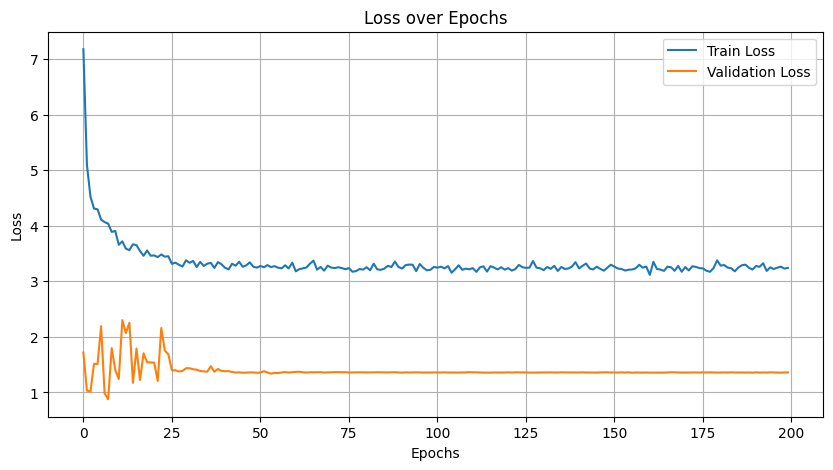

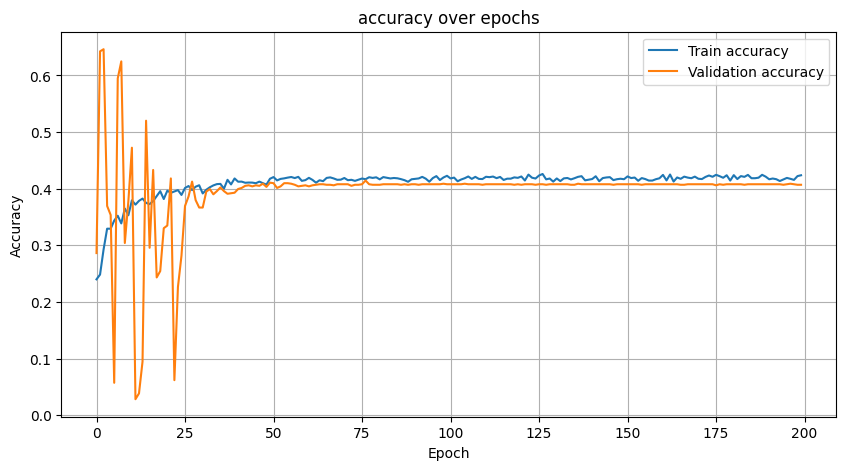

268/268 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.62187306 0.18679775 0.10349374 0.22088655 0.1722488 ]
Precision (per class): [0.74198323 0.65679012 0.05599144 0.13351499 0.09782609]
Recall (per class): [0.53523132 0.10888252 0.6826087  0.63913043 0.72      ]
Accuracy: 0.4207
AUC (One-vs-Rest): 0.7773

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.54      0.62      5620
           D       0.66      0.11      0.19      2443
           C       0.06      0.68      0.10       230
           B       0.13      0.64      0.22       230
           A       0.10      0.72      0.17        25

    accuracy                           0.42      8548
   macro avg       0.34      0.54      0.26      8548
weighted avg       0.68      0.42      0.47      8548



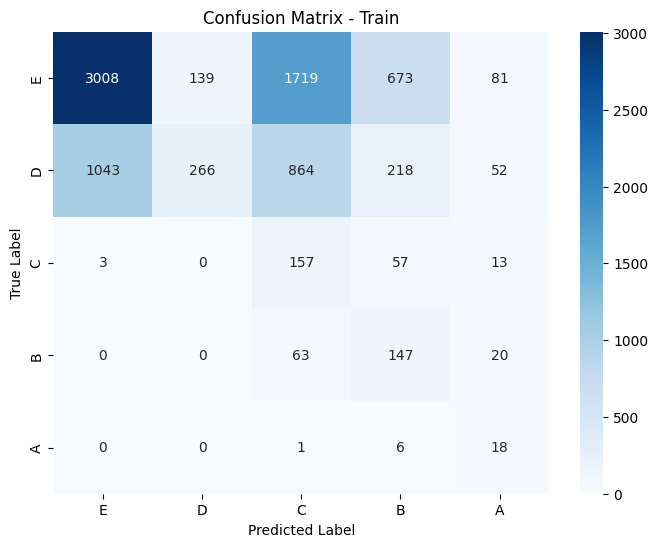

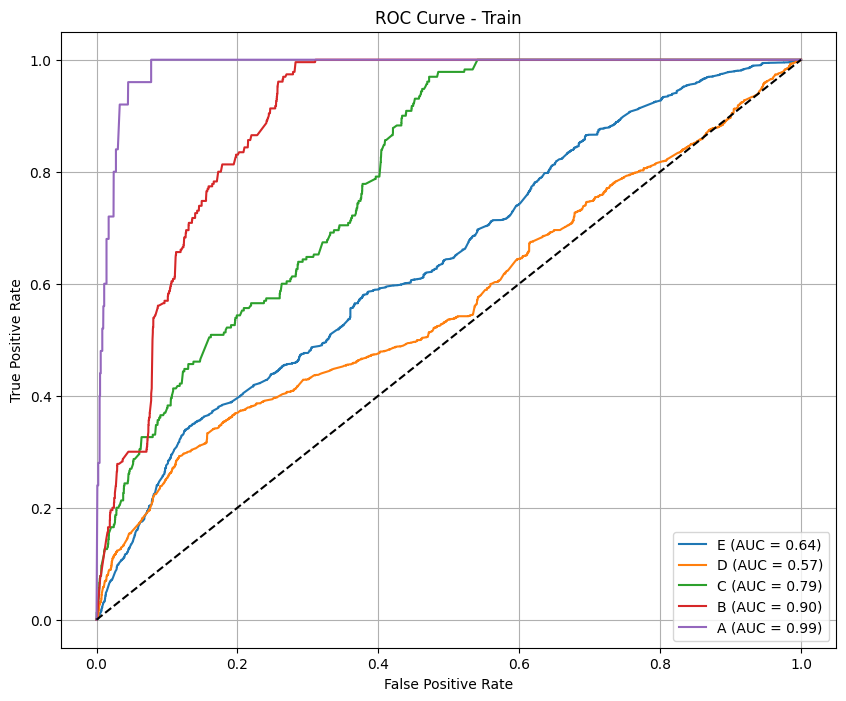

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.66928361 0.05555556 0.05734767 0.06451613 0.33333333]
Precision (per class): [0.83170732 0.1875     0.03088803 0.04255319 0.28571429]
Recall (per class): [0.55993432 0.0326087  0.4        0.13333333 0.4       ]
Accuracy: 0.4799
AUC (One-vs-Rest): 0.6569

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.56      0.67       609
           D       0.19      0.03      0.06        92
           C       0.03      0.40      0.06        20
           B       0.04      0.13      0.06        15
           A       0.29      0.40      0.33        10

    accuracy                           0.48       746
   macro avg       0.28      0.31      0.24       746
weighted avg       0.71      0.48      0.56       746



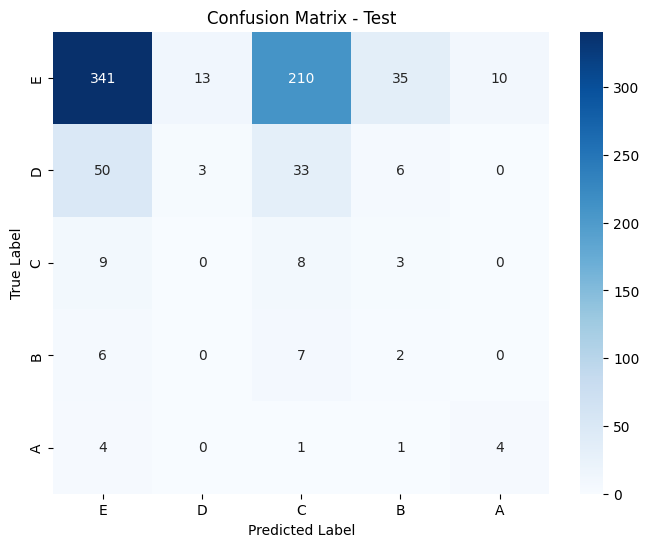

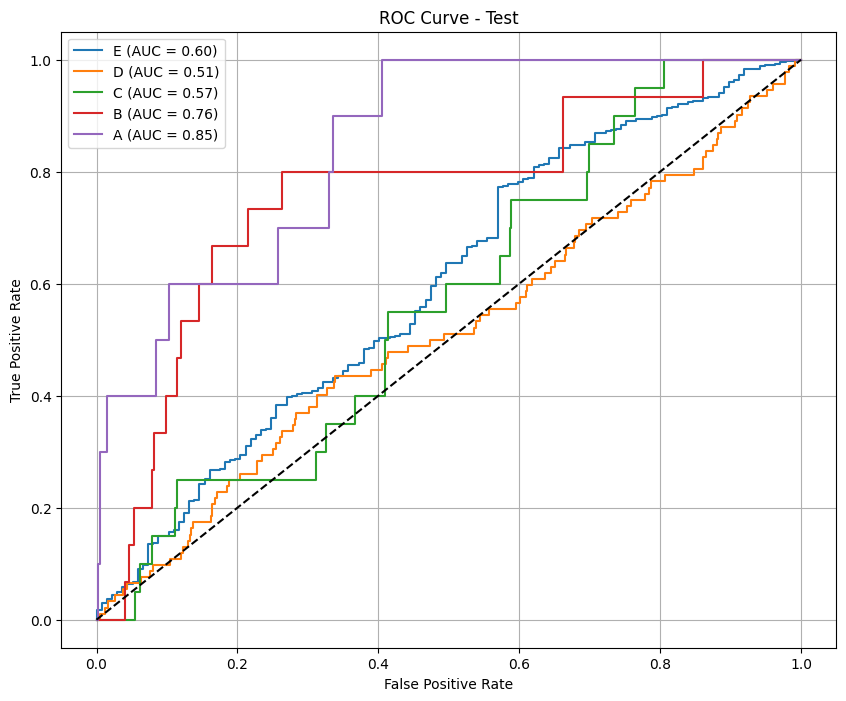

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_log.csv
268/268 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.27857783]
 [0.72142214]
 [0.278586  ]
 [0.72141397]
 [0.27860543]
 [0.72139454]
 [0.27857783]
 [0.72142214]
 [0.2786245 ]
 [0.7213756 ]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27858168]
 [0.72141826]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857634]
 [0.7214236 ]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.2785842 ]
 [0.7214157 ]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27856797]
 [0.72143203]
 [0.27856675]
 [0.7214332 ]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27856803]
 [0.72143203]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857783]
 [0.72142214]
 [0.27857757]
 [0.7214224 ]
 [0.27858

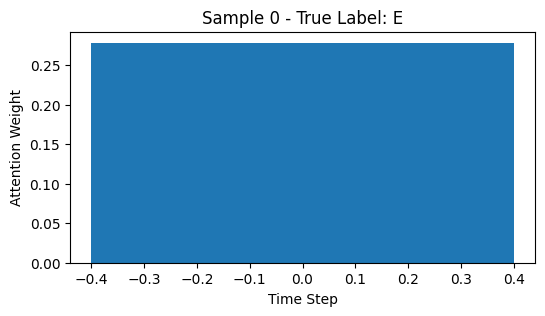

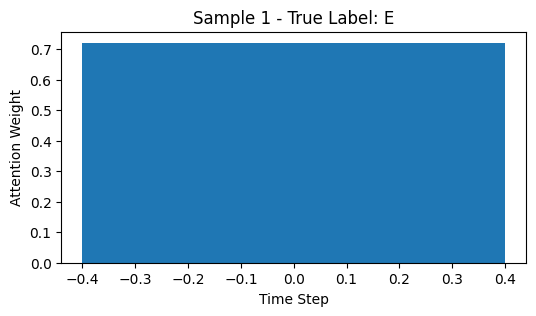

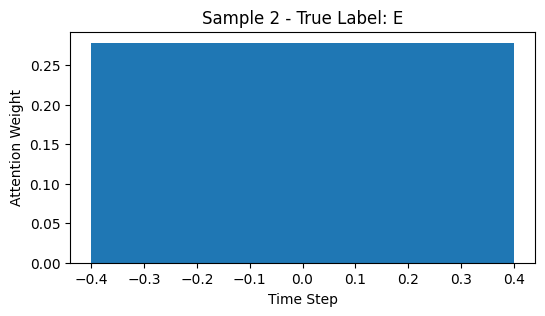

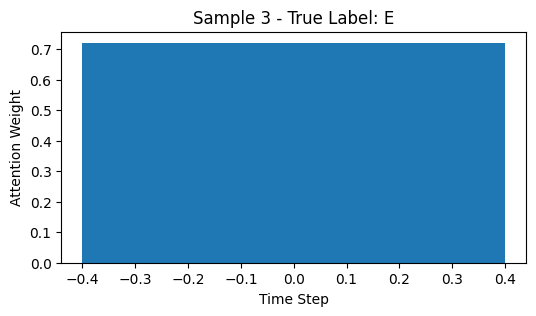

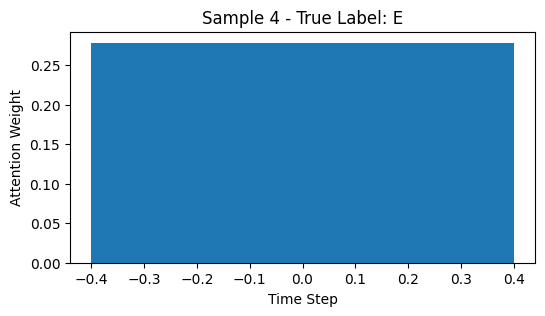

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_52"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_52          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_104 (Dropout)     │ (None, 3, 128)         │              0 │ bidirectional_52[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_53          │ (None, 3, 64)          │         41,216 │ dropout_104[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_53[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_53[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_157 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_52    │ (None, 64)             │            256 │ dense_157[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_156 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_106 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_5… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_105 (Dropout)     │ (None, 64)             │              0 │ dense_156[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_158 (Dense)         │ (None, 32)             │          2,080 │ dropout_106[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_26            │ (None, 96)             │              0 │ dropout_105[0][0],     │
│ (Concatenate)             │                        │                │ dense_158[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 43ms/step

Epoch 1: val_f1_macro = 0.1549
107/107 ━━━━━━━━━━━━━━━━━━━━ 22s 50ms/step - accuracy: 0.3488 - loss: 6.8468 - val_accuracy: 0.6301 - val_loss: 2.2203 - val_f1_macro: 0.1549 - learning_rate: 0.0010
Epoch 2/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1584
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 19ms/step - accuracy: 0.2460 - loss: 5.0517 - val_accuracy: 0.6557 - val_loss: 1.3326 - val_f1_macro: 0.1584 - learning_rate: 0.0010
Epoch 3/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.1680
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.2875 - loss: 4.6307 - val_accuracy: 0.6496 - val_loss: 1.2887 - val_f1_macro: 0.1680 - learning_rate: 0.0010
Epoch 4/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.0972
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.2777 - loss: 4.2526 - val_accuracy: 0.2234 - val_loss: 1.5730 - val_f1_macro: 0.0972 - learning_rate: 0.0010
Epoch 

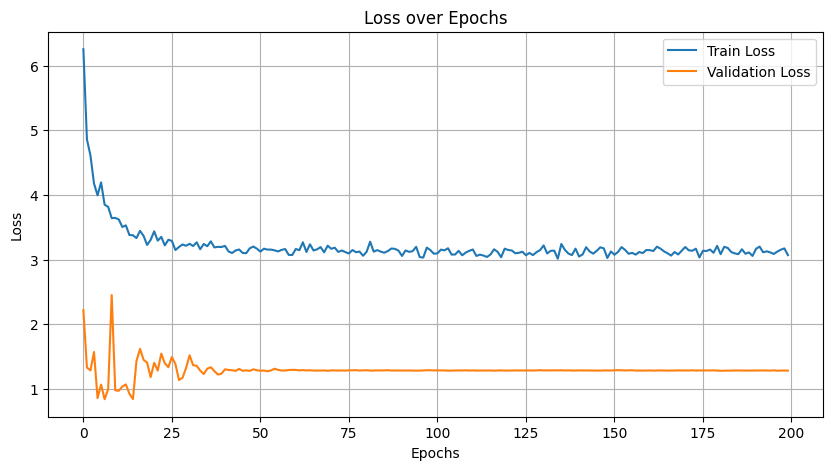

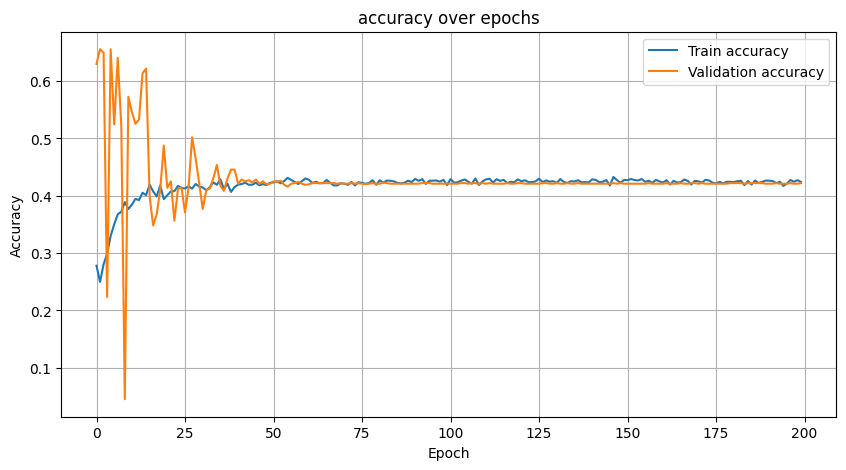

244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.64521628 0.00353201 0.09647779 0.24242424 0.1023622 ]
Precision (per class): [0.71046457 0.8        0.05208764 0.14965986 0.05531915]
Recall (per class): [0.59094457 0.00176991 0.65284974 0.63768116 0.68421053]
Accuracy: 0.4233
AUC (One-vs-Rest): 0.7810

Classification Report:
              precision    recall  f1-score   support

           E       0.71      0.59      0.65      5124
           D       0.80      0.00      0.00      2260
           C       0.05      0.65      0.10       193
           B       0.15      0.64      0.24       207
           A       0.06      0.68      0.10        19

    accuracy                           0.42      7803
   macro avg       0.35      0.51      0.22      7803
weighted avg       0.70      0.42      0.43      7803



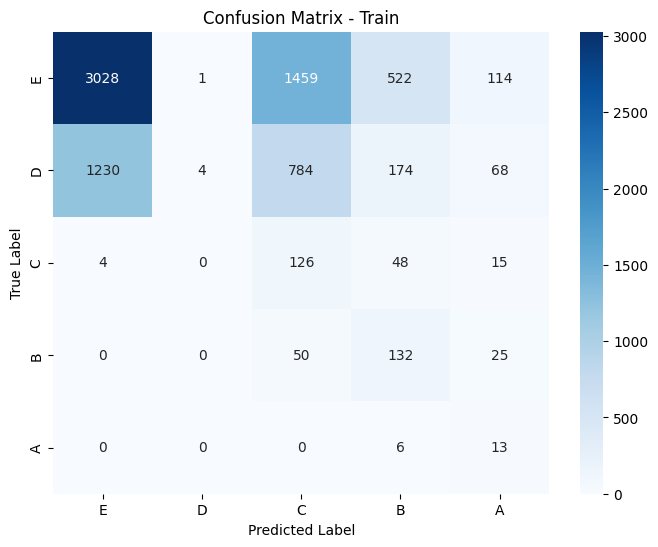

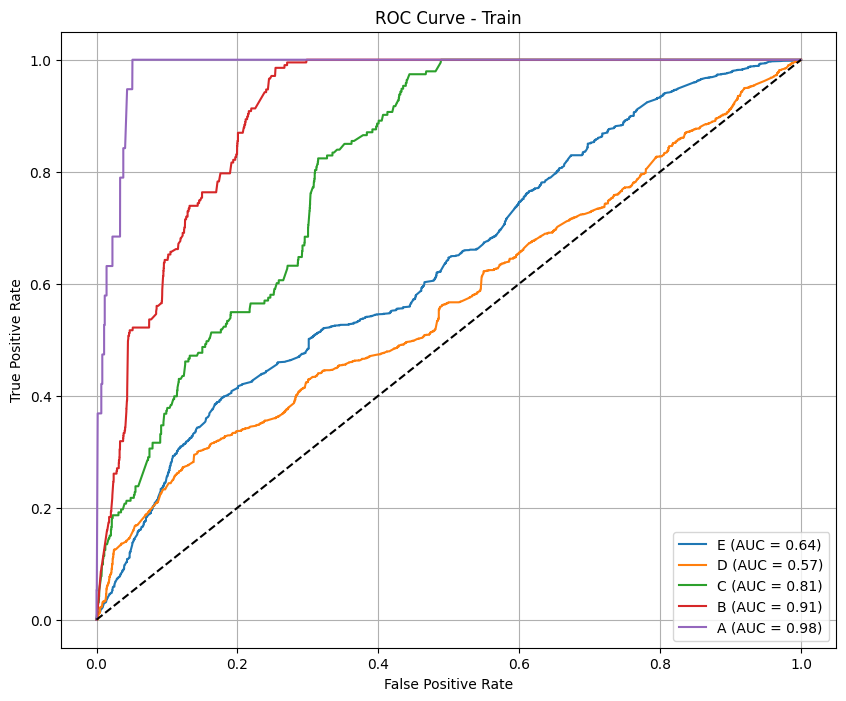

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.61538462 0.02173913 0.07250755 0.06153846 0.19354839]
Precision (per class): [0.84776119 0.2        0.03858521 0.04081633 0.14285714]
Recall (per class): [0.4829932  0.01149425 0.6        0.125      0.3       ]
Accuracy: 0.4189
AUC (One-vs-Rest): 0.6447

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.48      0.62       588
           D       0.20      0.01      0.02        87
           C       0.04      0.60      0.07        20
           B       0.04      0.12      0.06        16
           A       0.14      0.30      0.19        10

    accuracy                           0.42       721
   macro avg       0.25      0.30      0.19       721
weighted avg       0.72      0.42      0.51       721



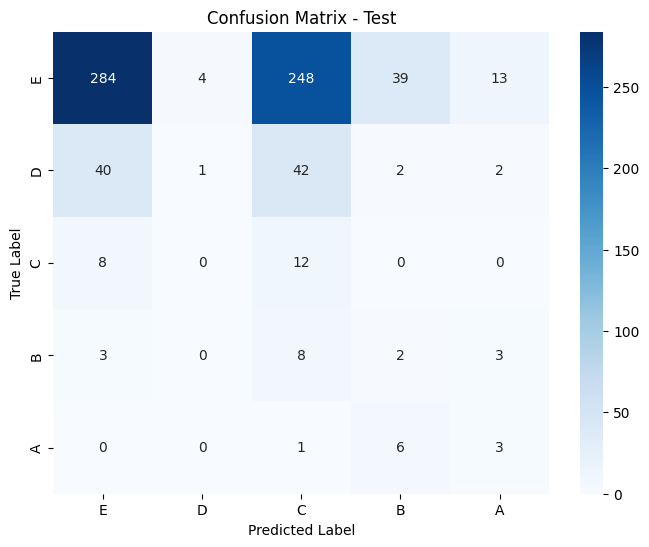

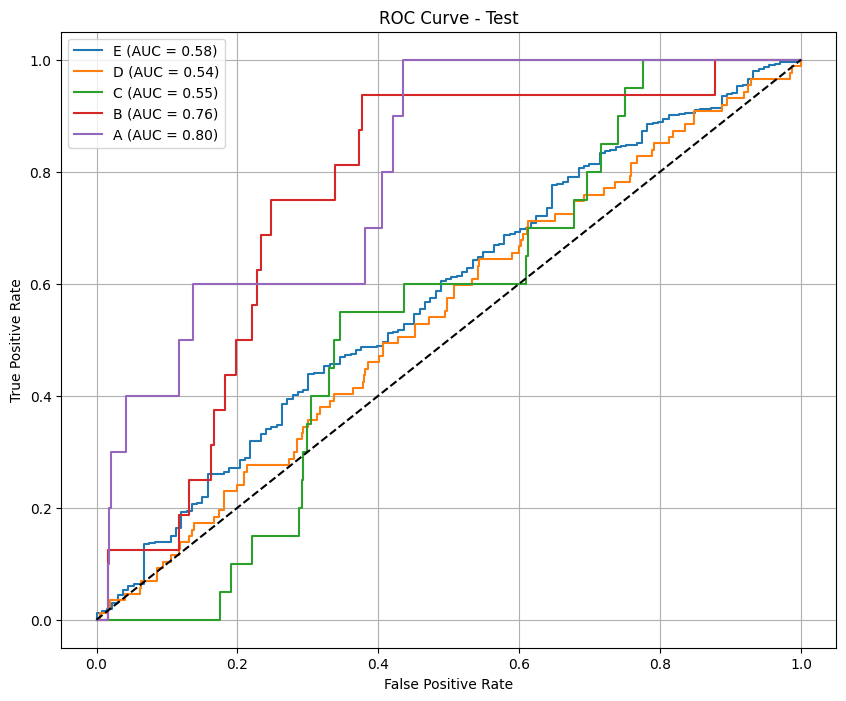

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_log.csv
244/244 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46281365]
 [0.29279986]
 [0.24438651]
 [0.46190003]
 [0.2936631 ]
 [0.24443689]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.461893  ]
 [0.2938514 ]
 [0.24425557]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46184736]
 [0.29381165]
 [0.24434097]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454232]
 [0.46174183]
 [0.29371583]
 [0.24454

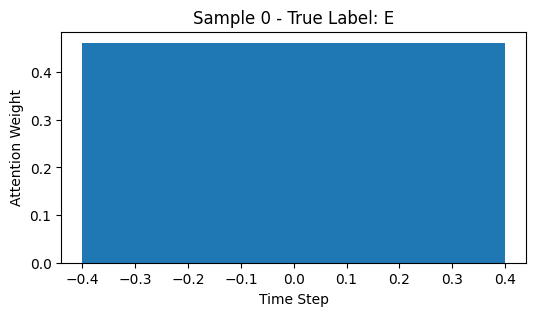

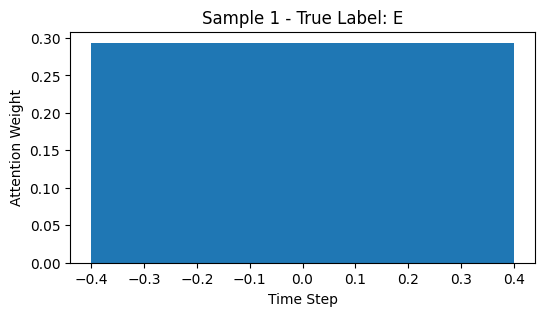

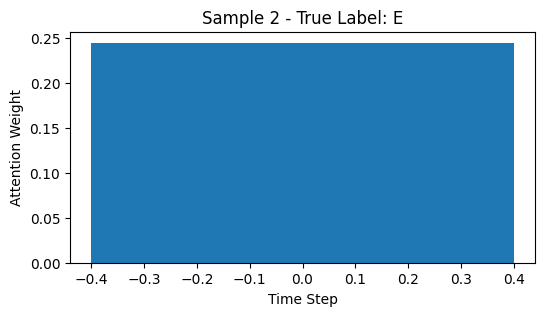

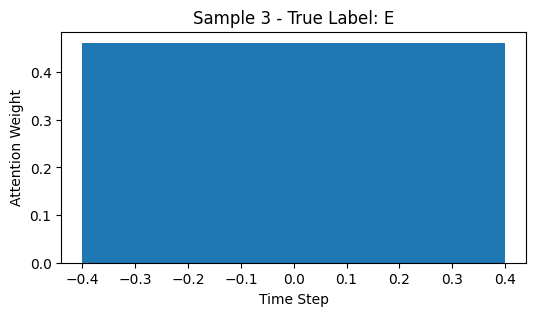

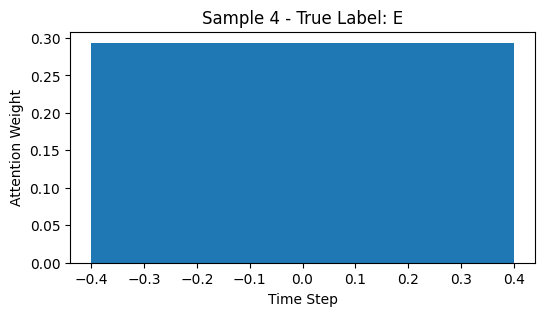

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_54"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_54          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_108 (Dropout)     │ (None, 4, 128)         │              0 │ bidirectional_54[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_55          │ (None, 4, 64)          │         41,216 │ dropout_108[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_55[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_55[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_163 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_54    │ (None, 64)             │            256 │ dense_163[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_162 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_110 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_5… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_109 (Dropout)     │ (None, 64)             │              0 │ dense_162[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_164 (Dense)         │ (None, 32)             │          2,080 │ dropout_110[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_27            │ (None, 96)             │              0 │ dropout_109[0][0],     │
│ (Concatenate)             │                        │                │ dense_164[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 6s 247ms/step

Epoch 1: val_f1_macro = 0.0911
74/74 ━━━━━━━━━━━━━━━━━━━━ 22s 115ms/step - accuracy: 0.2522 - loss: 5.5682 - val_accuracy: 0.2951 - val_loss: 1.4477 - val_f1_macro: 0.0911 - learning_rate: 0.0010
Epoch 2/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.0911
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.2757 - loss: 4.7970 - val_accuracy: 0.2951 - val_loss: 2.2778 - val_f1_macro: 0.0911 - learning_rate: 0.0010
Epoch 3/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.1079
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.3368 - loss: 4.3270 - val_accuracy: 0.3145 - val_loss: 1.1789 - val_f1_macro: 0.1079 - learning_rate: 0.0010
Epoch 4/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2125
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.3384 - loss: 4.3576 - val_accuracy: 0.4531 - val_loss: 1.0734 - val_f1_macro: 0.2125 - learning_rate: 0.0010
Epoch 5/200


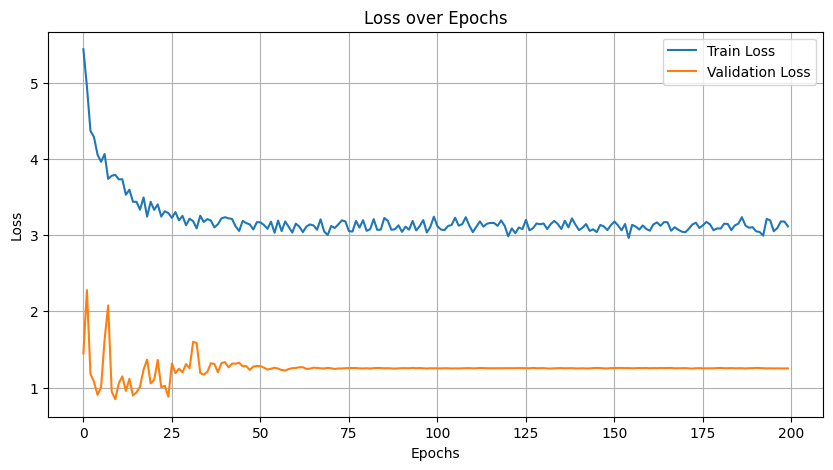

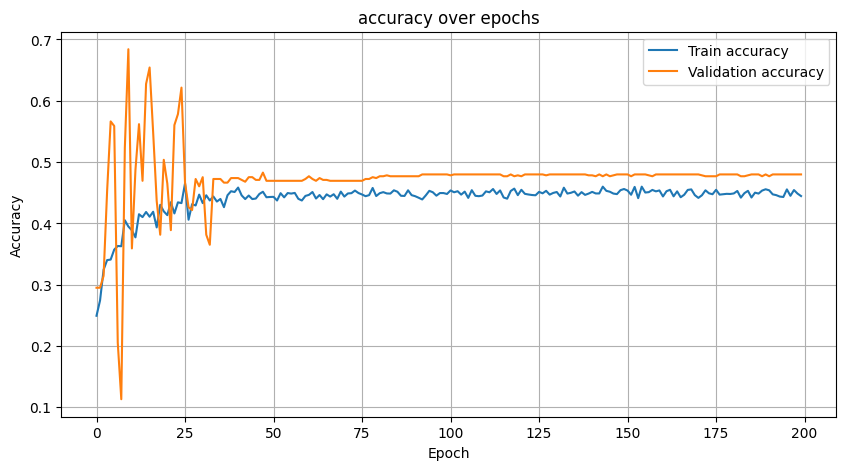

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.63928515 0.2559675  0.07119205 0.24788732 0.15238095]
Precision (per class): [0.70995822 0.65116279 0.03884372 0.14569536 0.08791209]
Recall (per class): [0.58140861 0.15929204 0.42574257 0.83018868 0.57142857]
Accuracy: 0.4613
AUC (One-vs-Rest): 0.7747

Classification Report:
              precision    recall  f1-score   support

           E       0.71      0.58      0.64      3507
           D       0.65      0.16      0.26      1582
           C       0.04      0.43      0.07       101
           B       0.15      0.83      0.25       159
           A       0.09      0.57      0.15        14

    accuracy                           0.46      5363
   macro avg       0.33      0.51      0.27      5363
weighted avg       0.66      0.46      0.50      5363



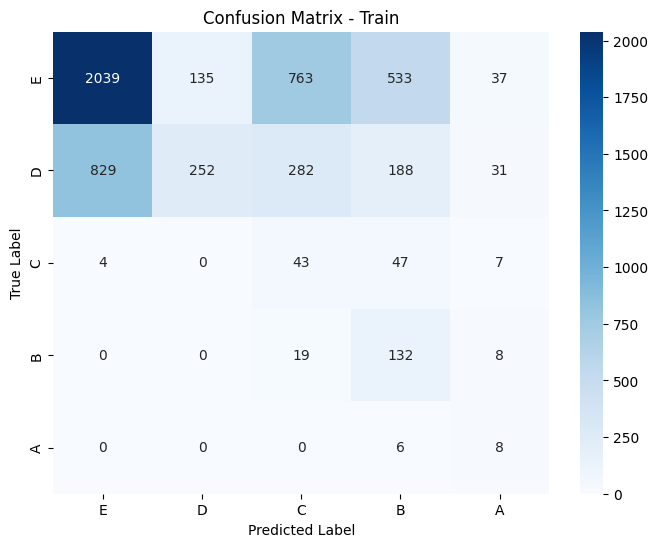

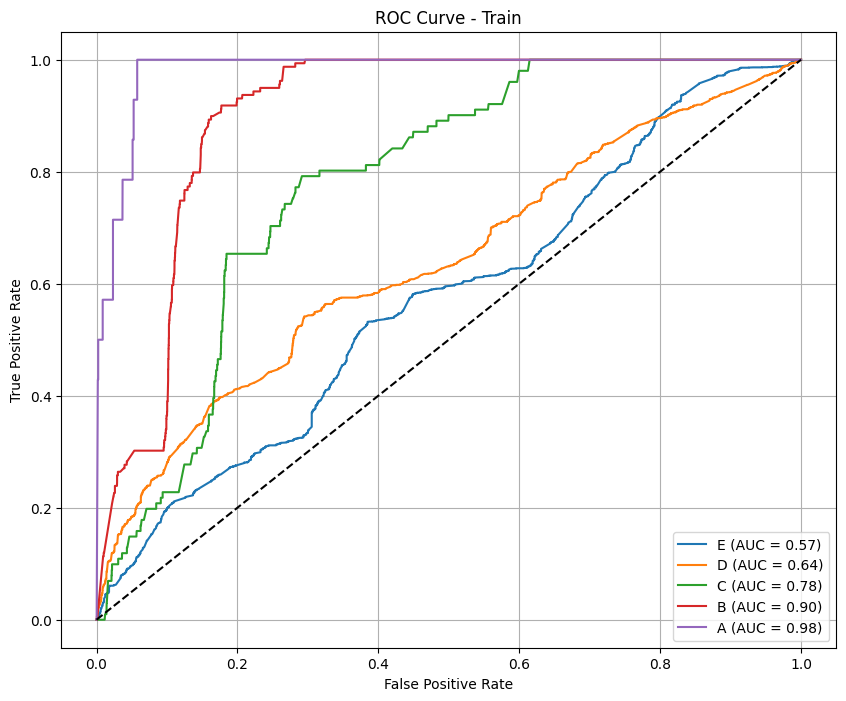

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.65337763 0.         0.05369128 0.06779661 0.14814815]
Precision (per class): [0.84770115 0.         0.02857143 0.04878049 0.125     ]
Recall (per class): [0.53153153 0.         0.44444444 0.11111111 0.18181818]
Accuracy: 0.4469
AUC (One-vs-Rest): 0.6422

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.53      0.65       555
           D       0.00      0.00      0.00        85
           C       0.03      0.44      0.05        18
           B       0.05      0.11      0.07        18
           A       0.12      0.18      0.15        11

    accuracy                           0.45       687
   macro avg       0.21      0.25      0.18       687
weighted avg       0.69      0.45      0.53       687



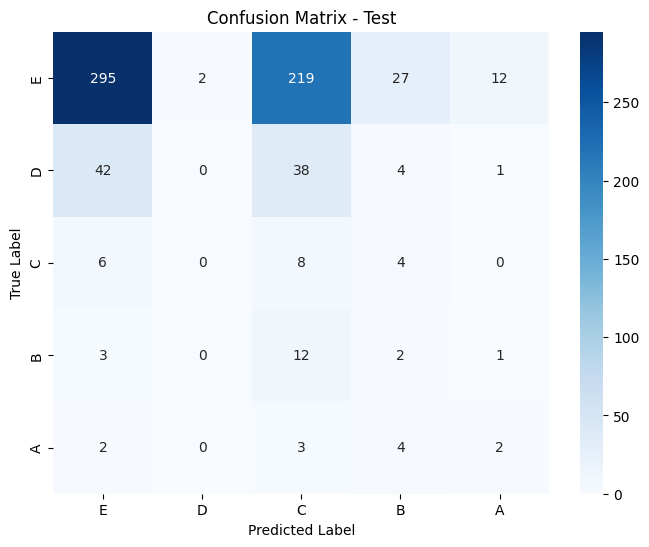

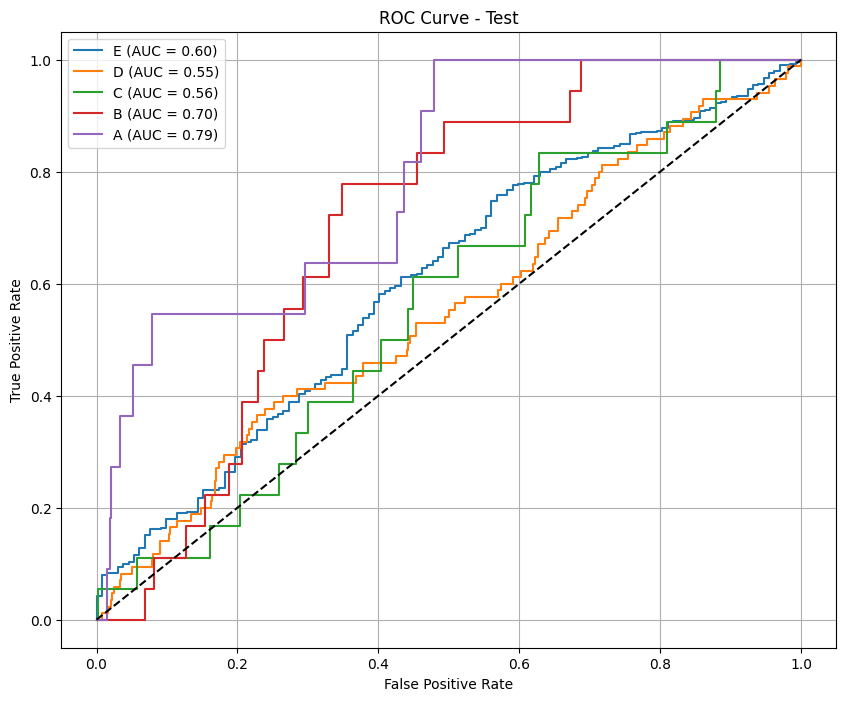

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Results saved: lstm_results_phase4_log.csv
168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
[[0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255996]
 [0.2533038 ]
 [0.23420972]
 [0.2299265 ]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.2825552 ]
 [0.2533864 ]
 [0.2341577 ]
 [0.22990072]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.23415686]
 [0.22990024]
 [0.28255546]
 [0.25338754]
 [0.2341

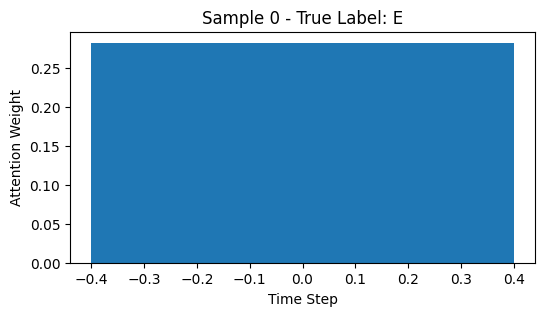

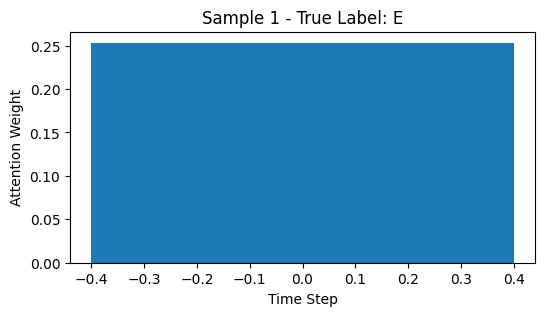

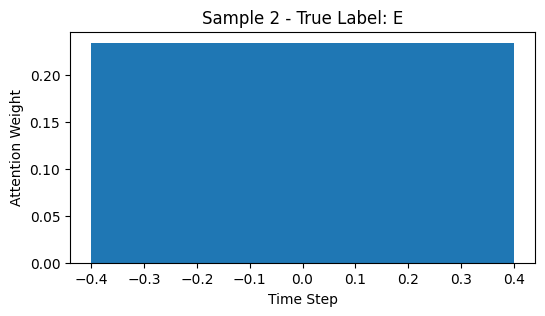

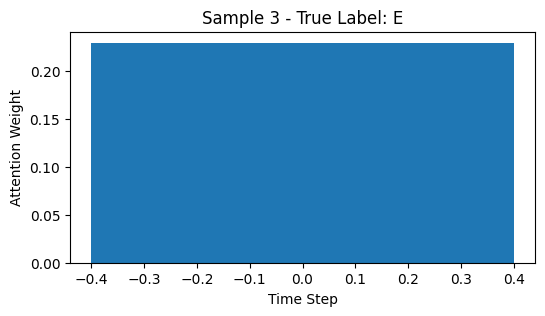

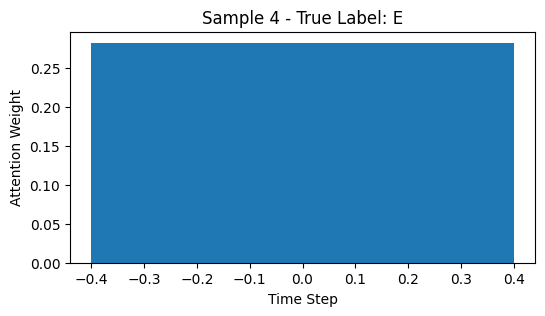

In [37]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro', scale='log') 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_56"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_56          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_112 (Dropout)     │ (None, 1, 128)         │              0 │ bidirectional_56[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_57          │ (None, 1, 64)          │         41,216 │ dropout_112[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_57[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_57[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_169 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_56    │ (None, 64)             │            256 │ dense_169[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_168 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_114 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_5… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_113 (Dropout)     │ (None, 64)             │              0 │ dense_168[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_170 (Dense)         │ (None, 32)             │          2,080 │ dropout_114[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_28            │ (None, 96)             │              0 │ dropout_113[0][0],     │
│ (Concatenate)             │                        │                │ dense_170[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


102/104 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2256 - loss: 9.9535 

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 45ms/step

Epoch 1: val_f1_macro = 0.0127
104/104 ━━━━━━━━━━━━━━━━━━━━ 19s 45ms/step - accuracy: 0.2251 - loss: 9.9023 - val_accuracy: 0.0327 - val_loss: 3.9341 - val_f1_macro: 0.0127 - learning_rate: 0.0010
Epoch 2/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.1090
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.2026 - loss: 6.1767 - val_accuracy: 0.2302 - val_loss: 1.7827 - val_f1_macro: 0.1090 - learning_rate: 0.0010
Epoch 3/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.1568
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.2128 - loss: 5.6398 - val_accuracy: 0.6420 - val_loss: 0.9087 - val_f1_macro: 0.1568 - learning_rate: 0.0010
Epoch 4/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.1583
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.2374 - loss: 5.2281 - val_accuracy: 0.6547 - val_loss: 0.9241 - val_f1_macro: 0.1583 - learning_rate: 0.0010
Epoch 5/200
30/30 

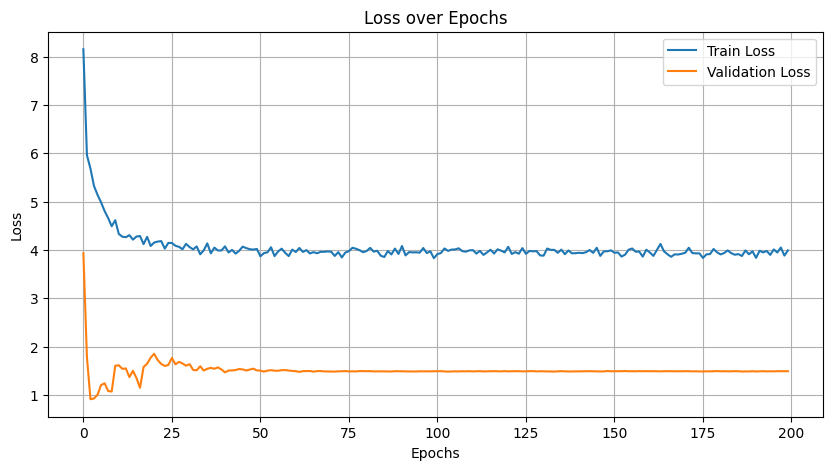

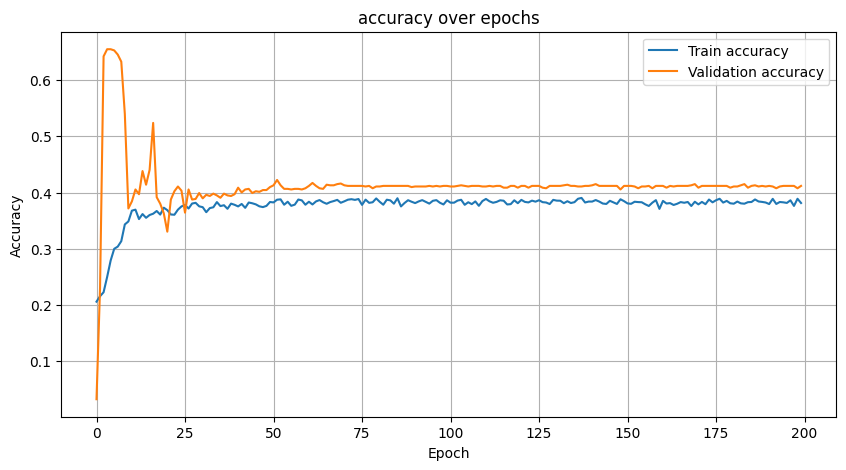

237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.59912643 0.21732026 0.12137379 0.23266932 0.18367347]
Precision (per class): [0.7527439  0.68380463 0.0666911  0.14556331 0.10650888]
Recall (per class): [0.49758162 0.12918893 0.67407407 0.57936508 0.66666667]
Accuracy: 0.4070
AUC (One-vs-Rest): 0.7727

Classification Report:
              precision    recall  f1-score   support

           E       0.75      0.50      0.60      4962
           D       0.68      0.13      0.22      2059
           C       0.07      0.67      0.12       270
           B       0.15      0.58      0.23       252
           A       0.11      0.67      0.18        27

    accuracy                           0.41      7570
   macro avg       0.35      0.51      0.27      7570
weighted avg       0.69      0.41      0.46      7570



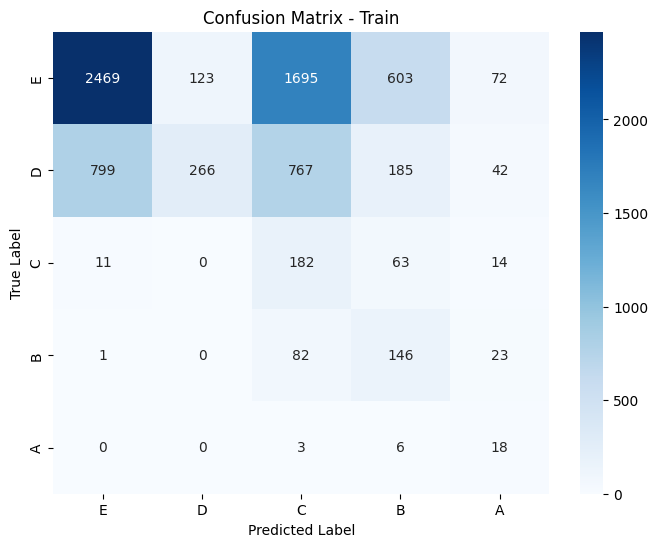

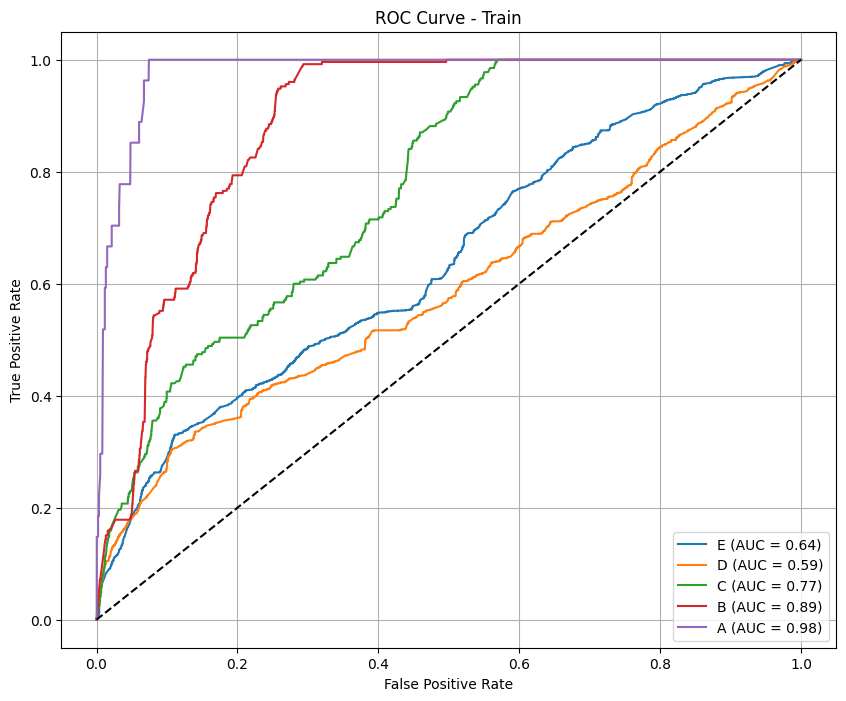

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.62153846 0.01785714 0.05572755 0.02597403 0.16      ]
Precision (per class): [0.84401114 0.05555556 0.02970297 0.01639344 0.13333333]
Recall (per class): [0.49188312 0.0106383  0.45       0.0625     0.2       ]
Accuracy: 0.4180
AUC (One-vs-Rest): 0.6178

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.49      0.62       616
           D       0.06      0.01      0.02        94
           C       0.03      0.45      0.06        20
           B       0.02      0.06      0.03        16
           A       0.13      0.20      0.16        10

    accuracy                           0.42       756
   macro avg       0.22      0.24      0.18       756
weighted avg       0.70      0.42      0.51       756



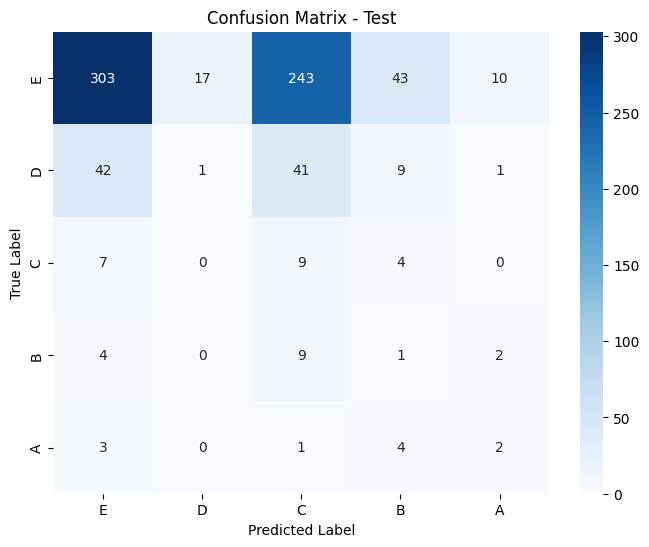

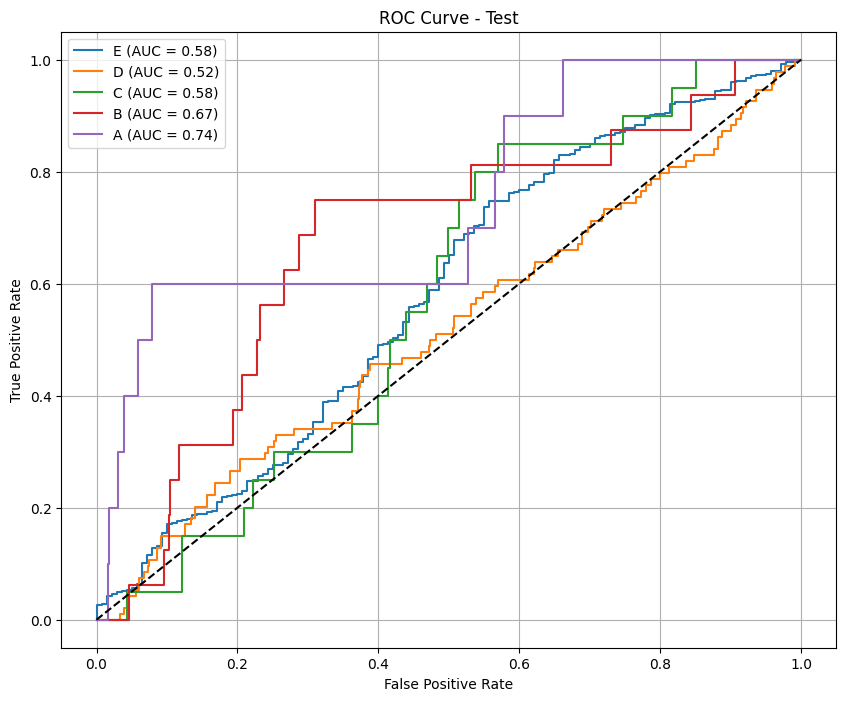

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_log.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


236/237 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

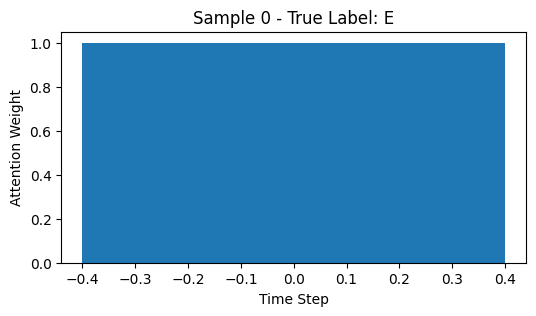

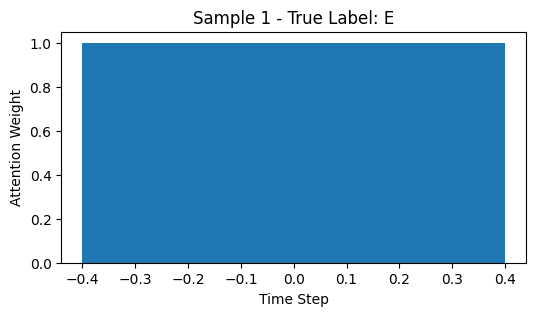

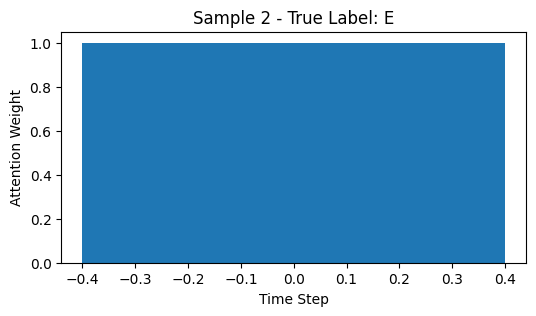

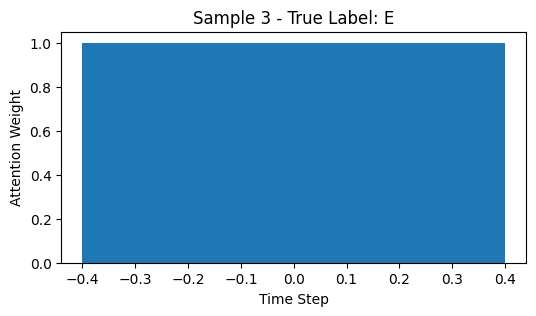

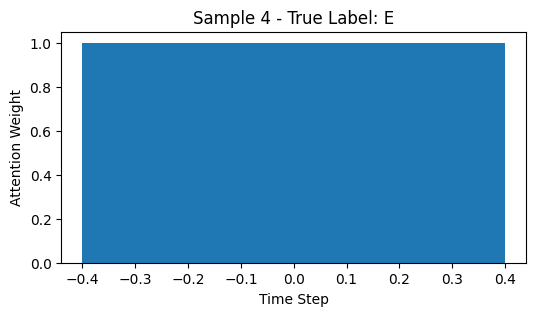

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_58"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_58          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_116 (Dropout)     │ (None, 2, 128)         │              0 │ bidirectional_58[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_59          │ (None, 2, 64)          │         41,216 │ dropout_116[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_59[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_59[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_175 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_58    │ (None, 64)             │            256 │ dense_175[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_174 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_118 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_5… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_117 (Dropout)     │ (None, 64)             │              0 │ dense_174[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_176 (Dense)         │ (None, 32)             │          2,080 │ dropout_118[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_29            │ (None, 96)             │              0 │ dropout_117[0][0],     │
│ (Concatenate)             │                        │                │ dense_176[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 3s 59ms/step

Epoch 1: val_f1_macro = 0.0160
76/76 ━━━━━━━━━━━━━━━━━━━━ 23s 126ms/step - accuracy: 0.0556 - loss: 10.5916 - val_accuracy: 0.0418 - val_loss: 3.2573 - val_f1_macro: 0.0160 - learning_rate: 0.0010
Epoch 2/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.0160
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.1197 - loss: 7.1534 - val_accuracy: 0.0418 - val_loss: 1.7991 - val_f1_macro: 0.0160 - learning_rate: 0.0010
Epoch 3/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.0160
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.1514 - loss: 6.8996 - val_accuracy: 0.0418 - val_loss: 1.8048 - val_f1_macro: 0.0160 - learning_rate: 0.0010
Epoch 4/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.1081
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step - accuracy: 0.1727 - loss: 6.5034 - val_accuracy: 0.2291 - val_loss: 1.3293 - val_f1_macro: 0.1081 - learning_rate: 0.0010
Epoch 5/200


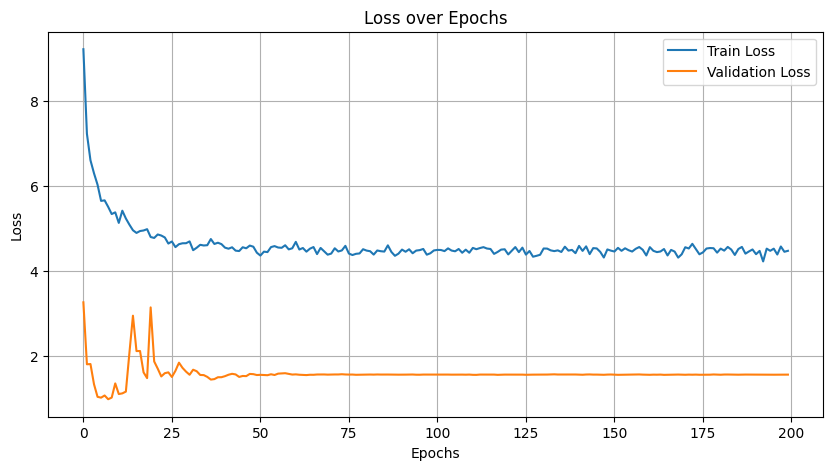

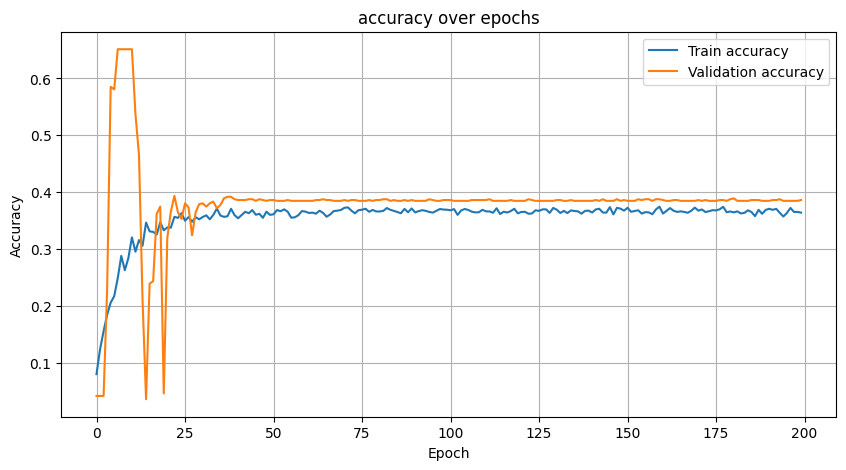

174/174 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.57186544 0.17495506 0.13143382 0.27076412 0.22360248]
Precision (per class): [0.74271845 0.6460177  0.07348407 0.16735113 0.13235294]
Recall (per class): [0.46491713 0.1011781  0.62173913 0.70869565 0.72      ]
Accuracy: 0.3881
AUC (One-vs-Rest): 0.7687

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.46      0.57      3620
           D       0.65      0.10      0.17      1443
           C       0.07      0.62      0.13       230
           B       0.17      0.71      0.27       230
           A       0.13      0.72      0.22        25

    accuracy                           0.39      5548
   macro avg       0.35      0.52      0.27      5548
weighted avg       0.66      0.39      0.44      5548



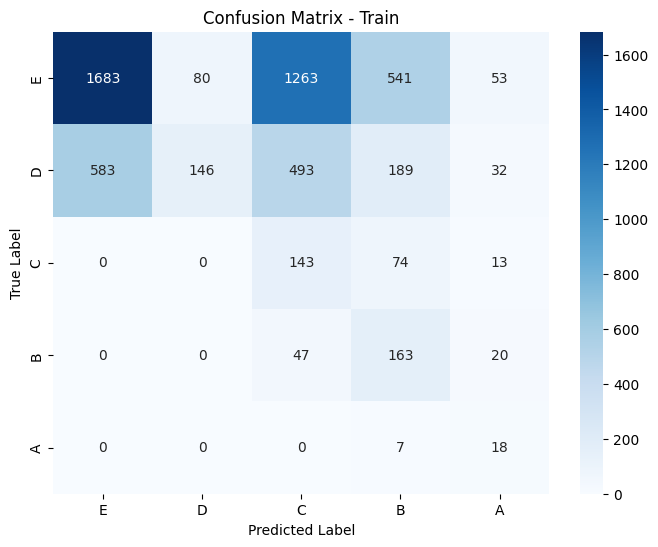

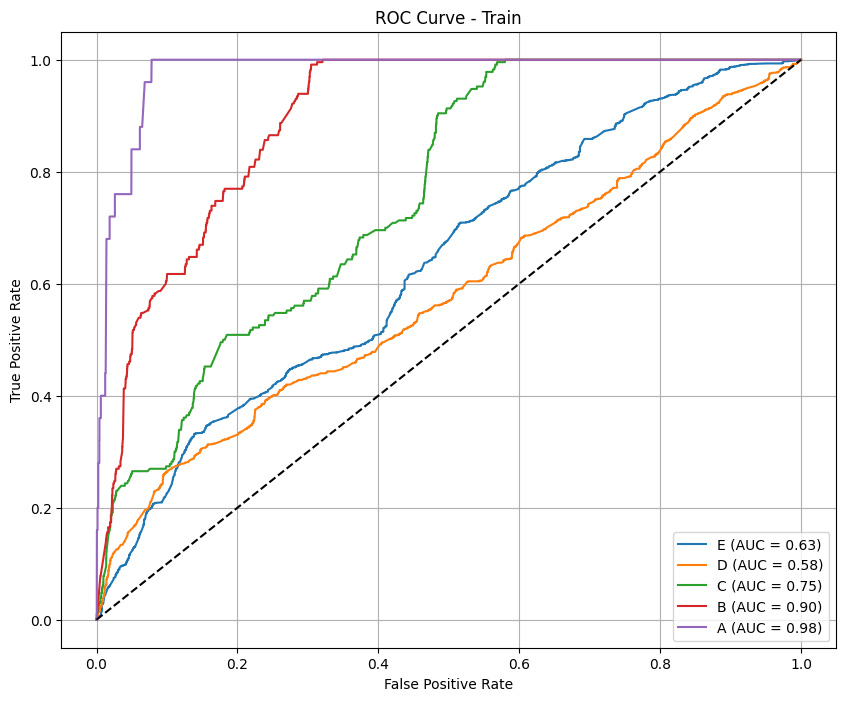

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.60425532 0.1        0.08135593 0.02777778 0.08      ]
Precision (per class): [0.85800604 0.11764706 0.04363636 0.01754386 0.06666667]
Recall (per class): [0.46633826 0.08695652 0.6        0.06666667 0.1       ]
Accuracy: 0.4102
AUC (One-vs-Rest): 0.6461

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.47      0.60       609
           D       0.12      0.09      0.10        92
           C       0.04      0.60      0.08        20
           B       0.02      0.07      0.03        15
           A       0.07      0.10      0.08        10

    accuracy                           0.41       746
   macro avg       0.22      0.26      0.18       746
weighted avg       0.72      0.41      0.51       746



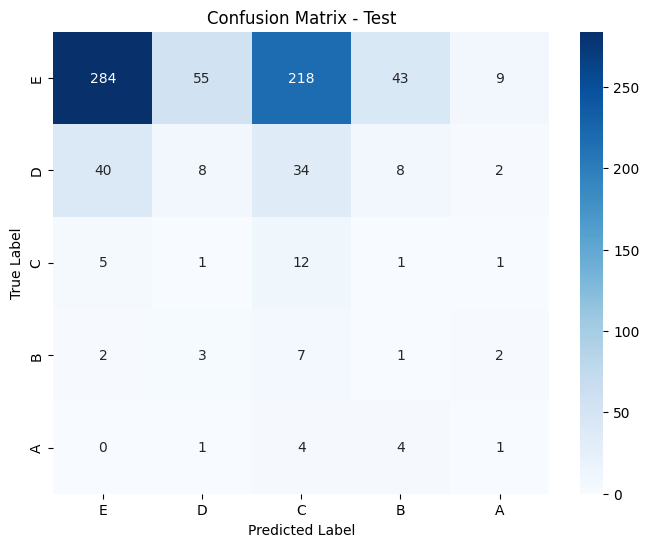

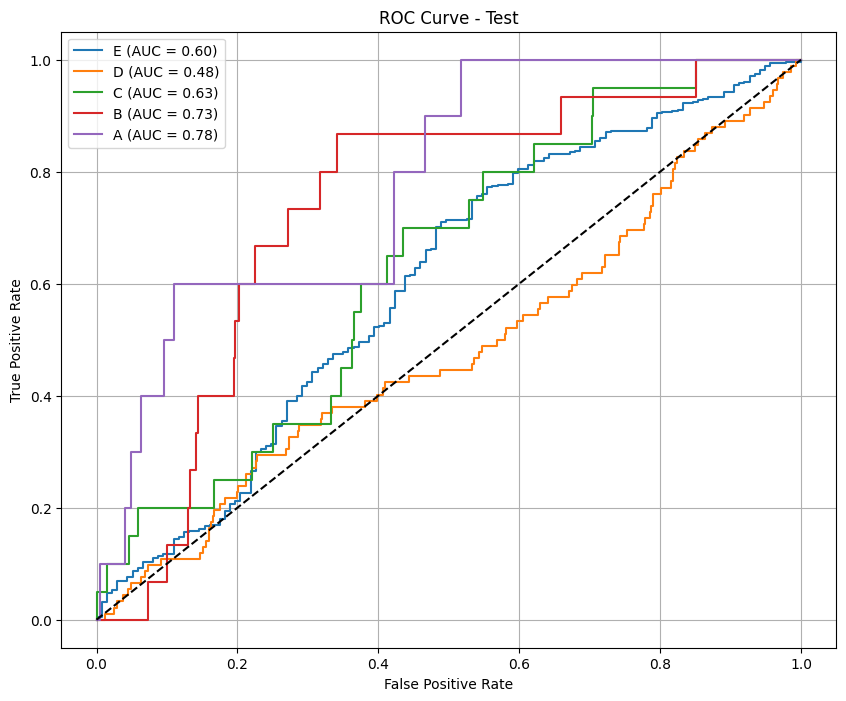

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_log.csv
174/174 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
[[0.47862485]
 [0.5213751 ]
 [0.4785794 ]
 [0.52142066]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862405]
 [0.52137595]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862414]
 [0.52137583]
 [0.47862485]
 [0.5213751 ]
 [0.4786239 ]
 [0.5213761 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47859195]
 [0.52140796]
 [0.47861743]
 [0.5213826 ]
 [0.47862485]
 [0.5213751 ]
 [0.4786166 ]
 [0.52138335]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.4786167 ]
 [0.5213833 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.4785526 ]
 [0.52144736]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47859868]
 [0.5214013 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862485]
 [0.5213751 ]
 [0.47862944]
 [0.5213706 ]
 [0.47862

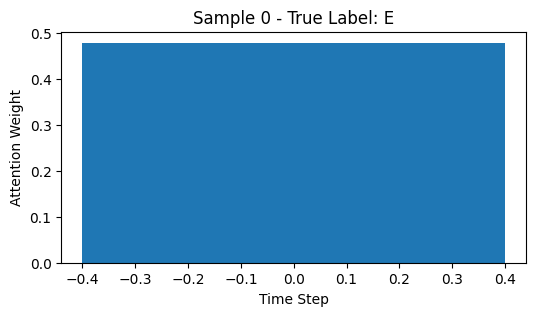

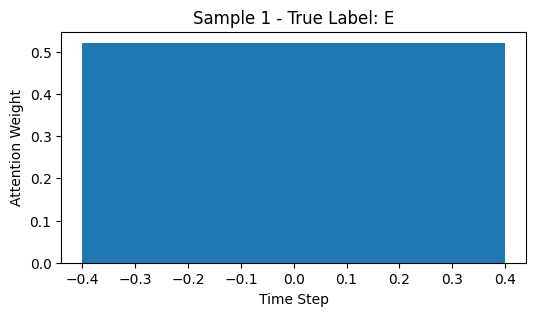

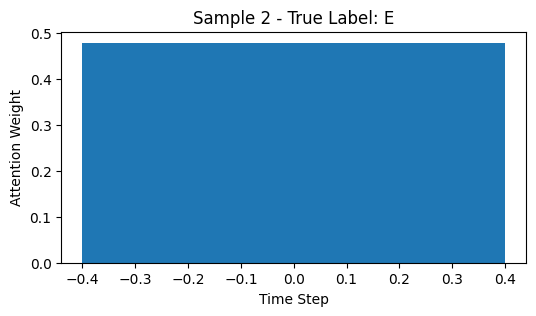

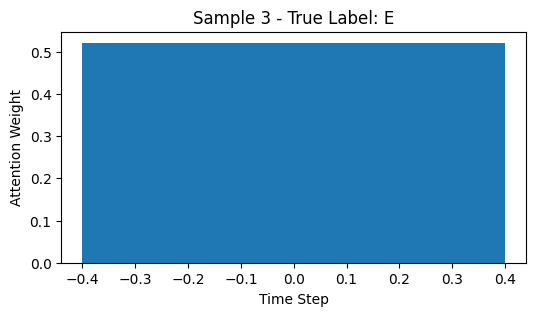

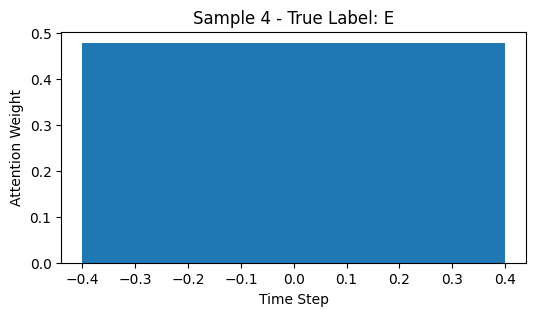

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_60"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_60          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_120 (Dropout)     │ (None, 3, 128)         │              0 │ bidirectional_60[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_61          │ (None, 3, 64)          │         41,216 │ dropout_120[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_61[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_61[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_181 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_60    │ (None, 64)             │            256 │ dense_181[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_180 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_122 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_6… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_121 (Dropout)     │ (None, 64)             │              0 │ dense_180[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_182 (Dense)         │ (None, 32)             │          2,080 │ dropout_122[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_30            │ (None, 96)             │              0 │ dropout_121[0][0],     │
│ (Concatenate)             │                        │                │ dense_182[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step

Epoch 1: val_f1_macro = 0.0020
66/66 ━━━━━━━━━━━━━━━━━━━━ 19s 71ms/step - accuracy: 0.1633 - loss: 11.7950 - val_accuracy: 0.0050 - val_loss: 4.1436 - val_f1_macro: 0.0020 - learning_rate: 0.0010
Epoch 2/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.0202
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2073 - loss: 8.3230 - val_accuracy: 0.0483 - val_loss: 2.4057 - val_f1_macro: 0.0202 - learning_rate: 0.0010
Epoch 3/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.0924
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2371 - loss: 6.5983 - val_accuracy: 0.1997 - val_loss: 1.8592 - val_f1_macro: 0.0924 - learning_rate: 0.0010
Epoch 4/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.1572
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2773 - loss: 6.0384 - val_accuracy: 0.4110 - val_loss: 1.4193 - val_f1_macro: 0.1572 - learning_rate: 0.0010
Epoch 5/200
1

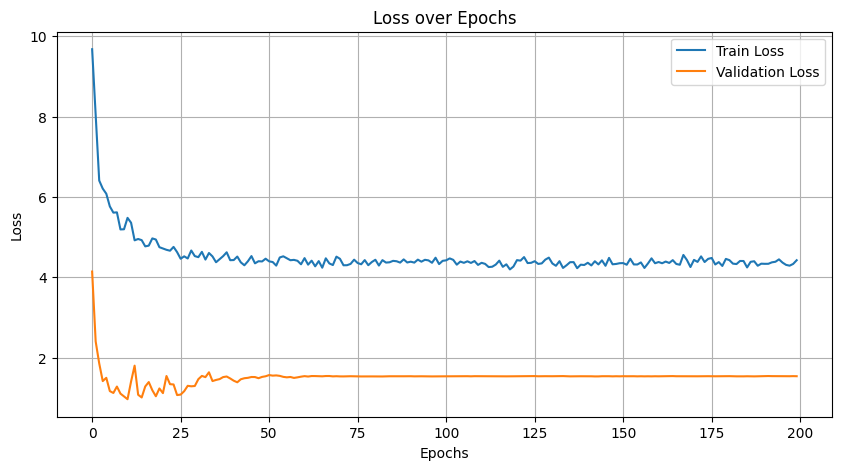

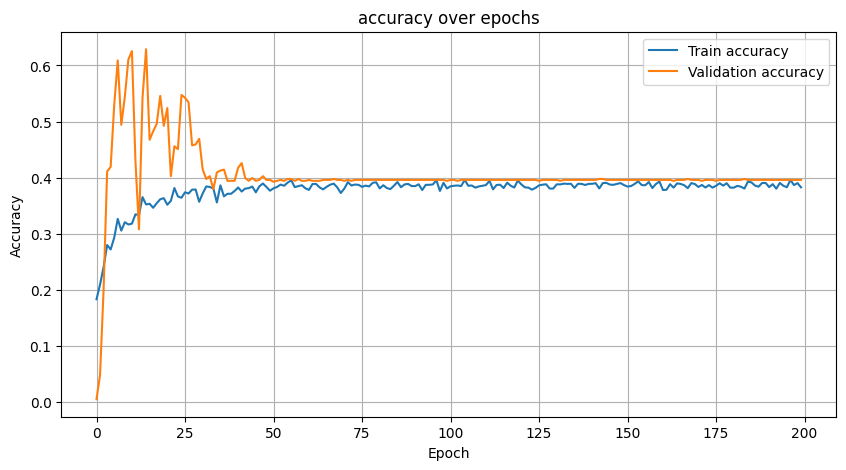

151/151 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.58519526 0.15543329 0.14853857 0.22027534 0.20168067]
Precision (per class): [0.74443895 0.58247423 0.08183738 0.14864865 0.12      ]
Recall (per class): [0.48207426 0.08968254 0.80310881 0.42512077 0.63157895]
Accuracy: 0.3902
AUC (One-vs-Rest): 0.7666

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.48      0.59      3124
           D       0.58      0.09      0.16      1260
           C       0.08      0.80      0.15       193
           B       0.15      0.43      0.22       207
           A       0.12      0.63      0.20        19

    accuracy                           0.39      4803
   macro avg       0.34      0.49      0.26      4803
weighted avg       0.65      0.39      0.44      4803



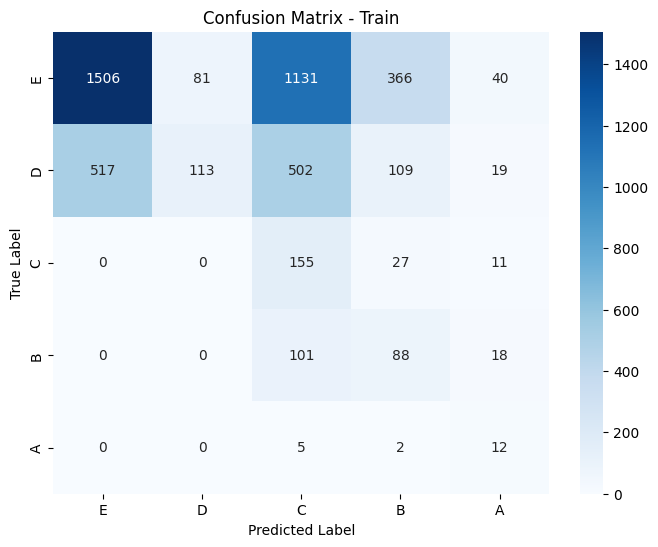

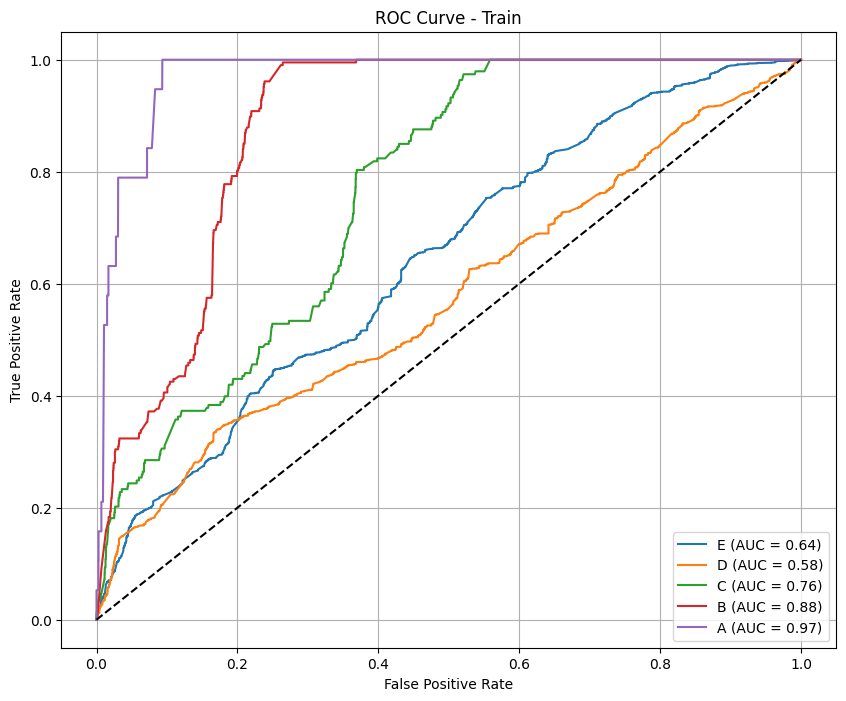

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.43969849 0.07633588 0.07207207 0.04651163 0.07142857]
Precision (per class): [0.84134615 0.11363636 0.03773585 0.03703704 0.05555556]
Recall (per class): [0.29761905 0.05747126 0.8        0.0625     0.1       ]
Accuracy: 0.2746
AUC (One-vs-Rest): 0.6421

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.30      0.44       588
           D       0.11      0.06      0.08        87
           C       0.04      0.80      0.07        20
           B       0.04      0.06      0.05        16
           A       0.06      0.10      0.07        10

    accuracy                           0.27       721
   macro avg       0.22      0.26      0.14       721
weighted avg       0.70      0.27      0.37       721



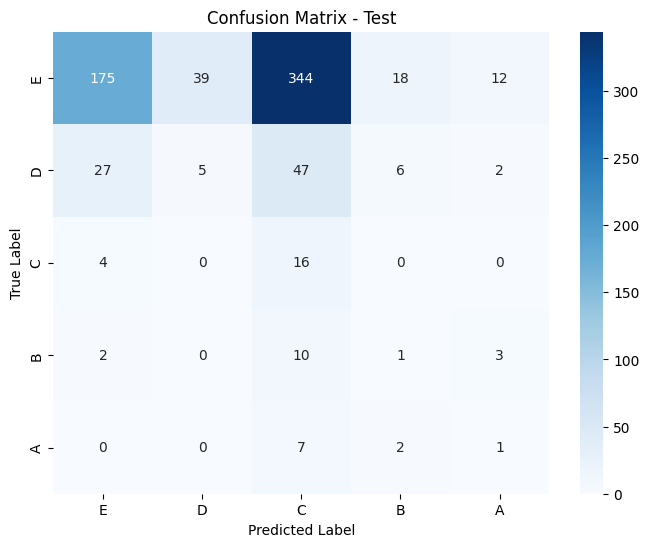

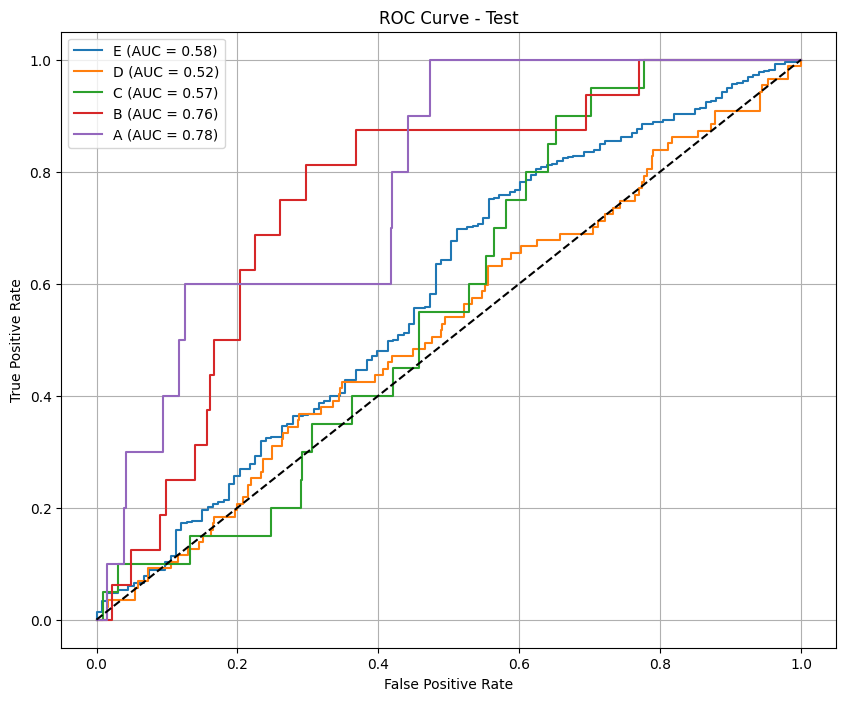

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_log.csv
151/151 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
[[0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.33252674]
 [0.33502963]
 [0.3324436 ]
 [0.33252695]
 [0.33502963]
 [0.3324434 ]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.33254588]
 [0.33498204]
 [0.33247212]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.33253506]
 [0.33502313]
 [0.3324418 ]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.3325381 ]
 [0.3350246 ]
 [0.33243722]
 [0.33253124]
 [0.33502772]
 [0.3324411 ]
 [0.33254567]
 [0.3350275 ]
 [0.3324

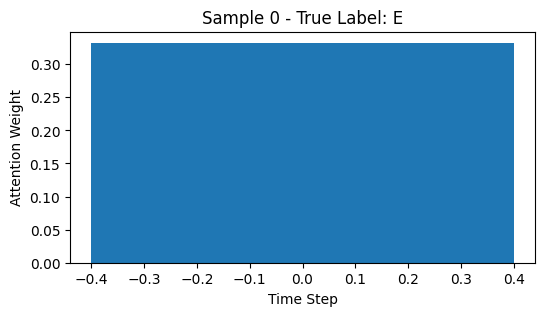

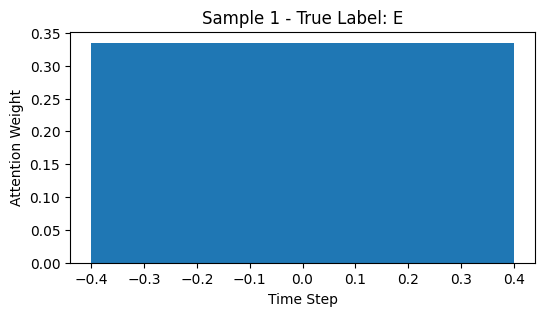

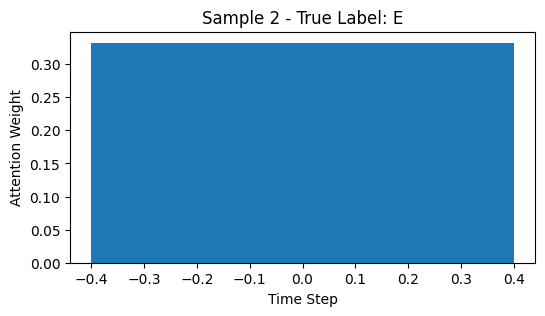

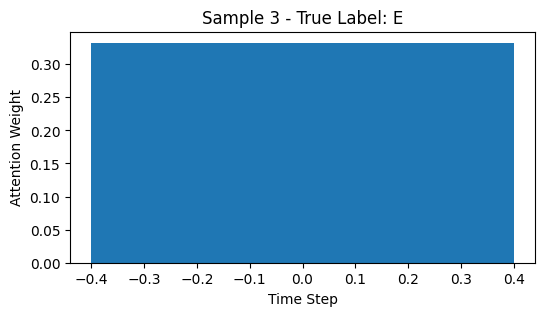

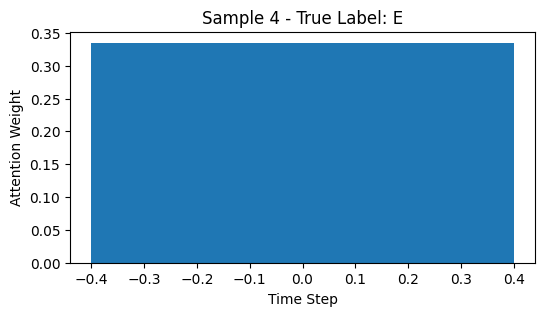

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_62"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_62          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_124 (Dropout)     │ (None, 4, 128)         │              0 │ bidirectional_62[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_63          │ (None, 4, 64)          │         41,216 │ dropout_124[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_63[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_63[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_187 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_62    │ (None, 64)             │            256 │ dense_187[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_186 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_126 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_6… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_125 (Dropout)     │ (None, 64)             │              0 │ dense_186[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_188 (Dense)         │ (None, 32)             │          2,080 │ dropout_126[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_31            │ (None, 96)             │              0 │ dropout_125[0][0],     │
│ (Concatenate)             │                        │                │ dense_188[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 3s 137ms/step

Epoch 1: val_f1_macro = 0.0743
33/33 ━━━━━━━━━━━━━━━━━━━━ 23s 281ms/step - accuracy: 0.3383 - loss: 15.9960 - val_accuracy: 0.1081 - val_loss: 3.8031 - val_f1_macro: 0.0743 - learning_rate: 0.0010
Epoch 2/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 

Epoch 2: val_f1_macro = 0.0168
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.2022 - loss: 9.8910 - val_accuracy: 0.0439 - val_loss: 3.1551 - val_f1_macro: 0.0168 - learning_rate: 0.0010
Epoch 3/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 

Epoch 3: val_f1_macro = 0.0168
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.1906 - loss: 8.3293 - val_accuracy: 0.0439 - val_loss: 3.0809 - val_f1_macro: 0.0168 - learning_rate: 0.0010
Epoch 4/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step 

Epoch 4: val_f1_macro = 0.0685
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.2262 - loss: 8.9468 - val_accuracy: 0.1385 - val_loss: 2.3723 - val_f1_macro: 0.0685 - learning_rate: 0.0010
Epoch 5/

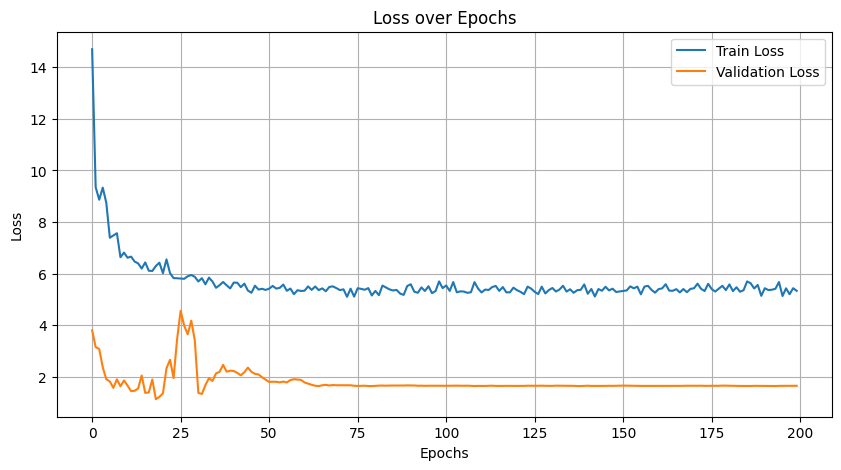

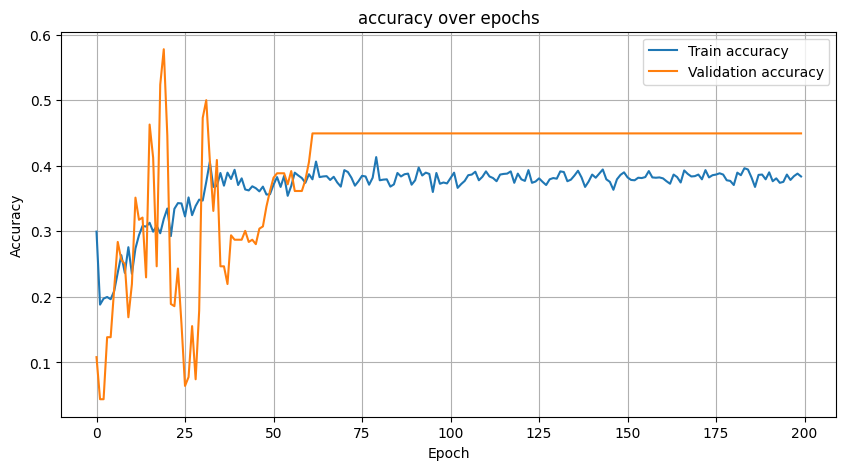

74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.63381859 0.00684932 0.11235955 0.43421053 0.2962963 ]
Precision (per class): [0.72440273 1.         0.06428571 0.29398664 0.2       ]
Recall (per class): [0.56337094 0.00343643 0.44554455 0.83018868 0.57142857]
Accuracy: 0.4384
AUC (One-vs-Rest): 0.7651

Classification Report:
              precision    recall  f1-score   support

           E       0.72      0.56      0.63      1507
           D       1.00      0.00      0.01       582
           C       0.06      0.45      0.11       101
           B       0.29      0.83      0.43       159
           A       0.20      0.57      0.30        14

    accuracy                           0.44      2363
   macro avg       0.46      0.48      0.30      2363
weighted avg       0.73      0.44      0.44      2363



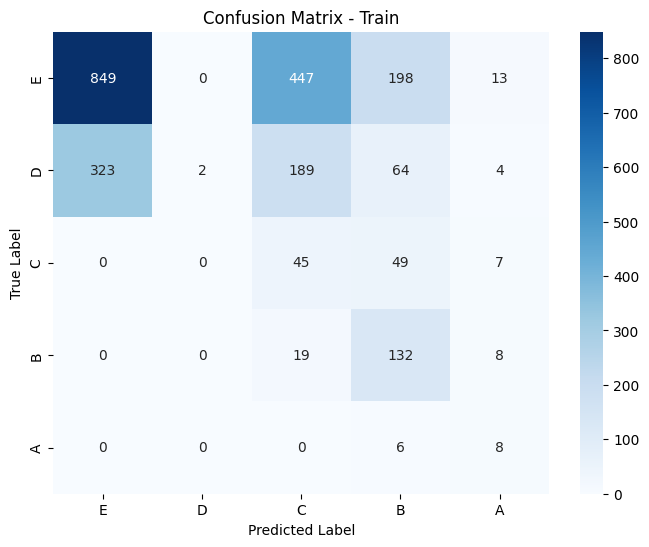

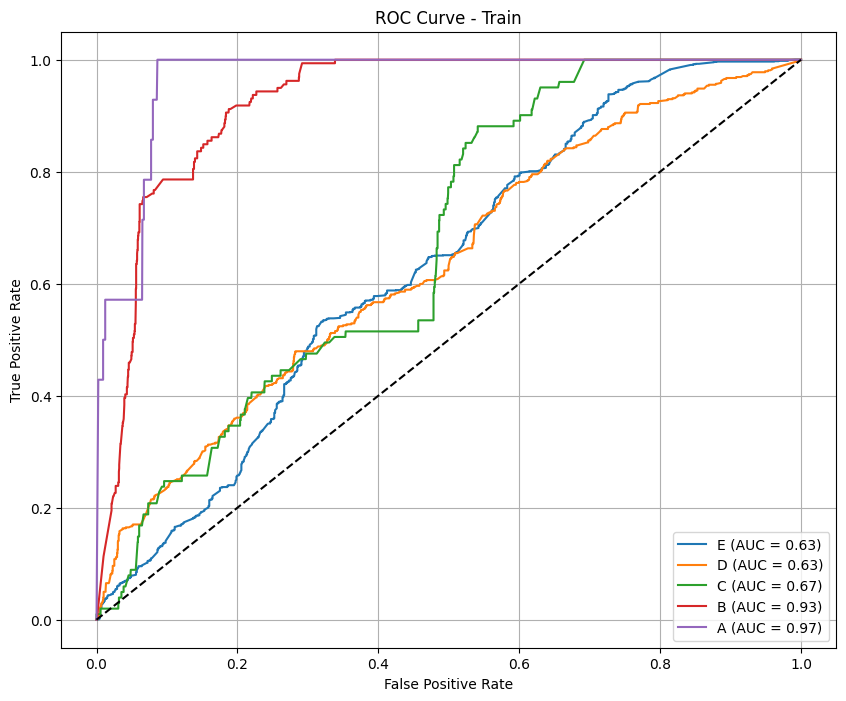

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.40927694 0.         0.05982906 0.03389831 0.14814815]
Precision (per class): [0.84269663 0.         0.03111111 0.02439024 0.125     ]
Recall (per class): [0.27027027 0.         0.77777778 0.05555556 0.18181818]
Accuracy: 0.2431
AUC (One-vs-Rest): 0.6166

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.27      0.41       555
           D       0.00      0.00      0.00        85
           C       0.03      0.78      0.06        18
           B       0.02      0.06      0.03        18
           A       0.12      0.18      0.15        11

    accuracy                           0.24       687
   macro avg       0.20      0.26      0.13       687
weighted avg       0.68      0.24      0.34       687



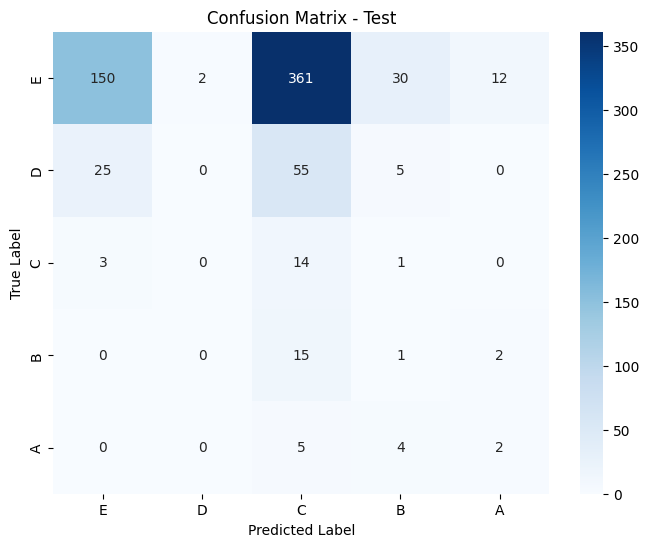

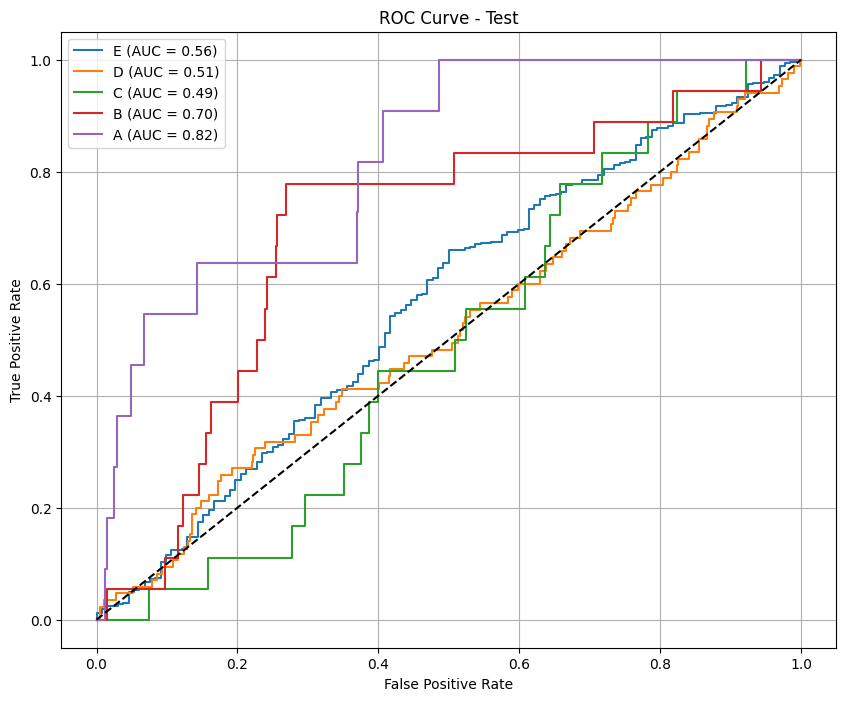

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_log.csv
74/74 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step
[[0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744885]
 [0.25015044]
 [0.25157705]
 [0.2508237 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24745242]
 [0.25014243]
 [0.25157887]
 [0.25082624]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744633]
 [0.25015807]
 [0.2516072 ]
 [0.25078833]
 [0.24745078]
 [0.25015187]
 [0.25157624]
 [0.2508211 ]
 [0.24744917]
 [0.25015056]
 [0.25157785]
 [0.2508224 ]
 [0.24744806]
 [0.25014952]
 [0.25157693]
 [0.2508255 ]
 [0.24744806]
 [0.25014952]
 [0.251576

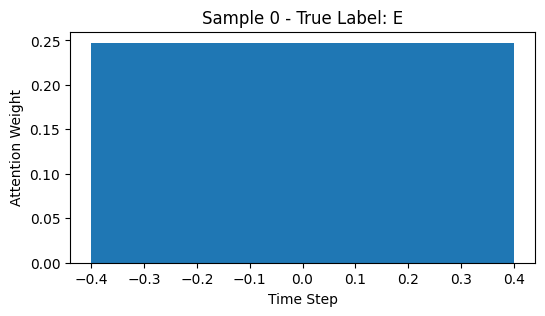

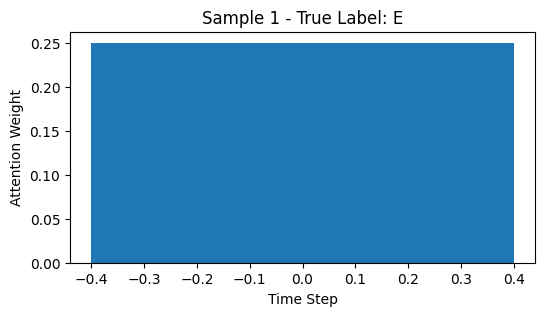

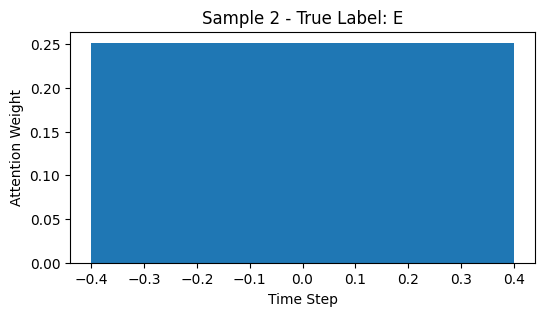

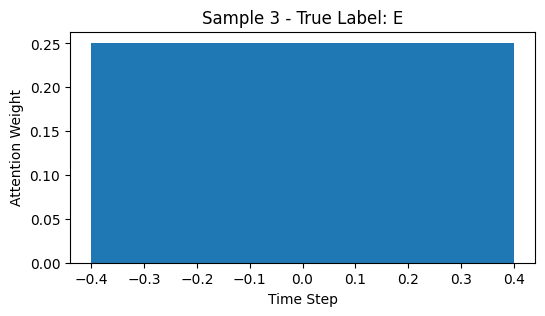

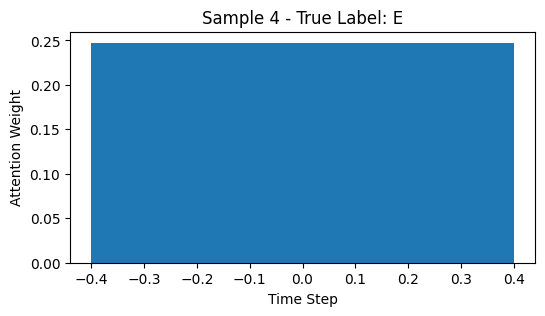

In [38]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, metric='f1_macro', scale='log') 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_64"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_64          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_128 (Dropout)     │ (None, 1, 128)         │              0 │ bidirectional_64[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_65          │ (None, 1, 64)          │         41,216 │ dropout_128[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_65[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_65[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_193 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_64    │ (None, 64)             │            256 │ dense_193[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_192 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_130 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_6… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_129 (Dropout)     │ (None, 64)             │              0 │ dense_192[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_194 (Dense)         │ (None, 32)             │          2,080 │ dropout_130[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_32            │ (None, 96)             │              0 │ dropout_129[0][0],     │
│ (Concatenate)             │                        │                │ dense_194[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


167/169 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.0948 - loss: 18.9604

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step

Epoch 1: val_f1_macro = 0.0372
169/169 ━━━━━━━━━━━━━━━━━━━━ 19s 30ms/step - accuracy: 0.0950 - loss: 18.8924 - val_accuracy: 0.1026 - val_loss: 2.3123 - val_f1_macro: 0.0372 - learning_rate: 0.0010
Epoch 2/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.0802
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.1246 - loss: 11.1771 - val_accuracy: 0.1656 - val_loss: 1.5246 - val_f1_macro: 0.0802 - learning_rate: 0.0010
Epoch 3/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.1808
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.1448 - loss: 10.4824 - val_accuracy: 0.5201 - val_loss: 1.2334 - val_f1_macro: 0.1808 - learning_rate: 0.0010
Epoch 4/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.1442
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.1879 - loss: 9.3239 - val_accuracy: 0.5630 - val_loss: 1.3700 - val_f1_macro: 0.1442 - learning_rate: 0.0010
Epoch 5/200
49/49

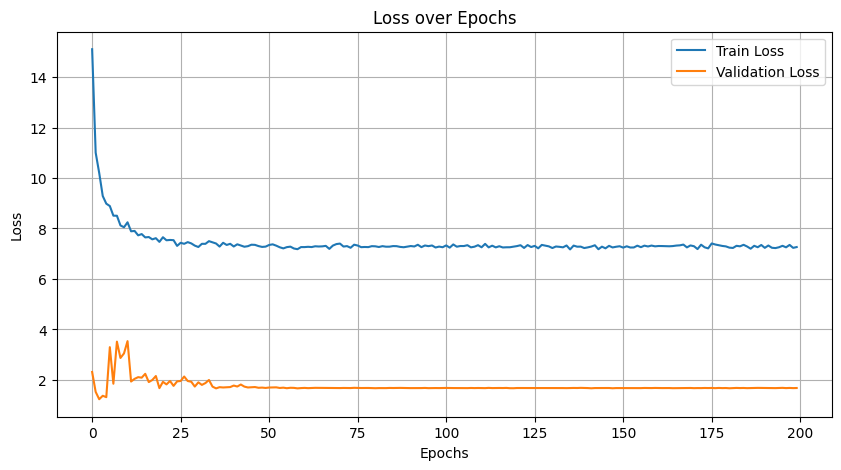

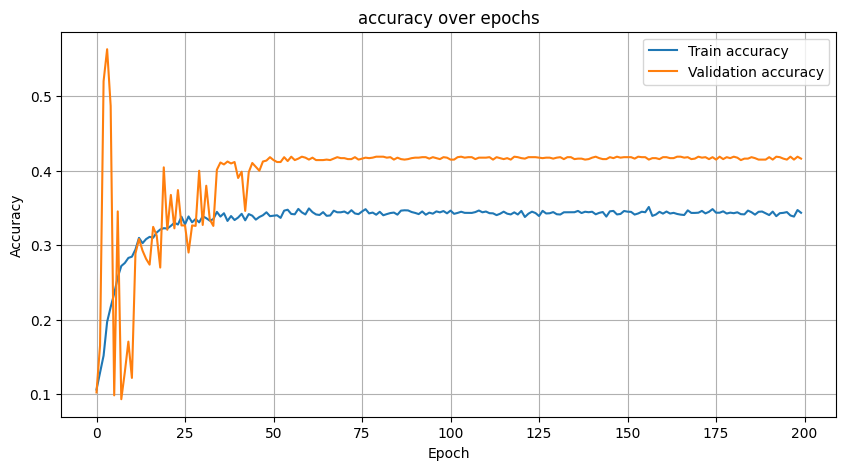

385/385 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.53987617 0.20958751 0.27971681 0.24094203 0.41635688]
Precision (per class): [0.75693185 0.71077505 0.1660522  0.37784091 0.28035044]
Recall (per class): [0.41956334 0.12291599 0.88661417 0.1768617  0.80866426]
Accuracy: 0.3880
AUC (One-vs-Rest): 0.7896

Classification Report:
              precision    recall  f1-score   support

           E       0.76      0.42      0.54      6962
           D       0.71      0.12      0.21      3059
           C       0.17      0.89      0.28      1270
           B       0.38      0.18      0.24       752
           A       0.28      0.81      0.42       277

    accuracy                           0.39     12320
   macro avg       0.46      0.48      0.34     12320
weighted avg       0.65      0.39      0.41     12320



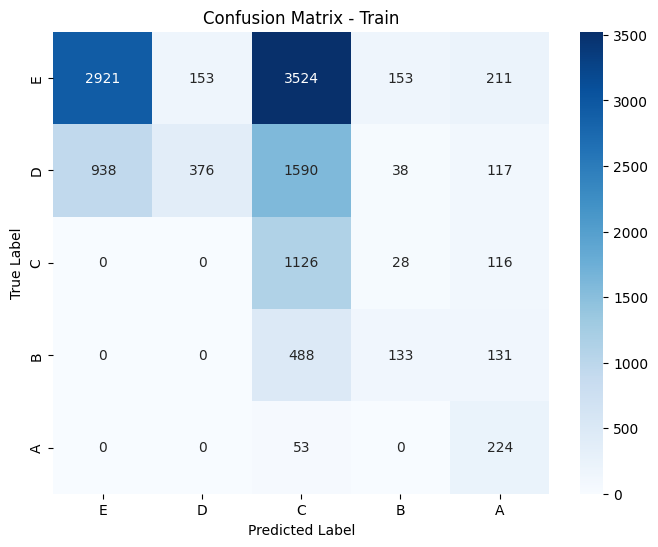

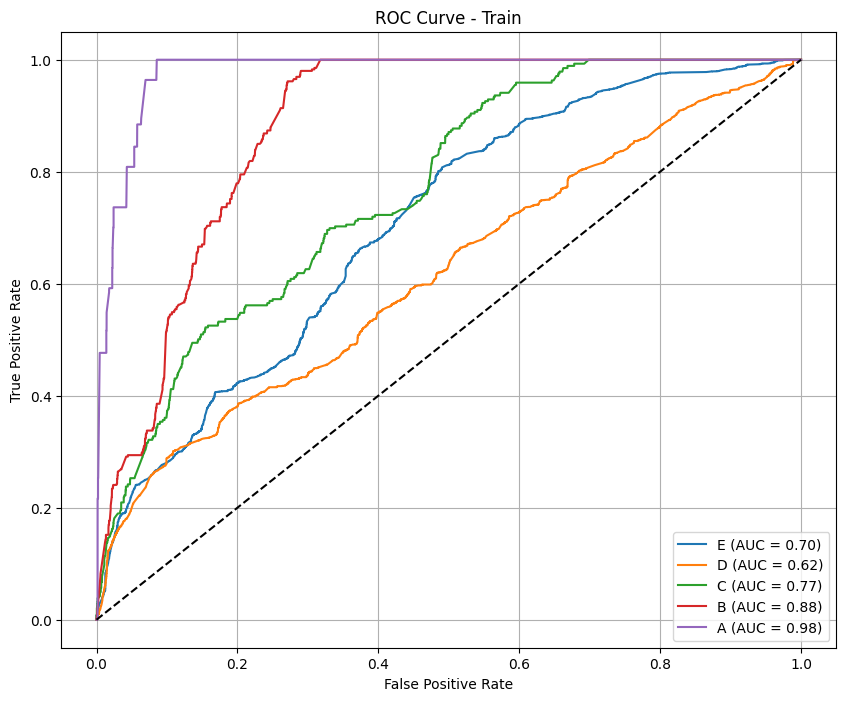

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.28724832 0.01709402 0.06030151 0.         0.12903226]
Precision (per class): [0.82945736 0.04347826 0.03119584 0.         0.0952381 ]
Recall (per class): [0.1737013 0.0106383 0.9       0.        0.2      ]
Accuracy: 0.1693
AUC (One-vs-Rest): 0.6322

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.17      0.29       616
           D       0.04      0.01      0.02        94
           C       0.03      0.90      0.06        20
           B       0.00      0.00      0.00        16
           A       0.10      0.20      0.13        10

    accuracy                           0.17       756
   macro avg       0.20      0.26      0.10       756
weighted avg       0.68      0.17      0.24       756



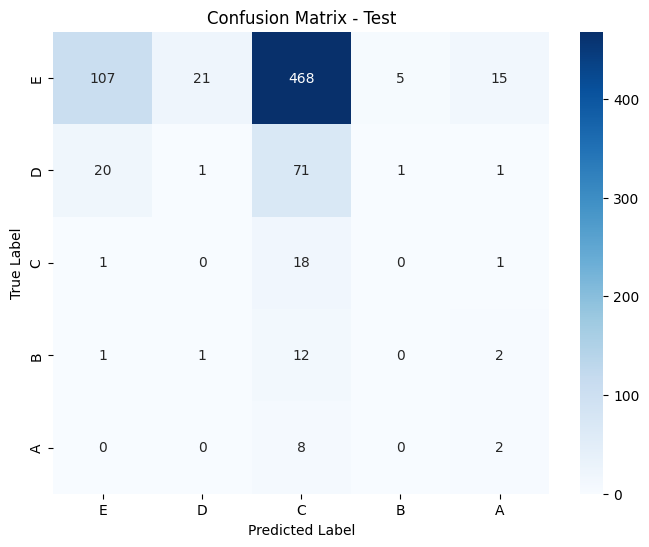

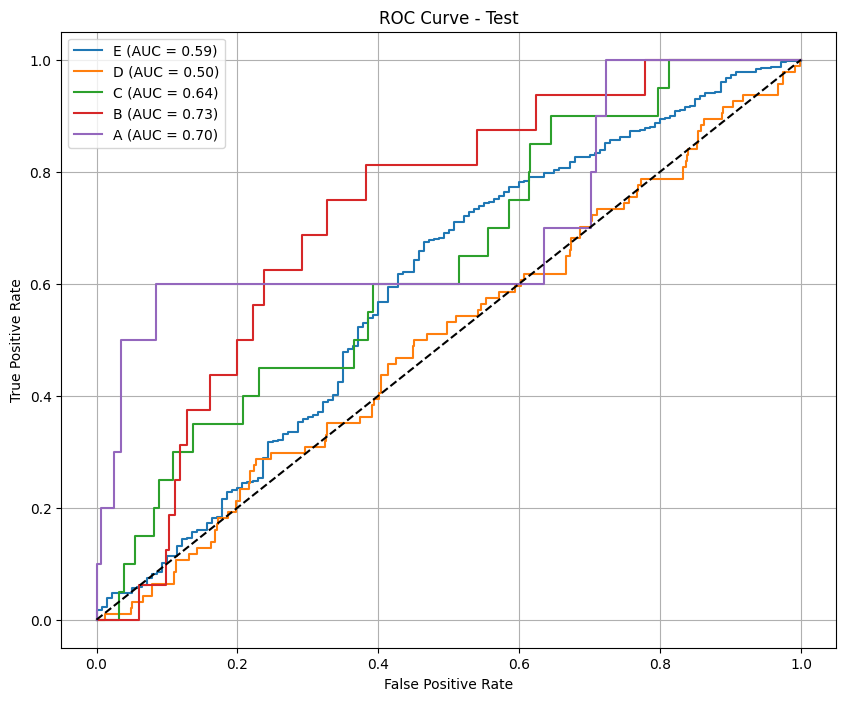

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_log.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


385/385 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

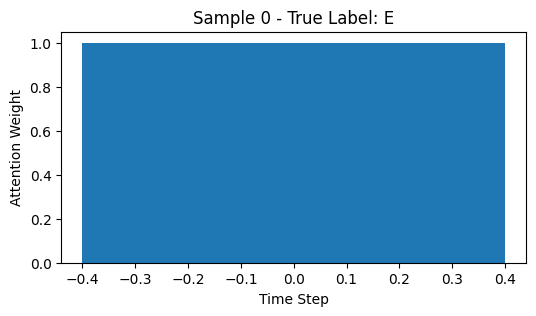

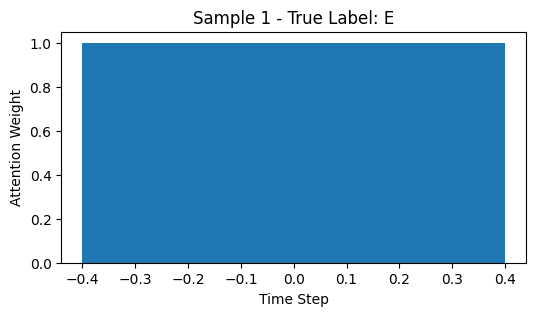

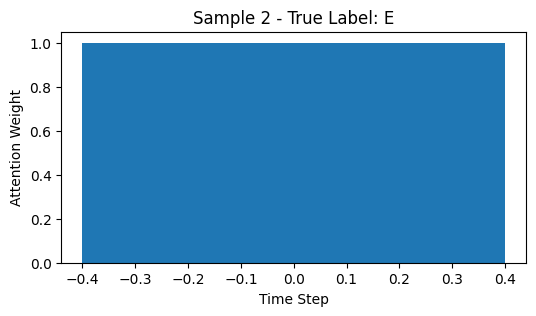

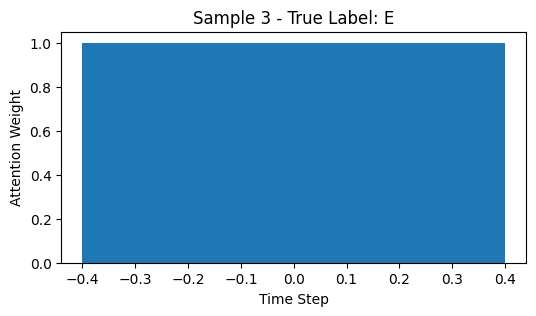

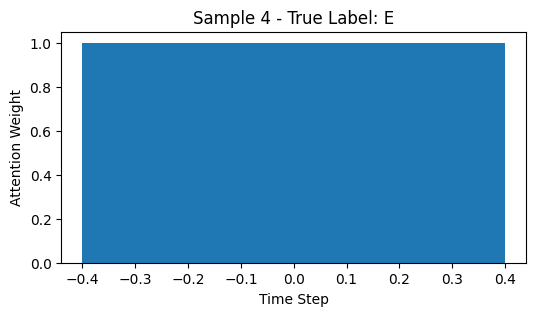

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_66"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_66          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_132 (Dropout)     │ (None, 2, 128)         │              0 │ bidirectional_66[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_67          │ (None, 2, 64)          │         41,216 │ dropout_132[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_67[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_67[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_199 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_66    │ (None, 64)             │            256 │ dense_199[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_198 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_134 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_6… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_133 (Dropout)     │ (None, 64)             │              0 │ dense_198[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_200 (Dense)         │ (None, 32)             │          2,080 │ dropout_134[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_33            │ (None, 96)             │              0 │ dropout_133[0][0],     │
│ (Concatenate)             │                        │                │ dense_200[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step

Epoch 1: val_f1_macro = 0.0427
141/141 ━━━━━━━━━━━━━━━━━━━━ 19s 39ms/step - accuracy: 0.1397 - loss: 18.0302 - val_accuracy: 0.1196 - val_loss: 3.3165 - val_f1_macro: 0.0427 - learning_rate: 0.0010
Epoch 2/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.0708
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.1527 - loss: 12.4490 - val_accuracy: 0.1584 - val_loss: 2.3125 - val_f1_macro: 0.0708 - learning_rate: 0.0010
Epoch 3/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.0439
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.1894 - loss: 11.2982 - val_accuracy: 0.1211 - val_loss: 2.6991 - val_f1_macro: 0.0439 - learning_rate: 0.0010
Epoch 4/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.0625
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.2162 - loss: 10.3152 - val_accuracy: 0.1460 - val_loss: 2.2327 - val_f1_macro: 0.0625 - learning_rate: 0.0010
Ep

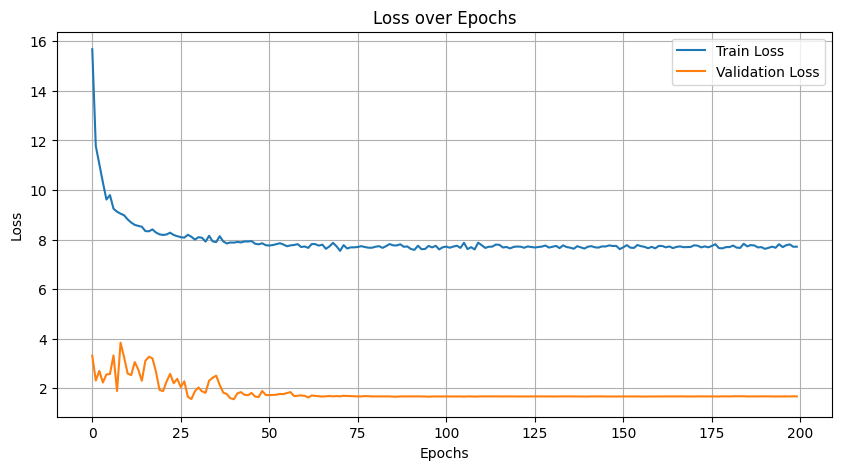

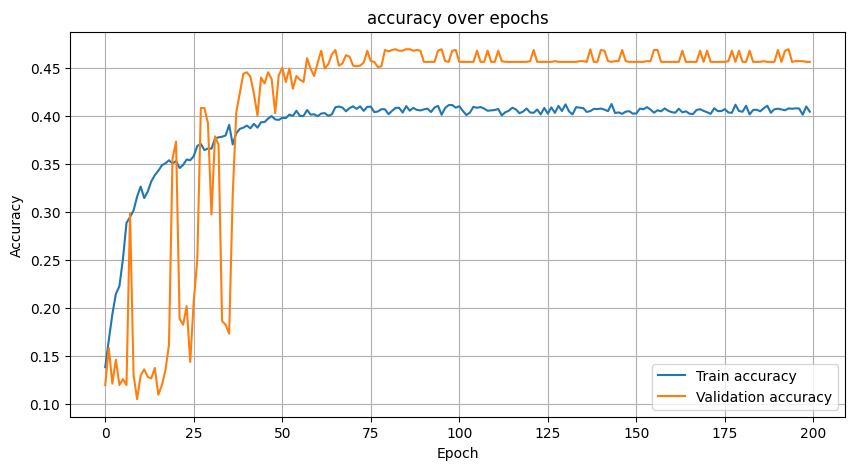

322/322 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.60706031 0.19916143 0.35458737 0.31046312 0.54927727]
Precision (per class): [0.74114931 0.68019093 0.22039929 0.41513761 0.43004115]
Recall (per class): [0.51405694 0.11665984 0.90650407 0.24794521 0.76      ]
Accuracy: 0.4544
AUC (One-vs-Rest): 0.8065

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.51      0.61      5620
           D       0.68      0.12      0.20      2443
           C       0.22      0.91      0.35      1230
           B       0.42      0.25      0.31       730
           A       0.43      0.76      0.55       275

    accuracy                           0.45     10298
   macro avg       0.50      0.51      0.40     10298
weighted avg       0.63      0.45      0.46     10298



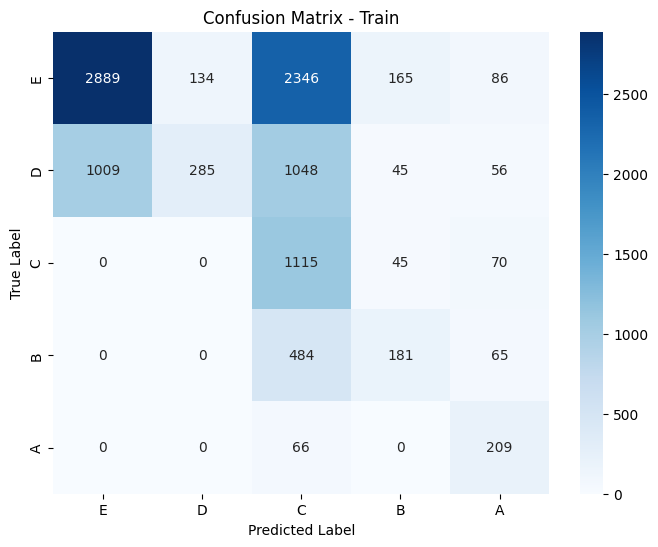

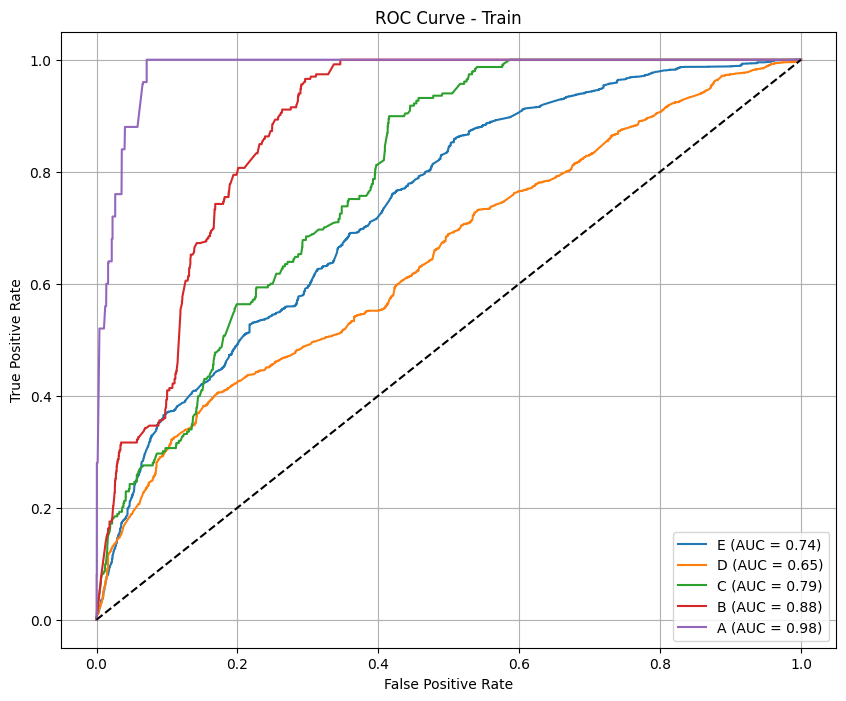

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.44768856 0.         0.05383023 0.03921569 0.15384615]
Precision (per class): [0.86384977 0.         0.02807775 0.02777778 0.10344828]
Recall (per class): [0.30213465 0.         0.65       0.06666667 0.3       ]
Accuracy: 0.2694
AUC (One-vs-Rest): 0.6159

Classification Report:
              precision    recall  f1-score   support

           E       0.86      0.30      0.45       609
           D       0.00      0.00      0.00        92
           C       0.03      0.65      0.05        20
           B       0.03      0.07      0.04        15
           A       0.10      0.30      0.15        10

    accuracy                           0.27       746
   macro avg       0.20      0.26      0.14       746
weighted avg       0.71      0.27      0.37       746



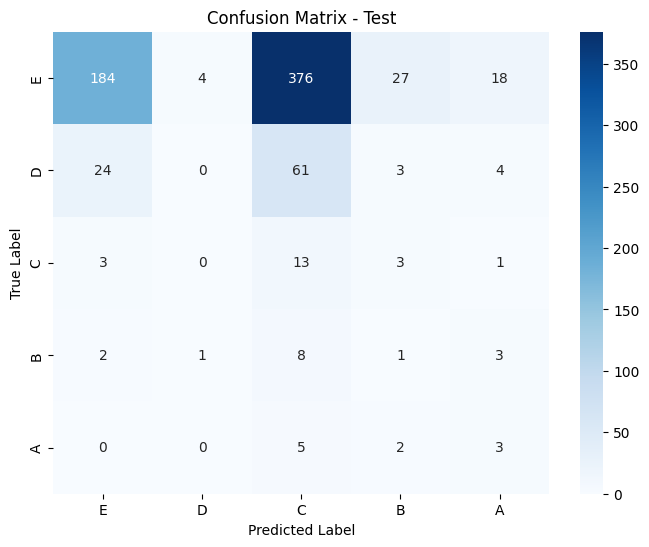

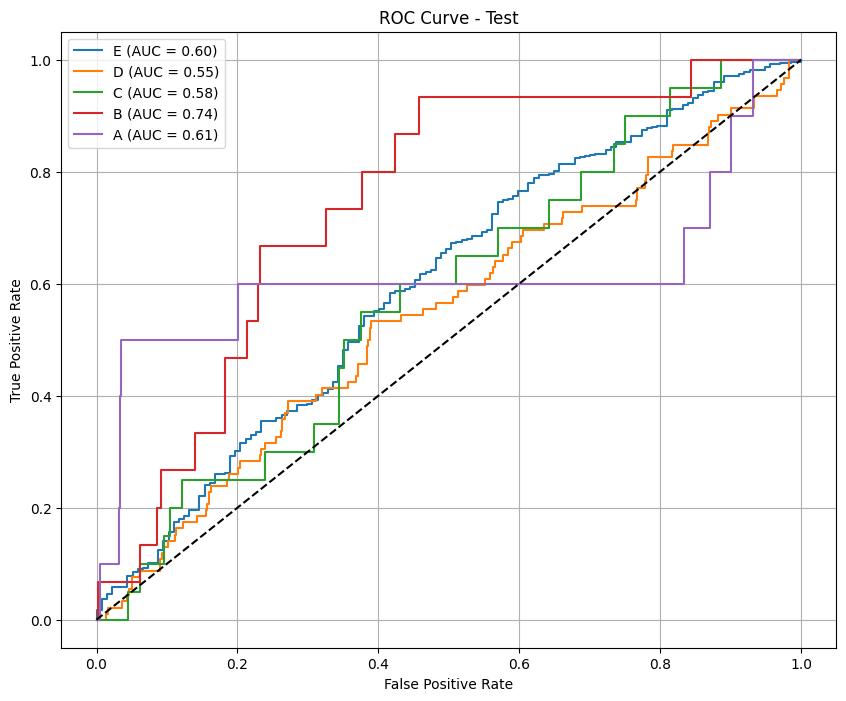

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_log.csv
322/322 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.49156767]
 [0.50843245]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.49159434]
 [0.5084056 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.49156335]
 [0.5084367 ]
 [0.49157092]
 [0.50842917]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.49157092]
 [0.50842917]
 [0.4915692 ]
 [0.5084307 ]
 [0.4915692 ]
 [0.5084307 ]
 [0.49156

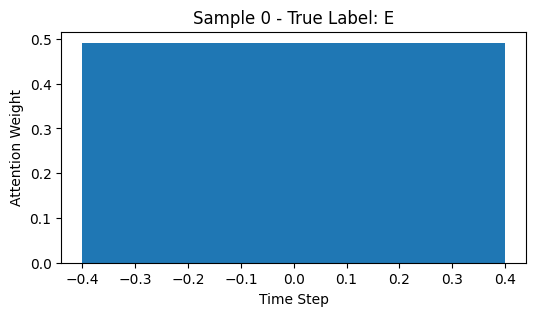

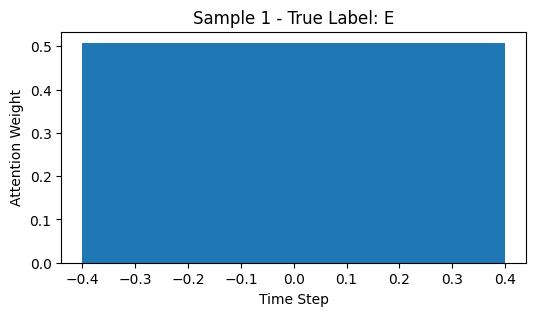

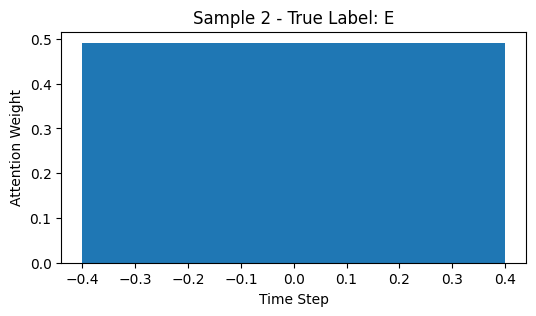

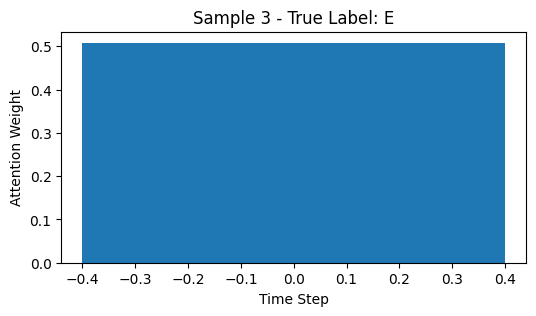

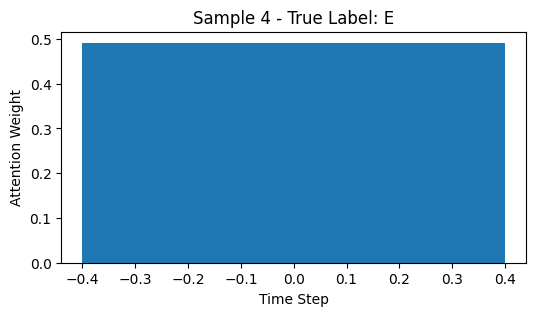

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_68"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_68          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_136 (Dropout)     │ (None, 3, 128)         │              0 │ bidirectional_68[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_69          │ (None, 3, 64)          │         41,216 │ dropout_136[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_69[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_69[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_205 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_68    │ (None, 64)             │            256 │ dense_205[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_204 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_138 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_6… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_137 (Dropout)     │ (None, 64)             │              0 │ dense_204[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_206 (Dense)         │ (None, 32)             │          2,080 │ dropout_138[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_34            │ (None, 96)             │              0 │ dropout_137[0][0],     │
│ (Concatenate)             │                        │                │ dense_206[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 2s 34ms/step

Epoch 1: val_f1_macro = 0.0274
131/131 ━━━━━━━━━━━━━━━━━━━━ 19s 40ms/step - accuracy: 0.1312 - loss: 34.1795 - val_accuracy: 0.0736 - val_loss: 3.6463 - val_f1_macro: 0.0274 - learning_rate: 0.0010
Epoch 2/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1189
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.1797 - loss: 13.0979 - val_accuracy: 0.2293 - val_loss: 2.3498 - val_f1_macro: 0.1189 - learning_rate: 0.0010
Epoch 3/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.1193
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.2305 - loss: 12.3009 - val_accuracy: 0.2176 - val_loss: 2.4224 - val_f1_macro: 0.1193 - learning_rate: 0.0010
Epoch 4/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.0446
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.2516 - loss: 11.1822 - val_accuracy: 0.1255 - val_loss: 2.4305 - val_f1_macro: 0.0446 - learning_rate: 0.0010
Ep

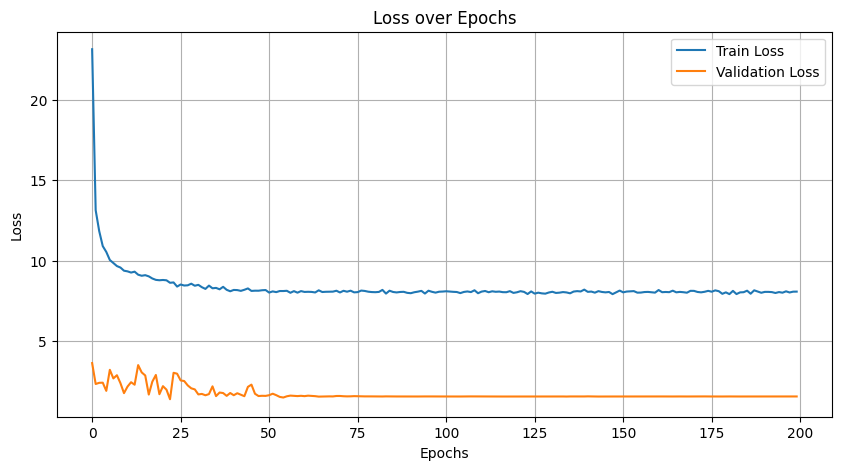

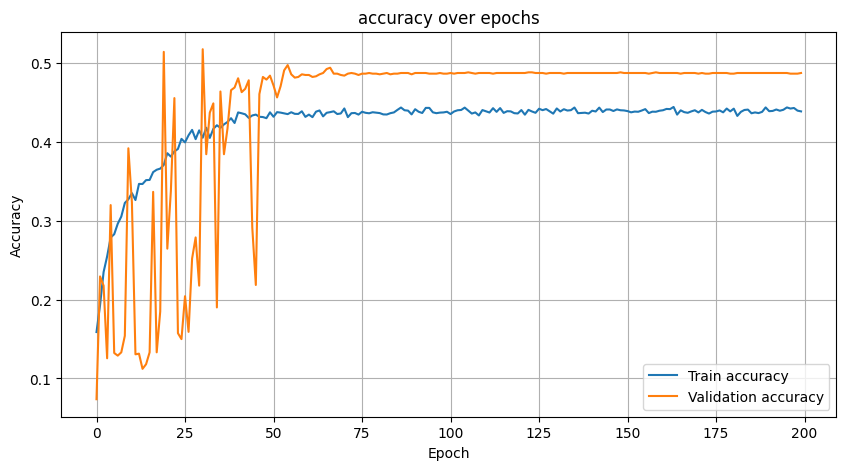

299/299 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.63722611 0.21114803 0.37723577 0.3555941  0.49590643]
Precision (per class): [0.75630027 0.63697105 0.24044219 0.45964126 0.36177474]
Recall (per class): [0.55054645 0.12654867 0.87510478 0.28995757 0.78810409]
Accuracy: 0.4782
AUC (One-vs-Rest): 0.8131

Classification Report:
              precision    recall  f1-score   support

           E       0.76      0.55      0.64      5124
           D       0.64      0.13      0.21      2260
           C       0.24      0.88      0.38      1193
           B       0.46      0.29      0.36       707
           A       0.36      0.79      0.50       269

    accuracy                           0.48      9553
   macro avg       0.49      0.53      0.42      9553
weighted avg       0.63      0.48      0.48      9553



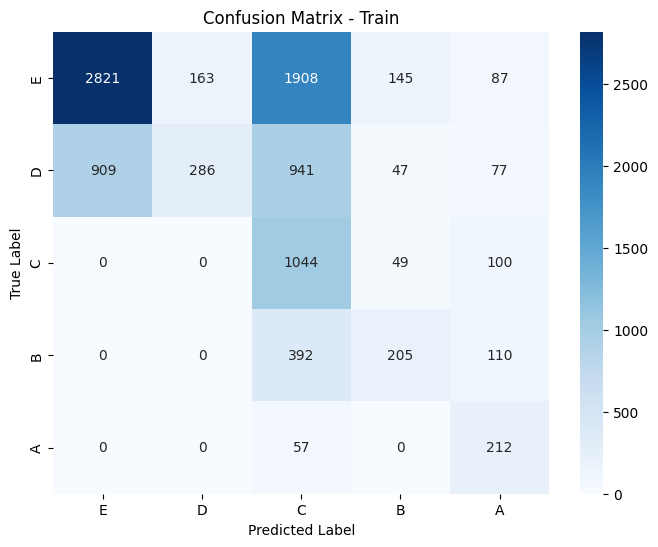

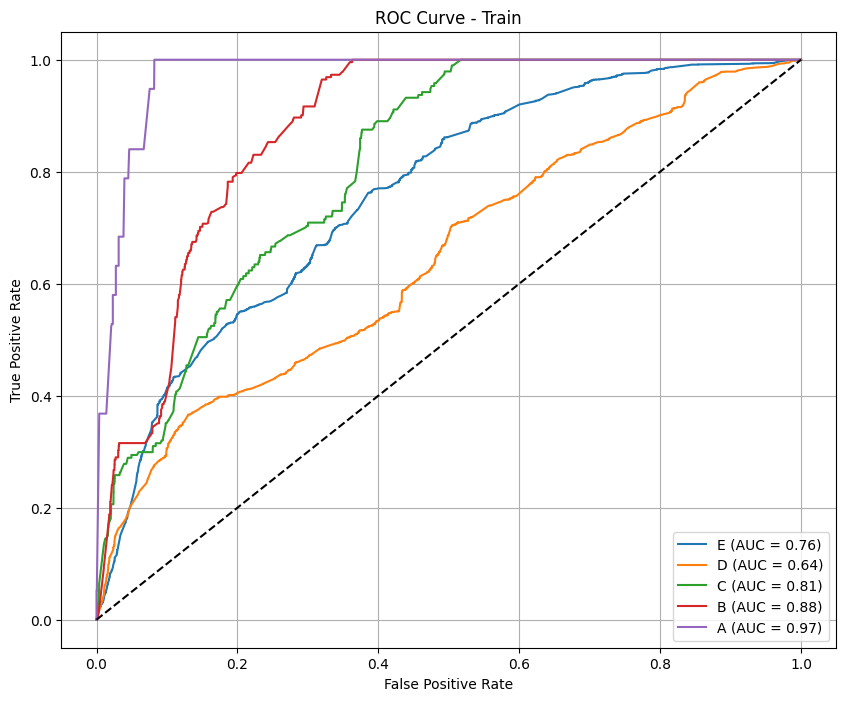

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.57403189 0.06451613 0.06896552 0.         0.13513514]
Precision (per class): [0.86896552 0.5        0.03641457 0.         0.078125  ]
Recall (per class): [0.42857143 0.03448276 0.65       0.         0.5       ]
Accuracy: 0.3786
AUC (One-vs-Rest): 0.6157

Classification Report:
              precision    recall  f1-score   support

           E       0.87      0.43      0.57       588
           D       0.50      0.03      0.06        87
           C       0.04      0.65      0.07        20
           B       0.00      0.00      0.00        16
           A       0.08      0.50      0.14        10

    accuracy                           0.38       721
   macro avg       0.30      0.32      0.17       721
weighted avg       0.77      0.38      0.48       721



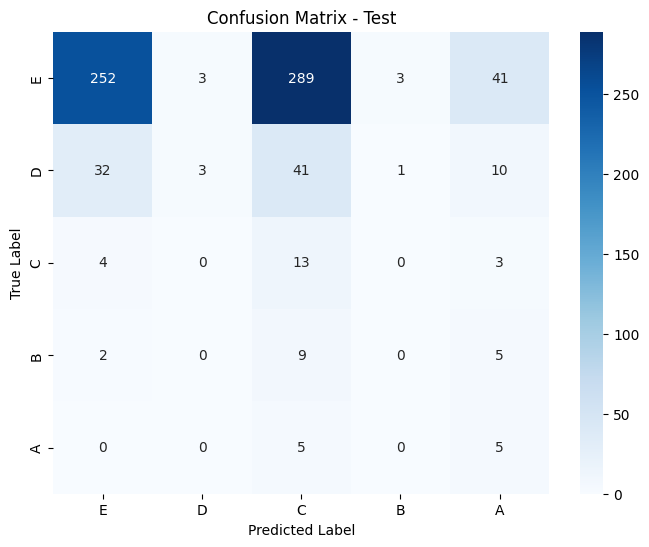

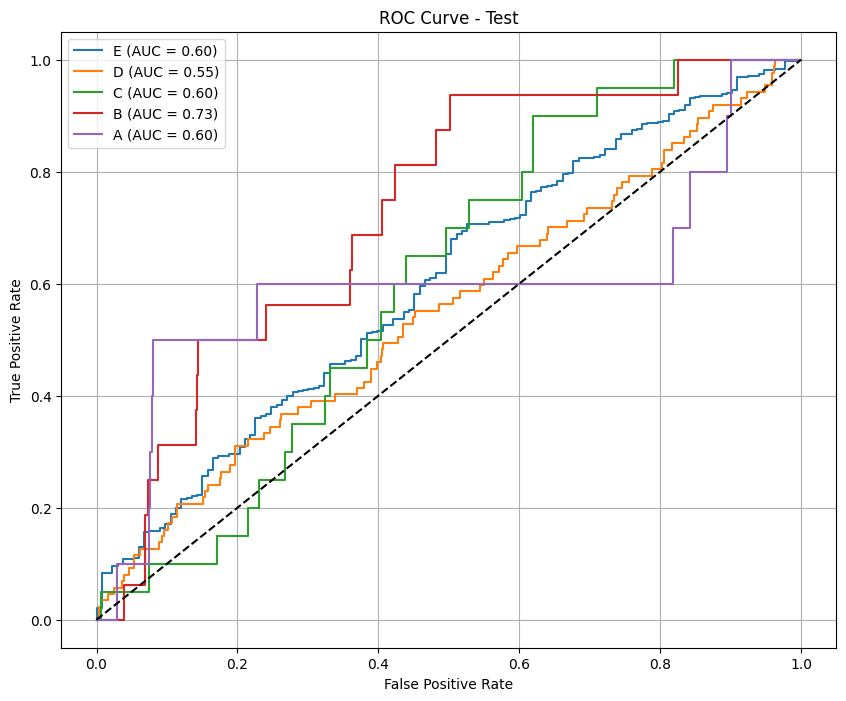

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_log.csv
299/299 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.36526582]
 [0.3461477 ]
 [0.2885865 ]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.3651694 ]
 [0.34614316]
 [0.28868738]
 [0.3651645 ]
 [0.34614724]
 [0.2886882 ]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516672]
 [0.34614798]
 [0.2886853 ]
 [0.36516532]
 [0.3461468 ]
 [0.28868786]
 [0.36516532]
 [0.3461468 ]
 [0.28868

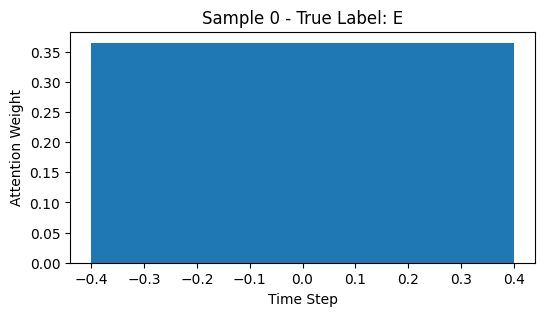

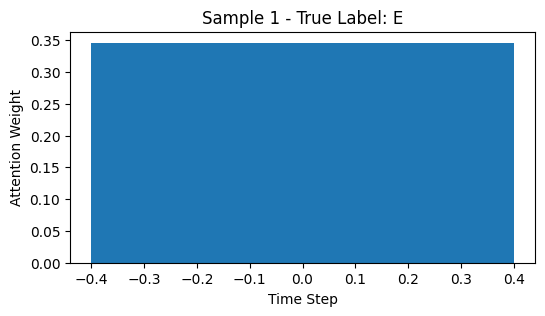

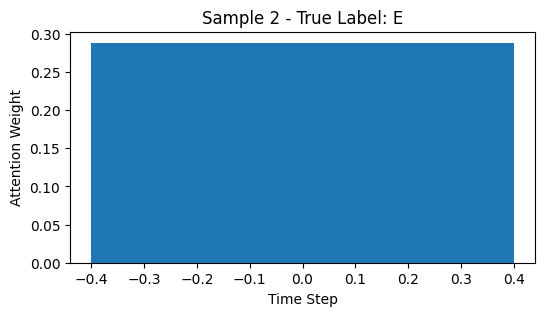

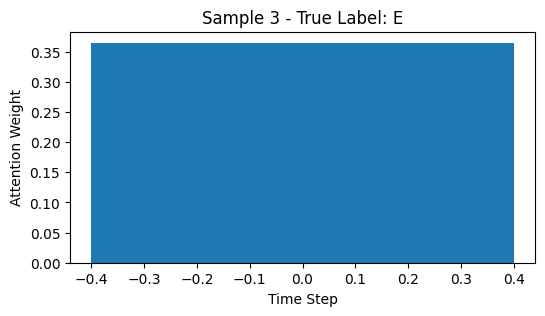

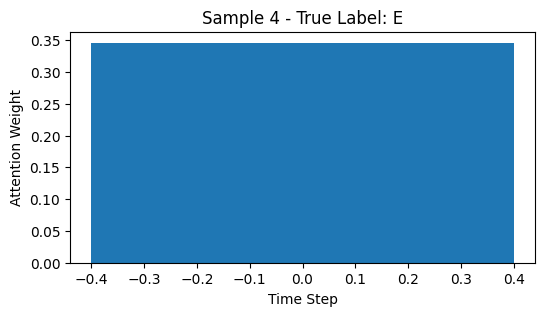

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_70"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_70          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_140 (Dropout)     │ (None, 4, 128)         │              0 │ bidirectional_70[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_71          │ (None, 4, 64)          │         41,216 │ dropout_140[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_71[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_71[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_211 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_70    │ (None, 64)             │            256 │ dense_211[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_210 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_142 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_7… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_141 (Dropout)     │ (None, 64)             │              0 │ dense_210[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_212 (Dense)         │ (None, 32)             │          2,080 │ dropout_142[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_35            │ (None, 96)             │              0 │ dropout_141[0][0],     │
│ (Concatenate)             │                        │                │ dense_212[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 46ms/step

Epoch 1: val_f1_macro = 0.0537
98/98 ━━━━━━━━━━━━━━━━━━━━ 19s 52ms/step - accuracy: 0.1433 - loss: 22.8625 - val_accuracy: 0.1551 - val_loss: 6.2029 - val_f1_macro: 0.0537 - learning_rate: 0.0010
Epoch 2/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.0537
98/98 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.1786 - loss: 17.0978 - val_accuracy: 0.1551 - val_loss: 4.1167 - val_f1_macro: 0.0537 - learning_rate: 0.0010
Epoch 3/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.0537
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.2119 - loss: 14.7768 - val_accuracy: 0.1551 - val_loss: 2.7555 - val_f1_macro: 0.0537 - learning_rate: 0.0010
Epoch 4/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.1034
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.2204 - loss: 14.0887 - val_accuracy: 0.2213 - val_loss: 2.1709 - val_f1_macro: 0.1034 - learning_rate: 0.0010
Epoch 5/20

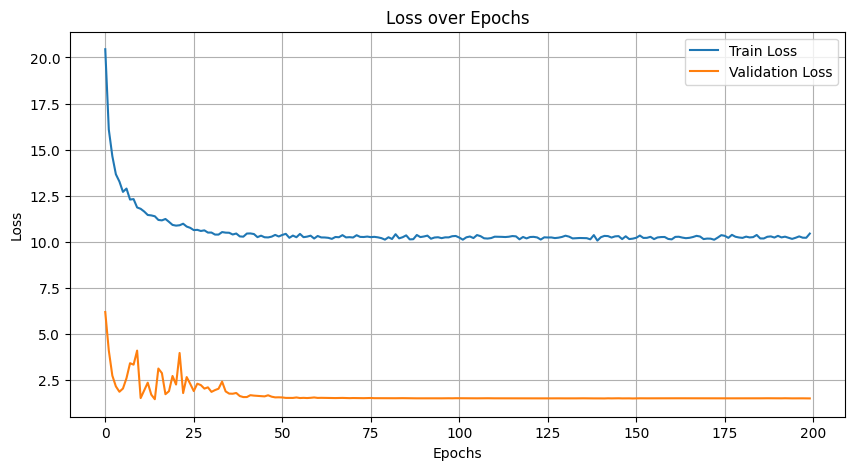

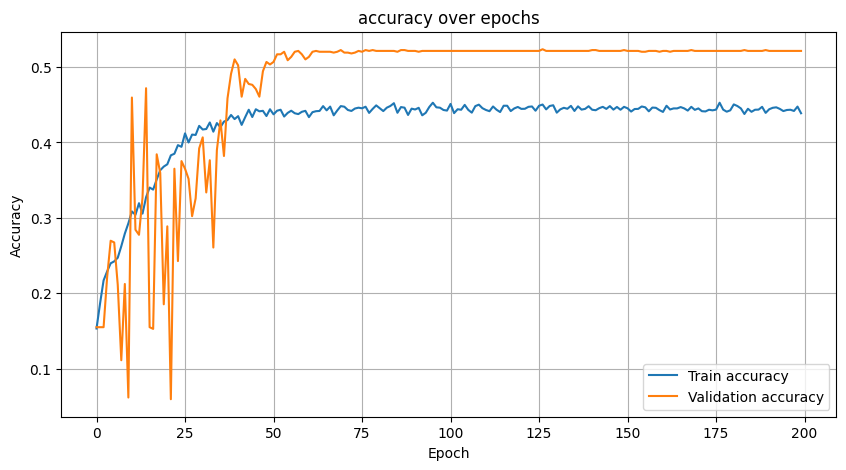

223/223 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.62551713 0.31980676 0.43298019 0.41086587 0.50590219]
Precision (per class): [0.74526814 0.67827869 0.29003394 0.46628131 0.45592705]
Recall (per class): [0.53892216 0.20922882 0.8537693  0.36722307 0.56818182]
Accuracy: 0.4995
AUC (One-vs-Rest): 0.8270

Classification Report:
              precision    recall  f1-score   support

           E       0.75      0.54      0.63      3507
           D       0.68      0.21      0.32      1582
           C       0.29      0.85      0.43      1101
           B       0.47      0.37      0.41       659
           A       0.46      0.57      0.51       264

    accuracy                           0.50      7113
   macro avg       0.53      0.51      0.46      7113
weighted avg       0.62      0.50      0.50      7113



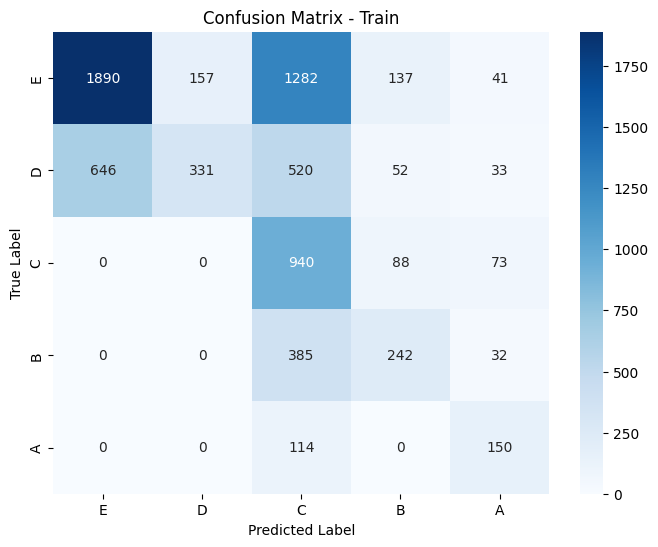

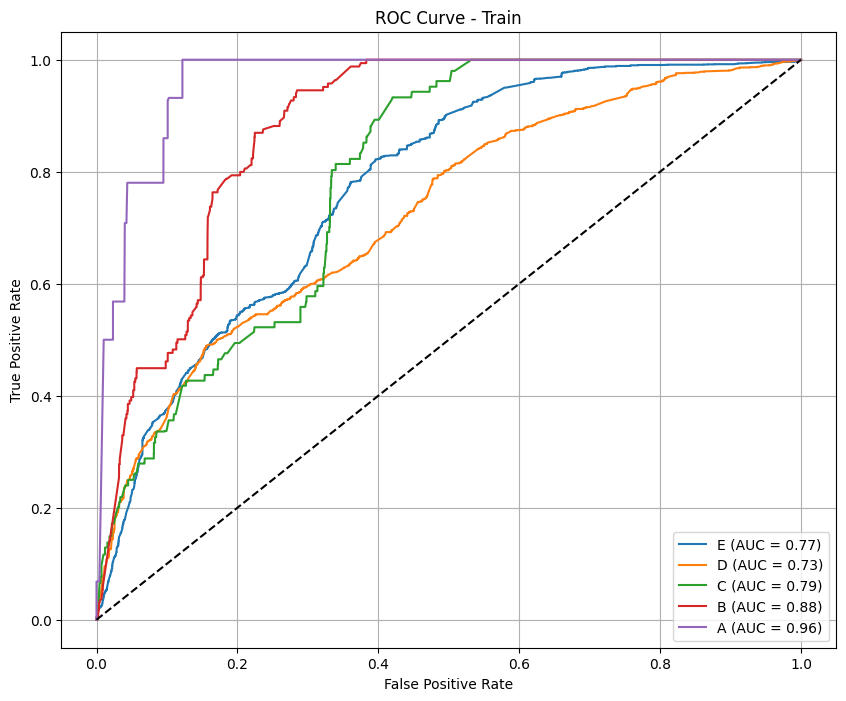

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.26946108 0.         0.04502814 0.         0.07692308]
Precision (per class): [0.79646018 0.         0.02330097 0.         0.04878049]
Recall (per class): [0.16216216 0.         0.66666667 0.         0.18181818]
Accuracy: 0.1514
AUC (One-vs-Rest): 0.5711

Classification Report:
              precision    recall  f1-score   support

           E       0.80      0.16      0.27       555
           D       0.00      0.00      0.00        85
           C       0.02      0.67      0.05        18
           B       0.00      0.00      0.00        18
           A       0.05      0.18      0.08        11

    accuracy                           0.15       687
   macro avg       0.17      0.20      0.08       687
weighted avg       0.64      0.15      0.22       687



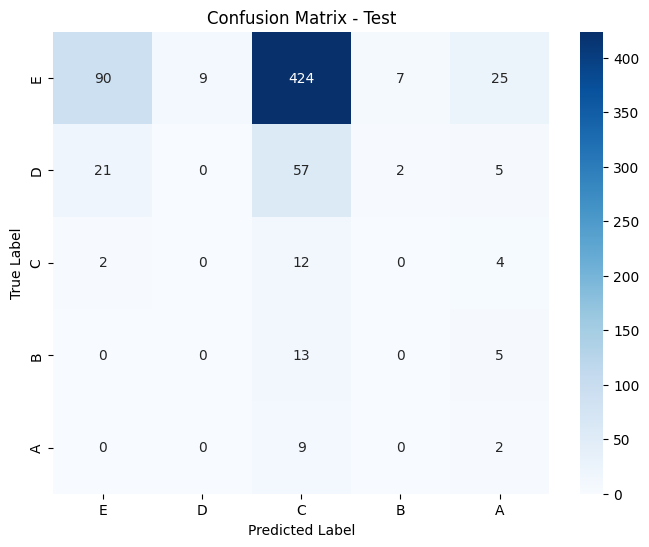

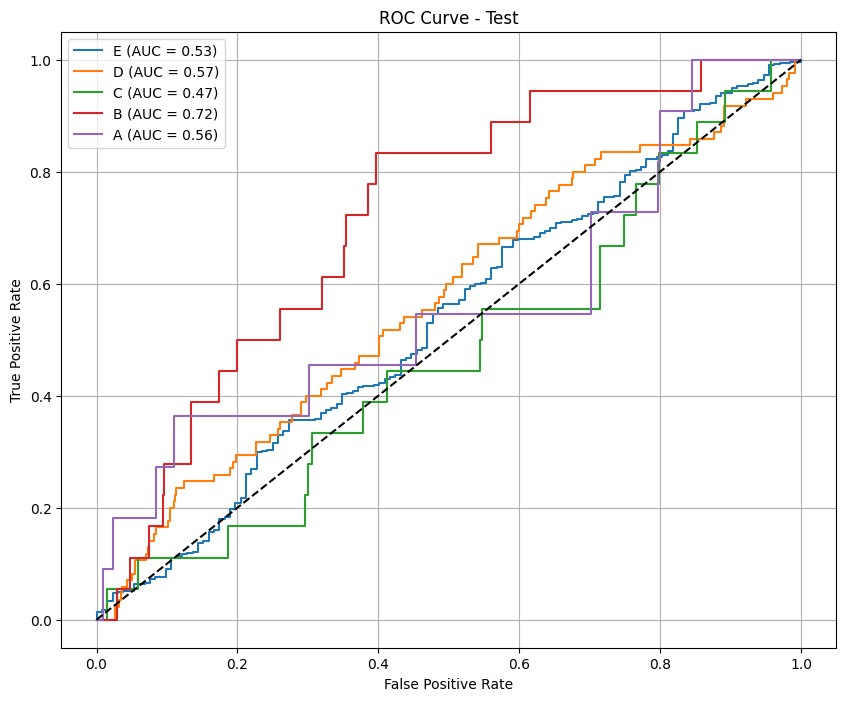

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_log.csv
223/223 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
[[0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.2459724 ]
 [0.25110438]
 [0.2521357 ]
 [0.25078753]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.2459776 ]
 [0.2511096 ]
 [0.25213876]
 [0.250774  ]
 [0.2459669 ]
 [0.25109878]
 [0.2521328 ]
 [0.2508015 ]
 [0.24596691]
 [0.25109902]
 [0.2521327 ]
 [0.2508014 ]
 [0.2460056 ]
 [0.25113723]
 [0.25212327]
 [0.2507339 ]
 [0.24596697]
 [0.25109908]
 [0.2521325 ]
 [0.2508015 ]
 [0.24596691]
 [0.25109902]
 [0.25213

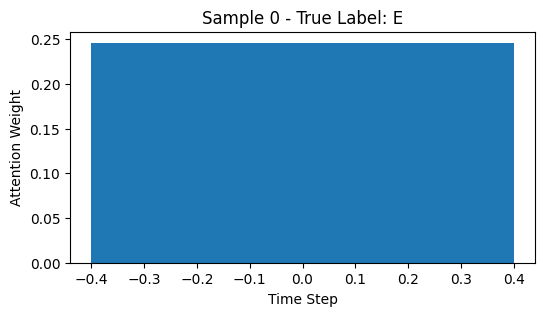

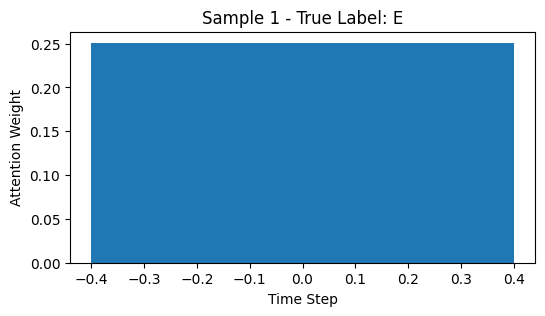

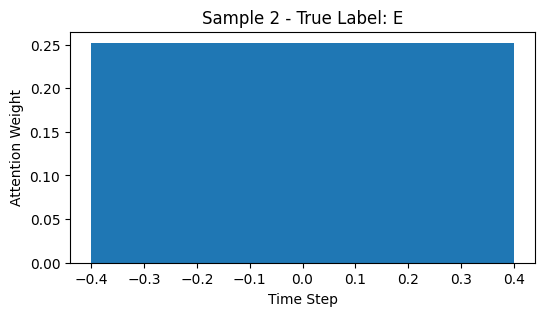

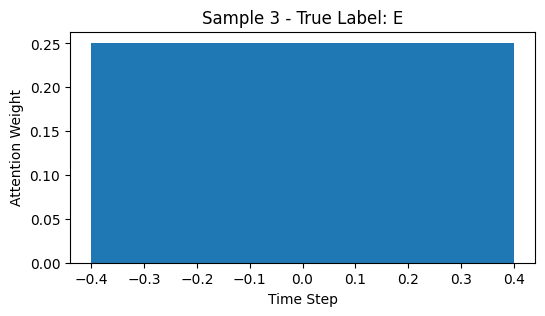

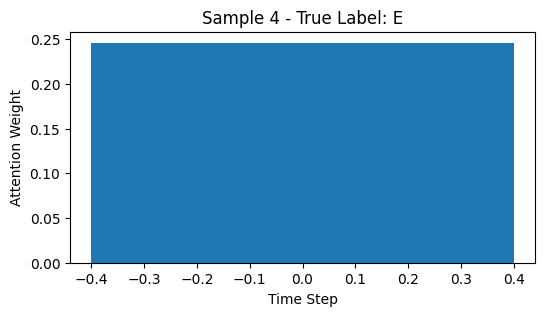

In [39]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, metric='f1_macro', scale='log') 

# 4. Scale dữ liệu theo MinMax

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_72"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_72          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_144 (Dropout)     │ (None, 1, 128)         │              0 │ bidirectional_72[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_73          │ (None, 1, 64)          │         41,216 │ dropout_144[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_73[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_73[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_217 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_72    │ (None, 64)             │            256 │ dense_217[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_216 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_146 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_7… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_145 (Dropout)     │ (None, 64)             │              0 │ dense_216[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_218 (Dense)         │ (None, 32)             │          2,080 │ dropout_146[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_36            │ (None, 96)             │              0 │ dropout_145[0][0],     │
│ (Concatenate)             │                        │                │ dense_218[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


139/145 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.2536 - loss: 6.3094

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


42/42 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step

Epoch 1: val_f1_macro = 0.1614
145/145 ━━━━━━━━━━━━━━━━━━━━ 24s 34ms/step - accuracy: 0.2549 - loss: 6.2723 - val_accuracy: 0.3669 - val_loss: 1.7434 - val_f1_macro: 0.1614 - learning_rate: 0.0010
Epoch 2/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.2429
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.3514 - loss: 4.4747 - val_accuracy: 0.3775 - val_loss: 1.5534 - val_f1_macro: 0.2429 - learning_rate: 0.0010
Epoch 3/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.2217
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.3798 - loss: 3.9124 - val_accuracy: 0.3230 - val_loss: 1.7741 - val_f1_macro: 0.2217 - learning_rate: 0.0010
Epoch 4/200
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.1919
145/145 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - accuracy: 0.3787 - loss: 3.7240 - val_accuracy: 0.3759 - val_loss: 1.6754 - val_f1_macro: 0.1919 - learning_rate: 0.0010
Epoch 5/200
42/42 ━━━

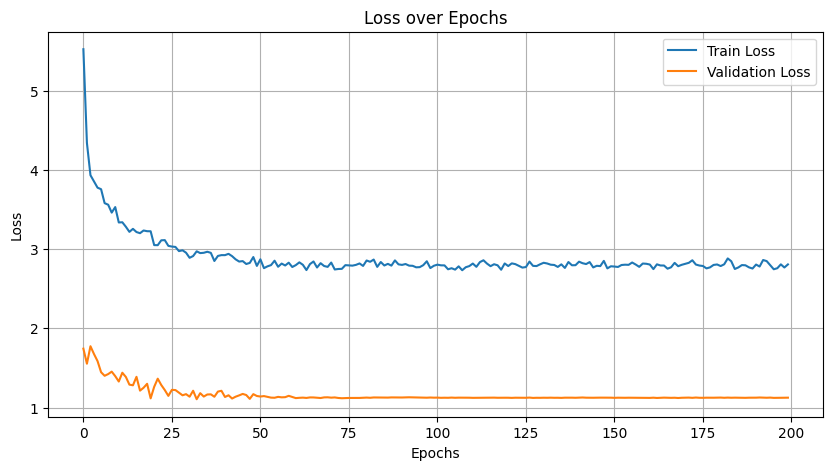

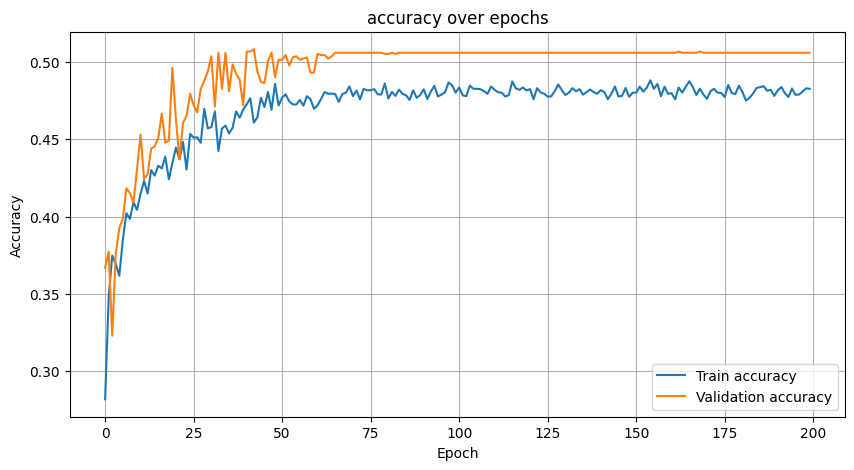

331/331 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.69811019 0.3567353  0.11173498 0.33248082 0.14440433]
Precision (per class): [0.7888165  0.73971193 0.06044957 0.24528302 0.08      ]
Recall (per class): [0.62611319 0.23504413 0.73703704 0.51587302 0.74074074]
Accuracy: 0.5134
AUC (One-vs-Rest): 0.8230

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.63      0.70      6962
           D       0.74      0.24      0.36      3059
           C       0.06      0.74      0.11       270
           B       0.25      0.52      0.33       252
           A       0.08      0.74      0.14        27

    accuracy                           0.51     10570
   macro avg       0.38      0.57      0.33     10570
weighted avg       0.74      0.51      0.57     10570



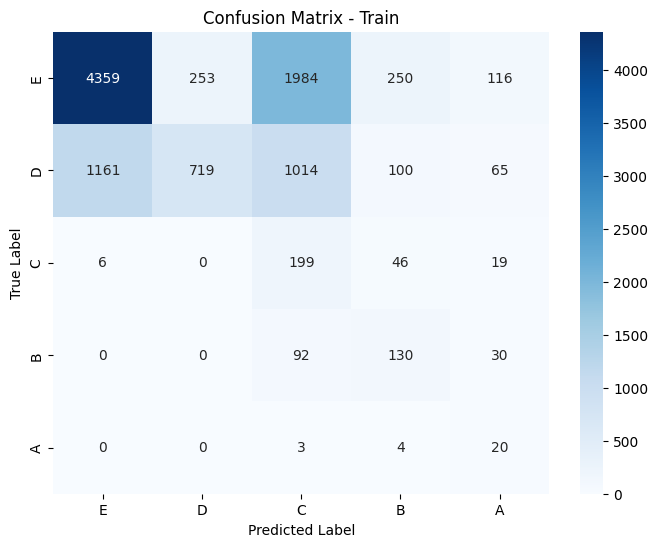

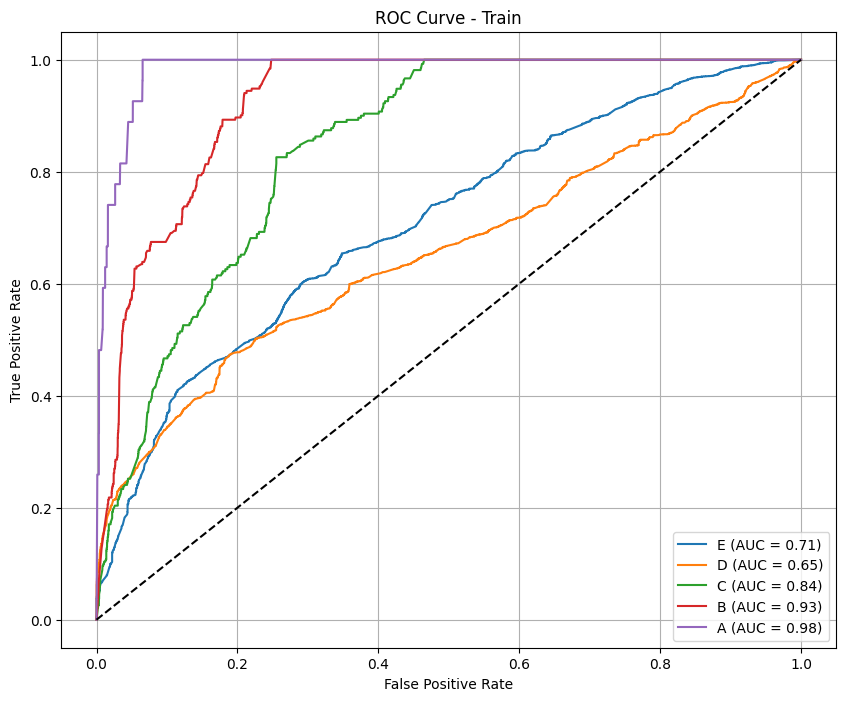

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.80248007 0.3923445  0.04395604 0.         0.19047619]
Precision (per class): [0.88304094 0.35652174 0.02816901 0.         0.18181818]
Recall (per class): [0.73538961 0.43617021 0.1        0.         0.2       ]
Accuracy: 0.6587
AUC (One-vs-Rest): 0.5929

Classification Report:
              precision    recall  f1-score   support

           E       0.88      0.74      0.80       616
           D       0.36      0.44      0.39        94
           C       0.03      0.10      0.04        20
           B       0.00      0.00      0.00        16
           A       0.18      0.20      0.19        10

    accuracy                           0.66       756
   macro avg       0.29      0.29      0.29       756
weighted avg       0.77      0.66      0.71       756



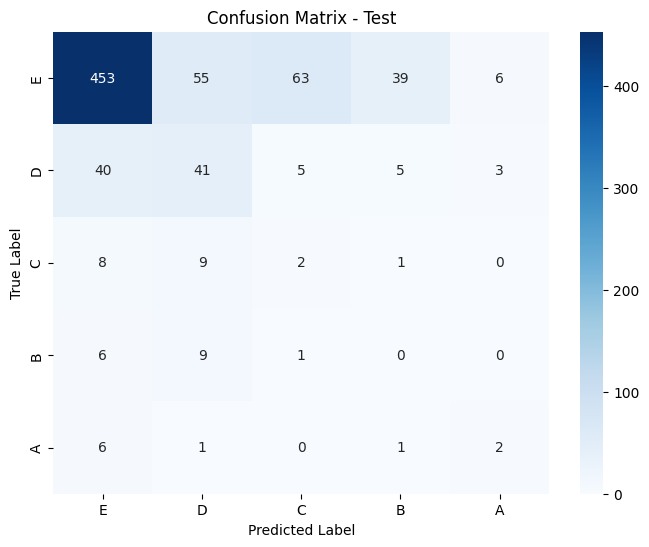

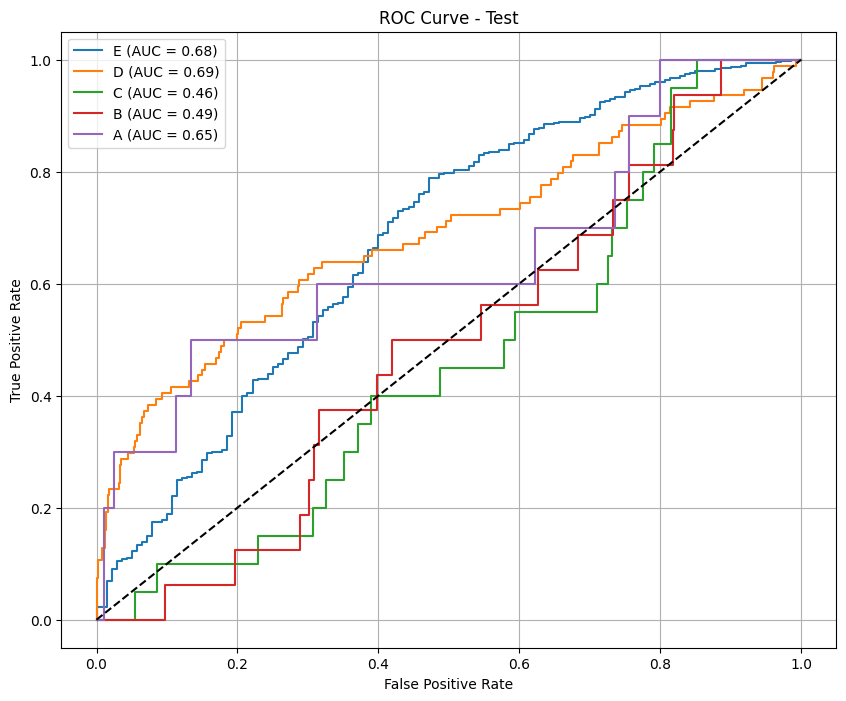

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_minmax.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


318/331 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


331/331 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

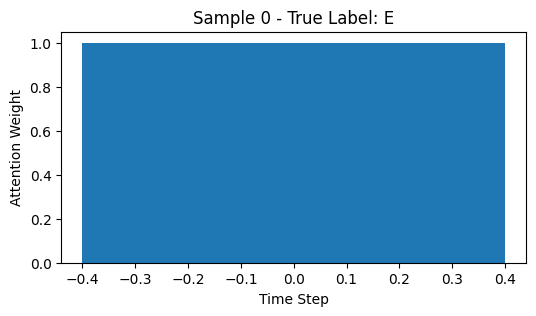

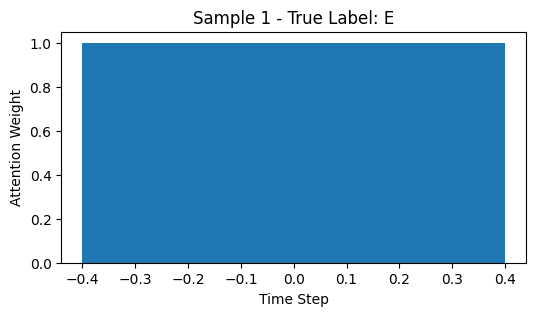

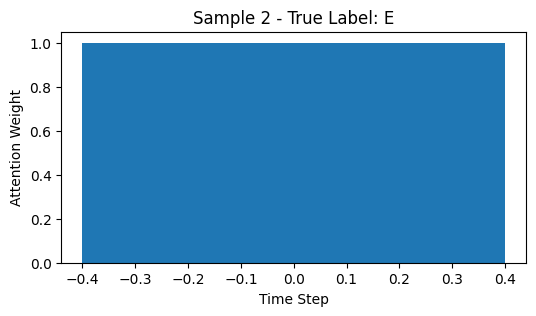

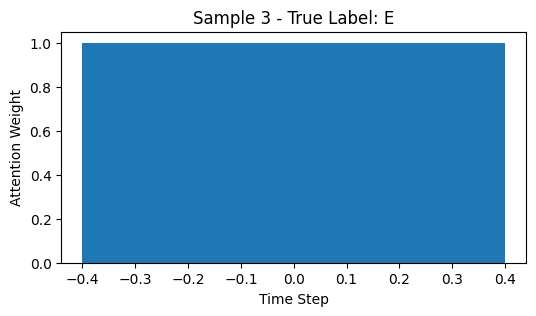

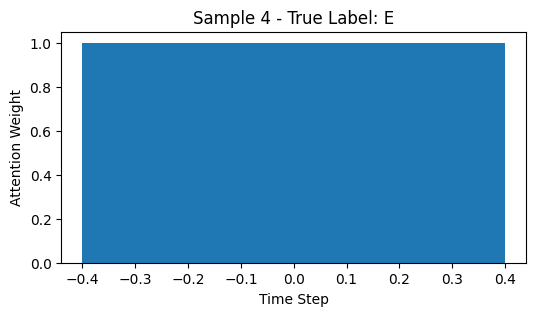

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_74"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_74          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_148 (Dropout)     │ (None, 2, 128)         │              0 │ bidirectional_74[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_75          │ (None, 2, 64)          │         41,216 │ dropout_148[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_75[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_75[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_223 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_74    │ (None, 64)             │            256 │ dense_223[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_222 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_150 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_7… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_149 (Dropout)     │ (None, 64)             │              0 │ dense_222[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_224 (Dense)         │ (None, 32)             │          2,080 │ dropout_150[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_37            │ (None, 96)             │              0 │ dropout_149[0][0],     │
│ (Concatenate)             │                        │                │ dense_224[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 2s 38ms/step

Epoch 1: val_f1_macro = 0.2214
117/117 ━━━━━━━━━━━━━━━━━━━━ 19s 43ms/step - accuracy: 0.2996 - loss: 7.8478 - val_accuracy: 0.5341 - val_loss: 1.2196 - val_f1_macro: 0.2214 - learning_rate: 0.0010
Epoch 2/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1788
117/117 ━━━━━━━━━━━━━━━━━━━━ 1s 12ms/step - accuracy: 0.3278 - loss: 4.9609 - val_accuracy: 0.2881 - val_loss: 1.6570 - val_f1_macro: 0.1788 - learning_rate: 0.0010
Epoch 3/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.1777
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.3295 - loss: 4.9643 - val_accuracy: 0.3442 - val_loss: 1.6143 - val_f1_macro: 0.1777 - learning_rate: 0.0010
Epoch 4/200
34/34 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.2017
117/117 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.3675 - loss: 4.0562 - val_accuracy: 0.3601 - val_loss: 1.7589 - val_f1_macro: 0.2017 - learning_rate: 0.0010
Epoch 

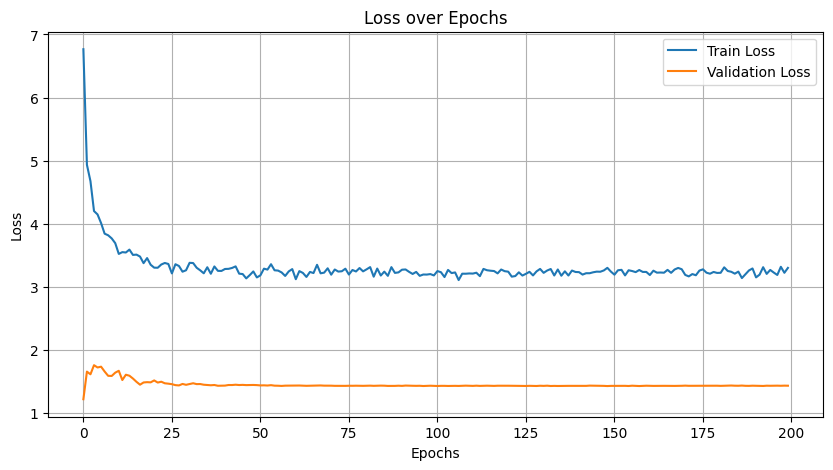

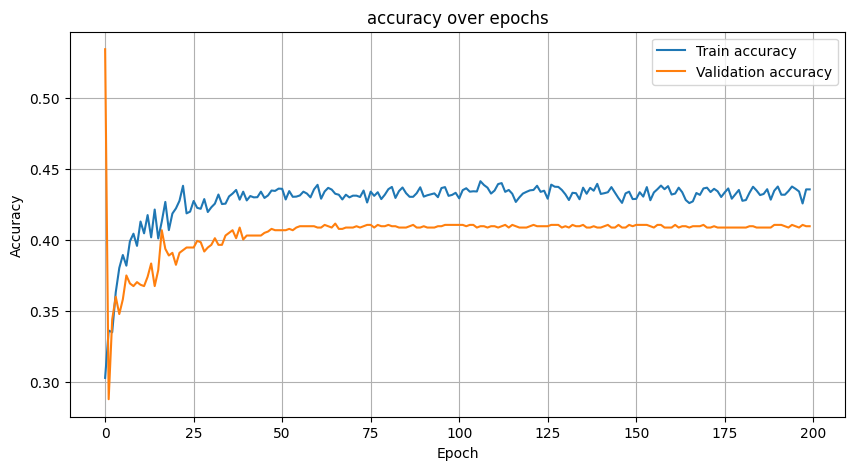

268/268 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.62485506 0.26192827 0.10687023 0.18537201 0.17167382]
Precision (per class): [0.76648565 0.66778523 0.05831019 0.10840708 0.09615385]
Recall (per class): [0.52740214 0.16291445 0.63913043 0.63913043 0.8       ]
Accuracy: 0.4300
AUC (One-vs-Rest): 0.7787

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.53      0.62      5620
           D       0.67      0.16      0.26      2443
           C       0.06      0.64      0.11       230
           B       0.11      0.64      0.19       230
           A       0.10      0.80      0.17        25

    accuracy                           0.43      8548
   macro avg       0.34      0.55      0.27      8548
weighted avg       0.70      0.43      0.49      8548



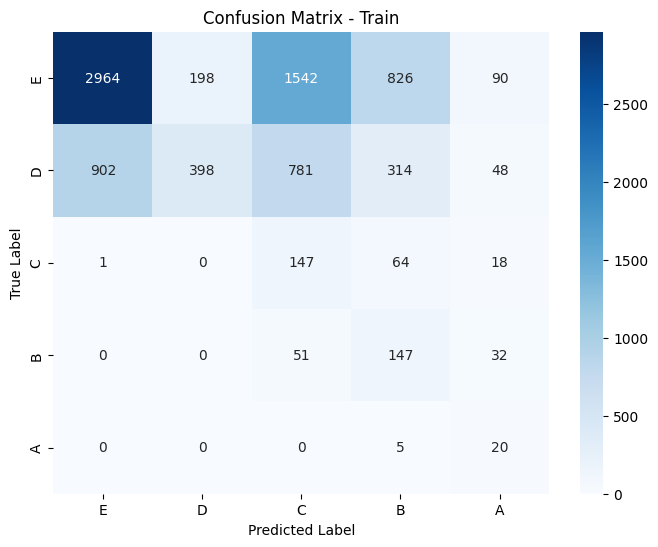

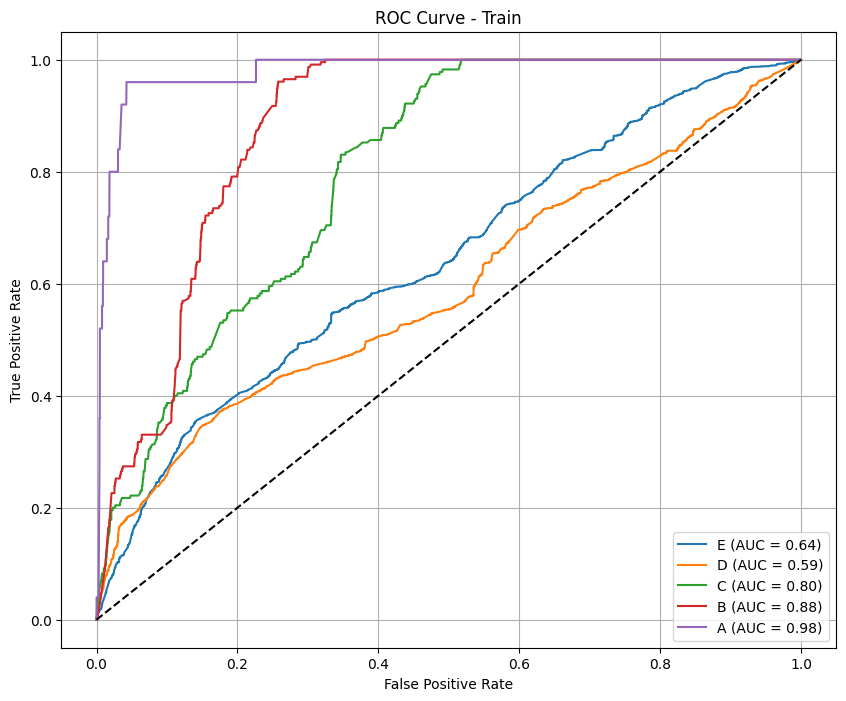

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.82679739 0.03389831 0.07792208 0.         0.16666667]
Precision (per class): [0.82276423 0.07692308 0.05263158 0.         0.10526316]
Recall (per class): [0.83087028 0.02173913 0.15       0.         0.4       ]
Accuracy: 0.6903
AUC (One-vs-Rest): 0.6269

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.83      0.83       609
           D       0.08      0.02      0.03        92
           C       0.05      0.15      0.08        20
           B       0.00      0.00      0.00        15
           A       0.11      0.40      0.17        10

    accuracy                           0.69       746
   macro avg       0.21      0.28      0.22       746
weighted avg       0.68      0.69      0.68       746



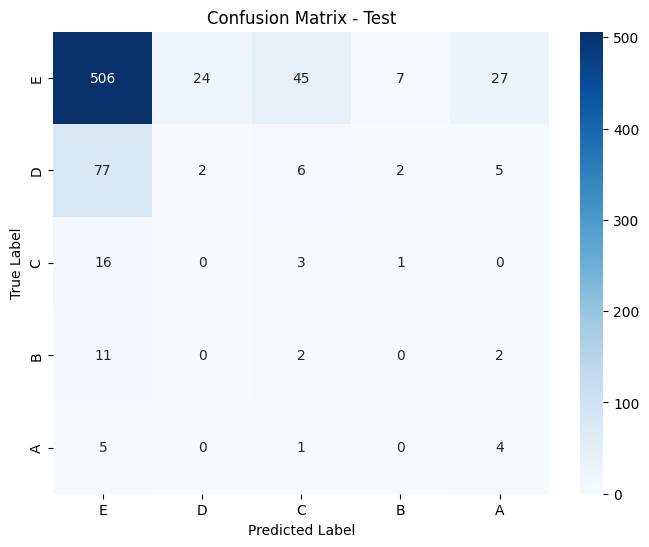

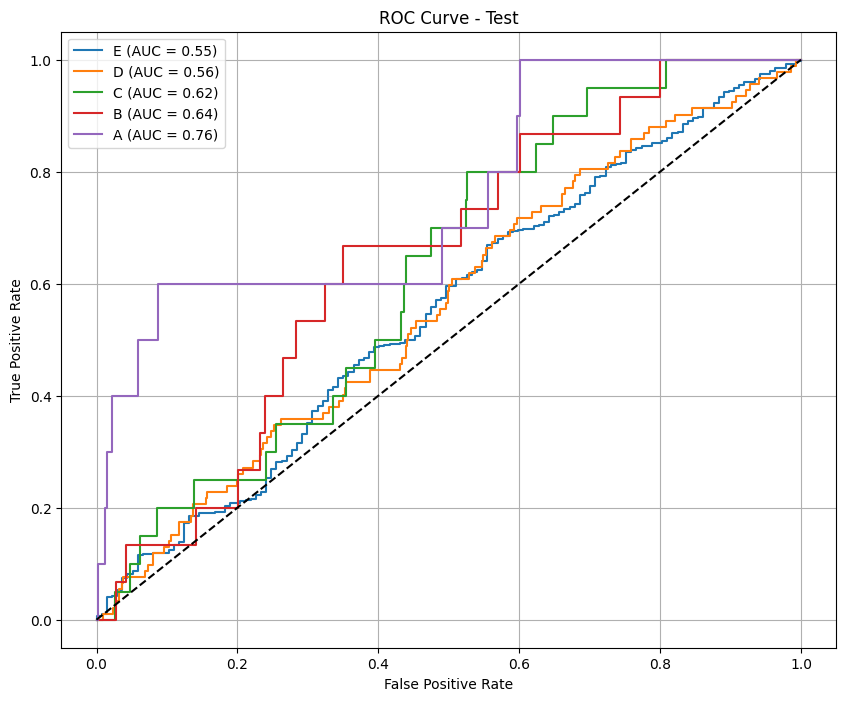

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_minmax.csv
268/268 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
[[0.49208727]
 [0.5079127 ]
 [0.4920944 ]
 [0.5079055 ]
 [0.49226964]
 [0.50773036]
 [0.49208727]
 [0.5079127 ]
 [0.49148425]
 [0.5085158 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49217907]
 [0.50782084]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.4920949 ]
 [0.50790507]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.4923957 ]
 [0.50760424]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49221972]
 [0.50778025]
 [0.49207607]
 [0.50792396]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49238455]
 [0.50761545]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208727]
 [0.5079127 ]
 [0.49208802]
 [0.50791204]
 [0.49

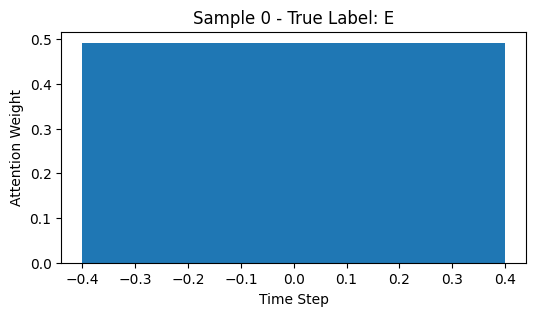

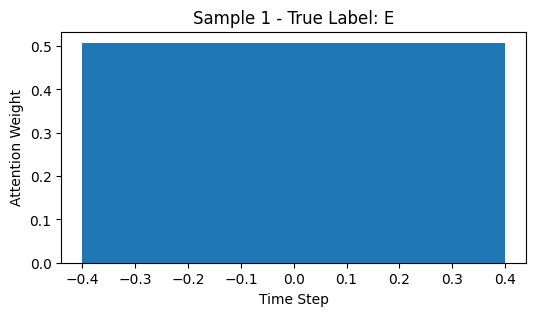

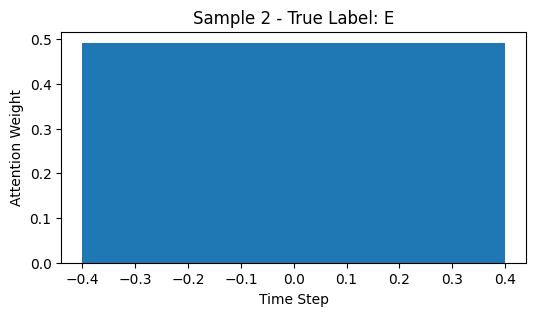

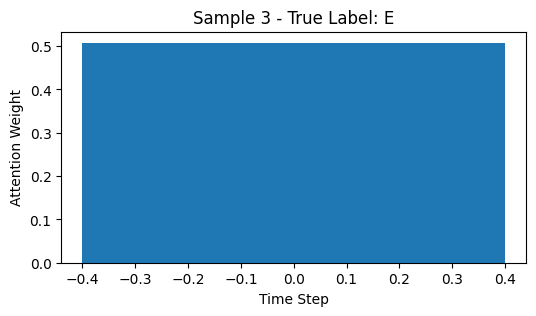

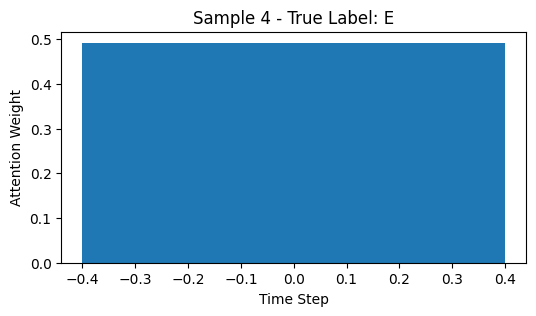

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_76"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_76          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_152 (Dropout)     │ (None, 3, 128)         │              0 │ bidirectional_76[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_77          │ (None, 3, 64)          │         41,216 │ dropout_152[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_77[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_77[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_229 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_76    │ (None, 64)             │            256 │ dense_229[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_228 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_154 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_7… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_153 (Dropout)     │ (None, 64)             │              0 │ dense_228[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_230 (Dense)         │ (None, 32)             │          2,080 │ dropout_154[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_38            │ (None, 96)             │              0 │ dropout_153[0][0],     │
│ (Concatenate)             │                        │                │ dense_230[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 2s 43ms/step

Epoch 1: val_f1_macro = 0.1135
107/107 ━━━━━━━━━━━━━━━━━━━━ 24s 49ms/step - accuracy: 0.2435 - loss: 7.9107 - val_accuracy: 0.2039 - val_loss: 1.6936 - val_f1_macro: 0.1135 - learning_rate: 0.0010
Epoch 2/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1801
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.2969 - loss: 5.0876 - val_accuracy: 0.2879 - val_loss: 1.7937 - val_f1_macro: 0.1801 - learning_rate: 0.0010
Epoch 3/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2201
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.3620 - loss: 4.4033 - val_accuracy: 0.3709 - val_loss: 1.7968 - val_f1_macro: 0.2201 - learning_rate: 0.0010
Epoch 4/200
31/31 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2010
107/107 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.3670 - loss: 4.4982 - val_accuracy: 0.3176 - val_loss: 1.7026 - val_f1_macro: 0.2010 - learning_rate: 0.0010
Epoch 

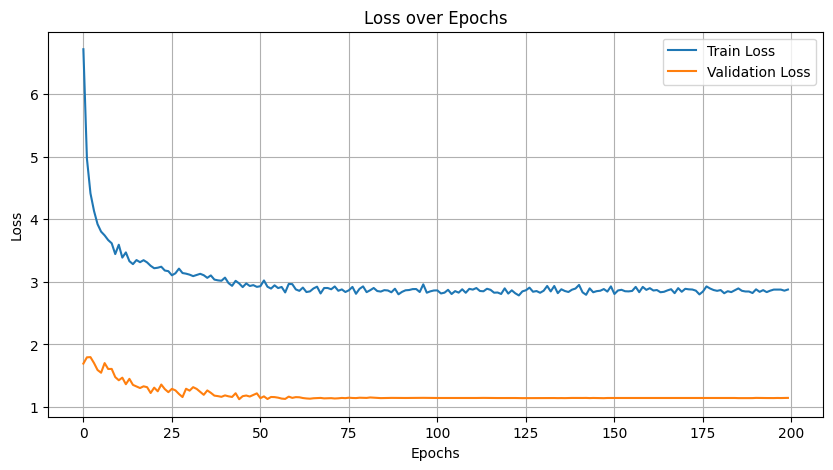

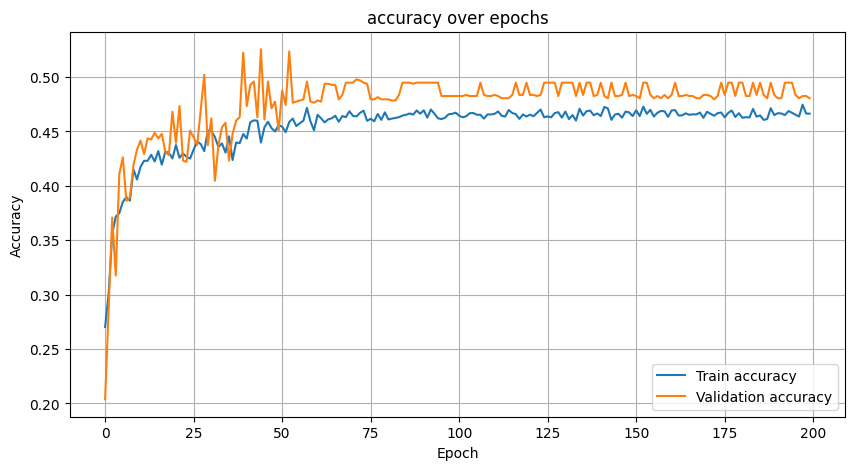

244/244 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.66784258 0.28099754 0.0973545  0.38304094 0.13017751]
Precision (per class): [0.76741829 0.68143101 0.05223316 0.27463312 0.07333333]
Recall (per class): [0.59113973 0.17699115 0.71502591 0.63285024 0.57894737]
Accuracy: 0.4753
AUC (One-vs-Rest): 0.8080

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.59      0.67      5124
           D       0.68      0.18      0.28      2260
           C       0.05      0.72      0.10       193
           B       0.27      0.63      0.38       207
           A       0.07      0.58      0.13        19

    accuracy                           0.48      7803
   macro avg       0.37      0.54      0.31      7803
weighted avg       0.71      0.48      0.53      7803



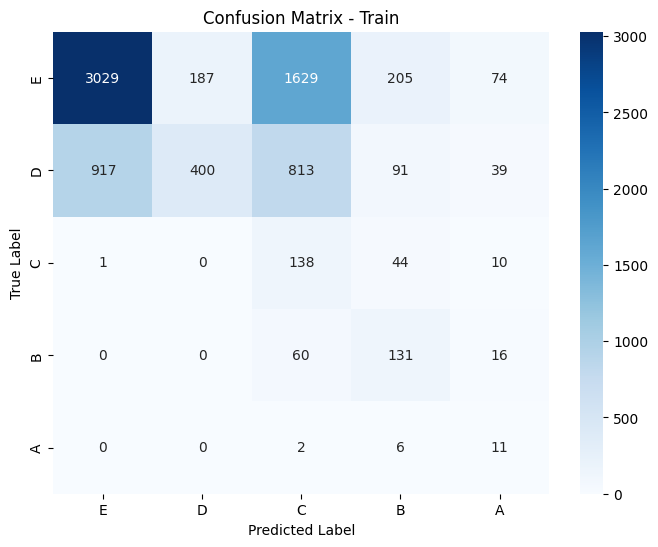

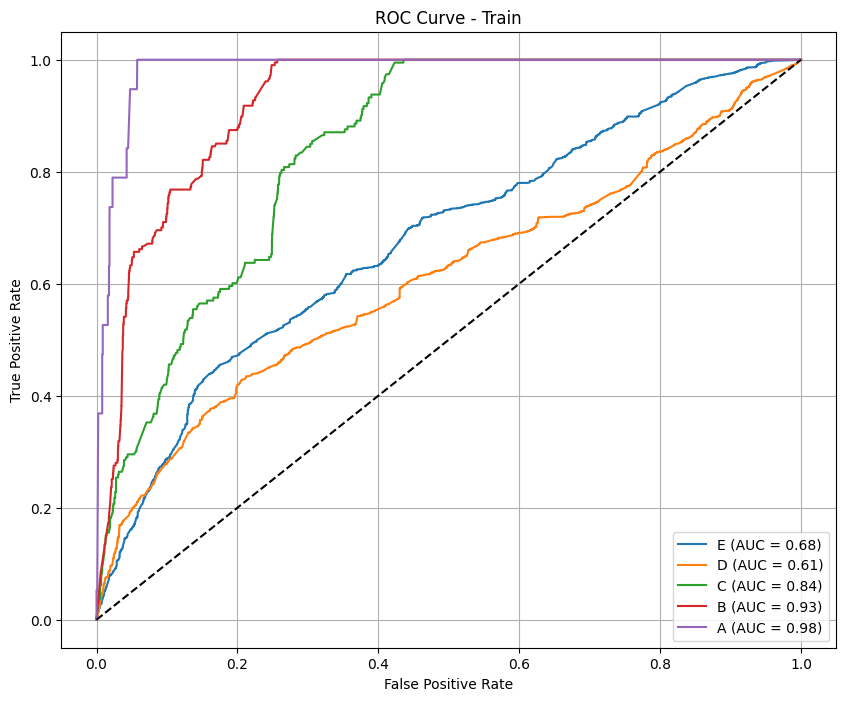

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.8017316  0.05309735 0.         0.         0.0952381 ]
Precision (per class): [0.81657848 0.11538462 0.         0.         0.09090909]
Recall (per class): [0.78741497 0.03448276 0.         0.         0.1       ]
Accuracy: 0.6477
AUC (One-vs-Rest): 0.5866

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.79      0.80       588
           D       0.12      0.03      0.05        87
           C       0.00      0.00      0.00        20
           B       0.00      0.00      0.00        16
           A       0.09      0.10      0.10        10

    accuracy                           0.65       721
   macro avg       0.20      0.18      0.19       721
weighted avg       0.68      0.65      0.66       721



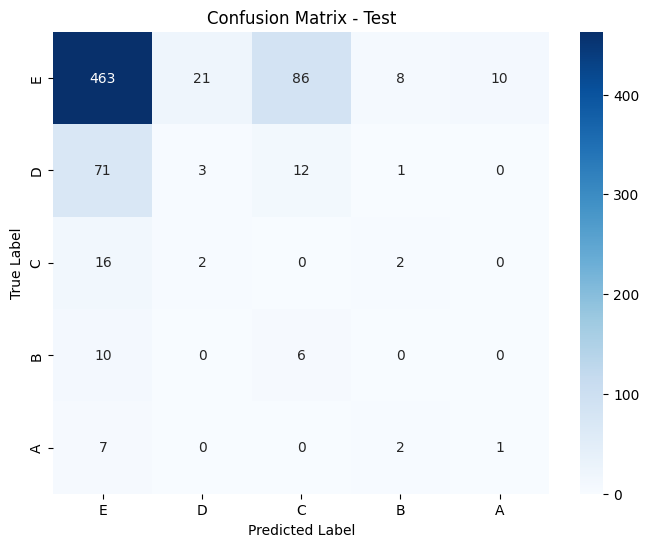

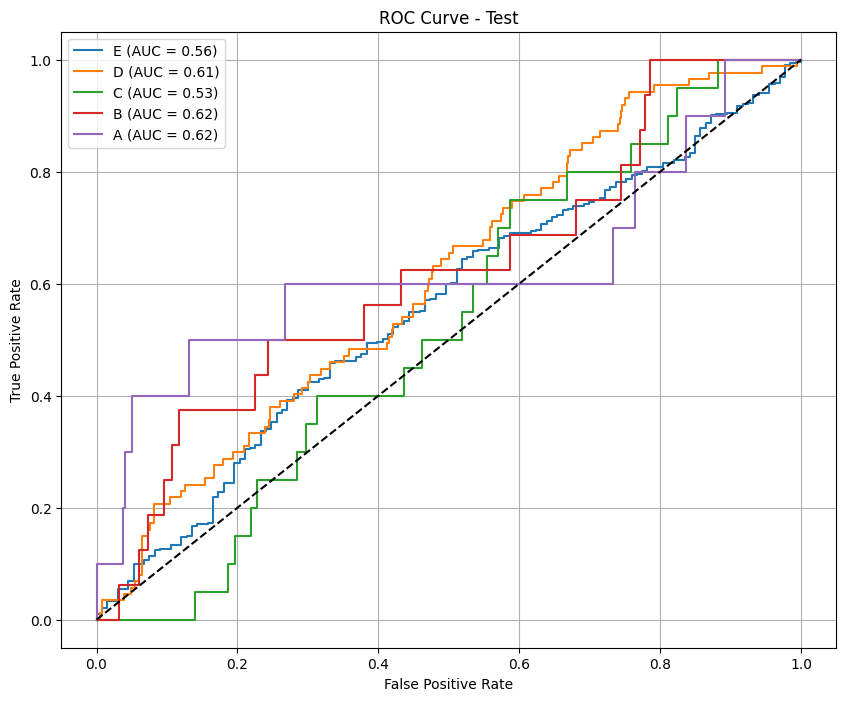

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_minmax.csv
244/244 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
[[0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.33064702]
 [0.3310436 ]
 [0.33830932]
 [0.33079043]
 [0.33110425]
 [0.3381053 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.33063874]
 [0.3312299 ]
 [0.33813137]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.33063722]
 [0.33122906]
 [0.33813375]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.3381509 ]
 [0.3306279 ]
 [0.33122122]
 [0.33

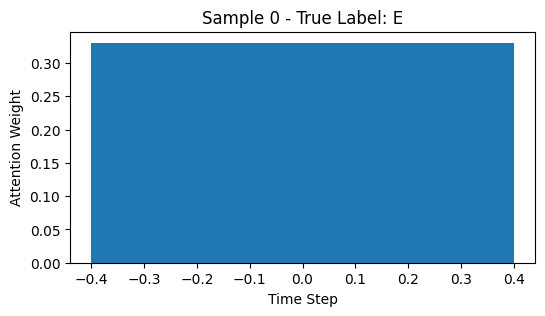

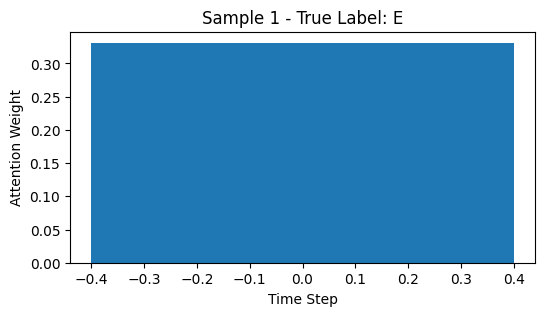

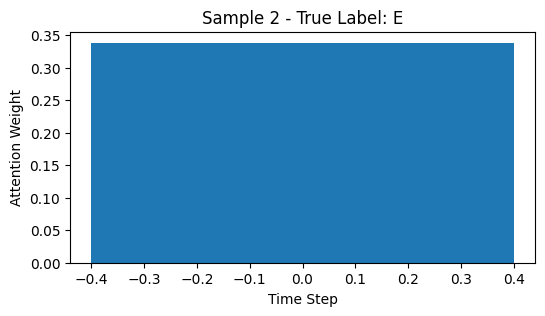

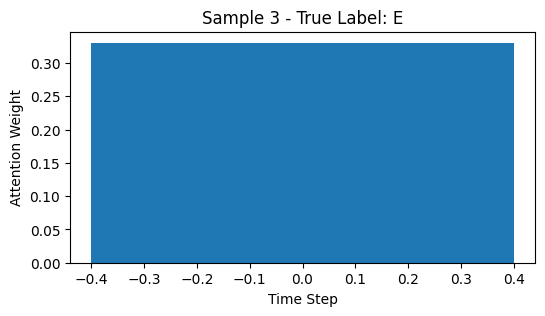

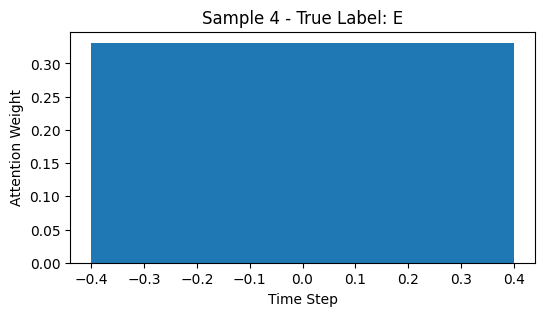

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_78"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_78          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_156 (Dropout)     │ (None, 4, 128)         │              0 │ bidirectional_78[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_79          │ (None, 4, 64)          │         41,216 │ dropout_156[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_79[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_79[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_235 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_78    │ (None, 64)             │            256 │ dense_235[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_234 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_158 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_7… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_157 (Dropout)     │ (None, 64)             │              0 │ dense_234[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_236 (Dense)         │ (None, 32)             │          2,080 │ dropout_158[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_39            │ (None, 96)             │              0 │ dropout_157[0][0],     │
│ (Concatenate)             │                        │                │ dense_236[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step

Epoch 1: val_f1_macro = 0.2366
74/74 ━━━━━━━━━━━━━━━━━━━━ 18s 63ms/step - accuracy: 0.3279 - loss: 5.6440 - val_accuracy: 0.6244 - val_loss: 0.8344 - val_f1_macro: 0.2366 - learning_rate: 0.0010
Epoch 2/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.3295
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.3642 - loss: 5.0940 - val_accuracy: 0.6379 - val_loss: 0.8416 - val_f1_macro: 0.3295 - learning_rate: 0.0010
Epoch 3/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2803
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.4210 - loss: 4.4296 - val_accuracy: 0.4218 - val_loss: 1.4098 - val_f1_macro: 0.2803 - learning_rate: 0.0010
Epoch 4/200
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.2871
74/74 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.4056 - loss: 4.3357 - val_accuracy: 0.4128 - val_loss: 1.5544 - val_f1_macro: 0.2871 - learning_rate: 0.0010
Epoch 5/200
21

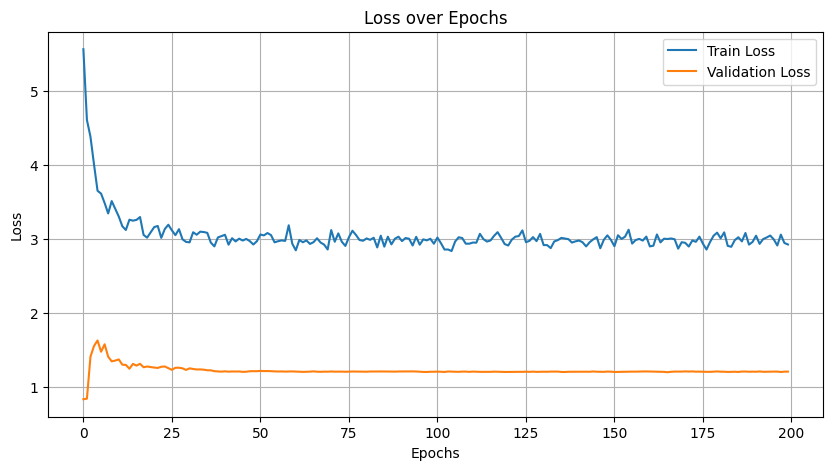

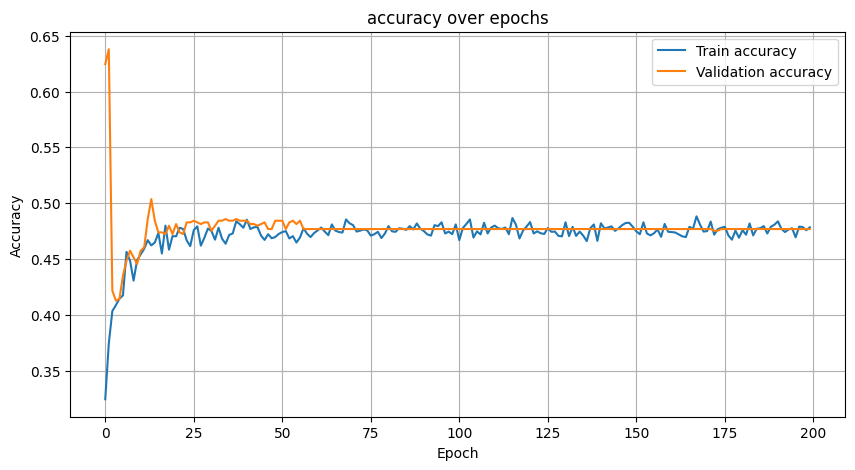

168/168 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.63973064 0.31421911 0.08492823 0.25493716 0.17391304]
Precision (per class): [0.73076923 0.59857904 0.04519414 0.17839196 0.0990099 ]
Recall (per class): [0.56886228 0.21302149 0.7029703  0.44654088 0.71428571]
Accuracy: 0.4632
AUC (One-vs-Rest): 0.7977

Classification Report:
              precision    recall  f1-score   support

           E       0.73      0.57      0.64      3507
           D       0.60      0.21      0.31      1582
           C       0.05      0.70      0.08       101
           B       0.18      0.45      0.25       159
           A       0.10      0.71      0.17        14

    accuracy                           0.46      5363
   macro avg       0.33      0.53      0.29      5363
weighted avg       0.66      0.46      0.52      5363



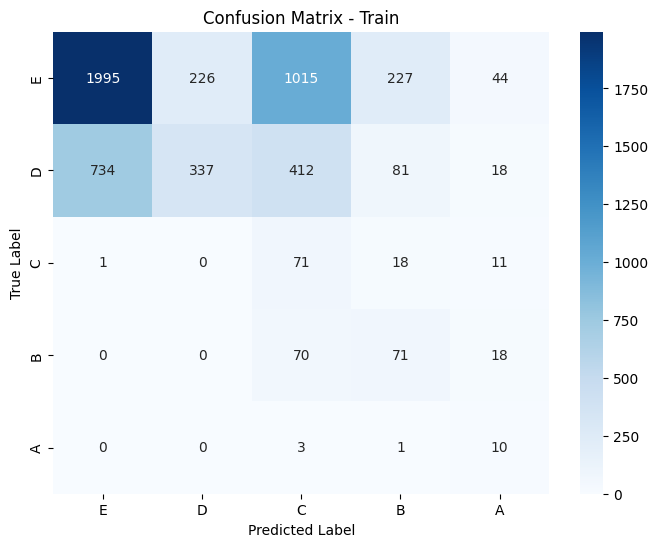

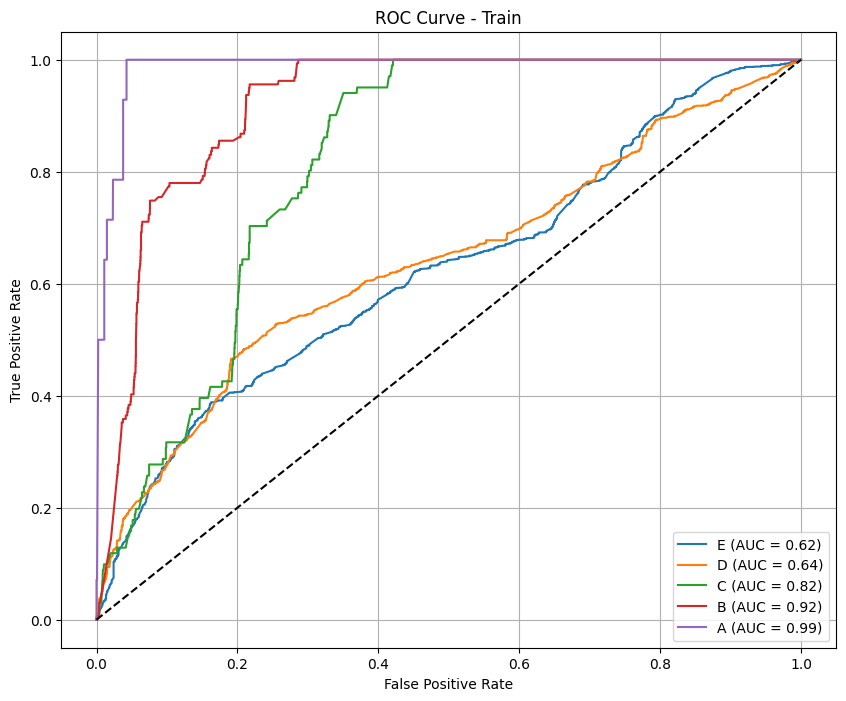

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.76837209 0.12149533 0.         0.         0.        ]
Precision (per class): [0.79423077 0.10077519 0.         0.         0.        ]
Recall (per class): [0.74414414 0.15294118 0.         0.         0.        ]
Accuracy: 0.6201
AUC (One-vs-Rest): 0.5530

Classification Report:
              precision    recall  f1-score   support

           E       0.79      0.74      0.77       555
           D       0.10      0.15      0.12        85
           C       0.00      0.00      0.00        18
           B       0.00      0.00      0.00        18
           A       0.00      0.00      0.00        11

    accuracy                           0.62       687
   macro avg       0.18      0.18      0.18       687
weighted avg       0.65      0.62      0.64       687



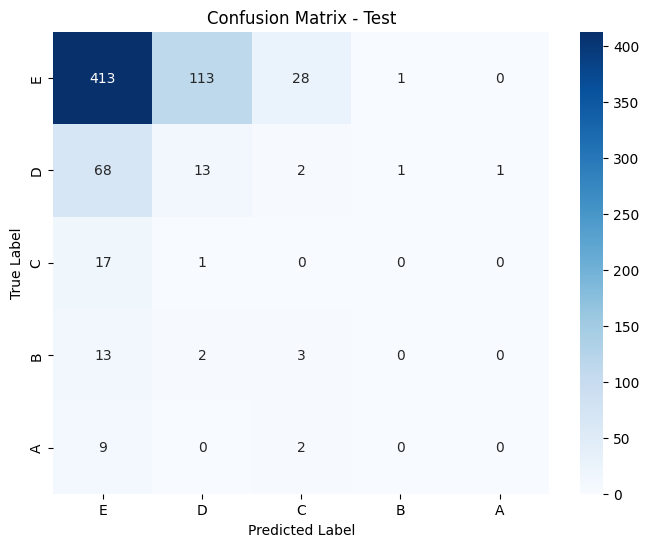

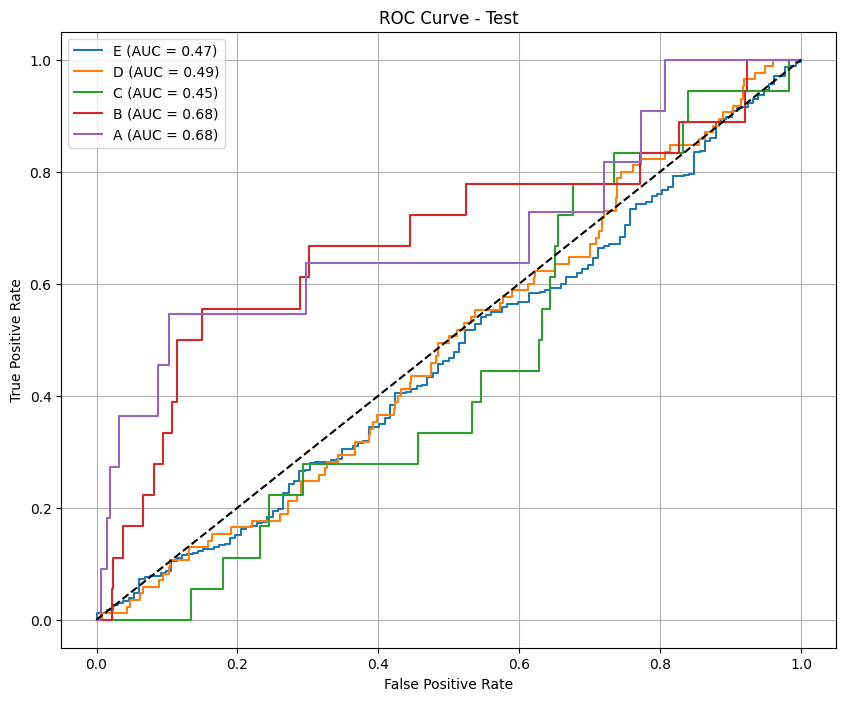

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_minmax.csv
168/168 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
[[0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815346]
 [0.25086635]
 [0.25114352]
 [0.24983664]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.2481557 ]
 [0.2508678 ]
 [0.25114042]
 [0.2498361 ]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.25114143]
 [0.24983782]
 [0.24815397]
 [0.2508668 ]
 [0.2

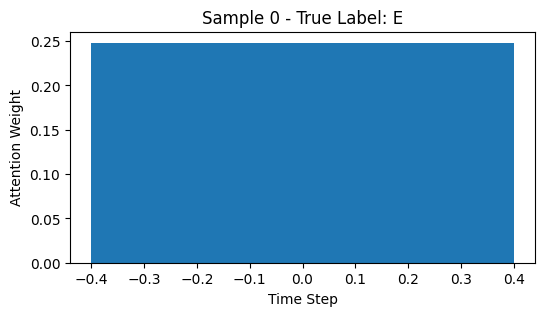

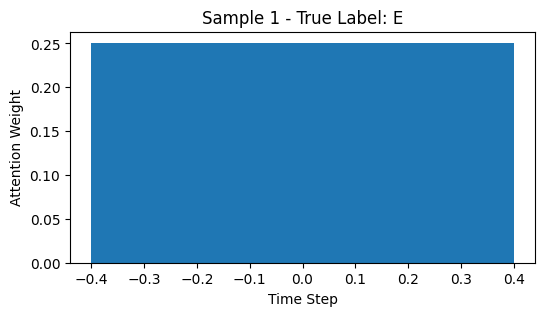

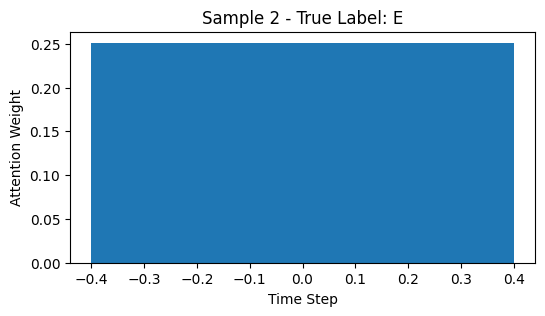

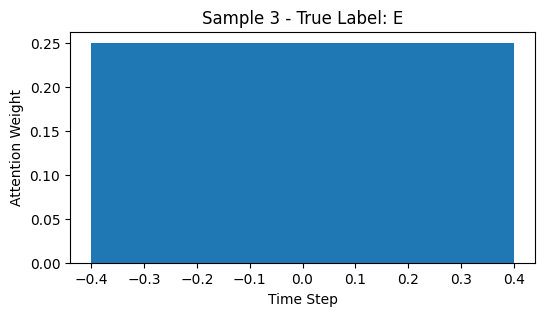

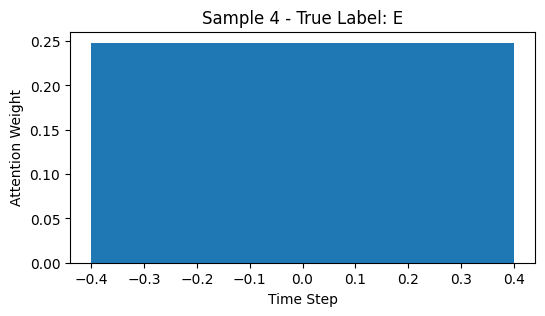

In [40]:
# Lặp qua các phase
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_phase(phase, metric='f1_macro', scale='minmax') 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_80"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_80          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_160 (Dropout)     │ (None, 1, 128)         │              0 │ bidirectional_80[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_81          │ (None, 1, 64)          │         41,216 │ dropout_160[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_81[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_81[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_241 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_80    │ (None, 64)             │            256 │ dense_241[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_240 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_162 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_8… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_161 (Dropout)     │ (None, 64)             │              0 │ dense_240[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_242 (Dense)         │ (None, 32)             │          2,080 │ dropout_162[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_40            │ (None, 96)             │              0 │ dropout_161[0][0],     │
│ (Concatenate)             │                        │                │ dense_242[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


103/104 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - accuracy: 0.1991 - loss: 7.6817

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


30/30 ━━━━━━━━━━━━━━━━━━━━ 2s 45ms/step

Epoch 1: val_f1_macro = 0.1120
104/104 ━━━━━━━━━━━━━━━━━━━━ 19s 45ms/step - accuracy: 0.1999 - loss: 7.6711 - val_accuracy: 0.2555 - val_loss: 1.7292 - val_f1_macro: 0.1120 - learning_rate: 0.0010
Epoch 2/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.1496
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - accuracy: 0.2877 - loss: 6.1663 - val_accuracy: 0.3696 - val_loss: 1.5585 - val_f1_macro: 0.1496 - learning_rate: 0.0010
Epoch 3/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.2769
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3081 - loss: 5.2214 - val_accuracy: 0.4065 - val_loss: 1.5109 - val_f1_macro: 0.2769 - learning_rate: 0.0010
Epoch 4/200
30/30 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.2406
104/104 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - accuracy: 0.3511 - loss: 4.8283 - val_accuracy: 0.3759 - val_loss: 1.5344 - val_f1_macro: 0.2406 - learning_rate: 0.0010
Epoch 5/200
30/30 

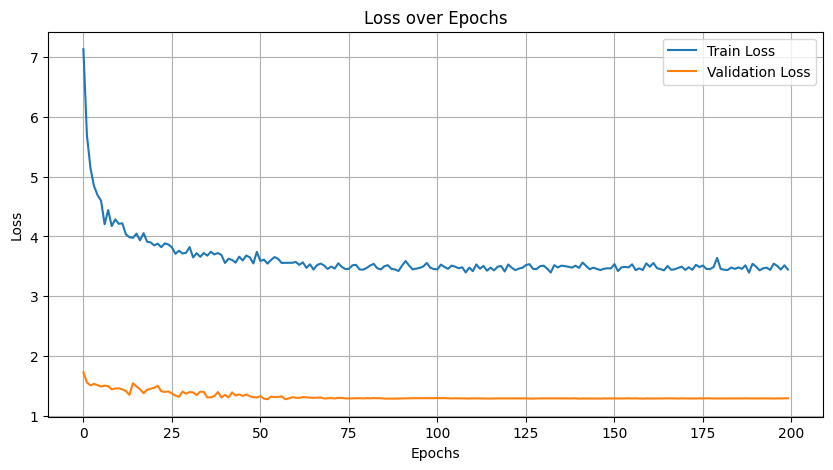

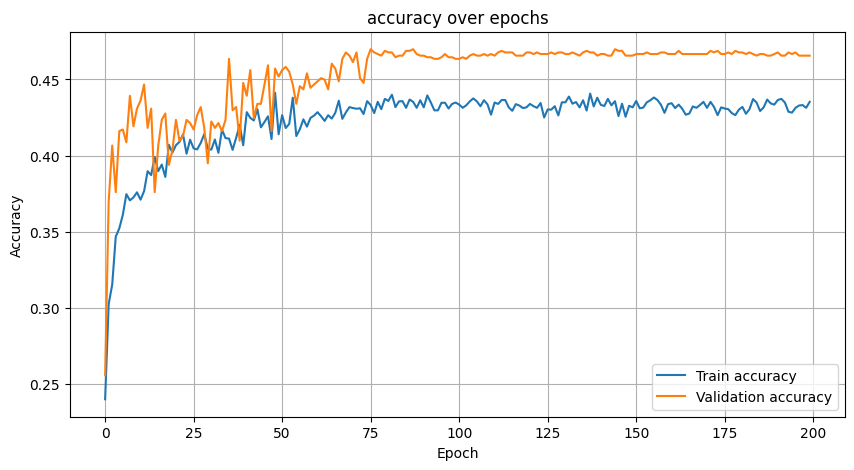

237/237 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.63929549 0.27366807 0.13073883 0.37855946 0.16528926]
Precision (per class): [0.78058704 0.64909091 0.07121563 0.32753623 0.09302326]
Recall (per class): [0.54131399 0.17338514 0.7962963  0.4484127  0.74074074]
Accuracy: 0.4480
AUC (One-vs-Rest): 0.8010

Classification Report:
              precision    recall  f1-score   support

           E       0.78      0.54      0.64      4962
           D       0.65      0.17      0.27      2059
           C       0.07      0.80      0.13       270
           B       0.33      0.45      0.38       252
           A       0.09      0.74      0.17        27

    accuracy                           0.45      7570
   macro avg       0.38      0.54      0.32      7570
weighted avg       0.70      0.45      0.51      7570



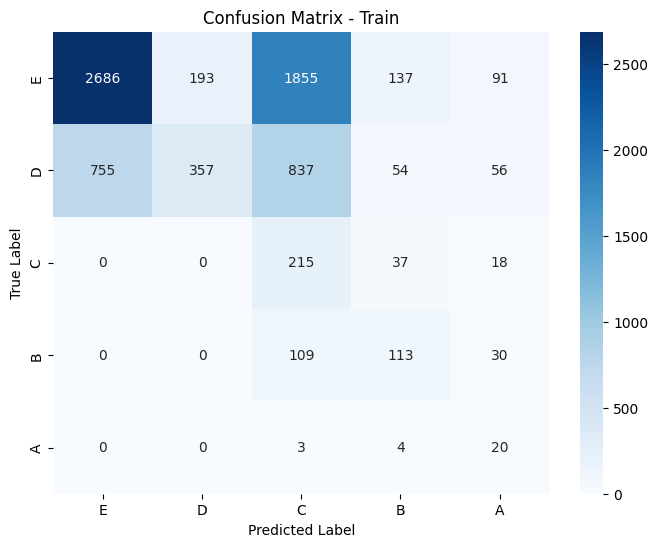

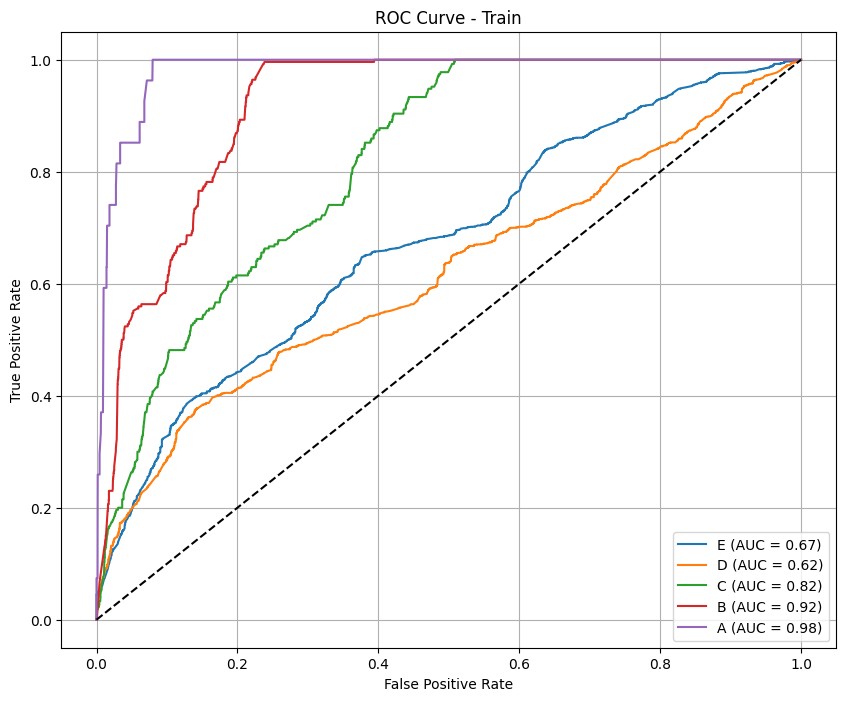

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.67949952 0.19455253 0.03797468 0.         0.26315789]
Precision (per class): [0.83451537 0.15337423 0.02173913 0.         0.17857143]
Recall (per class): [0.57305195 0.26595745 0.15       0.         0.5       ]
Accuracy: 0.5106
AUC (One-vs-Rest): 0.6036

Classification Report:
              precision    recall  f1-score   support

           E       0.83      0.57      0.68       616
           D       0.15      0.27      0.19        94
           C       0.02      0.15      0.04        20
           B       0.00      0.00      0.00        16
           A       0.18      0.50      0.26        10

    accuracy                           0.51       756
   macro avg       0.24      0.30      0.24       756
weighted avg       0.70      0.51      0.58       756



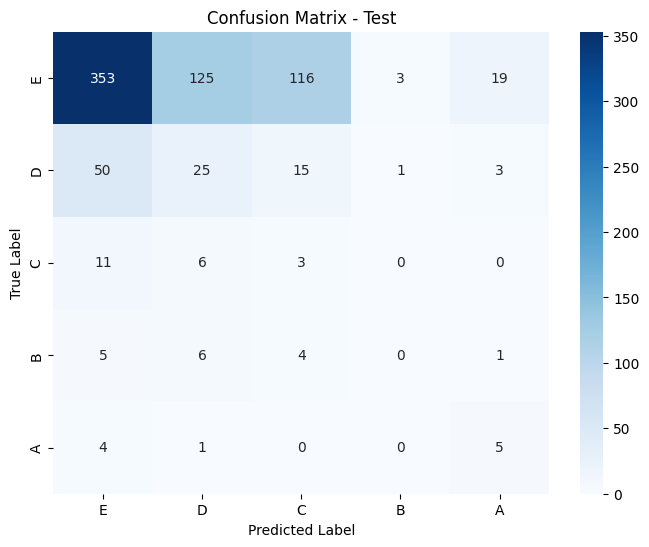

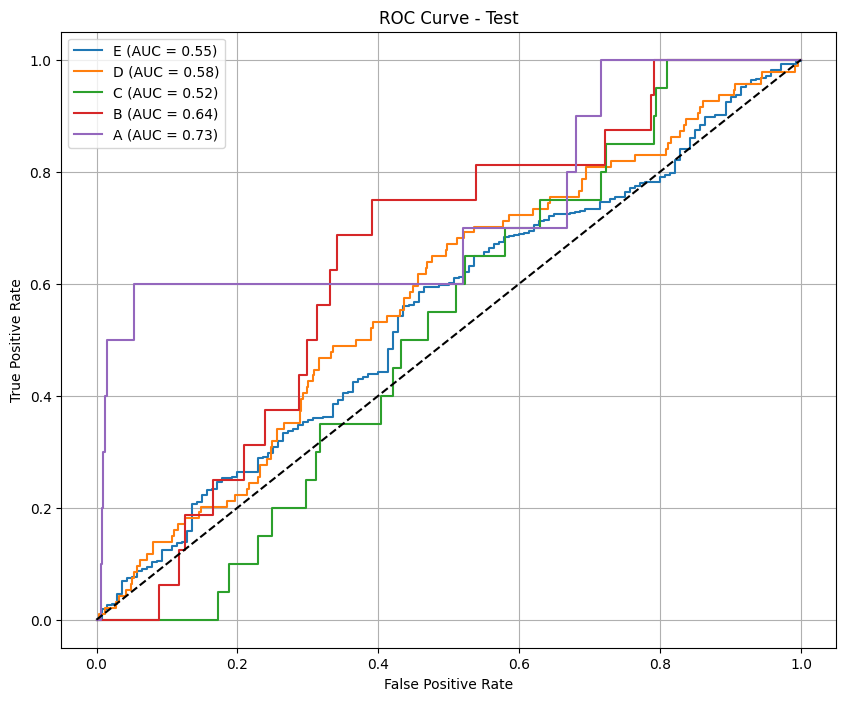

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_minmax.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


229/237 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step

You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


237/237 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

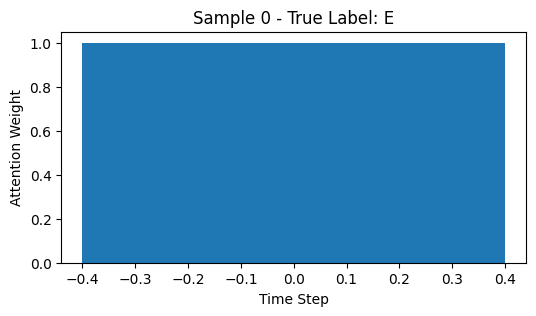

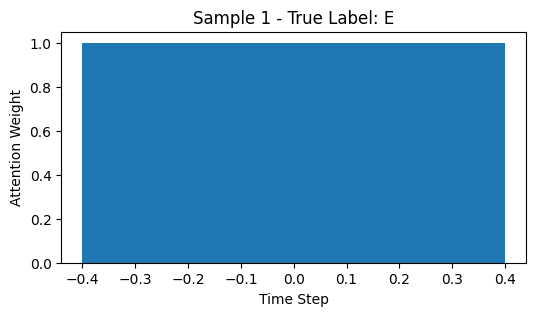

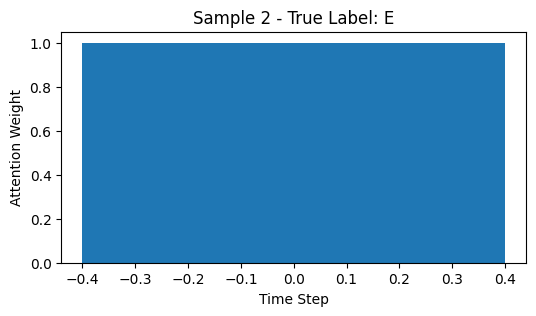

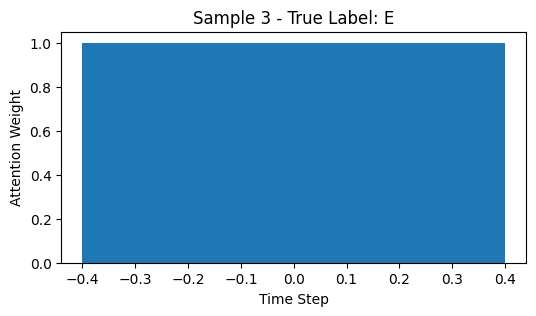

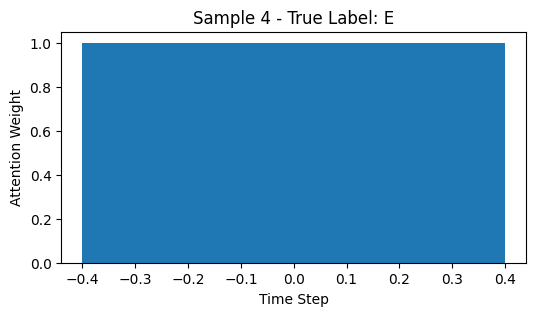

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_82"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_82          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_164 (Dropout)     │ (None, 2, 128)         │              0 │ bidirectional_82[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_83          │ (None, 2, 64)          │         41,216 │ dropout_164[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_83[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_83[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_247 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_82    │ (None, 64)             │            256 │ dense_247[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_246 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_166 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_8… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_165 (Dropout)     │ (None, 64)             │              0 │ dense_246[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_248 (Dense)         │ (None, 32)             │          2,080 │ dropout_166[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_41            │ (None, 96)             │              0 │ dropout_165[0][0],     │
│ (Concatenate)             │                        │                │ dense_248[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 2s 59ms/step

Epoch 1: val_f1_macro = 0.0963
76/76 ━━━━━━━━━━━━━━━━━━━━ 18s 60ms/step - accuracy: 0.1714 - loss: 9.6921 - val_accuracy: 0.2089 - val_loss: 2.1527 - val_f1_macro: 0.0963 - learning_rate: 0.0010
Epoch 2/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1353
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2589 - loss: 6.7049 - val_accuracy: 0.2291 - val_loss: 2.0341 - val_f1_macro: 0.1353 - learning_rate: 0.0010
Epoch 3/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.1971
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.2941 - loss: 6.8868 - val_accuracy: 0.2651 - val_loss: 2.0414 - val_f1_macro: 0.1971 - learning_rate: 0.0010
Epoch 4/200
22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.2020
76/76 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.3167 - loss: 5.6021 - val_accuracy: 0.3444 - val_loss: 2.0017 - val_f1_macro: 0.2020 - learning_rate: 0.0010
Epoch 5/200
22

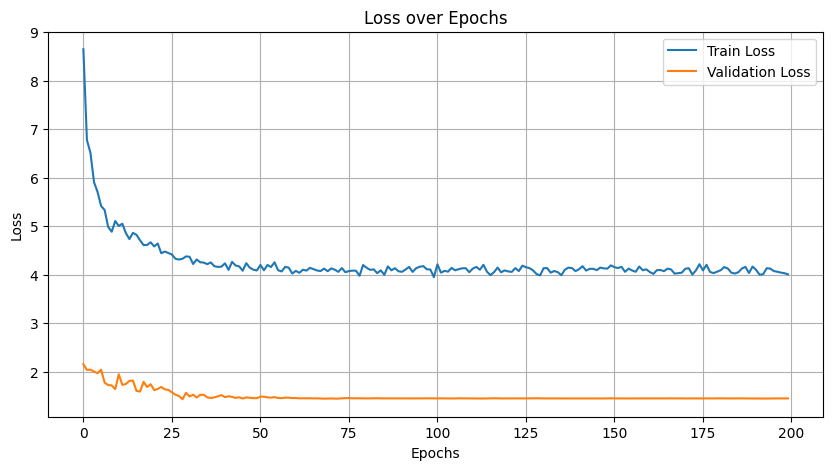

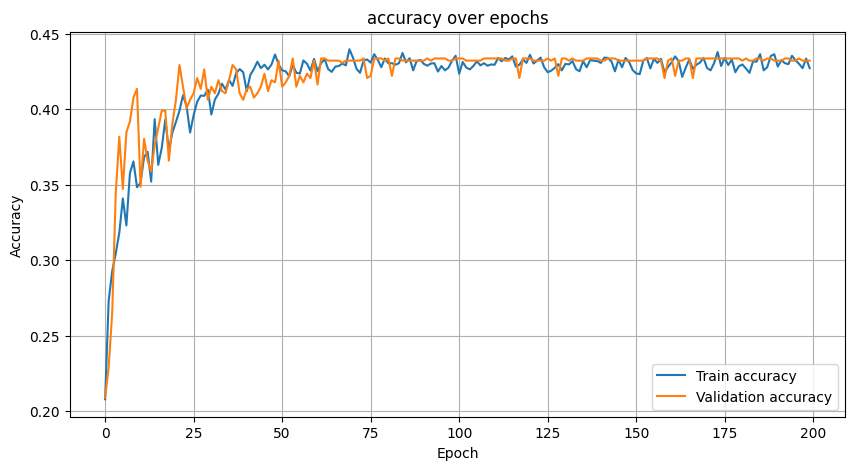

174/174 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.62888601 0.22260274 0.14798206 0.35805627 0.23076923]
Precision (per class): [0.75978091 0.63106796 0.0825     0.25362319 0.13740458]
Recall (per class): [0.53646409 0.13513514 0.7173913  0.60869565 0.72      ]
Accuracy: 0.4434
AUC (One-vs-Rest): 0.7922

Classification Report:
              precision    recall  f1-score   support

           E       0.76      0.54      0.63      3620
           D       0.63      0.14      0.22      1443
           C       0.08      0.72      0.15       230
           B       0.25      0.61      0.36       230
           A       0.14      0.72      0.23        25

    accuracy                           0.44      5548
   macro avg       0.37      0.54      0.32      5548
weighted avg       0.67      0.44      0.49      5548



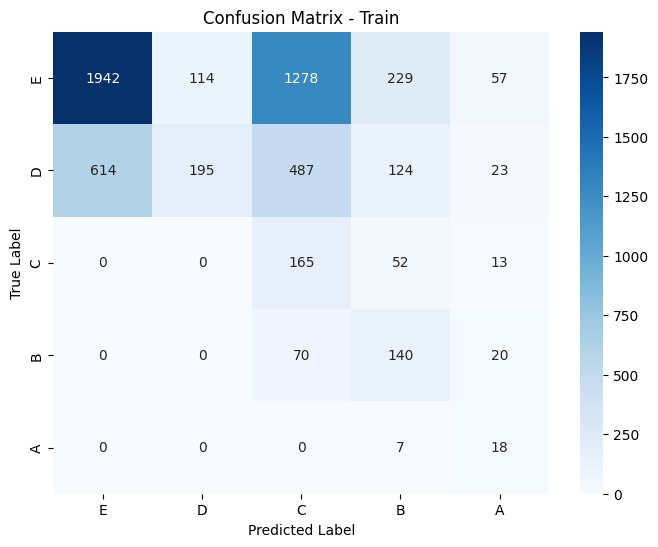

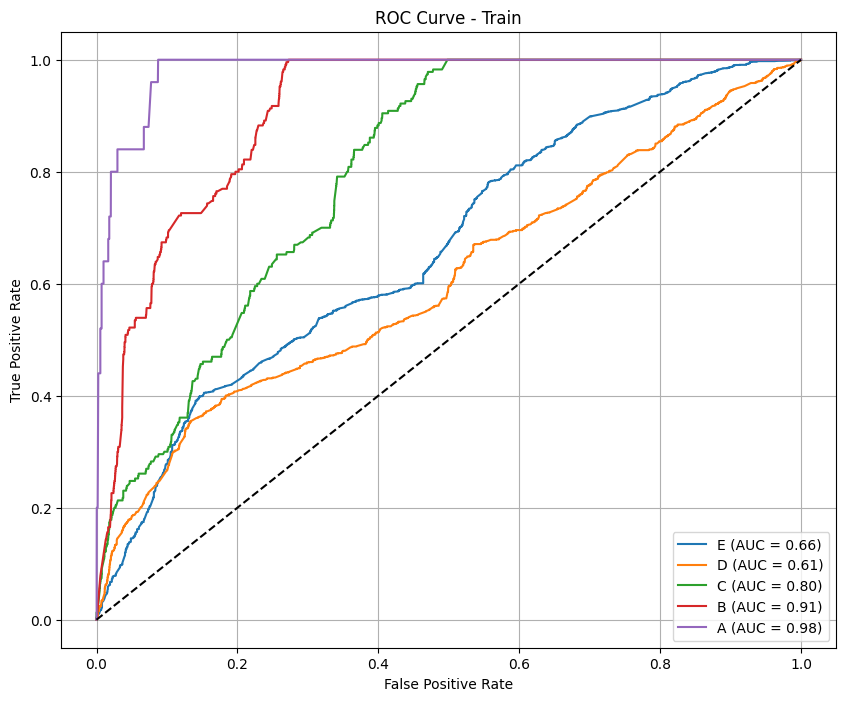

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.83521809 0.01960784 0.05504587 0.         0.15384615]
Precision (per class): [0.82193959 0.1        0.03370787 0.         0.125     ]
Recall (per class): [0.84893268 0.01086957 0.15       0.         0.2       ]
Accuracy: 0.7011
AUC (One-vs-Rest): 0.5754

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.85      0.84       609
           D       0.10      0.01      0.02        92
           C       0.03      0.15      0.06        20
           B       0.00      0.00      0.00        15
           A       0.12      0.20      0.15        10

    accuracy                           0.70       746
   macro avg       0.22      0.24      0.21       746
weighted avg       0.69      0.70      0.69       746



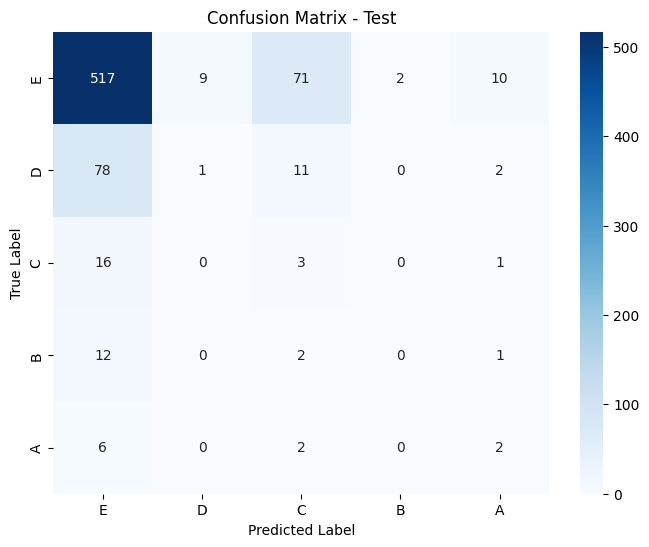

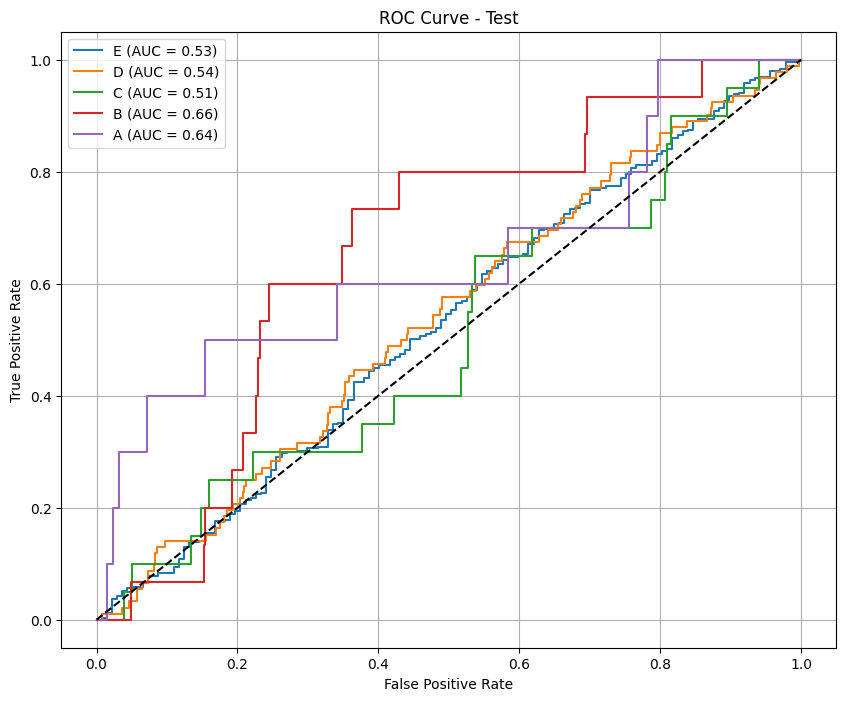

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_minmax.csv
174/174 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
[[0.3882098 ]
 [0.61179024]
 [0.3871968 ]
 [0.61280316]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.38825917]
 [0.61174077]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.3881336 ]
 [0.61186635]
 [0.3882098 ]
 [0.61179024]
 [0.38817617]
 [0.61182386]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.38735908]
 [0.61264086]
 [0.38782543]
 [0.6121746 ]
 [0.3882098 ]
 [0.61179024]
 [0.388123  ]
 [0.611877  ]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.388267  ]
 [0.61173296]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.38727868]
 [0.61272126]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.3882169 ]
 [0.61178315]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.3882098 ]
 [0.61179024]
 [0.39035085]
 [0.6096492 ]
 [0.38

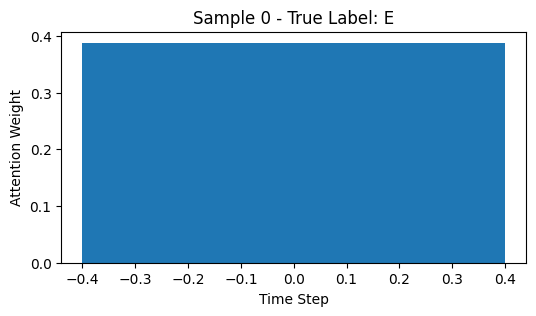

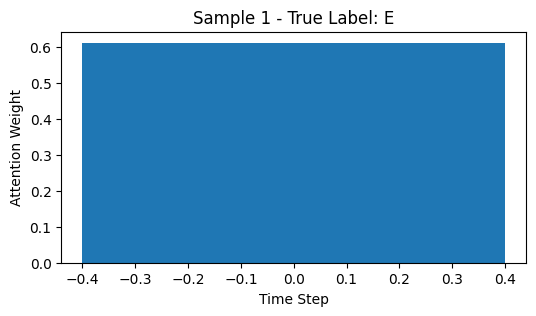

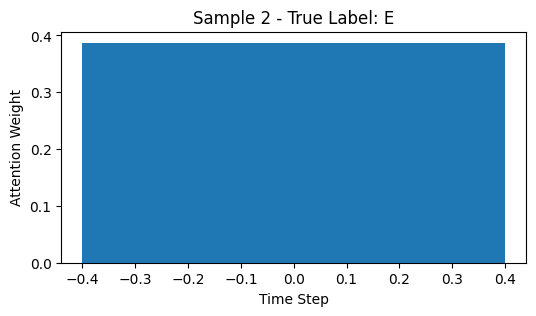

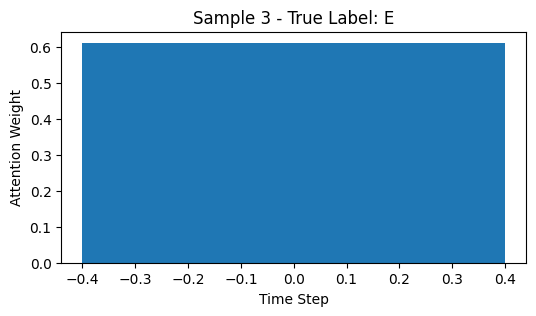

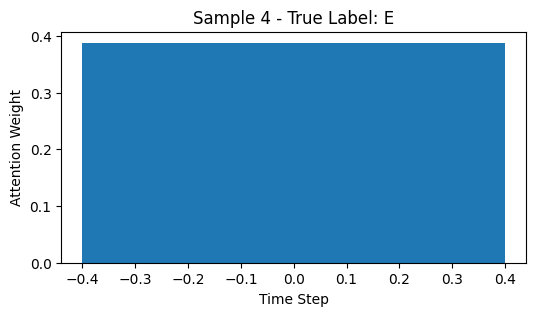

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_84"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_84          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_168 (Dropout)     │ (None, 3, 128)         │              0 │ bidirectional_84[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_85          │ (None, 3, 64)          │         41,216 │ dropout_168[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_85[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_85[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_253 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_84    │ (None, 64)             │            256 │ dense_253[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_252 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_170 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_8… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_169 (Dropout)     │ (None, 64)             │              0 │ dense_252[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_254 (Dense)         │ (None, 32)             │          2,080 │ dropout_170[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_42            │ (None, 96)             │              0 │ dropout_169[0][0],     │
│ (Concatenate)             │                        │                │ dense_254[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 2s 64ms/step

Epoch 1: val_f1_macro = 0.1026
66/66 ━━━━━━━━━━━━━━━━━━━━ 18s 68ms/step - accuracy: 0.2089 - loss: 11.9272 - val_accuracy: 0.2246 - val_loss: 2.2976 - val_f1_macro: 0.1026 - learning_rate: 0.0010
Epoch 2/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.1447
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.2804 - loss: 7.3579 - val_accuracy: 0.3461 - val_loss: 1.7454 - val_f1_macro: 0.1447 - learning_rate: 0.0010
Epoch 3/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.2261
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.2756 - loss: 6.7040 - val_accuracy: 0.3777 - val_loss: 1.5452 - val_f1_macro: 0.2261 - learning_rate: 0.0010
Epoch 4/200
19/19 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.3269
66/66 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step - accuracy: 0.3107 - loss: 5.9717 - val_accuracy: 0.3860 - val_loss: 1.6974 - val_f1_macro: 0.3269 - learning_rate: 0.0010
Epoch 5/200
1

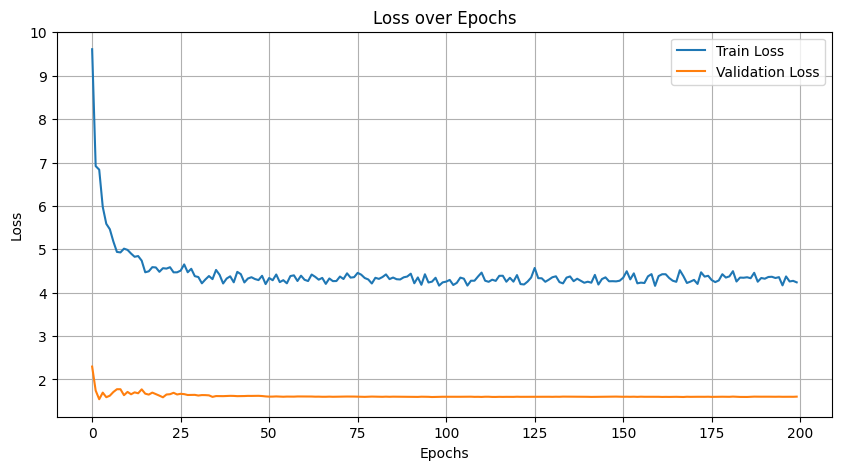

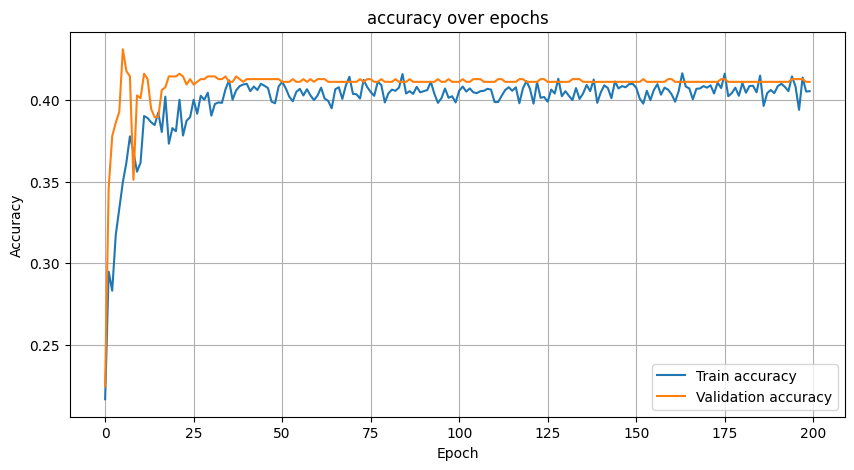

151/151 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step

--- Train Metrics ---
F1 Score (per class): [0.60425043 0.22835634 0.15412677 0.2851711  0.2       ]
Precision (per class): [0.75178657 0.54491018 0.0845     0.23510972 0.1372549 ]
Recall (per class): [0.50512164 0.14444444 0.87564767 0.36231884 0.36842105]
Accuracy: 0.4187
AUC (One-vs-Rest): 0.7828

Classification Report:
              precision    recall  f1-score   support

           E       0.75      0.51      0.60      3124
           D       0.54      0.14      0.23      1260
           C       0.08      0.88      0.15       193
           B       0.24      0.36      0.29       207
           A       0.14      0.37      0.20        19

    accuracy                           0.42      4803
   macro avg       0.35      0.45      0.29      4803
weighted avg       0.65      0.42      0.47      4803



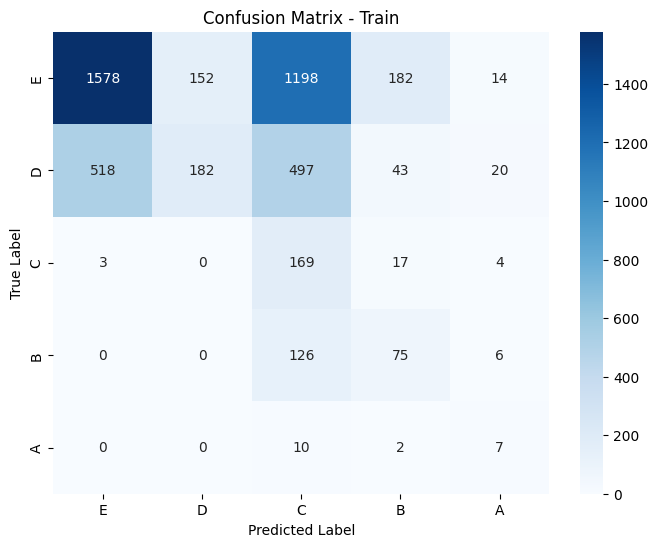

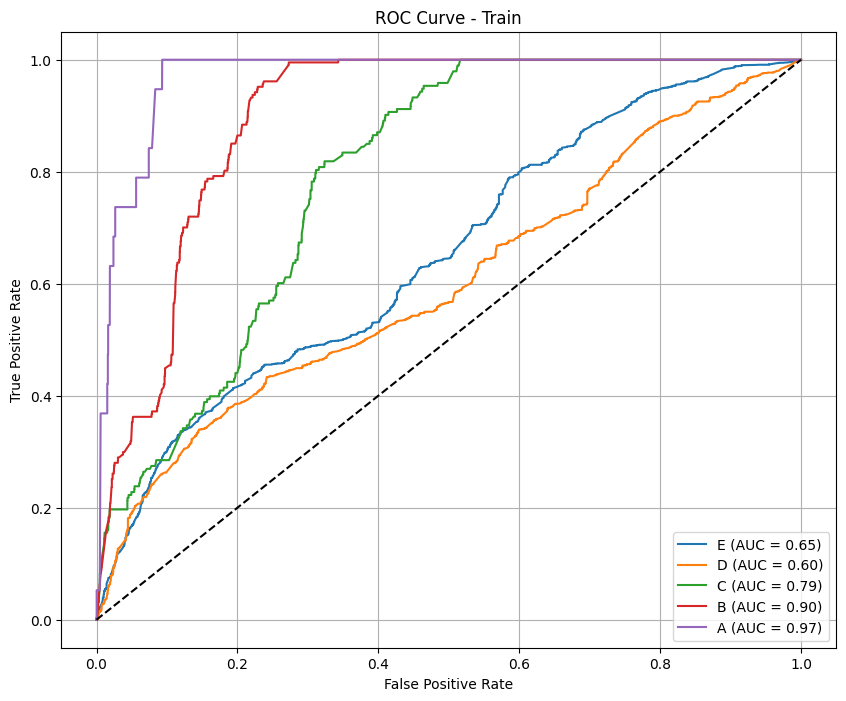

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.46683047 0.13953488 0.01428571 0.06369427 0.        ]
Precision (per class): [0.84070796 0.09813084 0.00833333 0.03546099 0.        ]
Recall (per class): [0.32312925 0.24137931 0.05       0.3125     0.        ]
Accuracy: 0.3010
AUC (One-vs-Rest): 0.5485

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.32      0.47       588
           D       0.10      0.24      0.14        87
           C       0.01      0.05      0.01        20
           B       0.04      0.31      0.06        16
           A       0.00      0.00      0.00        10

    accuracy                           0.30       721
   macro avg       0.20      0.19      0.14       721
weighted avg       0.70      0.30      0.40       721



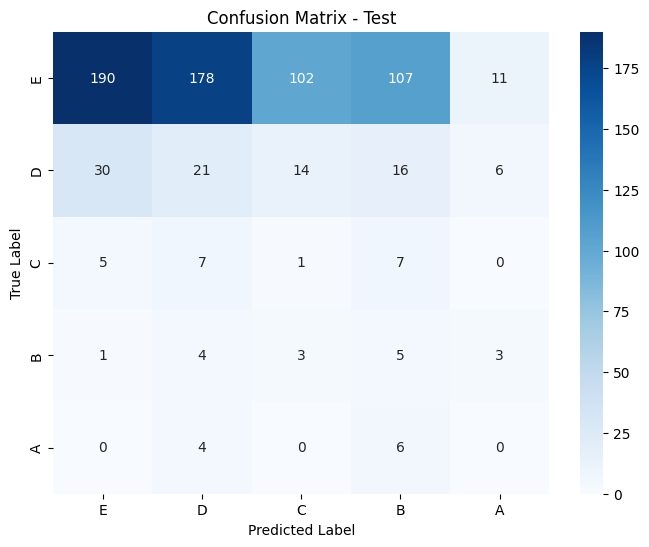

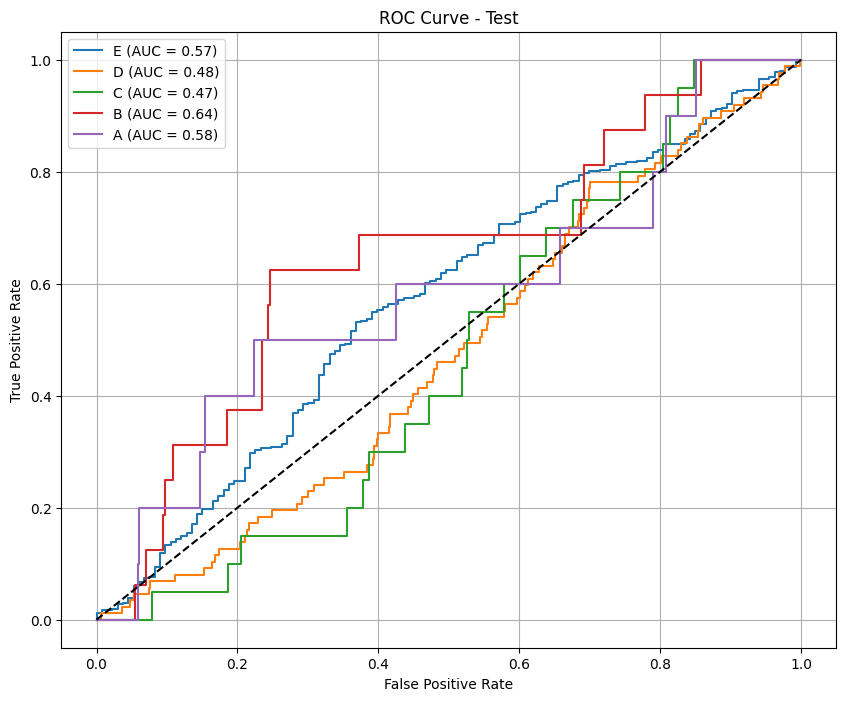

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_minmax.csv
151/151 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step
[[0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279125 ]
 [0.33519945]
 [0.336888  ]
 [0.32789975]
 [0.33520654]
 [0.3368937 ]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.32801157]
 [0.33516318]
 [0.33682522]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.32837877]
 [0.33554363]
 [0.3360776 ]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279653 ]
 [0.33518818]
 [0.33684647]
 [0.3279637 ]
 [0.33518723]
 [0.33684894]
 [0.32796353]
 [0.33525327]
 [0.3

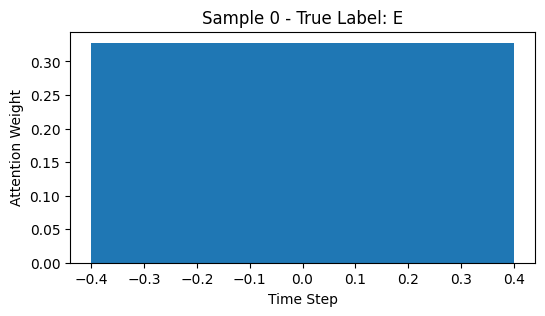

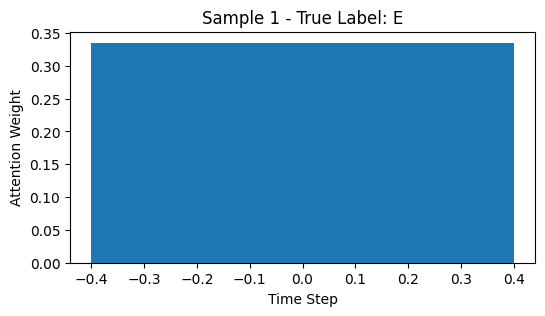

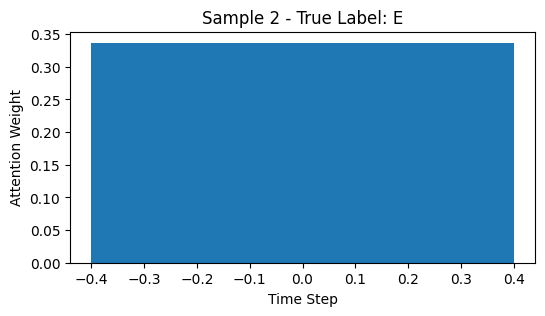

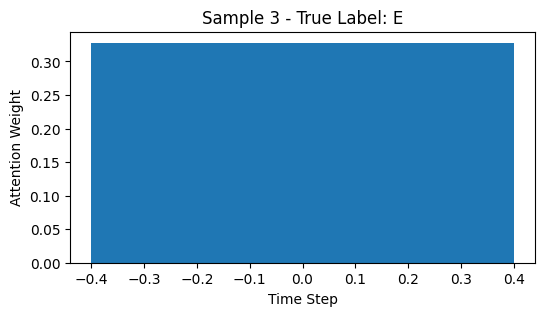

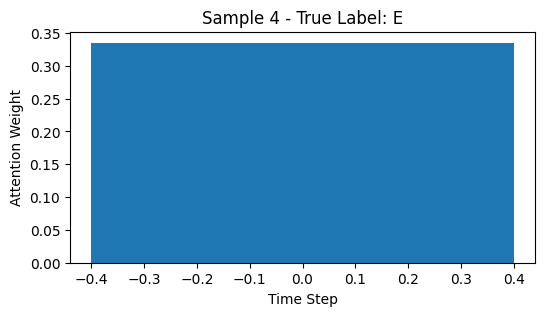

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_86"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_86          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_172 (Dropout)     │ (None, 4, 128)         │              0 │ bidirectional_86[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_87          │ (None, 4, 64)          │         41,216 │ dropout_172[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_87[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_87[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_259 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_86    │ (None, 64)             │            256 │ dense_259[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_258 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_174 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_8… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_173 (Dropout)     │ (None, 64)             │              0 │ dense_258[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_260 (Dense)         │ (None, 32)             │          2,080 │ dropout_174[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_43            │ (None, 96)             │              0 │ dropout_173[0][0],     │
│ (Concatenate)             │                        │                │ dense_260[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 3s 148ms/step

Epoch 1: val_f1_macro = 0.0241
33/33 ━━━━━━━━━━━━━━━━━━━━ 25s 141ms/step - accuracy: 0.1802 - loss: 13.3338 - val_accuracy: 0.0642 - val_loss: 4.3416 - val_f1_macro: 0.0241 - learning_rate: 0.0010
Epoch 2/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 2: val_f1_macro = 0.0297
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.1970 - loss: 9.5539 - val_accuracy: 0.0676 - val_loss: 2.1811 - val_f1_macro: 0.0297 - learning_rate: 0.0010
Epoch 3/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 3: val_f1_macro = 0.0846
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 20ms/step - accuracy: 0.2658 - loss: 8.2885 - val_accuracy: 0.0811 - val_loss: 2.0077 - val_f1_macro: 0.0846 - learning_rate: 0.0010
Epoch 4/200
10/10 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 

Epoch 4: val_f1_macro = 0.1712
33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 19ms/step - accuracy: 0.2394 - loss: 8.4829 - val_accuracy: 0.2601 - val_loss: 1.6547 - val_f1_macro: 0.1712 - learning_rate: 0.0010
Epoch 5/

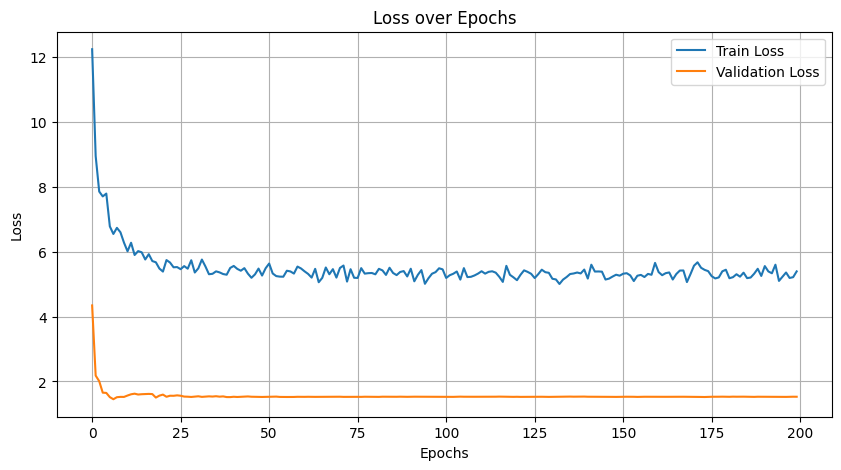

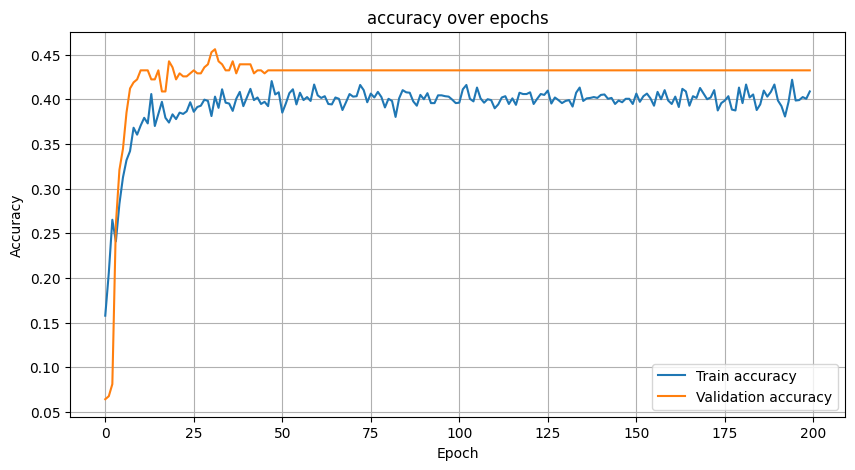

74/74 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step

--- Train Metrics ---
F1 Score (per class): [0.61202186 0.29389788 0.13023256 0.52336449 0.24657534]
Precision (per class): [0.74312796 0.53393665 0.07378129 0.41635688 0.15254237]
Recall (per class): [0.52023889 0.20274914 0.55445545 0.70440252 0.64285714]
Accuracy: 0.4566
AUC (One-vs-Rest): 0.7870

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.52      0.61      1507
           D       0.53      0.20      0.29       582
           C       0.07      0.55      0.13       101
           B       0.42      0.70      0.52       159
           A       0.15      0.64      0.25        14

    accuracy                           0.46      2363
   macro avg       0.38      0.52      0.36      2363
weighted avg       0.64      0.46      0.50      2363



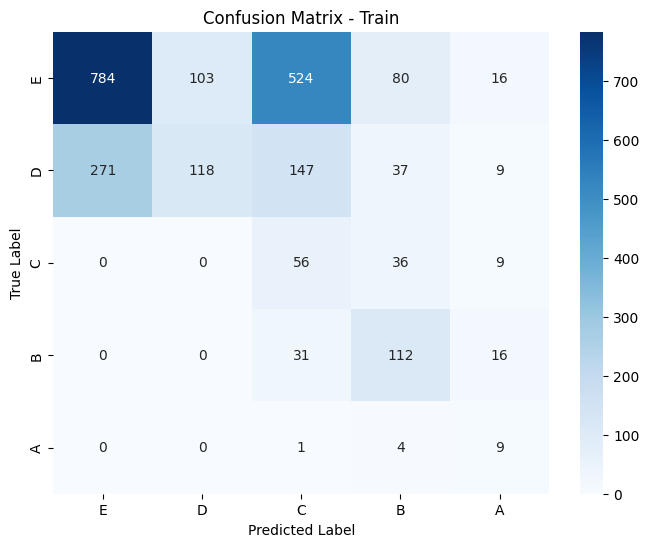

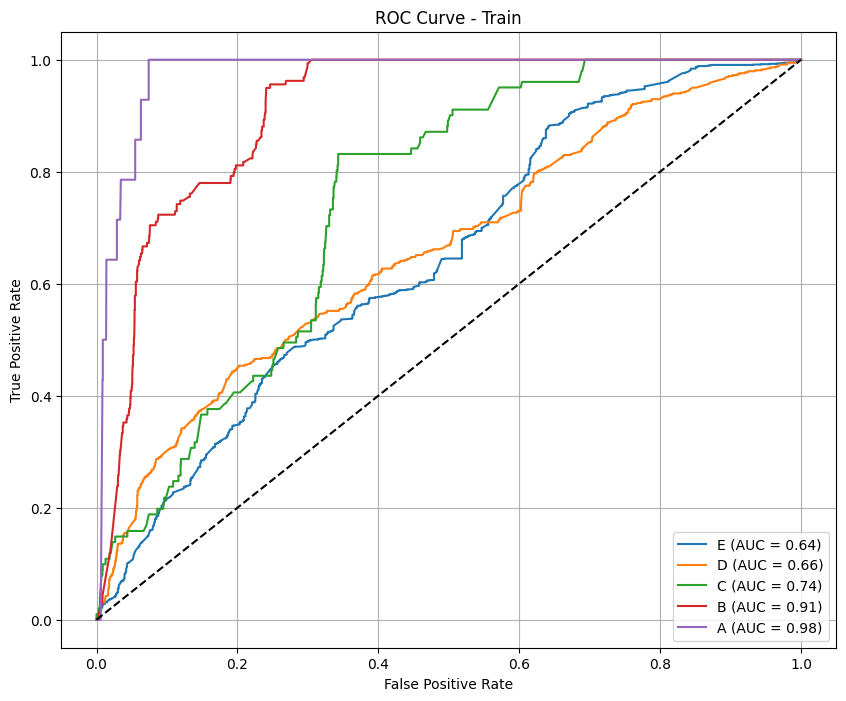

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.66808511 0.19791667 0.03428571 0.         0.05882353]
Precision (per class): [0.81558442 0.17757009 0.01910828 0.         0.04347826]
Recall (per class): [0.56576577 0.22352941 0.16666667 0.         0.09090909]
Accuracy: 0.4905
AUC (One-vs-Rest): 0.5711

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.57      0.67       555
           D       0.18      0.22      0.20        85
           C       0.02      0.17      0.03        18
           B       0.00      0.00      0.00        18
           A       0.04      0.09      0.06        11

    accuracy                           0.49       687
   macro avg       0.21      0.21      0.19       687
weighted avg       0.68      0.49      0.57       687



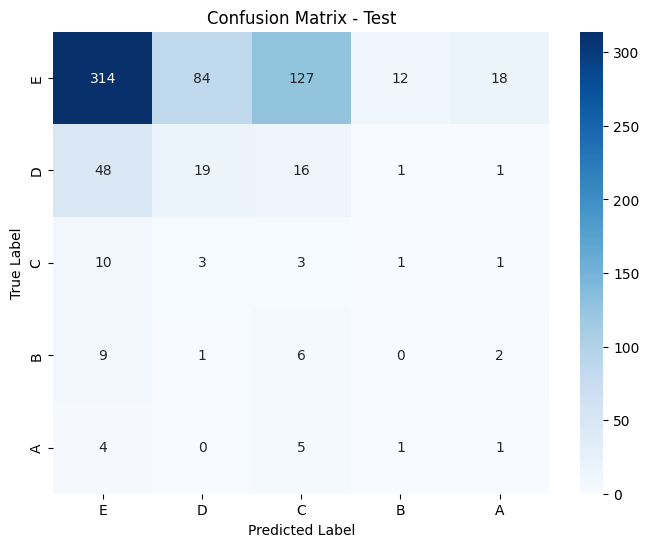

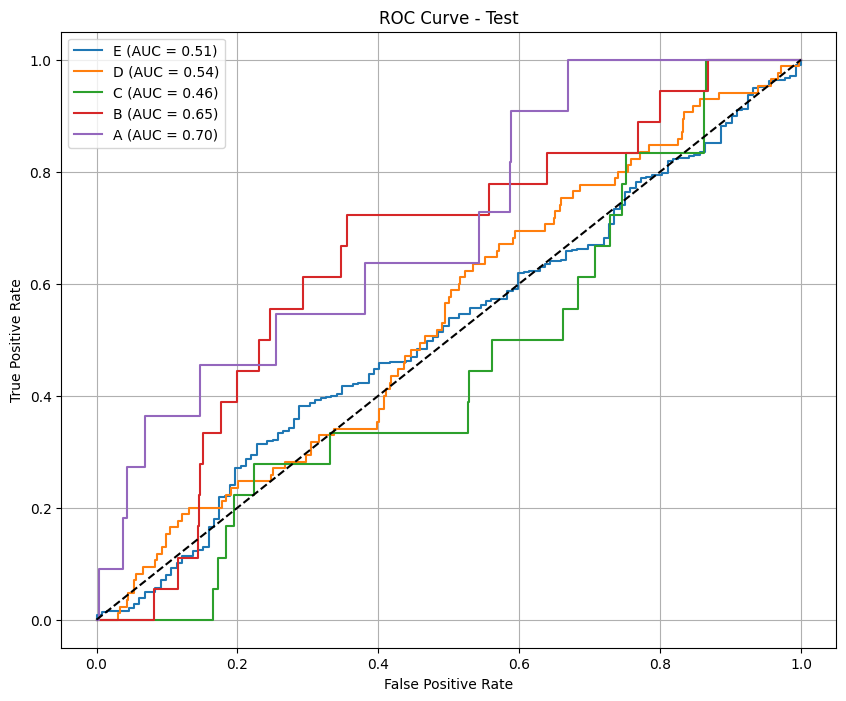

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase4_minmax.csv
74/74 ━━━━━━━━━━━━━━━━━━━━ 2s 18ms/step
[[0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27678433]
 [0.2529814 ]
 [0.24179533]
 [0.22843896]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27731717]
 [0.25350848]
 [0.24206193]
 [0.22711234]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27452424]
 [0.25124922]
 [0.24108395]
 [0.23314255]
 [0.27733824]
 [0.25342357]
 [0.24205585]
 [0.22718236]
 [0.2774742 ]
 [0.25356242]
 [0.2420769 ]
 [0.22688654]
 [0.27729964]
 [0.2533478 ]
 [0.242059  ]
 [0.22729357]
 [0.27729964]
 [0.2533478 ]
 [0.242

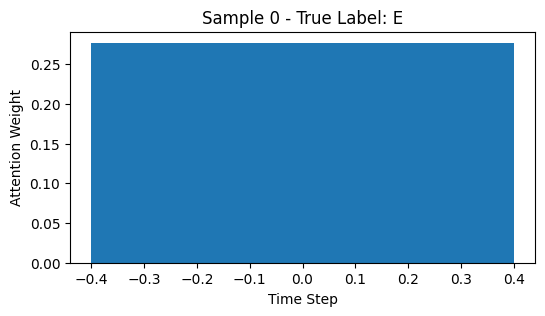

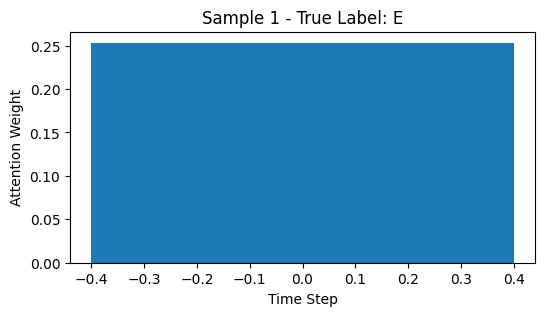

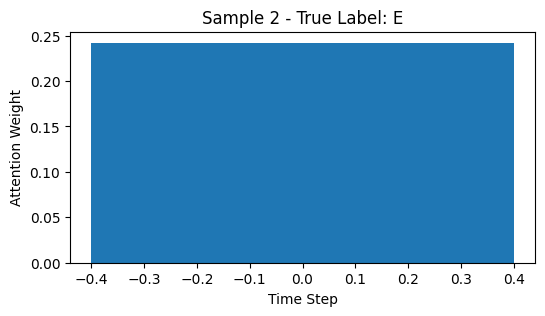

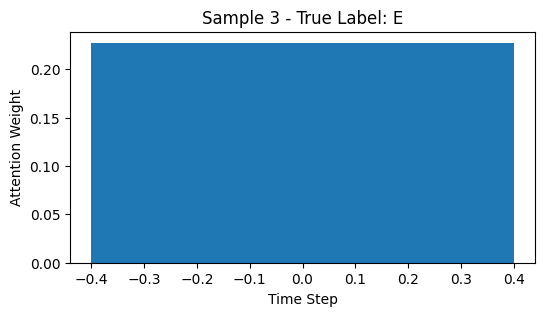

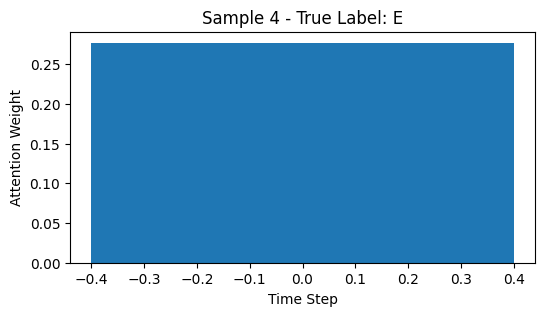

In [41]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_undersample_phase(phase, metric='f1_macro', scale='minmax') 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10570 entries, 0 to 10569
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   user_id                              10570 non-null  object 
 1   school                               6715 non-null   object 
 2   course_id                            10570 non-null  object 
 3   field_encoded_1                      10570 non-null  int64  
 4   field_encoded_2                      10570 non-null  int64  
 5   start_year                           10570 non-null  float64
 6   start_month                          10570 non-null  float64
 7   end_year                             10570 non-null  float64
 8   end_month                            10570 non-null  float64
 9   user_year                            10570 non-null  float64
 10  user_month                           10570 non-null  float64
 11  video_count                 

Model: "functional_88"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 1, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_88          │ (None, 1, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_176 (Dropout)     │ (None, 1, 128)         │              0 │ bidirectional_88[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_89          │ (None, 1, 64)          │         41,216 │ dropout_176[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 1, 1)           │             65 │ bidirectional_89[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 1, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 1, 64)          │              0 │ bidirectional_89[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_265 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_88    │ (None, 64)             │            256 │ dense_265[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_264 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_178 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_8… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_177 (Dropout)     │ (None, 64)             │              0 │ dense_264[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_266 (Dense)         │ (None, 32)             │          2,080 │ dropout_178[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_44            │ (None, 96)             │              0 │ dropout_177[0][0],     │
│ (Concatenate)             │                        │                │ dense_266[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200


You are using a softmax over axis 1 of a tensor of shape (None, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


169/169 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - accuracy: 0.1500 - loss: 17.9463

You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


49/49 ━━━━━━━━━━━━━━━━━━━━ 2s 26ms/step

Epoch 1: val_f1_macro = 0.2373
169/169 ━━━━━━━━━━━━━━━━━━━━ 19s 32ms/step - accuracy: 0.1501 - loss: 17.9258 - val_accuracy: 0.2773 - val_loss: 2.2029 - val_f1_macro: 0.2373 - learning_rate: 0.0010
Epoch 2/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 2: val_f1_macro = 0.2569
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - accuracy: 0.2052 - loss: 10.6313 - val_accuracy: 0.3006 - val_loss: 2.2726 - val_f1_macro: 0.2569 - learning_rate: 0.0010
Epoch 3/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 3: val_f1_macro = 0.3947
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.2278 - loss: 9.9582 - val_accuracy: 0.3818 - val_loss: 2.0866 - val_f1_macro: 0.3947 - learning_rate: 0.0010
Epoch 4/200
49/49 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

Epoch 4: val_f1_macro = 0.3650
169/169 ━━━━━━━━━━━━━━━━━━━━ 2s 9ms/step - accuracy: 0.2893 - loss: 8.9689 - val_accuracy: 0.3701 - val_loss: 2.0709 - val_f1_macro: 0.3650 - learning_rate: 0.0010
Epoch 5/200
49/49 

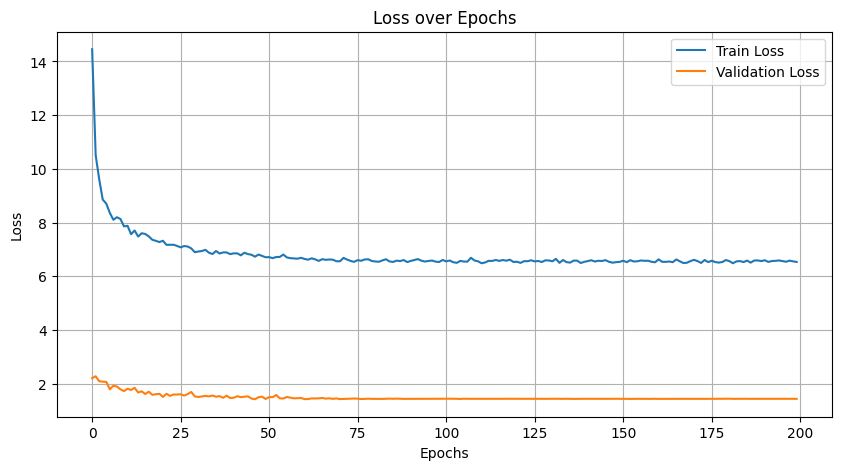

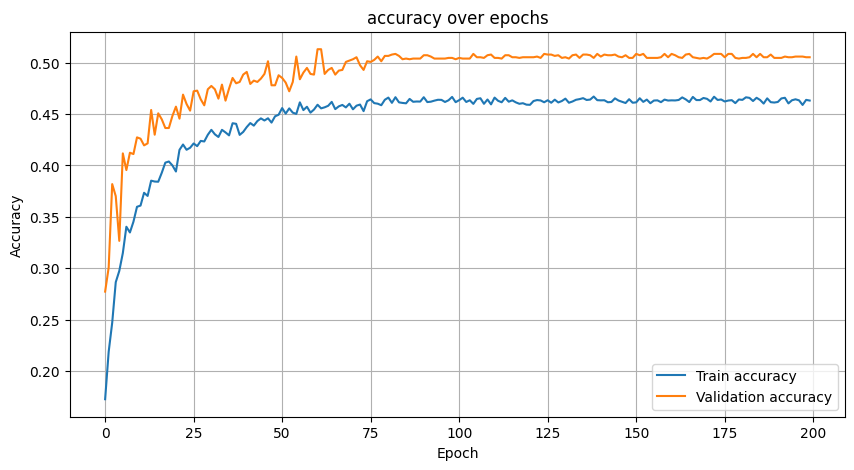

385/385 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.63939009 0.30773118 0.33367814 0.31986532 0.50759219]
Precision (per class): [0.77926905 0.67741935 0.20538476 0.43577982 0.3627907 ]
Recall (per class): [0.54208561 0.19908467 0.88897638 0.25265957 0.84476534]
Accuracy: 0.4818
AUC (One-vs-Rest): 0.8245

Classification Report:
              precision    recall  f1-score   support

           E       0.78      0.54      0.64      6962
           D       0.68      0.20      0.31      3059
           C       0.21      0.89      0.33      1270
           B       0.44      0.25      0.32       752
           A       0.36      0.84      0.51       277

    accuracy                           0.48     12320
   macro avg       0.49      0.55      0.42     12320
weighted avg       0.66      0.48      0.50     12320



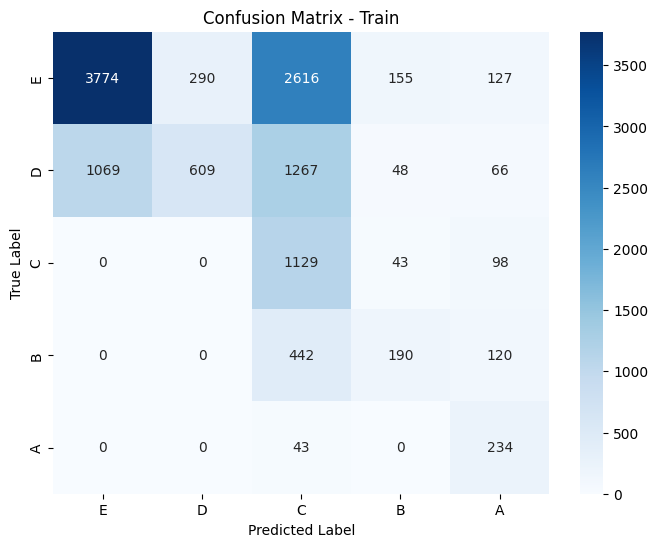

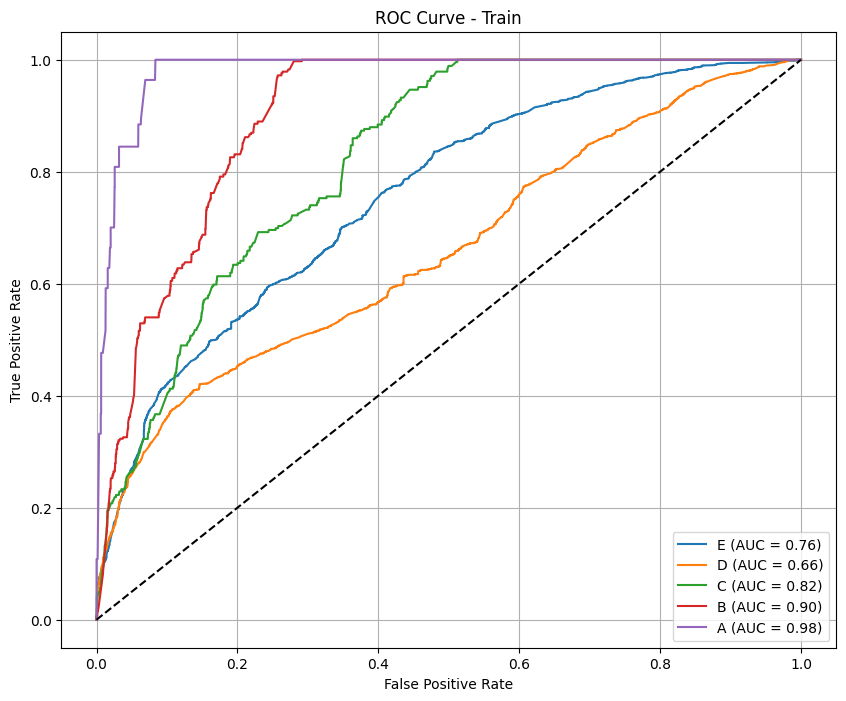

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.69615385 0.29864253 0.03921569 0.         0.12195122]
Precision (per class): [0.85377358 0.25984252 0.02255639 0.         0.06944444]
Recall (per class): [0.58766234 0.35106383 0.15       0.         0.5       ]
Accuracy: 0.5331
AUC (One-vs-Rest): 0.5931

Classification Report:
              precision    recall  f1-score   support

           E       0.85      0.59      0.70       616
           D       0.26      0.35      0.30        94
           C       0.02      0.15      0.04        20
           B       0.00      0.00      0.00        16
           A       0.07      0.50      0.12        10

    accuracy                           0.53       756
   macro avg       0.24      0.32      0.23       756
weighted avg       0.73      0.53      0.61       756



Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


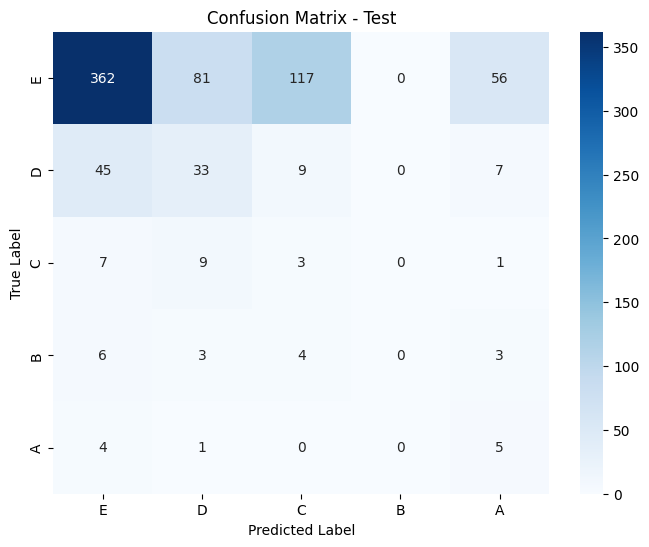

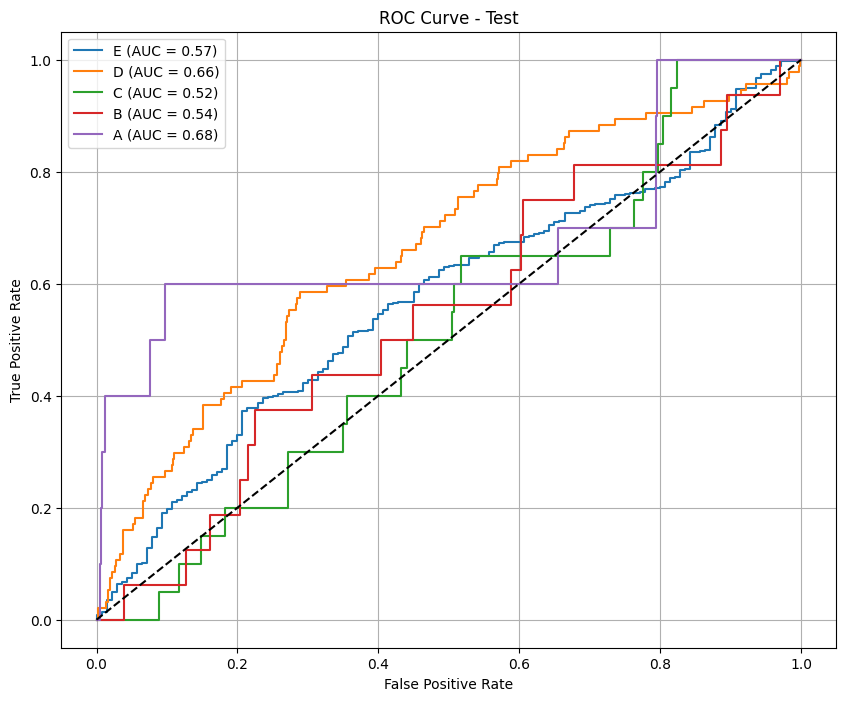

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase1_minmax.csv


You are using a softmax over axis 1 of a tensor of shape (32, 1, 1). This axis has size 1. The softmax operation will always return the value 1, which is likely not what you intended. Did you mean to use a sigmoid instead?


385/385 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
[[0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.99999994]
 [0.999

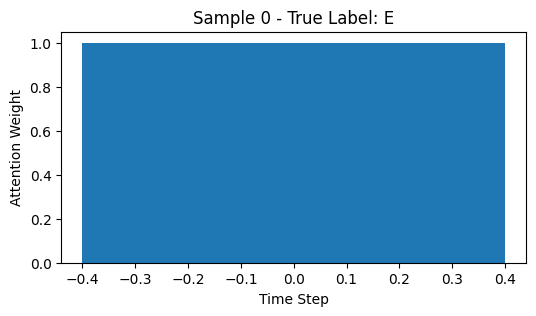

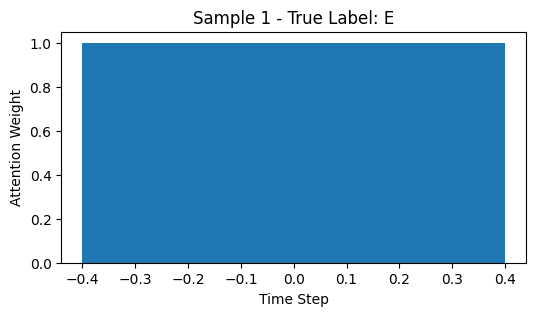

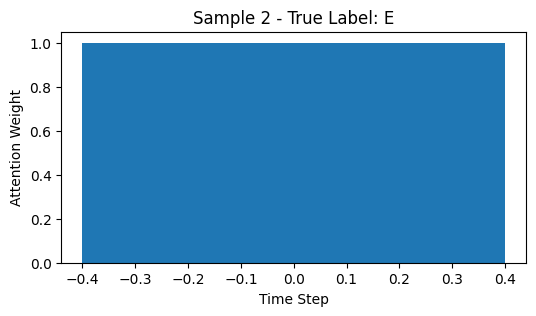

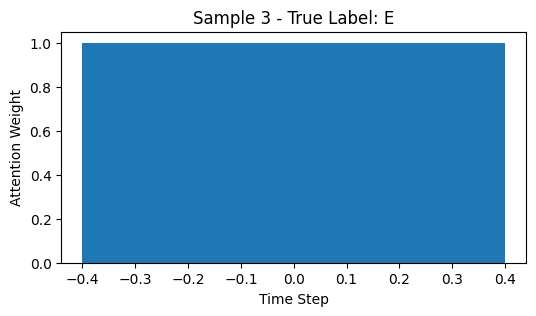

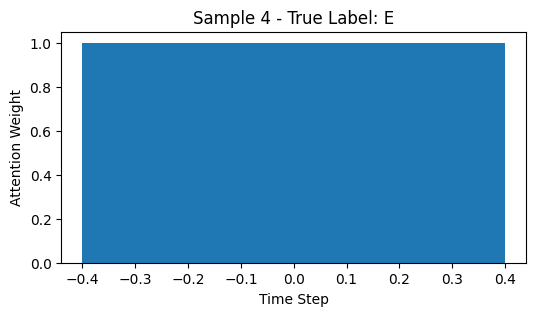

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8548 entries, 0 to 8547
Columns: 113 entries, user_id to label_encoded
dtypes: float64(100), int64(9), object(4)
memory usage: 7.4+ MB
None


Model: "functional_90"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 2, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_90          │ (None, 2, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_180 (Dropout)     │ (None, 2, 128)         │              0 │ bidirectional_90[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_91          │ (None, 2, 64)          │         41,216 │ dropout_180[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 2, 1)           │             65 │ bidirectional_91[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 2, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 2, 64)          │              0 │ bidirectional_91[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_271 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_90    │ (None, 64)             │            256 │ dense_271[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_270 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_182 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_9… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_181 (Dropout)     │ (None, 64)             │              0 │ dense_270[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_272 (Dense)         │ (None, 32)             │          2,080 │ dropout_182[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_45            │ (None, 96)             │              0 │ dropout_181[0][0],     │
│ (Concatenate)             │                        │                │ dense_272[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 2s 32ms/step

Epoch 1: val_f1_macro = 0.1817
141/141 ━━━━━━━━━━━━━━━━━━━━ 19s 37ms/step - accuracy: 0.2078 - loss: 23.4895 - val_accuracy: 0.2787 - val_loss: 1.9796 - val_f1_macro: 0.1817 - learning_rate: 0.0010
Epoch 2/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2552
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.2483 - loss: 12.8559 - val_accuracy: 0.2958 - val_loss: 2.2955 - val_f1_macro: 0.2552 - learning_rate: 0.0010
Epoch 3/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.3546
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.2858 - loss: 11.0948 - val_accuracy: 0.3610 - val_loss: 2.2780 - val_f1_macro: 0.3546 - learning_rate: 0.0010
Epoch 4/200
41/41 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.3808
141/141 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step - accuracy: 0.2944 - loss: 10.0578 - val_accuracy: 0.3618 - val_loss: 2.2420 - val_f1_macro: 0.3808 - learning_rate: 0.0010
Ep

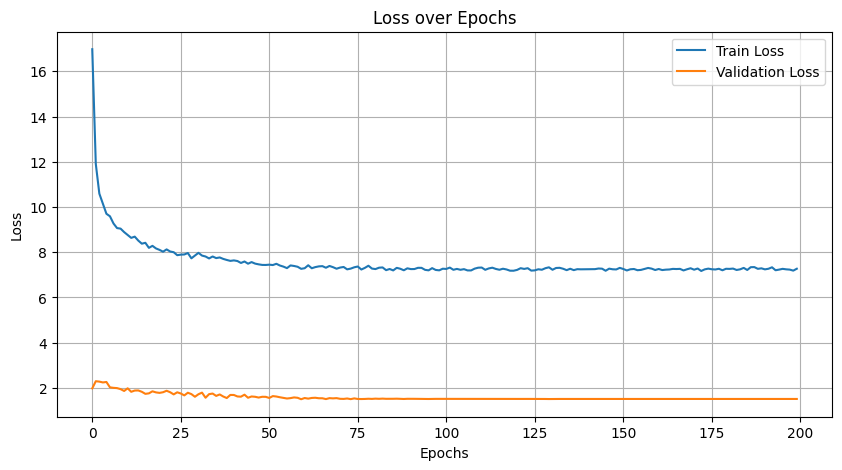

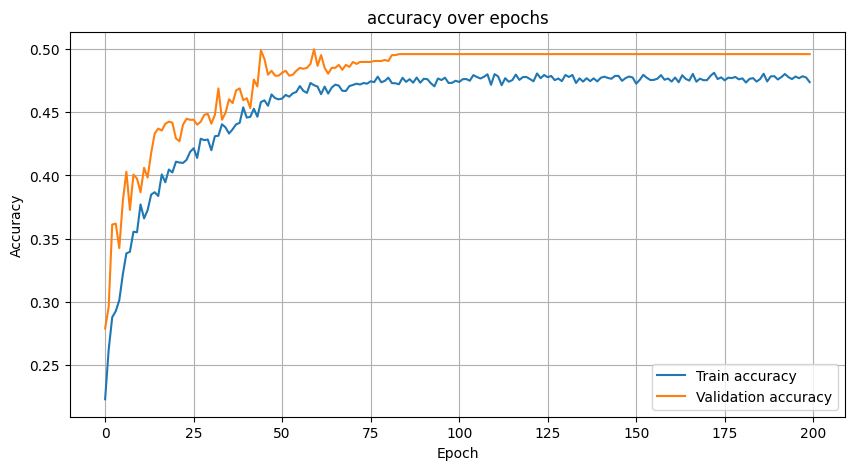

322/322 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step

--- Train Metrics ---
F1 Score (per class): [0.65464661 0.26657912 0.37887766 0.32491582 0.50326797]
Precision (per class): [0.77753304 0.67330017 0.24112689 0.42139738 0.3592535 ]
Recall (per class): [0.56530249 0.16618911 0.88373984 0.26438356 0.84      ]
Accuracy: 0.4947
AUC (One-vs-Rest): 0.8266

Classification Report:
              precision    recall  f1-score   support

           E       0.78      0.57      0.65      5620
           D       0.67      0.17      0.27      2443
           C       0.24      0.88      0.38      1230
           B       0.42      0.26      0.32       730
           A       0.36      0.84      0.50       275

    accuracy                           0.49     10298
   macro avg       0.49      0.54      0.43     10298
weighted avg       0.65      0.49      0.50     10298



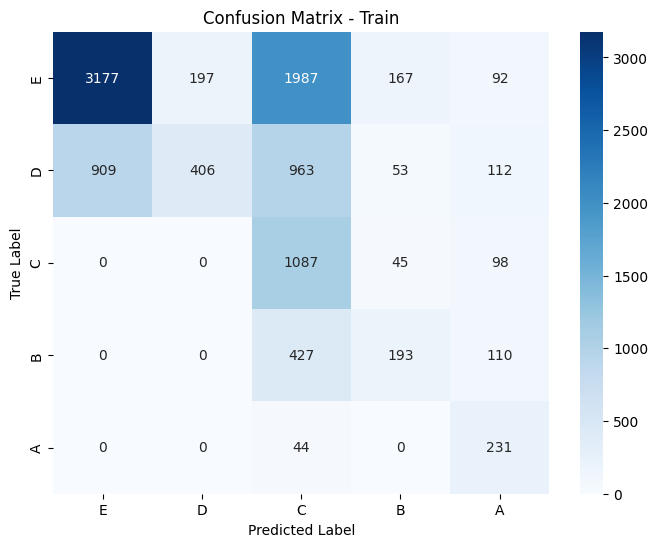

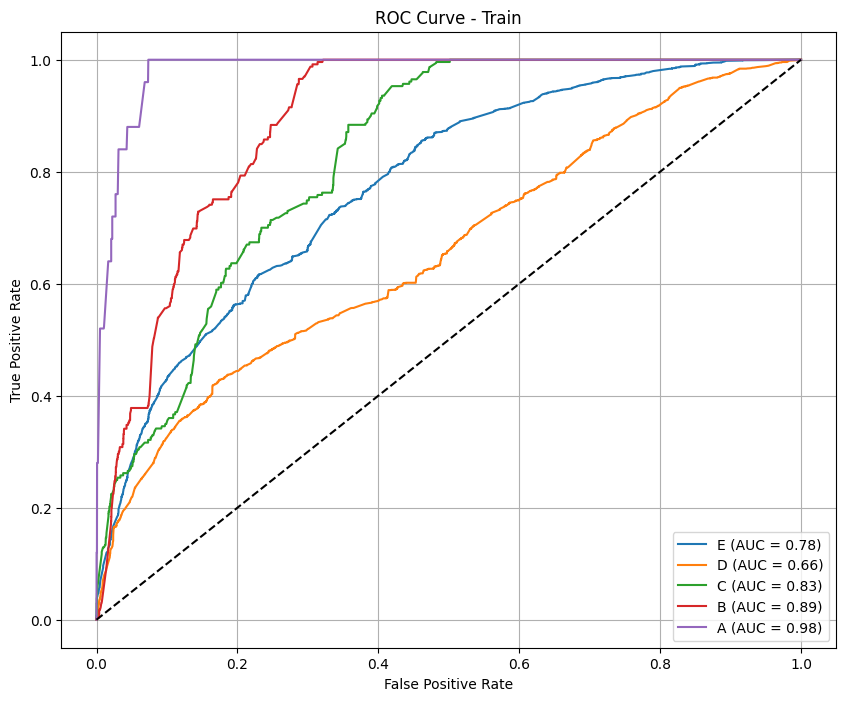

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step

--- Test Metrics ---
F1 Score (per class): [0.8109029  0.1754386  0.         0.1        0.11764706]
Precision (per class): [0.84247788 0.18987342 0.         0.2        0.06896552]
Recall (per class): [0.7816092  0.16304348 0.         0.06666667 0.4       ]
Accuracy: 0.6649
AUC (One-vs-Rest): 0.5936

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.78      0.81       609
           D       0.19      0.16      0.18        92
           C       0.00      0.00      0.00        20
           B       0.20      0.07      0.10        15
           A       0.07      0.40      0.12        10

    accuracy                           0.66       746
   macro avg       0.26      0.28      0.24       746
weighted avg       0.72      0.66      0.69       746



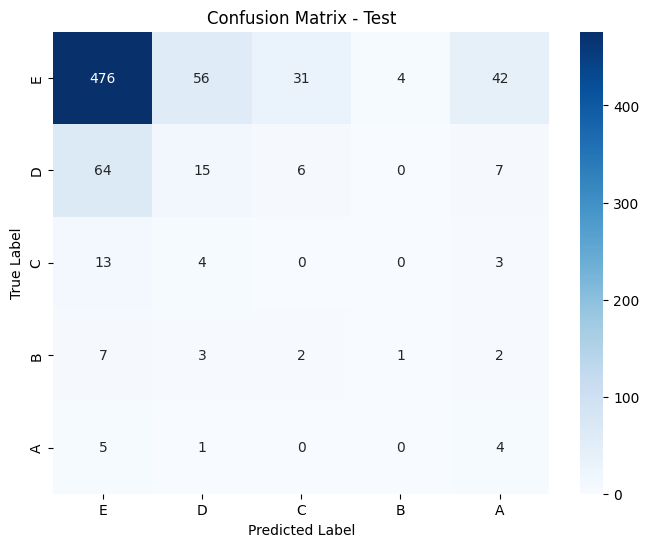

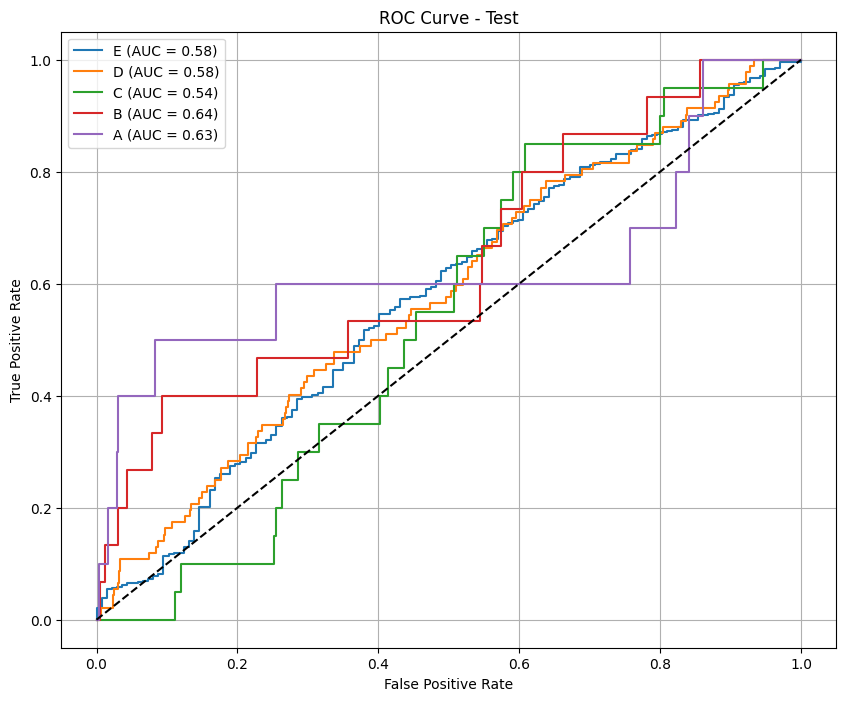

24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Results saved: lstm_results_phase2_minmax.csv
322/322 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step
[[0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.5027921 ]
 [0.4972079 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.5027481 ]
 [0.4972518 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50275713]
 [0.49724284]
 [0.50274986]
 [0.49725017]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50274986]
 [0.49725017]
 [0.50275177]
 [0.4972482 ]
 [0.50275177]
 [0.4972482 ]
 [0.50

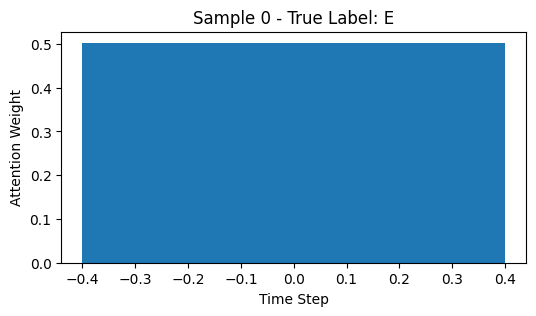

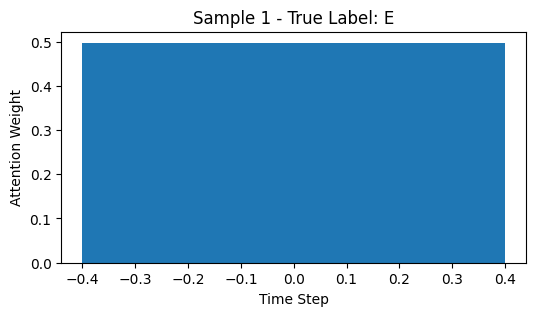

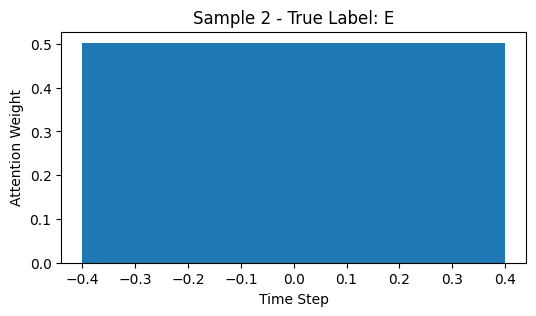

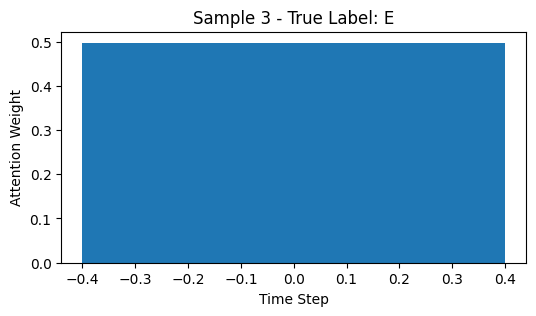

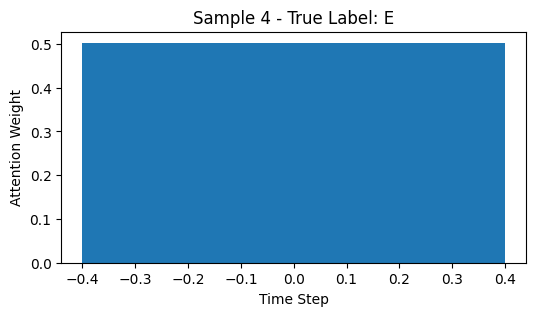

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7803 entries, 0 to 7802
Columns: 156 entries, user_id to label_encoded
dtypes: float64(143), int64(9), object(4)
memory usage: 9.3+ MB
None


Model: "functional_92"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 3, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_92          │ (None, 3, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_184 (Dropout)     │ (None, 3, 128)         │              0 │ bidirectional_92[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_93          │ (None, 3, 64)          │         41,216 │ dropout_184[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 3, 1)           │             65 │ bidirectional_93[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 3, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 3, 64)          │              0 │ bidirectional_93[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_277 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_92    │ (None, 64)             │            256 │ dense_277[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_276 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_186 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_9… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_185 (Dropout)     │ (None, 64)             │              0 │ dense_276[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_278 (Dense)         │ (None, 32)             │          2,080 │ dropout_186[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_46            │ (None, 96)             │              0 │ dropout_185[0][0],     │
│ (Concatenate)             │                        │                │ dense_278[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 2s 35ms/step

Epoch 1: val_f1_macro = 0.2090
131/131 ━━━━━━━━━━━━━━━━━━━━ 26s 43ms/step - accuracy: 0.2661 - loss: 27.9804 - val_accuracy: 0.2912 - val_loss: 1.7760 - val_f1_macro: 0.2090 - learning_rate: 0.0010
Epoch 2/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.2541
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.2553 - loss: 12.5552 - val_accuracy: 0.3088 - val_loss: 2.3732 - val_f1_macro: 0.2541 - learning_rate: 0.0010
Epoch 3/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 3: val_f1_macro = 0.3020
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.2756 - loss: 11.2508 - val_accuracy: 0.2971 - val_loss: 2.3192 - val_f1_macro: 0.3020 - learning_rate: 0.0010
Epoch 4/200
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.3531
131/131 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.2804 - loss: 10.8979 - val_accuracy: 0.4084 - val_loss: 2.0465 - val_f1_macro: 0.3531 - learning_rate: 0.0010
Ep

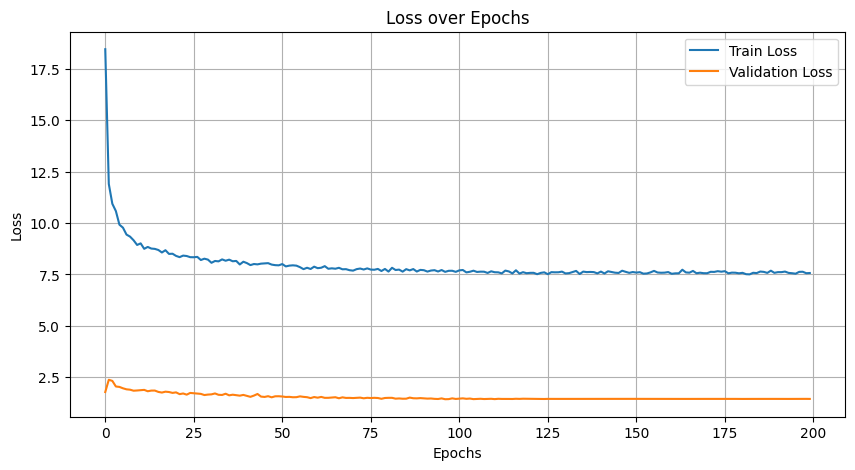

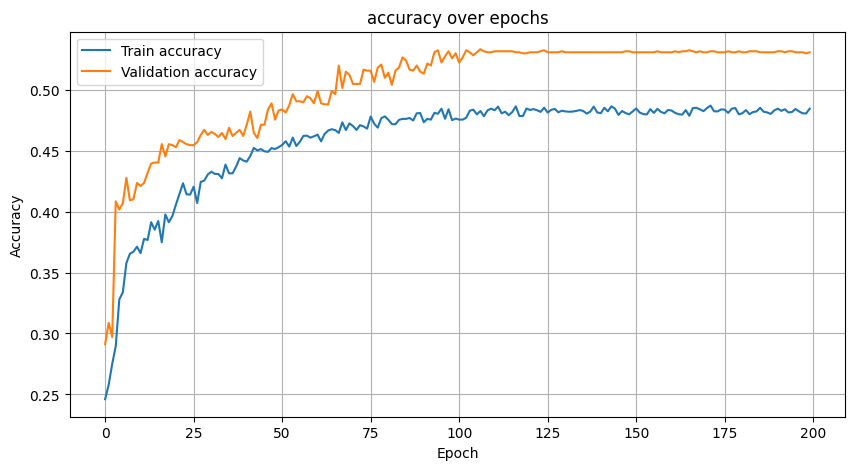

299/299 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.67923288 0.26887791 0.41718282 0.35003855 0.50177515]
Precision (per class): [0.77455636 0.66376307 0.27387198 0.38474576 0.36805556]
Recall (per class): [0.60480094 0.16858407 0.87510478 0.32107496 0.78810409]
Accuracy: 0.5195
AUC (One-vs-Rest): 0.8285

Classification Report:
              precision    recall  f1-score   support

           E       0.77      0.60      0.68      5124
           D       0.66      0.17      0.27      2260
           C       0.27      0.88      0.42      1193
           B       0.38      0.32      0.35       707
           A       0.37      0.79      0.50       269

    accuracy                           0.52      9553
   macro avg       0.49      0.55      0.44      9553
weighted avg       0.65      0.52      0.52      9553



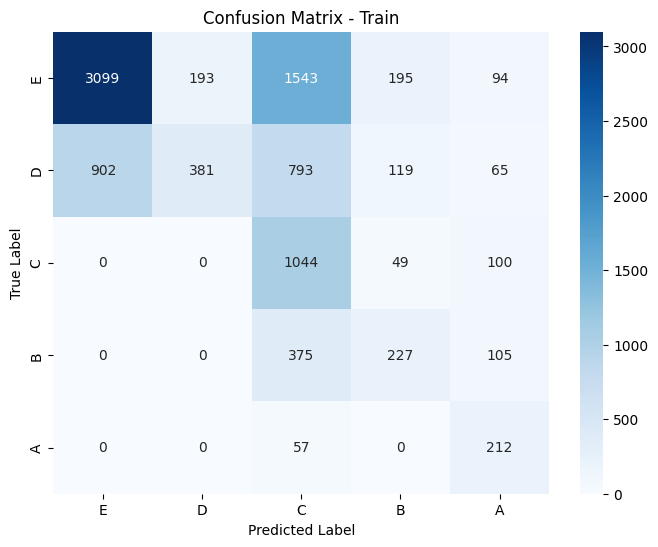

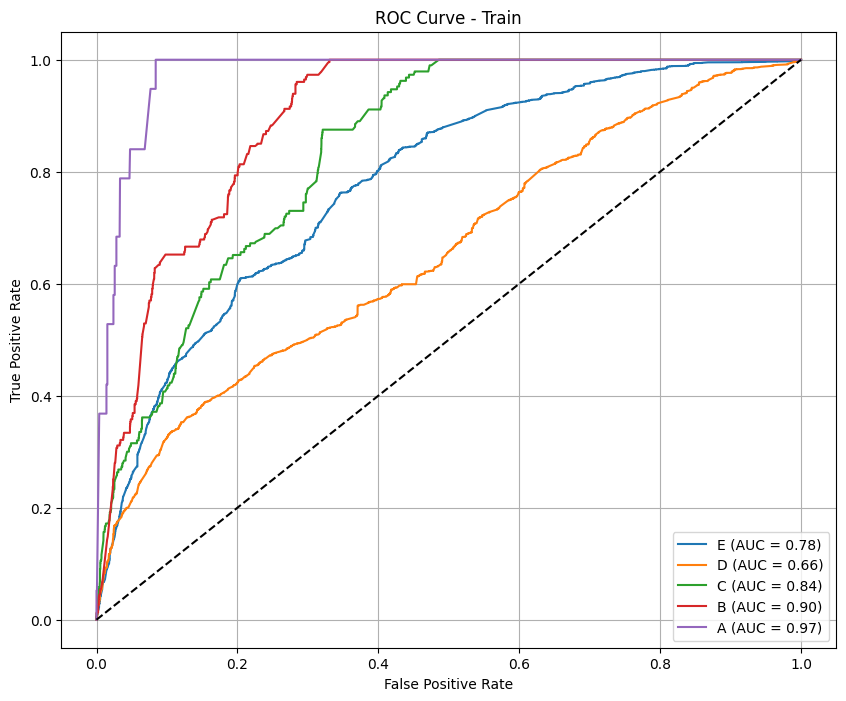

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

--- Test Metrics ---
F1 Score (per class): [0.66391753 0.16312057 0.         0.13333333 0.13793103]
Precision (per class): [0.84293194 0.11794872 0.         0.14285714 0.08333333]
Recall (per class): [0.54761905 0.26436782 0.         0.125      0.4       ]
Accuracy: 0.4868
AUC (One-vs-Rest): 0.5707

Classification Report:
              precision    recall  f1-score   support

           E       0.84      0.55      0.66       588
           D       0.12      0.26      0.16        87
           C       0.00      0.00      0.00        20
           B       0.14      0.12      0.13        16
           A       0.08      0.40      0.14        10

    accuracy                           0.49       721
   macro avg       0.24      0.27      0.22       721
weighted avg       0.71      0.49      0.57       721



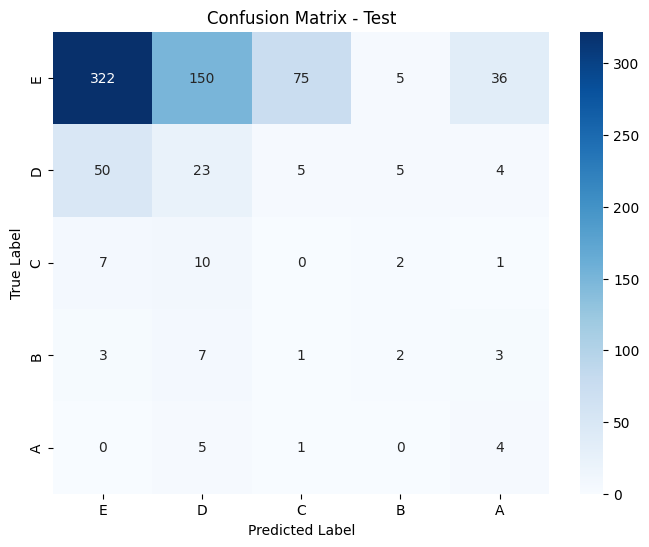

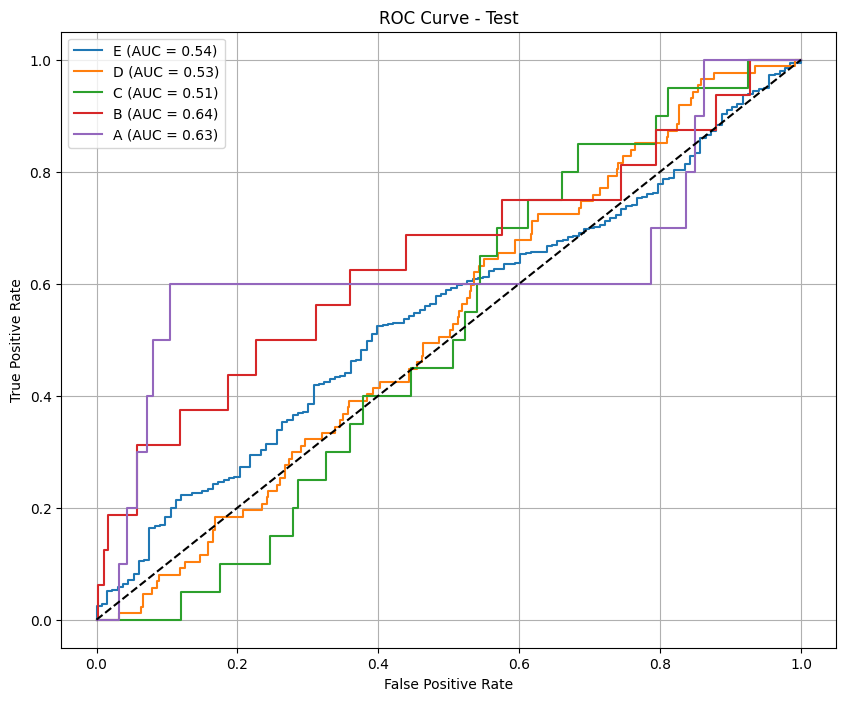

23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
Results saved: lstm_results_phase3_minmax.csv
299/299 ━━━━━━━━━━━━━━━━━━━━ 3s 7ms/step
[[0.3339771 ]
 [0.33128855]
 [0.33473426]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33373427]
 [0.3311061 ]
 [0.33515963]
 [0.33403763]
 [0.3312429 ]
 [0.33471942]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.3340362 ]
 [0.33124128]
 [0.33472255]
 [0.33403698]
 [0.33124658]
 [0.33471647]
 [0.33403698]
 [0.33124658]
 [0.33

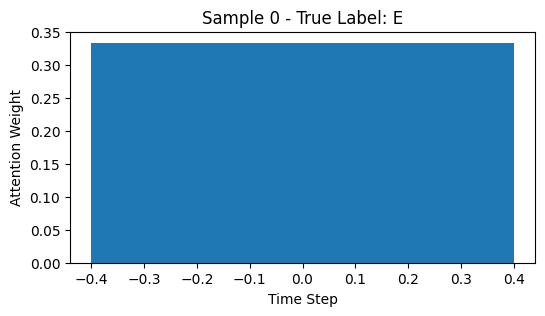

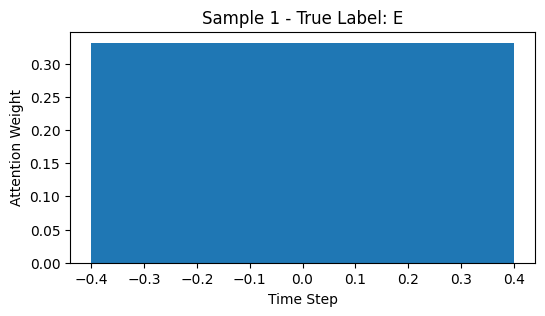

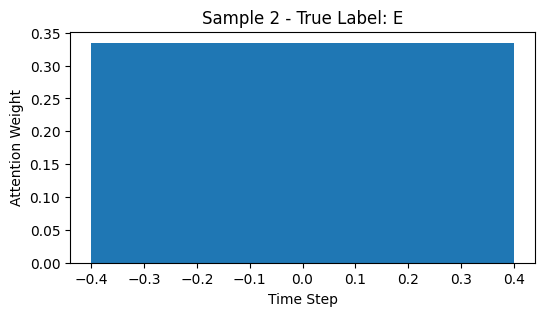

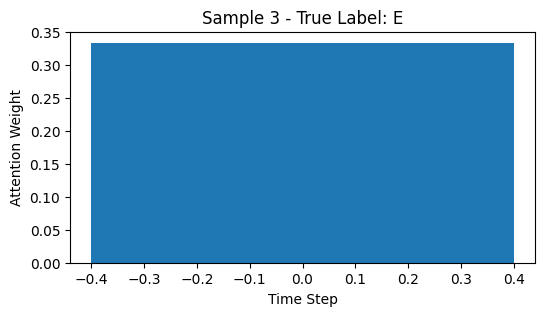

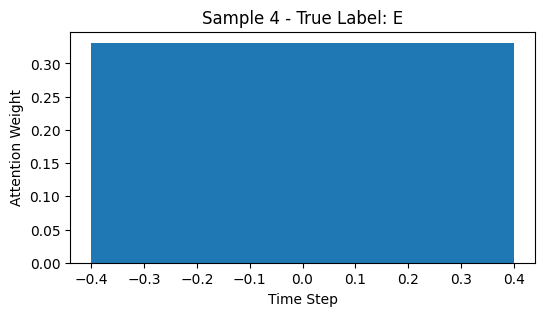

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5363 entries, 0 to 5362
Columns: 199 entries, user_id to label_encoded
dtypes: float64(186), int64(9), object(4)
memory usage: 8.1+ MB
None


Model: "functional_94"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ sequence_input            │ (None, 4, 43)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_94          │ (None, 4, 128)         │         55,296 │ sequence_input[0][0]   │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_188 (Dropout)     │ (None, 4, 128)         │              0 │ bidirectional_94[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ bidirectional_95          │ (None, 4, 64)          │         41,216 │ dropout_188[0][0]      │
│ (Bidirectional)           │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_dense (Dense)   │ (None, 4, 1)           │             65 │ bidirectional_95[0][0] │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_weights         │ (None, 4, 1)           │              0 │ attention_dense[0][0]  │
│ (Softmax)                 │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ static_input (InputLayer) │ (None, 21)             │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ attention_multiply        │ (None, 4, 64)          │              0 │ bidirectional_95[0][0… │
│ (Multiply)                │                        │                │ attention_weights[0][… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_283 (Dense)         │ (None, 64)             │          1,408 │ static_input[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ context_vector (Lambda)   │ (None, 64)             │              0 │ attention_multiply[0]… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ batch_normalization_94    │ (None, 64)             │            256 │ dense_283[0][0]        │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_282 (Dense)         │ (None, 64)             │          4,160 │ context_vector[0][0]   │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_190 (Dropout)     │ (None, 64)             │              0 │ batch_normalization_9… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dropout_189 (Dropout)     │ (None, 64)             │              0 │ dense_282[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_284 (Dense)         │ (None, 32)             │          2,080 │ dropout_190[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_47            │ (None, 96)             │              0 │ dropout_189[0][0],     │
│ (Concatenate)             │                        │                │ dense_284[0][0]        │
├──────────────────────

 Total params: 125,990 (492.15 KB)

 Trainable params: 125,606 (490.65 KB)

 Non-trainable params: 384 (1.50 KB)

Epoch 1/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 2s 44ms/step

Epoch 1: val_f1_macro = 0.1605
98/98 ━━━━━━━━━━━━━━━━━━━━ 19s 51ms/step - accuracy: 0.1759 - loss: 24.4611 - val_accuracy: 0.1472 - val_loss: 2.7436 - val_f1_macro: 0.1605 - learning_rate: 0.0010
Epoch 2/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 2: val_f1_macro = 0.3159
98/98 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step - accuracy: 0.2262 - loss: 15.8693 - val_accuracy: 0.3472 - val_loss: 2.3732 - val_f1_macro: 0.3159 - learning_rate: 0.0010
Epoch 3/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step

Epoch 3: val_f1_macro = 0.2563
98/98 ━━━━━━━━━━━━━━━━━━━━ 2s 15ms/step - accuracy: 0.2867 - loss: 13.6130 - val_accuracy: 0.2809 - val_loss: 2.3187 - val_f1_macro: 0.2563 - learning_rate: 0.0010
Epoch 4/200
28/28 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step

Epoch 4: val_f1_macro = 0.4189
98/98 ━━━━━━━━━━━━━━━━━━━━ 2s 16ms/step - accuracy: 0.3000 - loss: 12.6172 - val_accuracy: 0.3955 - val_loss: 1.8949 - val_f1_macro: 0.4189 - learning_rate: 0.0010
Epoch 5/20

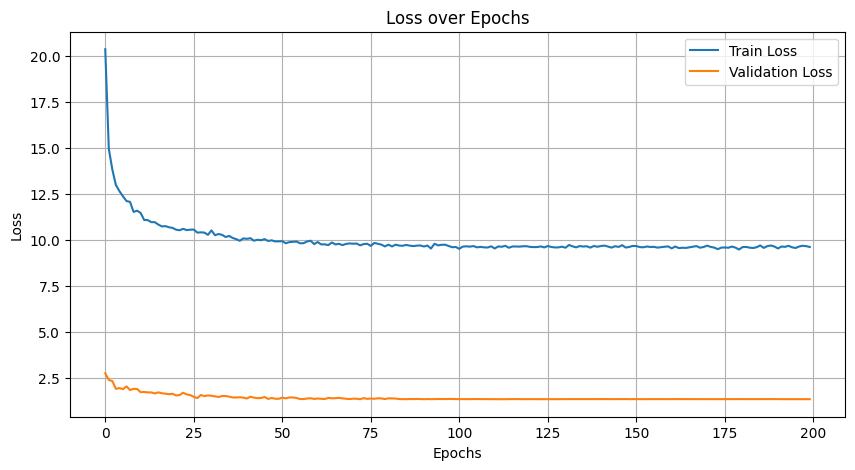

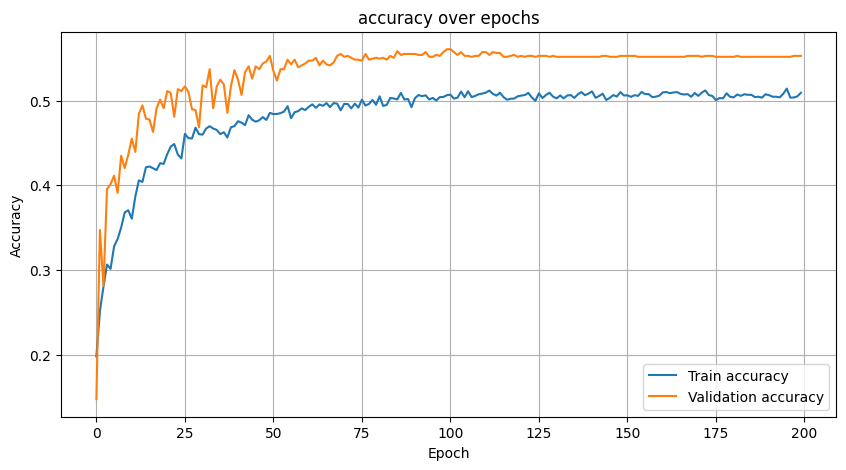

223/223 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step

--- Train Metrics ---
F1 Score (per class): [0.64245176 0.38124724 0.47077163 0.41646873 0.5451895 ]
Precision (per class): [0.74473684 0.634757   0.32969432 0.43543046 0.44312796]
Recall (per class): [0.56487026 0.27243995 0.82288828 0.39908953 0.70833333]
Accuracy: 0.5297
AUC (One-vs-Rest): 0.8489

Classification Report:
              precision    recall  f1-score   support

           E       0.74      0.56      0.64      3507
           D       0.63      0.27      0.38      1582
           C       0.33      0.82      0.47      1101
           B       0.44      0.40      0.42       659
           A       0.44      0.71      0.55       264

    accuracy                           0.53      7113
   macro avg       0.52      0.55      0.49      7113
weighted avg       0.62      0.53      0.53      7113



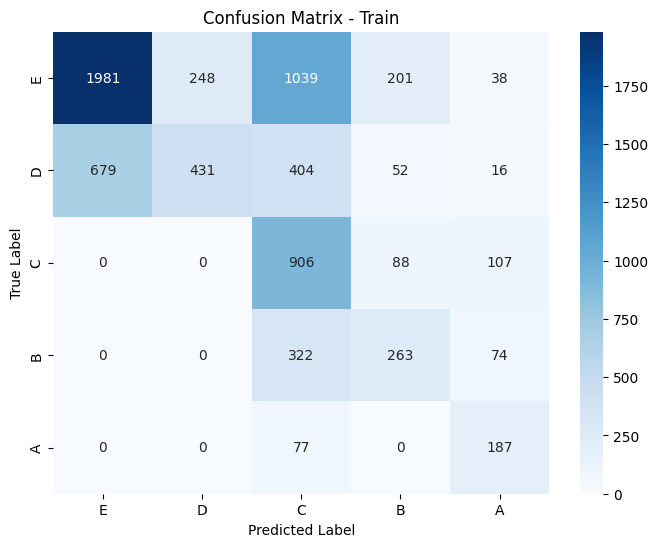

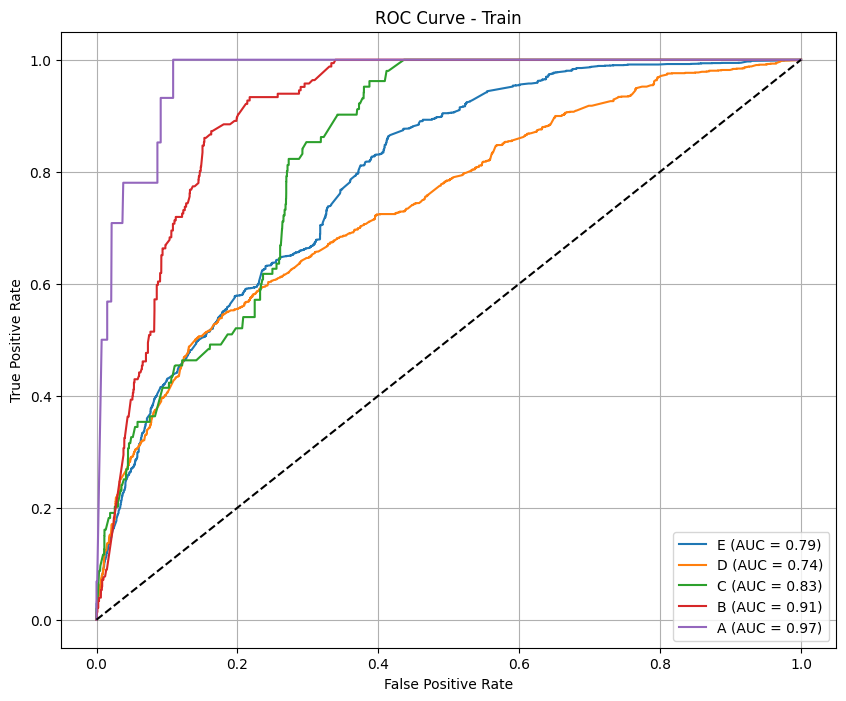

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step

--- Test Metrics ---
F1 Score (per class): [0.82236249 0.05357143 0.02325581 0.         0.16216216]
Precision (per class): [0.82310469 0.11111111 0.01470588 0.         0.11538462]
Recall (per class): [0.82162162 0.03529412 0.05555556 0.         0.27272727]
Accuracy: 0.6739
AUC (One-vs-Rest): 0.6148

Classification Report:
              precision    recall  f1-score   support

           E       0.82      0.82      0.82       555
           D       0.11      0.04      0.05        85
           C       0.01      0.06      0.02        18
           B       0.00      0.00      0.00        18
           A       0.12      0.27      0.16        11

    accuracy                           0.67       687
   macro avg       0.21      0.24      0.21       687
weighted avg       0.68      0.67      0.67       687



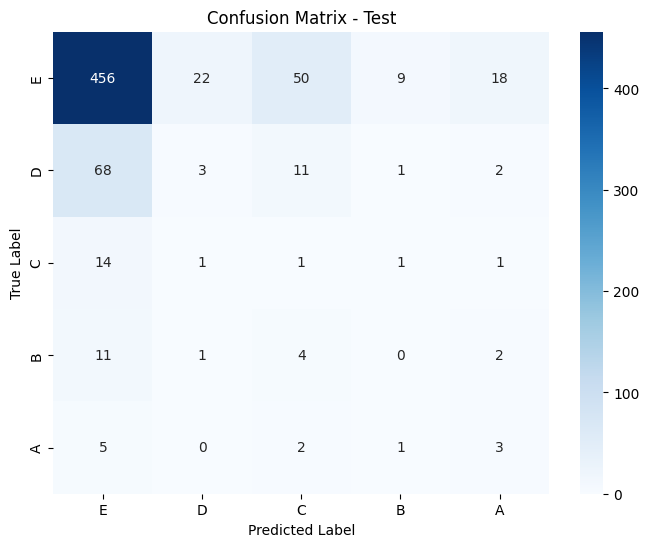

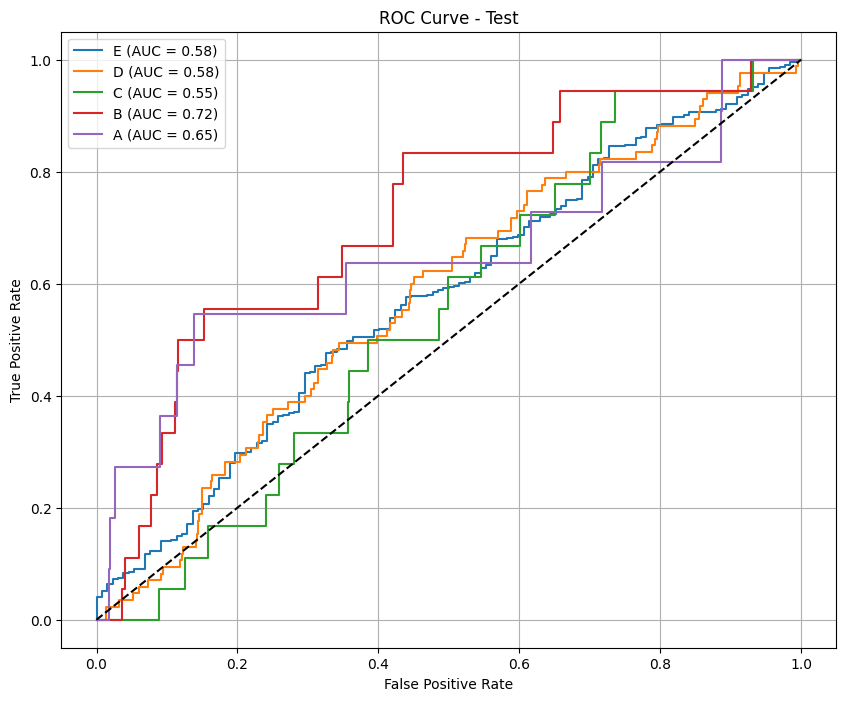

22/22 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step
Results saved: lstm_results_phase4_minmax.csv
223/223 ━━━━━━━━━━━━━━━━━━━━ 3s 9ms/step
[[0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.25109437]
 [0.25163463]
 [0.25017604]
 [0.24709496]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.25113335]
 [0.25164992]
 [0.25014904]
 [0.24706757]
 [0.2510821 ]
 [0.25162706]
 [0.25018358]
 [0.2471073 ]
 [0.2510825 ]
 [0.25162786]
 [0.2501835 ]
 [0.24710613]
 [0.2510559 ]
 [0.25165808]
 [0.25016832]
 [0.2471176 ]
 [0.2510832 ]
 [0.2516274 ]
 [0.25018212]
 [0.24710722]
 [0.2510825 ]
 [0.25162786]
 [0.25

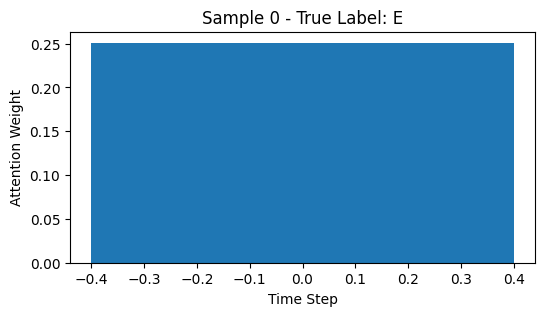

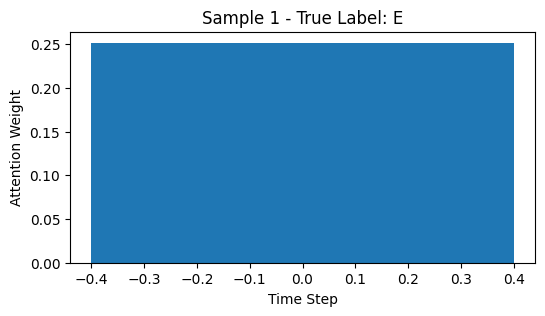

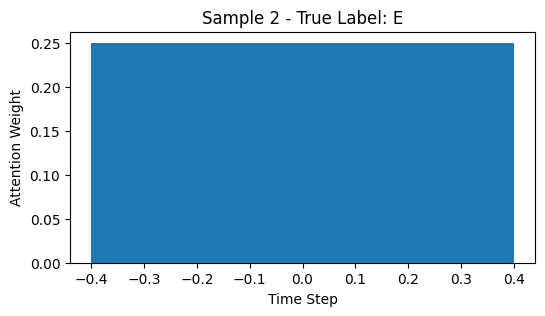

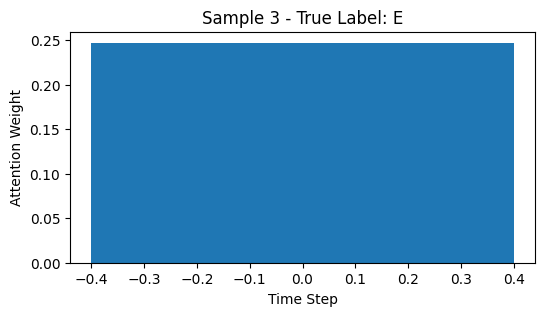

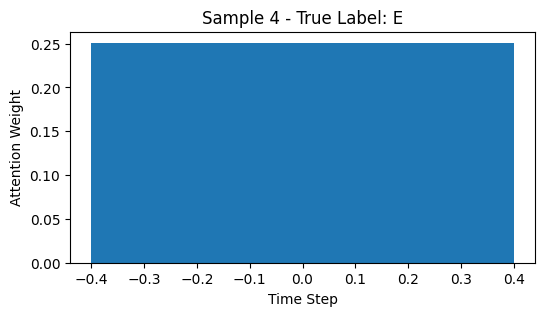

In [42]:
for phase in ["phase1", "phase2", "phase3", "phase4"]:
    process_oversample_phase(phase, metric='f1_macro', scale='minmax') 